# 1. Library import

In [1]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as Data

import time
import numpy as np
import gc
import sys
import pickle
import copy
import pandas as pd
from AttentiveLayers_MLP import *
from Featurizer import *
from getFeatures import *

from sklearn.metrics import roc_auc_score
from sklearn.metrics import recall_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import precision_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve, auc

from rdkit import Chem
from rdkit.Chem import QED
from numpy.polynomial.polynomial import polyfit
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib
from IPython.display import SVG, display
import seaborn as sns
sns.set(color_codes = True)

In [2]:
import os
os.getcwd()

'/home/dohyeon/hERGAT'

In [3]:
import os
os.chdir('/home/dohyeon/hERGAT/dataset')

# dataset 불러오기 

## Canonical smiles를 기준으로 중복 데이터 삭제

In [4]:
task_name = 'Class'
tasks = ['Class']
raw_filename = "hERGAT dataset2.csv"
feature_filename = raw_filename.replace('.csv','.pickle')
filename = raw_filename.replace('.csv','')
prefix_filename = raw_filename.split('/')[-1].replace('.csv','')
smiles_tasks_df = pd.read_csv(raw_filename)
smilesList = smiles_tasks_df.SMILES.values
print("number of all smiles: ",len(smilesList))
atom_num_dist = []
remained_smiles = []
canonical_smiles_list = []
for smiles in smilesList:
    try:        
        mol = Chem.MolFromSmiles(smiles)
        atom_num_dist.append(len(mol.GetAtoms()))
        remained_smiles.append(smiles)
        canonical_smiles_list.append(Chem.MolToSmiles(Chem.MolFromSmiles(smiles), isomericSmiles=True))
    except:
        print("not successfully processed smiles: ", smiles)
        pass
print("number of successfully processed smiles: ", len(remained_smiles))
smiles_tasks_df = smiles_tasks_df[smiles_tasks_df["SMILES"].isin(remained_smiles)]
# print(smiles_tasks_df)
smiles_tasks_df['cano_smiles'] =canonical_smiles_list
assert canonical_smiles_list[8]==Chem.MolToSmiles(Chem.MolFromSmiles(smiles_tasks_df['cano_smiles'][8]), isomericSmiles=True)
smiles_tasks_df.head()

number of all smiles:  7933
number of successfully processed smiles:  7933


,SMILES,Class,cano_smiles
0,Cc1ccc(CN2[C@@H]3CC[C@H]2C[C@@H](C3)Oc4cccc(c4...,1,Cc1ccc(CN2[C@@H]3CC[C@H]2C[C@H](Oc2cccc(C(N)=O...
1,COc1nc2ccc(Br)cc2cc1[C@@H](c3ccccc3)[C@@](O)(C...,1,COc1nc2ccc(Br)cc2cc1[C@@H](c1ccccc1)[C@@](O)(C...
2,NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CCCc...,1,NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CCCc...
3,Cc1ccc(CN2[C@@H]3CC[C@H]2C[C@@H](C3)Oc4cccc(c4...,1,Cc1ccc(CN2[C@@H]3CC[C@H]2C[C@H](Oc2cccc(C(N)=O...
4,NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CCc4...,1,NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CCc2...


In [5]:
random_seed =100
start_time = str(time.ctime()).replace(':','-').replace(' ','_')
start = time.time()
radius = 3
T = 2
per_task_output_units_num = 2 # for classification model with 2 classes
output_units_num = len(tasks) * per_task_output_units_num # 2 

In [6]:
len(smiles_tasks_df)

7933

In [7]:
smilesList = [smiles for smiles in canonical_smiles_list if len(Chem.MolFromSmiles(smiles).GetAtoms())<101]

uncovered = [smiles for smiles in canonical_smiles_list if len(Chem.MolFromSmiles(smiles).GetAtoms())>100]

# cano_smiles안에 uncovered값과 겹치는 경우에 삭제
smiles_tasks_df = smiles_tasks_df[~smiles_tasks_df["cano_smiles"].isin(uncovered)]

feature_dicts = get_smiles_dicts(smilesList)
# keys = smiles값들이 cano_smiles값안에 있으면 두고 없다면 삭제
remained_df = smiles_tasks_df[smiles_tasks_df["cano_smiles"].isin(feature_dicts['smiles_to_atom_mask'].keys())] 
uncovered_df = smiles_tasks_df.drop(remained_df.index) 
uncovered_df # 최종적으로 uncovered_df에는 get_smiles_dicts로 바꾼 값과 cano_smiles와 비교하였을 때 삭제

Cc1ncoc1-c1nnc(SCCCN2CC3CC3(c3ccc(S(F)(F)(F)(F)F)cc3)C2)n1C
Cc1ncoc1-c1nnc(SCCCN2CC3CC3(c3cccc(S(F)(F)(F)(F)F)c3)C2)n1C
[Cl-]


,SMILES,Class,cano_smiles
1240,Cc1ncoc1c2nnc(SCCCN3CC4CC4(C3)c5ccc(cc5)S(F)(F...,1,Cc1ncoc1-c1nnc(SCCCN2CC3CC3(c3ccc(S(F)(F)(F)(F...
1671,Cc1ncoc1c2nnc(SCCCN3CC4CC4(C3)c5cccc(c5)S(F)(F...,1,Cc1ncoc1-c1nnc(SCCCN2CC3CC3(c3cccc(S(F)(F)(F)(...
3704,[Cl-],1,[Cl-]


## Physicochemical properties 생성

In [8]:
from rdkit import Chem
from rdkit import DataStructs
from rdkit.Chem import AllChem
from rdkit.Chem.Fingerprints import FingerprintMols
from rdkit.Chem import rdMolDescriptors

remained_df = remained_df.reset_index()

# mol 형태로 변환
train_mols = [Chem.MolFromSmiles(smiles) for smiles in remained_df["cano_smiles"]]

# mol 형태로 변환이 되지 않은 경우, none_list에 담는다
none_list = []
for i in range(len(train_mols)):
    if train_mols[i] is None :
        none_list.append(i)
        print('none_list에 추가됨')
    
reg_idx = 0
for i in none_list :
    del train_mols[i - reg_idx]
    reg_idx += 1
    
# none_list가 존재할 경우, 삭제 후 데이터프레임 인덱스 맞춰주기
if len(none_list) != 0 :
    remained_df = remained_df.drop(none_list, axis=0)
    remained_df = remained_df.reset_index(drop = True)

In [9]:
# fingerprint 생성
bit_info_list = [] # bit vector의 설명자 리스트 담기
bit_info = {} #bit vector 설명자
fps = []

b = 0
# mol 파일에서 fingerprint Bit Vector 형태로 변환하기
for a in train_mols :
    fps.append(AllChem.GetMorganFingerprintAsBitVect(a, 3, nBits = 1024, bitInfo = bit_info))
    bit_info_list.append(bit_info.copy()) # bit_info 그대로 가져오면 변수가 변해서 리스트 값이 달라지므로 .copy()
    
# array 변환

arr_list = []
for i in range(len(fps)):
    array = np.zeros((0,), dtype = np.int8)
    arr_list.append(array)
for i in range(len(fps)):
    bit = fps[i]
    DataStructs.ConvertToNumpyArray(bit, arr_list[i])
    
train_x = np.stack([i.tolist() for i in arr_list])
train_finprt = pd.DataFrame(train_x)
train_finprt.head()

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
1,0,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,1,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0


In [10]:
import joblib
from sklearn.preprocessing import StandardScaler

# StandardScaler

sds_scaler = StandardScaler()

# molecular physicochemical properties 구하기

from rdkit.Chem import QED

train_qe = [QED.properties(mol) for mol in train_mols]
train_qe = pd.DataFrame(train_qe)
train_qe = train_qe.drop(columns = ['ROTB', 'AROM', 'ALERTS'])
train_qe[['MW', 'ALOGP', 'HBA', 'HBD', 'PSA']] = sds_scaler.fit_transform(train_qe[['MW', 'ALOGP', 'HBA', 'HBD', 'PSA']])
train_qe

,MW,ALOGP,HBA,HBD,PSA
0,-0.917145,-0.177788,-0.905935,-0.240880,-0.502855
1,1.267313,2.290658,-0.412761,-0.240880,-0.812253
2,-0.767714,-0.089251,-0.905935,-0.240880,-0.502855
3,-0.852917,-0.133940,-0.905935,-0.240880,-0.502855
4,-0.917145,-0.367382,-0.905935,-0.240880,-0.502855
...,...,...,...,...,...
7925,1.160303,-0.326243,0.573587,2.519498,1.530423
7926,1.181779,-0.166537,0.573587,2.519498,1.530423
7927,1.309733,-0.048112,0.573587,2.519498,1.530423
7928,1.331210,0.111594,0.573587,2.519498,1.530423


In [11]:
# 생성한 데이터 병합
input_df=pd.concat([train_finprt, train_qe], axis=1)
input_df.head()

,0,1,2,3,4,5,6,7,8,9,...,1019,1020,1021,1022,1023,MW,ALOGP,HBA,HBD,PSA
0,1,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,-0.917145,-0.177788,-0.905935,-0.24088,-0.502855
1,0,1,1,1,0,0,0,0,0,0,...,0,0,0,0,0,1.267313,2.290658,-0.412761,-0.24088,-0.812253
2,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,-0.767714,-0.089251,-0.905935,-0.24088,-0.502855
3,0,0,0,0,0,0,0,0,0,0,...,1,1,0,0,0,-0.852917,-0.133940,-0.905935,-0.24088,-0.502855
4,0,0,0,0,0,0,0,0,0,0,...,1,0,0,0,0,-0.917145,-0.367382,-0.905935,-0.24088,-0.502855


In [12]:
new_remained_df = pd.concat([remained_df, input_df], axis = 1)
new_remained_df = new_remained_df.drop(columns = ['index'])
new_remained_df

,SMILES,Class,cano_smiles,0,1,2,3,4,5,6,...,1019,1020,1021,1022,1023,MW,ALOGP,HBA,HBD,PSA
0,Cc1ccc(CN2[C@@H]3CC[C@H]2C[C@@H](C3)Oc4cccc(c4...,1,Cc1ccc(CN2[C@@H]3CC[C@H]2C[C@H](Oc2cccc(C(N)=O...,1,0,0,0,0,0,0,...,1,0,0,0,0,-0.917145,-0.177788,-0.905935,-0.240880,-0.502855
1,COc1nc2ccc(Br)cc2cc1[C@@H](c3ccccc3)[C@@](O)(C...,1,COc1nc2ccc(Br)cc2cc1[C@@H](c1ccccc1)[C@@](O)(C...,0,1,1,1,0,0,0,...,0,0,0,0,0,1.267313,2.290658,-0.412761,-0.240880,-0.812253
2,NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CCCc...,1,NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CCCc...,0,0,0,0,0,0,0,...,1,0,0,0,0,-0.767714,-0.089251,-0.905935,-0.240880,-0.502855
3,Cc1ccc(CN2[C@@H]3CC[C@H]2C[C@@H](C3)Oc4cccc(c4...,1,Cc1ccc(CN2[C@@H]3CC[C@H]2C[C@H](Oc2cccc(C(N)=O...,0,0,0,0,0,0,0,...,1,1,0,0,0,-0.852917,-0.133940,-0.905935,-0.240880,-0.502855
4,NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CCc4...,1,NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CCc2...,0,0,0,0,0,0,0,...,1,0,0,0,0,-0.917145,-0.367382,-0.905935,-0.240880,-0.502855
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7925,O=C1[C@H]2N(c3ccc(OCC=CCCNCC(=O)Nc4c(Cl)cc(cc4...,0,NC1=NCc2cc(Cl)c(c(Cl)c2)NC(=O)CNCCC=CCOc2ccc(c...,0,0,0,0,1,0,0,...,1,0,0,0,0,1.160303,-0.326243,0.573587,2.519498,1.530423
7926,O=C1[C@H]2N(c3ccc(OCCCCCNCC(=O)Nc4c(Cl)cc(cc4C...,0,NC1=NCc2cc(Cl)c(c(Cl)c2)NC(=O)CNCCCCCOc2ccc(cc...,0,0,1,0,1,0,0,...,1,0,0,0,0,1.181779,-0.166537,0.573587,2.519498,1.530423
7927,O=C1[C@H]2N(c3ccc(OCC=CCCCNCC(=O)Nc4c(Cl)cc(cc...,0,NC1=NCc2cc(Cl)c(c(Cl)c2)NC(=O)CNCCCC=CCOc2ccc(...,0,0,0,0,1,0,0,...,1,0,0,0,0,1.309733,-0.048112,0.573587,2.519498,1.530423
7928,O=C1[C@H]2N(c3ccc(OCCCCCCNCC(=O)Nc4c(Cl)cc(cc4...,0,NC1=NCc2cc(Cl)c(c(Cl)c2)NC(=O)CNCCCCCCOc2ccc(c...,0,0,1,0,1,0,0,...,1,0,0,0,0,1.331210,0.111594,0.573587,2.519498,1.530423


In [13]:
for key, value in feature_dicts.items():
    print(key)

smiles_to_atom_mask
smiles_to_atom_info
smiles_to_bond_info
smiles_to_atom_neighbors
smiles_to_bond_neighbors
smiles_to_rdkit_list


In [14]:
weights = []
for i,task in enumerate(tasks):    
    negative_df = new_remained_df[new_remained_df[task] == 0][["SMILES",task]] # 
    positive_df = new_remained_df[new_remained_df[task] == 1][["SMILES",task]] # 
    weights.append([(positive_df.shape[0]+negative_df.shape[0])/negative_df.shape[0],\
                    (positive_df.shape[0]+negative_df.shape[0])/positive_df.shape[0]])

# train/test/valid split
test_df = new_remained_df.sample(frac=1/10, random_state=random_seed) # test set
training_data = new_remained_df.drop(test_df.index) # training data
valid_df = training_data.sample(frac=1/9, random_state=random_seed) # validation set
train_df = training_data.drop(valid_df.index) # train set
train_df = train_df.reset_index(drop=True)
valid_df = valid_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

In [15]:
print(train_df.shape)
print(valid_df.shape)
print(test_df.shape)

(6344, 1032)
(793, 1032)
(793, 1032)


In [16]:
print('train_df label의 shape')
print(train_df['Class'].value_counts())
print('test_df label의 shape')
print(test_df['Class'].value_counts())
print('valid_df label의 shape')
print(valid_df['Class'].value_counts())

train_df label의 shape
1    4102
0    2242
Name: Class, dtype: int64
test_df label의 shape
1    537
0    256
Name: Class, dtype: int64
valid_df label의 shape
1    521
0    272
Name: Class, dtype: int64


여기에서 test_df를 사용할 예정

In [17]:
def train(model, dataset, optimizer, loss_function):
    model.train()
    np.random.seed(30)
    valList = np.arange(0,dataset.shape[0])
    #shuffle them
    np.random.shuffle(valList)
    batch_list = []
    for i in range(0, dataset.shape[0], batch_size):
        batch = valList[i:i+batch_size]
        batch_list.append(batch)   
    for counter, train_batch in enumerate(batch_list):
        batch_df = dataset.loc[train_batch,:]
        smiles_list = batch_df.cano_smiles.values
        
        x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = get_smiles_array(smiles_list,feature_dicts)    
        
        selected_rows = batch_df[batch_df['cano_smiles'] == smiles_list].drop(columns=['SMILES', 'Class', 'cano_smiles'])
        physicochemical_features= torch.tensor(selected_rows.to_numpy(dtype=np.float32), dtype=torch.float)

        atoms_prediction, atom_feature_viz, atom_attention_weight_viz, mol_feature_viz, mol_feature_unbounded_viz, mol_attention_weight_viz, mol_prediction = model(torch.Tensor(x_atom).cpu(),torch.Tensor(x_bonds).cpu(),torch.LongTensor(x_atom_index).cpu(),torch.LongTensor(x_bond_index).cpu(),torch.Tensor(x_mask).cpu(), physicochemical_features.cpu())
        
        model.zero_grad()
        # Step 4. Compute your loss function. (Again, Torch wants the target wrapped in a variable)
        loss = 0.0
        for i,task in enumerate(tasks):
            y_pred = mol_prediction[:, i * per_task_output_units_num:(i + 1) *
                                    per_task_output_units_num]
            y_val = batch_df[task].values

            validInds = np.where((y_val==0) | (y_val==1))[0]
#             validInds = np.where(y_val != -1)[0]
            if len(validInds) == 0:
                continue
            y_val_adjust = np.array([y_val[v] for v in validInds]).astype(float)
            validInds = torch.LongTensor(validInds).squeeze()
            y_pred_adjust = torch.index_select(y_pred, 0, validInds)

            loss += loss_function[i](
                y_pred_adjust,
                torch.LongTensor(y_val_adjust))
        # Step 5. Do the backward pass and update the gradient
#             print(y_val,y_pred,validInds,y_val_adjust,y_pred_adjust)
        loss.backward()
        optimizer.step()
        
        
def eval(model, dataset):
    model.eval()
    y_val_list = {}
    y_pred_list = {}
    losses_list = []

    
    valList = np.arange(0,dataset.shape[0])
    batch_list = []
    for i in range(0, dataset.shape[0], batch_size):
        batch = valList[i:i+batch_size]
        batch_list.append(batch)   
    for counter, test_batch in enumerate(batch_list):
        batch_df = dataset.loc[test_batch,:]
        smiles_list = batch_df.cano_smiles.values
        
        x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = get_smiles_array(smiles_list,feature_dicts)
        selected_rows = batch_df[batch_df['cano_smiles'] == smiles_list].drop(columns=['SMILES', 'Class', 'cano_smiles'])
        physicochemical_features= torch.tensor(selected_rows.to_numpy(dtype=np.float32), dtype=torch.float)
#        physicochemical_features = physicochemical_features.expand(batch_size, -1)
        
        atoms_prediction, atom_feature_viz, atom_attention_weight_viz, mol_feature_viz, mol_feature_unbounded_viz, mol_attention_weight_viz, mol_prediction = model(torch.Tensor(x_atom).cpu(),torch.Tensor(x_bonds).cpu(),torch.LongTensor(x_atom_index).cpu(),torch.LongTensor(x_bond_index).cpu(),torch.Tensor(x_mask).cpu(), physicochemical_features.cpu())

        atom_pred = atoms_prediction.data[:,:,1].unsqueeze(2).numpy()
        for i,task in enumerate(tasks):
            y_pred = mol_prediction[:, i * per_task_output_units_num:(i + 1) *
                                    per_task_output_units_num]
            y_val = batch_df[task].values

            validInds = np.where((y_val==0) | (y_val==1))[0]

            if len(validInds) == 0:
                continue
            y_val_adjust = np.array([y_val[v] for v in validInds]).astype(float)
            validInds = torch.LongTensor(validInds).squeeze()
            y_pred_adjust = torch.index_select(y_pred, 0, validInds)

            loss = loss_function[i](
                y_pred_adjust,
                torch.LongTensor(y_val_adjust))
            y_pred_adjust = F.softmax(y_pred_adjust,dim=-1).data.numpy()[:,1]
            losses_list.append(loss.detach().numpy())
            try:
                y_val_list[i].extend(y_val_adjust)
                y_pred_list[i].extend(y_pred_adjust)
            except:
                y_val_list[i] = []
                y_pred_list[i] = []
                y_val_list[i].extend(y_val_adjust)
                y_pred_list[i].extend(y_pred_adjust)
                
    # 시행할때마다 모델에서 최적의 optimal_threshold값을 찾아 성능평가
    
    def find_optimal_threshold(precision, recall, thresholds):
        with np.errstate(divide='ignore', invalid='ignore'):
            f1_scores = 2*((precision*recall)/(precision+recall))
            f1_scores = np.nan_to_num(f1_scores)  # convert NaNs to 0
        index = np.argmax(f1_scores)
        return thresholds[index], f1_scores[index]

    test_prc = []
    test_thresholds = []
    optimal_thresholds = []
    for i in range(len(tasks)):
        precision, recall, thresholds = precision_recall_curve(y_val_list[i], y_pred_list[i])
        optimal_threshold, test_f1_scores = find_optimal_threshold(precision, recall, thresholds)
        optimal_thresholds.append(optimal_threshold)
        test_prc.append(auc(recall, precision))
        test_thresholds.append(thresholds)
        
        
    test_precision = [precision_score(y_val_list[i], (np.array(y_pred_list[i]) > optimal_thresholds[i]).astype(int), zero_division = 1) for i in range(len(tasks))]
    test_recall = [recall_score(y_val_list[i],(np.array(y_pred_list[i]) >optimal_thresholds[i]).astype(int)) for i in range(len(tasks))]
    
    #test_f1_score = [2 * (precision * recall) / (precision + recall) for precision, recall in zip(test_precision, test_recall)]    
    conf_matrices = [confusion_matrix(y_val_list[i], (np.array(y_pred_list[i]) > optimal_thresholds[i]) .astype(int)) for i in range(len(tasks))]
    test_sensitivity = [cm[1, 1] / (cm[1, 1] + cm[1, 0]) for cm in conf_matrices]
    test_specificity = [cm[0, 0] / (cm[0, 0] + cm[0, 1]) for cm in conf_matrices]
    test_acc = [accuracy_score(y_val_list[i], (np.array(y_pred_list[i]) > optimal_thresholds[i]).astype(int)) for i in range(len(tasks))]
    fpr_list, tpr_list, thresholds2 = [], [], []
    for i in range(len(tasks)):
        fpr, tpr, thresholds = roc_curve(y_val_list[i], y_pred_list[i])
        fpr_list.append(fpr)
        tpr_list.append(tpr)
    test_roc = [roc_auc_score(y_val_list[i], y_pred_list[i]) for i in range(len(tasks))]
    test_loss = np.array(losses_list).mean()
    
    return test_acc, test_roc, test_prc, test_precision, test_recall, test_f1_scores, test_loss, test_sensitivity, test_specificity, fpr_list, tpr_list, optimal_thresholds

In [18]:
best_param = {"roc_epoch": 0, "valid_roc": 0, "loss_epoch": 0, "valid_loss": float('inf')}
best_param


{'roc_epoch': 0, 'valid_roc': 0, 'loss_epoch': 0, 'valid_loss': inf}

In [19]:
# bayesian optimizer로 찾은 최적의 parameter 값 #
physicochemical_feature_dim = 1029

batch_size = 210
p_dropout = 0.219
fingerprint_dim = 125
learning_rate = 4.6
weight_decay = 4.6
radius = 3
T = 2

# molecule substructure attention

In [20]:
from AttentiveLayers_Viz import *

In [21]:
import os
os.getcwd()

'/home/dohyeon/hERGAT/dataset'

In [22]:
best_model = torch.load('../saved_model2/model'+'_' + prefix_filename + '_' + str(100) + '.pt')     # best_param['roc_epoch']


best_model_dict = best_model.state_dict()
best_model_wts = copy.deepcopy(best_model_dict)

In [23]:
best_model_wts.keys()

odict_keys(['atom_fc.weight', 'atom_fc.bias', 'neighbor_fc.weight', 'neighbor_fc.bias', 'GRUCell.0.weight_ih', 'GRUCell.0.weight_hh', 'GRUCell.0.bias_ih', 'GRUCell.0.bias_hh', 'GRUCell.1.weight_ih', 'GRUCell.1.weight_hh', 'GRUCell.1.bias_ih', 'GRUCell.1.bias_hh', 'GRUCell.2.weight_ih', 'GRUCell.2.weight_hh', 'GRUCell.2.bias_ih', 'GRUCell.2.bias_hh', 'align.0.weight', 'align.0.bias', 'align.1.weight', 'align.1.bias', 'align.2.weight', 'align.2.bias', 'attend.0.weight', 'attend.0.bias', 'attend.1.weight', 'attend.1.bias', 'attend.2.weight', 'attend.2.bias', 'mol_GRUCell.weight_ih', 'mol_GRUCell.weight_hh', 'mol_GRUCell.bias_ih', 'mol_GRUCell.bias_hh', 'mol_align.weight', 'mol_align.bias', 'mol_attend.weight', 'mol_attend.bias', 'output.weight', 'output.bias', 'physicochemical_fc.weight', 'physicochemical_fc.bias', 'physicochemical_bn.weight', 'physicochemical_bn.bias', 'physicochemical_bn.running_mean', 'physicochemical_bn.running_var', 'physicochemical_bn.num_batches_tracked', 'physicoc

In [24]:
x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = get_smiles_array([smilesList[0]], feature_dicts)

num_atom_features = x_atom.shape[-1]
num_bond_features = x_bonds.shape[-1]

In [25]:
# 기존에 best_model_wts에 저장되어있는 가중치값들을 여기에 적용시킨다
model_for_viz = ExtendedFingerprint_viz(radius, T, num_atom_features, num_bond_features,fingerprint_dim, output_units_num, p_dropout, physicochemical_feature_dim)
model_for_viz.load_state_dict(best_model_wts)

<All keys matched successfully>

Molecule image saved as molecule_structure.png


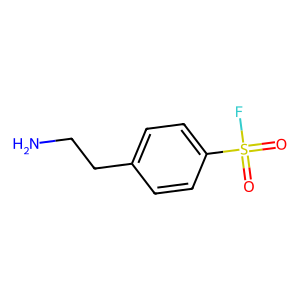

In [26]:
from rdkit import Chem
from rdkit.Chem import Draw
from IPython.display import Image, display

# SMILES 문자열을 이용하여 분자의 구조를 그리는 함수
def draw_molecule_from_smiles(smiles_string):
    # SMILES 문자열로부터 분자 객체 생성
    molecule = Chem.MolFromSmiles(smiles_string)
    
    # 분자의 구조를 그림으로 생성
    drawing = Draw.MolToImage(molecule)
    
    # 그림을 파일로 저장
    file_name = 'molecule_structure.png'
    drawing.save(file_name)
    print(f"Molecule image saved as {file_name}")

    # 이미지를 화면에 출력
    display(Image(filename=file_name))

# 사용 예:
smiles_input = 'NCCc1ccc(S(=O)(=O)F)cc1' # 여기에 SMILES 문자열을 입력하세요.
draw_molecule_from_smiles(smiles_input)


In [27]:
# 두 모델의 특정 layer에서 가중치가 동일한지 확인하는 코드
# 같다면 1을 출력
(best_model.align[0].weight == model_for_viz.align[0].weight).all()

tensor(True)

In [28]:
def min_max_norm(dataset):
    if isinstance(dataset, list):
        norm_list = list()
        min_value = min(dataset)
        max_value = max(dataset)

        for value in dataset:
            tmp = (value - min_value) / (max_value - min_value)
            norm_list.append(tmp)
    return norm_list

In [29]:
model_for_viz.eval()

out_feature_sorted = []
out_weight_sorted = []
mol_feature_sorted = []

dataset = test_df
test_MAE_list = []
test_MSE_list = []
valList = np.arange(0,dataset.shape[0])
batch_list = []
for i in range(0, dataset.shape[0], batch_size):
    batch = valList[i:i+batch_size]
    batch_list.append(batch) 
    
visualization_data = []
    
    
for counter, test_batch in enumerate(batch_list):
    batch_df = dataset.loc[test_batch,:]
    smiles_list = batch_df.cano_smiles.values
    y_val = batch_df[tasks[0]].values

    x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = get_smiles_array(smiles_list,feature_dicts)
            
    selected_rows = batch_df[batch_df['cano_smiles'] == smiles_list].drop(columns=['SMILES', 'Class', 'cano_smiles'])
    physicochemical_features= torch.tensor(selected_rows.to_numpy(dtype=np.float32), dtype=torch.float)
    
    atoms_prediction, atom_feature_viz, atom_attention_weight_viz, mol_feature_viz, mol_feature_unbounded_viz, mol_attention_weight_viz, mol_prediction = model_for_viz(
        torch.Tensor(x_atom), torch.Tensor(x_bonds),
        torch.LongTensor(x_atom_index),
        torch.LongTensor(x_bond_index),
        torch.Tensor(x_mask), 
        physicochemical_features.cpu())
    
    
    
    mol_pred = np.array(mol_prediction.data.squeeze().cpu().numpy())
    atom_feature = np.stack([atom_feature_viz[L].cpu().detach().numpy() for L in range(radius+1)])
    atom_weight = np.stack([mol_attention_weight_viz[t].cpu().detach().numpy() for t in range(T)])
    mol_feature = np.stack([mol_feature_viz[t].cpu().detach().numpy() for t in range(T)])
    mol_feature_sorted.extend([mol_feature[:,i,:] for i in range(mol_feature.shape[1])])

    
    
    
    for i, smiles in enumerate(smiles_list):
        atom_num = i
        ind_mask = x_mask[i]
        ind_atom = smiles_to_rdkit_list[smiles]
        ind_feature = atom_feature[:, i]
        ind_weight = atom_weight[:, i]
        out_feature = []
        out_weight = []
        for j, one_or_zero in enumerate(list(ind_mask)):
            if one_or_zero == 1.0:
                out_feature.append(ind_feature[:,j])
                out_weight.append(ind_weight[:,j])
        out_feature_sorted.extend([out_feature[m] for m in np.argsort(ind_atom)])
        out_weight_sorted.extend([out_weight[m] for m in np.argsort(ind_atom)])        
        
        mol = Chem.MolFromSmiles(smiles)
        

        
        
        
        aromatic_boolean = [int(mol.GetAtomWithIdx(i).GetIsAromatic()) for i in range(mol.GetNumAtoms())]
        if len(aromatic_boolean)>3 and np.sum(aromatic_boolean)>1:
            weight_norm = min_max_norm([out_weight[m][0] for m in np.argsort(ind_atom)])
            
            
            #print('aromatic atom count: '+str(np.sum(aromatic_boolean))+'\n'
            #     'prediction: '+str(mol_pred[atom_num]))
            #print(smiles)
            norm = matplotlib.colors.Normalize(vmin=0,vmax=1.28)
            cmap = cm.get_cmap('Oranges')
            plt_colors = cm.ScalarMappable(norm=norm, cmap=cmap)
            atom_colors = {}
            weight_norm = np.array(weight_norm).flatten()
            threshold = weight_norm[np.argsort(weight_norm)[6]]
            weight_norm = np.where(weight_norm < threshold, 0, weight_norm)
            weight_norm[weight_norm < 0.1] = 0  # 0.4보다 작은 값들을 0으로 설정

            
            
            
            for i in range(len(ind_atom)):
                atom_colors[i] = plt_colors.to_rgba(float(weight_norm[i]))
                                
            rdDepictor.Compute2DCoords(mol)

            drawer = rdMolDraw2D.MolDraw2DSVG(500,500)
            drawer.SetFontSize(6)
            op = drawer.drawOptions()

            mol = rdMolDraw2D.PrepareMolForDrawing(mol)
            drawer.DrawMolecule(mol,highlightAtoms=range(0,len(ind_atom)),highlightBonds=[],
                highlightAtomColors=atom_colors)
            drawer.FinishDrawing()
            svg = drawer.GetDrawingText()
            svg2 = svg.replace('svg:','')
            svg3 = SVG(svg2)
            #display(svg3)
            
        visualization_dict = {
            "smiles": smiles,
            "mol_pred": mol_pred[atom_num],
            "svg": svg3}
        visualization_data.append(visualization_dict)
            
            
            

/tmp/ipykernel_2321217/1041936231.py:8: RuntimeWarning: invalid value encountered in divide
  tmp = (value - min_value) / (max_value - min_value)
/tmp/ipykernel_2321217/1041936231.py:8: RuntimeWarning: invalid value encountered in divide
  tmp = (value - min_value) / (max_value - min_value)
/tmp/ipykernel_2321217/1041936231.py:8: RuntimeWarning: invalid value encountered in divide
  tmp = (value - min_value) / (max_value - min_value)
/tmp/ipykernel_2321217/1041936231.py:8: RuntimeWarning: invalid value encountered in divide
  tmp = (value - min_value) / (max_value - min_value)


####  데이터의 mol_pred의 첫번째 index를 기준 (blocker)으로 sort해서 리스트 정렬

prediction: [9.9998784e-01 1.2131159e-05]
O=C1COc2cnc(CNC34CCC(C[C@]5(O)Cn6c(=O)ccc7ncc(F)c5c76)(CC3)OC4)nc2N1


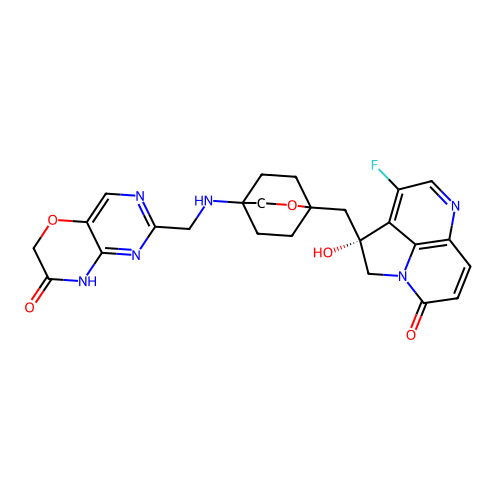

prediction: [9.9996924e-01 3.0702777e-05]
Cc1cnc(NC(=O)c2cc(Oc3ccc(C(=O)N4CCC4)cc3)cc(O[C@@H](C)CO)c2)cn1


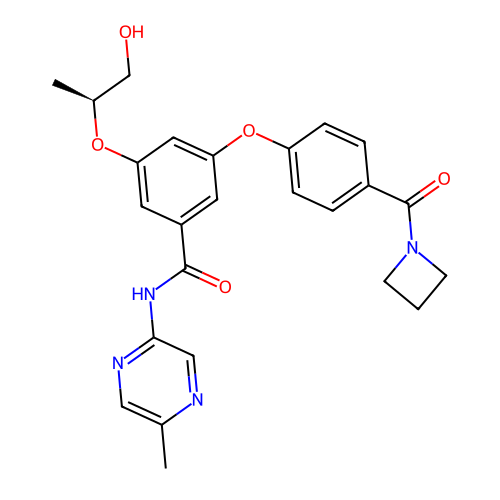

prediction: [9.999634e-01 3.654504e-05]
O=C(NC1CC1)c1cn(-c2cccc(C#Cc3ccc[n+]([O-])c3)c2)c2ncccc2c1=O


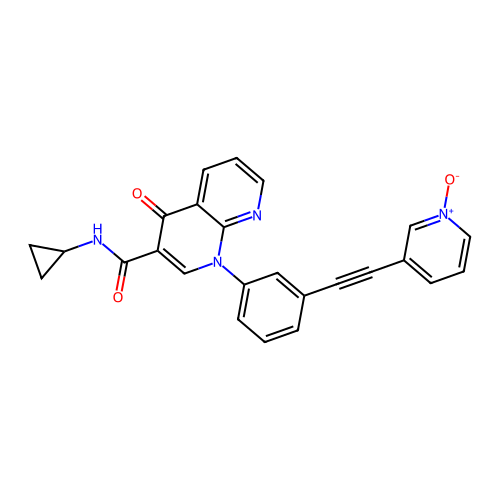

prediction: [9.999336e-01 6.639924e-05]
CCOC[C@@H](CC(C)C)NC(=O)[C@@H]1CNC[C@H](C(=O)N(c2cc(OC)c(C(C)C)cn2)C2CC2)[C@@H]1O


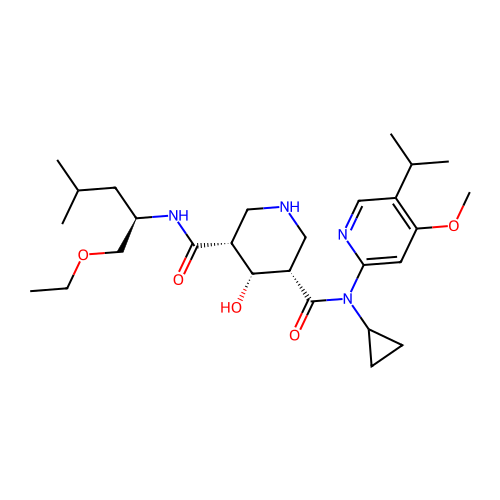

prediction: [9.999212e-01 7.876965e-05]
O=C(CNc1ncnc2ccc(C(F)(F)F)cc12)NC1CN([C@H]2CC[C@@](O)(c3nccs3)CC2)C1


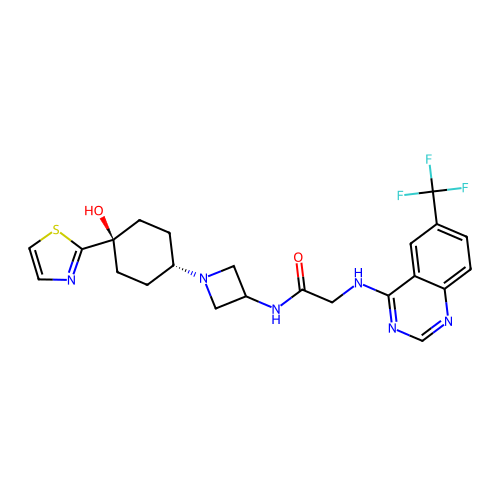

prediction: [9.999044e-01 9.554957e-05]
C[C@@H](N1CCc2nc(-c3cncnc3)sc2C1)[C@](O)(Cn1cncn1)c1ccc(F)cc1F


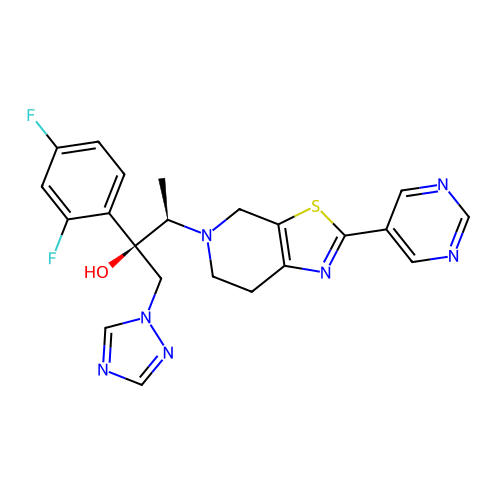

prediction: [9.999044e-01 9.565488e-05]
N[C@H]1Cn2c(nc3cnc(F)cc32)C[C@@H]1c1cc(F)c(F)cc1F


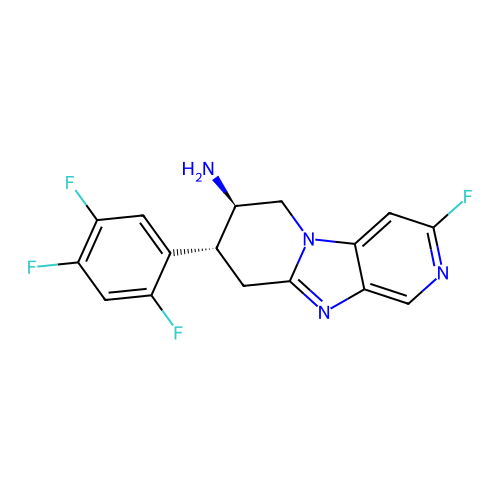

prediction: [9.999006e-01 9.941706e-05]
COc1ccc2ncc(=O)n(CCN3CC[C@H](NCc4cc5c(cn4)OCCO5)[C@@H](OC)C3)c2c1


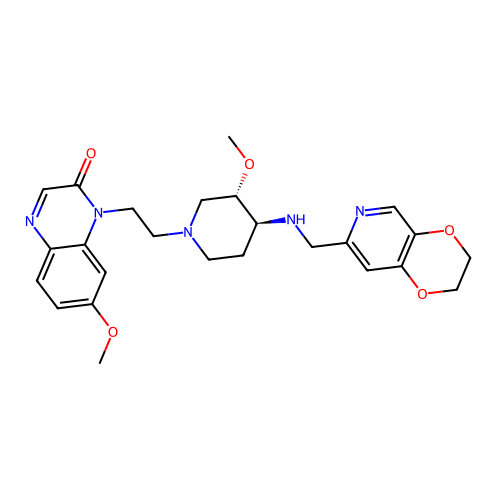

prediction: [9.998970e-01 1.029357e-04]
O=C1COc2ccc(CNC34CCC(C[C@@]5(O)Cn6c(=O)ccc7ncc(F)c5c76)(CC3)OC4)nc2N1


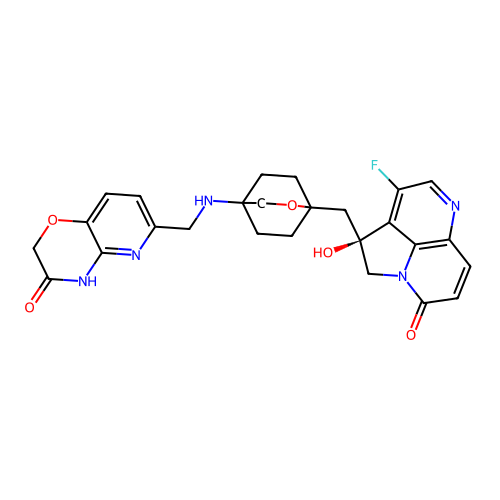

prediction: [9.998858e-01 1.142183e-04]
Cc1cc(C(=O)O)ccc1-c1ccc(N2C(=O)N(c3cc(O)ncn3)C3(CCN(Cc4ncccc4C)CC3)C2=O)cn1


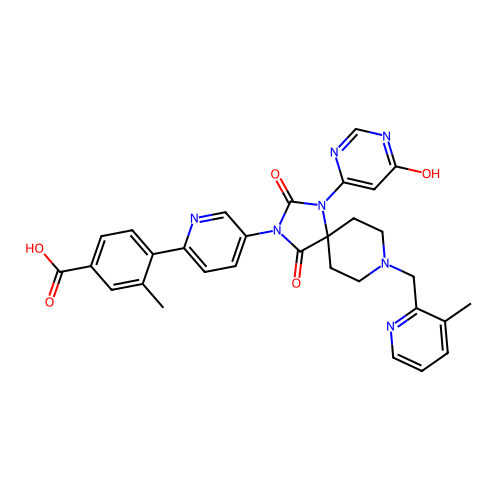

prediction: [9.99878645e-01 1.21352314e-04]
CC1COc2c(N3CC[C@@H]([C@H](C)N)C3)c(F)cc3c(=O)c(C(=O)O)cn1c23


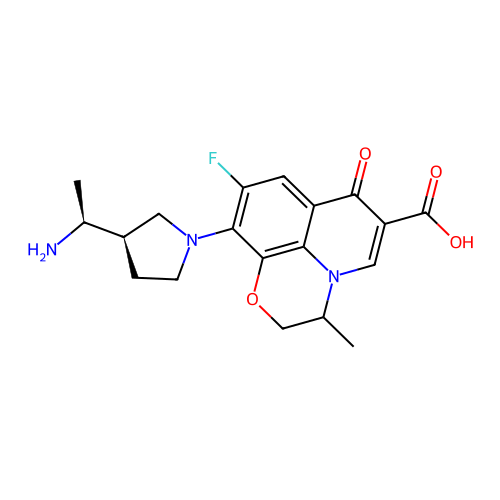

prediction: [9.9987352e-01 1.2644033e-04]
Cc1cc2c(=O)n(Cc3ccccc3C#N)c(N3CCC[C@@H](N)C3)nc2[nH]1


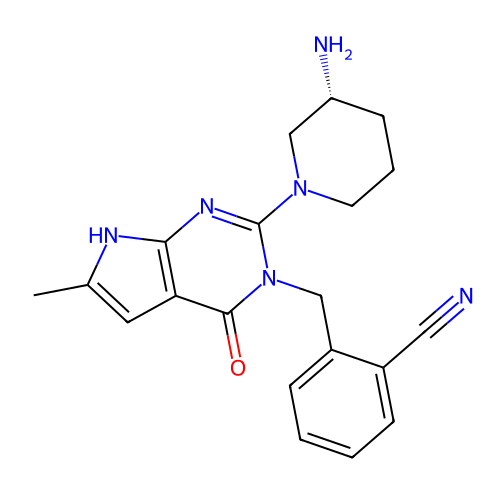

prediction: [9.998710e-01 1.289861e-04]
CC(C)c1cc(C#N)cc2nc(-c3ccc(C(=O)NC[C@H]4CC[C@@H](c5cccc(C(F)(F)F)c5)CC4)cc3)oc12


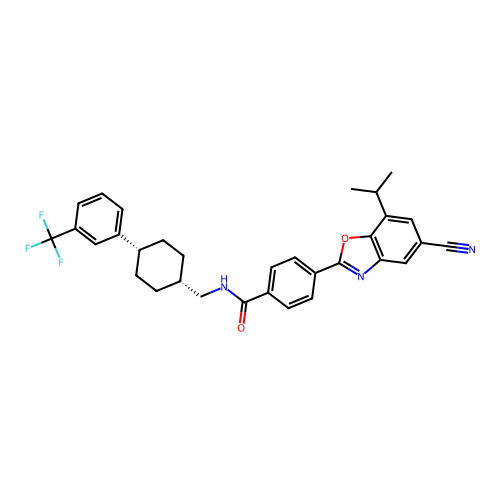

prediction: [9.9986947e-01 1.3055140e-04]
CN(C)C(=O)[C@@H](C1CCC(N(C)C(=O)c2cccc(F)c2)CC1)[C@H](N)C(=O)N1CC[C@H](F)C1


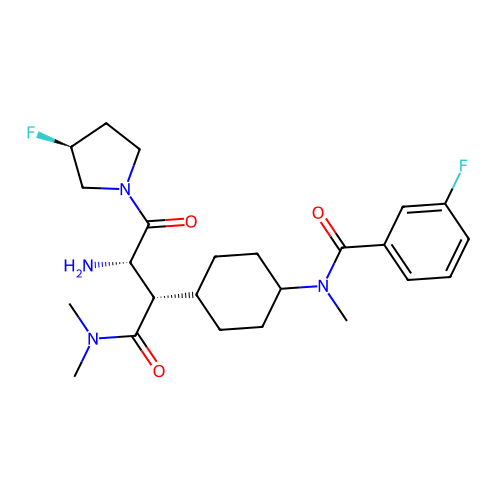

prediction: [9.9986851e-01 1.3148965e-04]
COC1COCCC1N[C@@H]1C[C@H]2C[C@@H](C(N)=O)C[C@@]2(C(=O)N2CCc3ncc(C(F)(F)F)cc3C2)C1


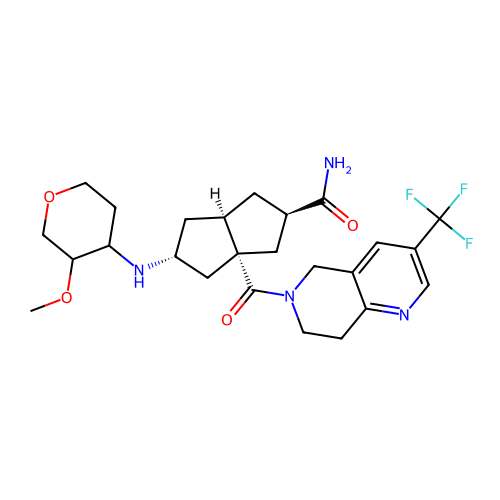

prediction: [9.9986315e-01 1.3688524e-04]
CO[C@@H]1COCC[C@@H]1N[C@@H]1C[C@H]2CCC[C@@]2(C(=O)N2CCc3ncc(C(F)(F)F)cc3C2)C1


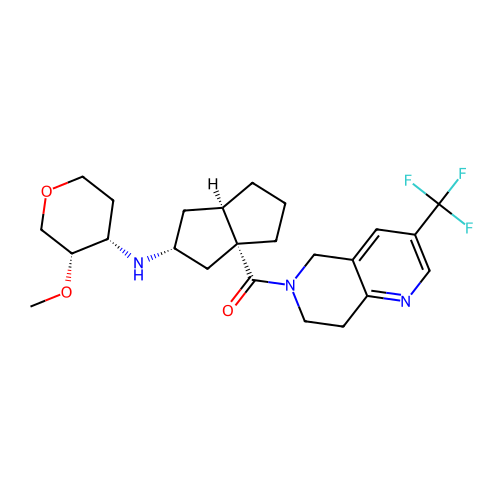

prediction: [9.9985433e-01 1.4566896e-04]
COc1cc2nnc(C(N)=O)c(Nc3ccc(C)cc3F)c2cc1N1CCS(=O)(=O)CC1


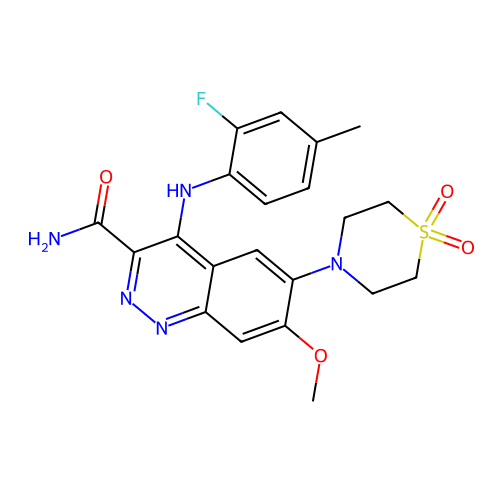

prediction: [9.9982709e-01 1.7294615e-04]
C[S+]([O-])Cc1ccc(C(=O)Nc2cccnc2C(=O)NCC2CCOCC2)c2ccccc12


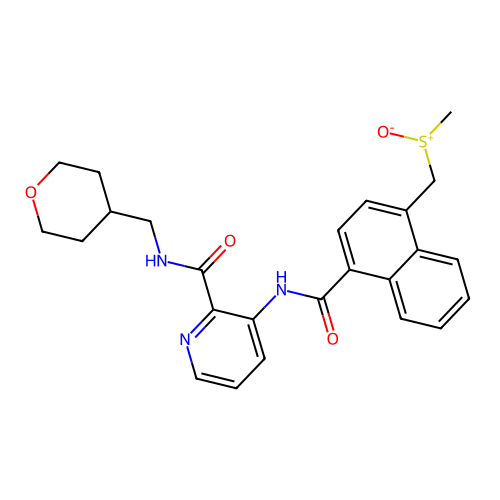

prediction: [9.9981946e-01 1.8058090e-04]
CN(C)c1ccc(NC(=O)NS(=O)(=O)c2ccc(OCCCN3CCCC3)cc2)cc1


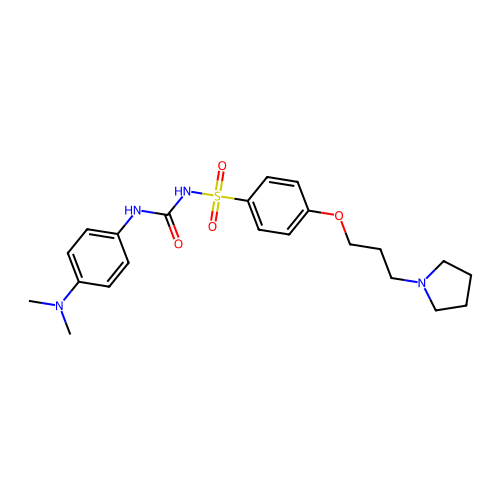

prediction: [9.9979669e-01 2.0333508e-04]
CC(C)c1cc(C#N)cc2nc(-c3ccc(C(=O)NC[C@H]4CC[C@@H](c5cc(C(F)(F)F)cc(C(F)(F)F)c5)CC4)cc3)oc12


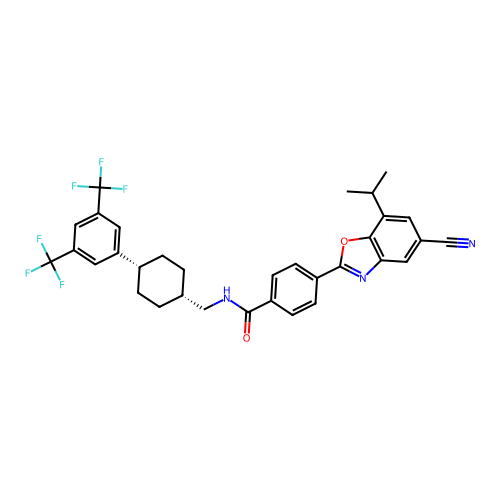

prediction: [9.9978131e-01 2.1870992e-04]
Cc1cccc(C(=O)Nc2cccc(NC(=O)c3ccncc3)c2)c1


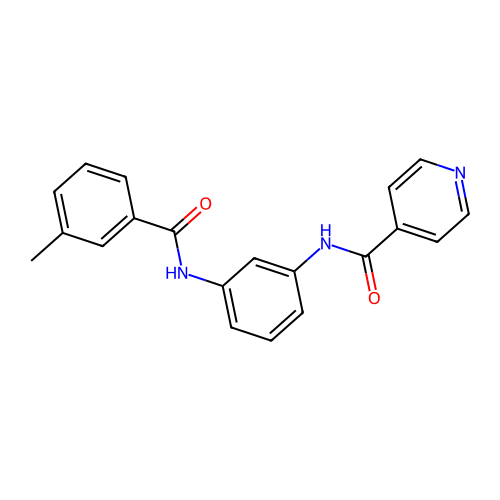

prediction: [9.9977905e-01 2.2090755e-04]
CO[C@@H]1CN(CCn2c(=O)ccc3ccc(C#N)cc32)CC[C@H]1NCc1ccc2c(n1)NC(=O)CO2


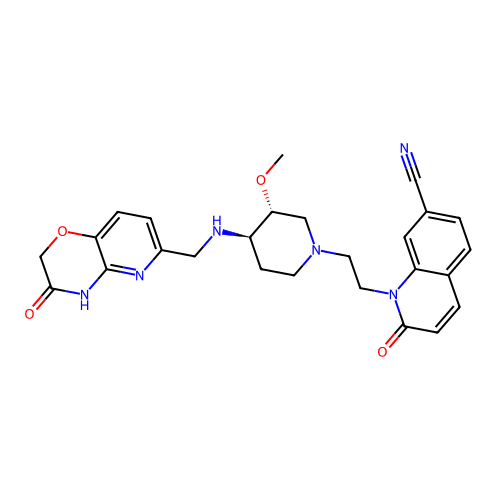

prediction: [9.9977738e-01 2.2257969e-04]
COC1COCCC1N[C@@H]1C[C@H]2CN(c3ncccn3)C[C@@]2(C(=O)N2CCc3ncc(C(F)(F)F)cc3C2)C1


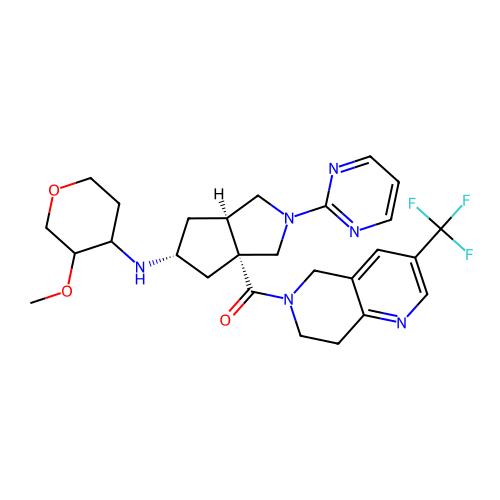

prediction: [9.9977034e-01 2.2964504e-04]
COc1ccc(-c2ccc3c(N4CCOC[C@@H]4C)nc(N4CCOC[C@@H]4C)nc3n2)cc1CO


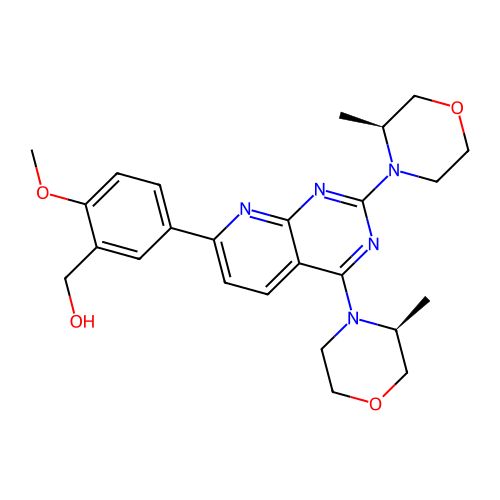

prediction: [9.9976343e-01 2.3657322e-04]
CN(C)c1ccc(/C=C/c2c(F)cccc2F)cn1


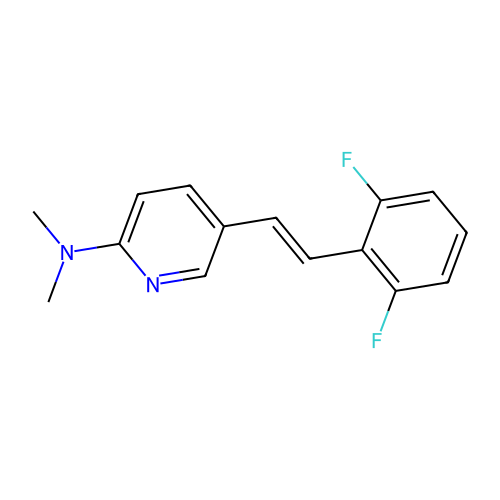

prediction: [9.9975592e-01 2.4404869e-04]
O=C(Nc1ccc(C(F)(F)F)cc1)NS(=O)(=O)c1ccc(OCCN2CCCCC2)cc1


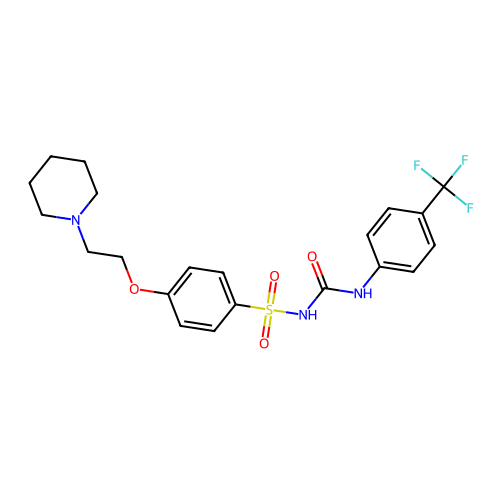

prediction: [9.9975556e-01 2.4438000e-04]
Cc1cccc([C@H]2CC[C@@H](CNC(=O)c3ccc(-c4nc5cc(C#N)cc(C(C)C)c5o4)cc3)CC2)c1


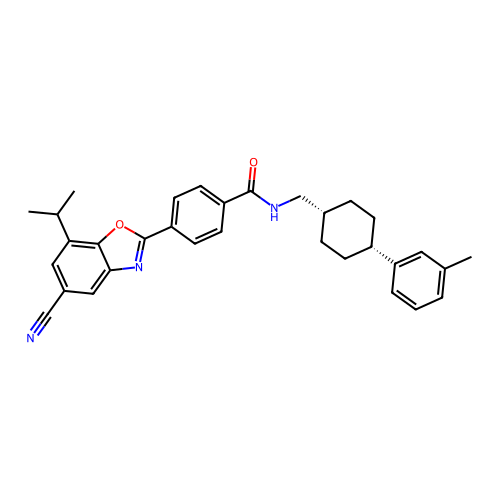

prediction: [9.9974829e-01 2.5175526e-04]
COc1ccc2ncc(=O)n(CCN3CC[C@@H](NCc4cc5c(cn4)OCCO5)[C@H](O)C3)c2c1


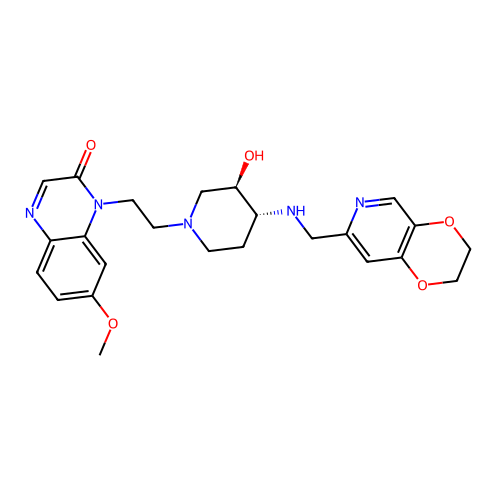

prediction: [9.997446e-01 2.554554e-04]
CN1CCOc2ccc(CNC34CCC(C[C@]5(O)Cn6c(=O)ccc7ncc(F)c5c76)(CC3)OC4)nc21


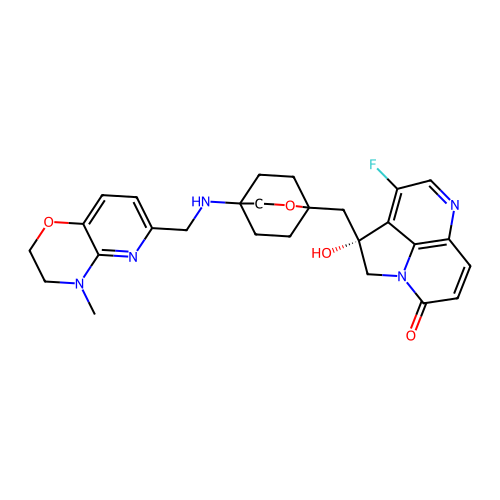

prediction: [9.9971050e-01 2.8947365e-04]
Cc1ccc(C(=O)N2CCN(c3ccc(OC4CCN(C5CCC5)CC4)cc3)C(=O)C2)cc1


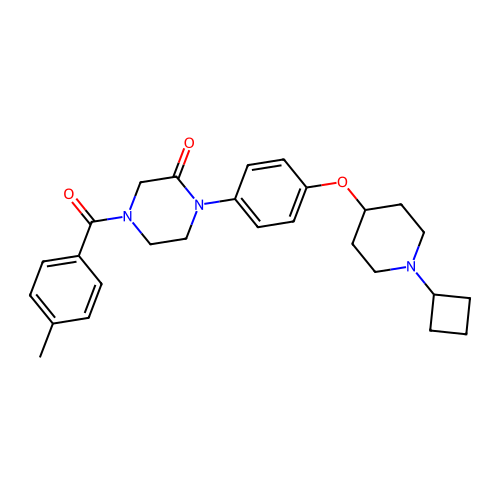

prediction: [9.9968529e-01 3.1468505e-04]
NC1=N[C@@]2(CO1)c1cc(-c3cccnc3F)ccc1Oc1c2cc(-c2cccnc2)nc1F


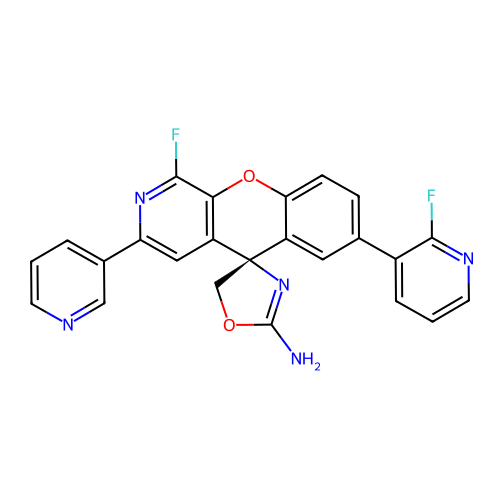

prediction: [9.9968338e-01 3.1661615e-04]
CC(C)(C)Oc1cc([C@H](C2=CNC(C(C)(C)O)S2)c2cc[n+]([O-])cc2)ccc1OC(F)F


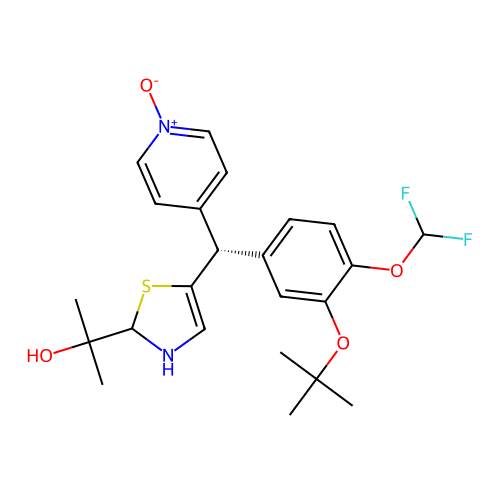

prediction: [9.9967384e-01 3.2619873e-04]
COc1ccc(-c2nc(COc3cccc(CN(CC(=O)O)C(=O)Oc4ccc(C)cc4)c3)c(C)o2)cc1


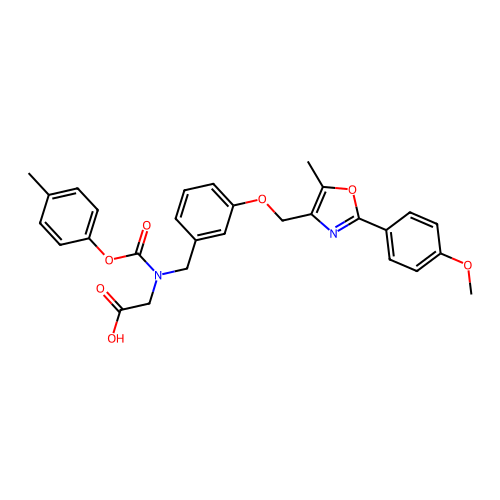

prediction: [9.9966455e-01 3.3547261e-04]
CNC(=O)N1C[C@@H]2C[C@@H](NC3CCOCC3OC)C[C@]2(C(=O)N2CCc3ncc(C(F)(F)F)cc3C2)C1


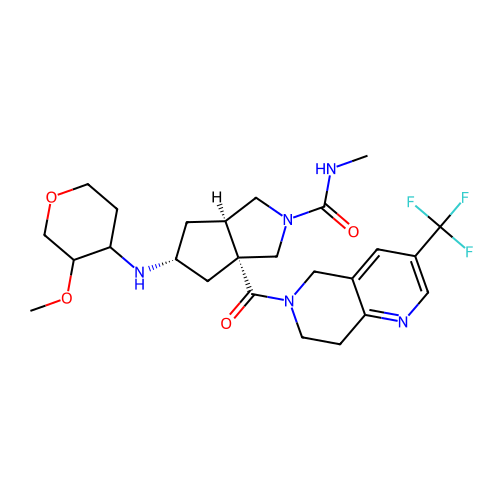

prediction: [9.9966216e-01 3.3785653e-04]
O=C(c1ccc(C(=O)N2CCN(c3ccc(OC4CCN(C5CCC5)CC4)cc3)C(=O)C2)cc1)N1CCC1


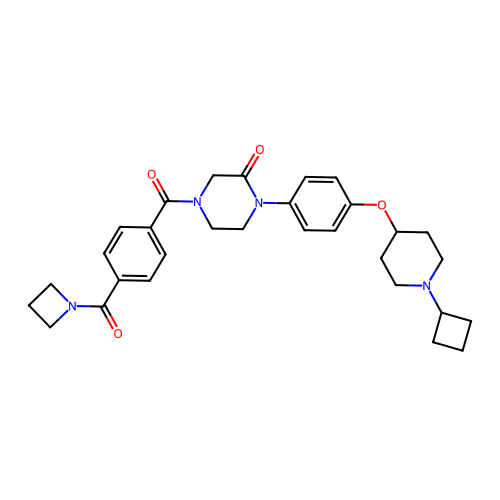

prediction: [9.9965787e-01 3.4209996e-04]
O=C(N1CCc2ncc(C(F)(F)F)cc2C1)[C@@]12CCC[C@@H]1C[C@@H](NC1CCOCC1)C2


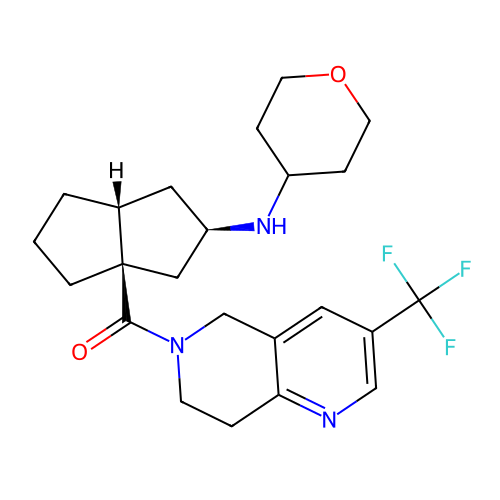

prediction: [9.9964094e-01 3.5909555e-04]
O=C(c1ccc(F)cc1F)N1CCN(c2ccc(OC3CCN(C4CCC4)CC3)cc2)C(=O)C1


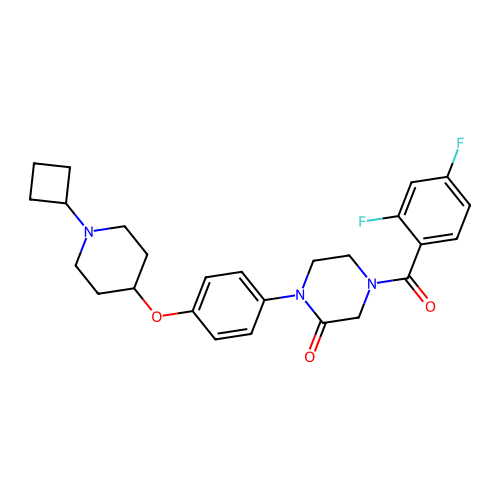

prediction: [9.9963820e-01 3.6180005e-04]
N/C1=N\C(=O)[C@@H]2CCCN2c2ccc(cc2)OC/C=C/CCNCC(=O)Nc2c(Cl)cc(cc2Cl)CN1


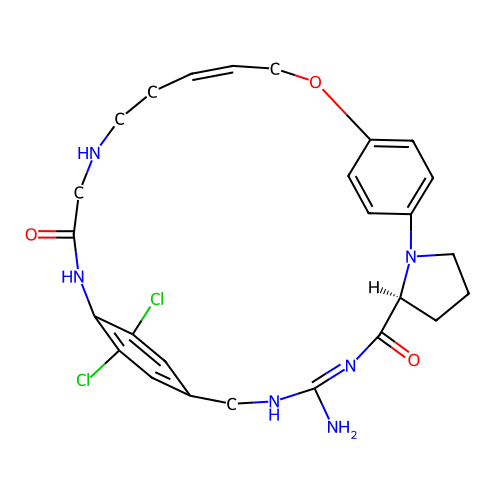

prediction: [9.9961662e-01 3.8332376e-04]
CS(=O)(=O)c1ccc(C(=O)N2CCN(c3ccc(OCCCN4CCCCC4)cc3)C(=O)C2)cc1


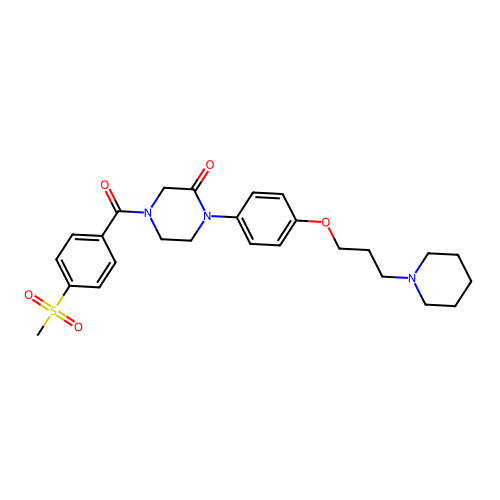

prediction: [9.9960464e-01 3.9533956e-04]
Cc1cnc([C@]2(O)CC[C@H](N3CC(NC(=O)CNC(=O)c4cccc(C(F)(F)F)c4)C3)CC2)s1


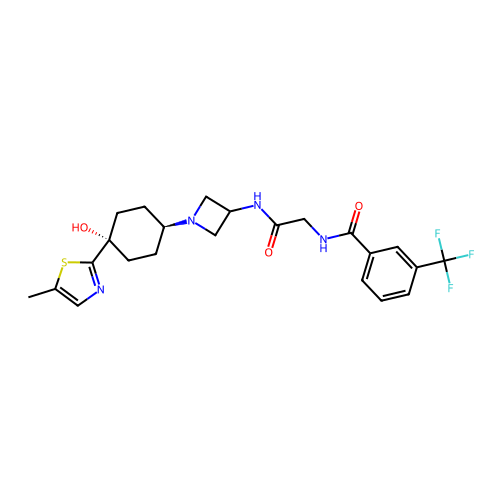

prediction: [9.9959856e-01 4.0142957e-04]
O=C(CNCC1(O)CCCCC1)N1CCc2ccccc2[C@H]1C1CCCCC1


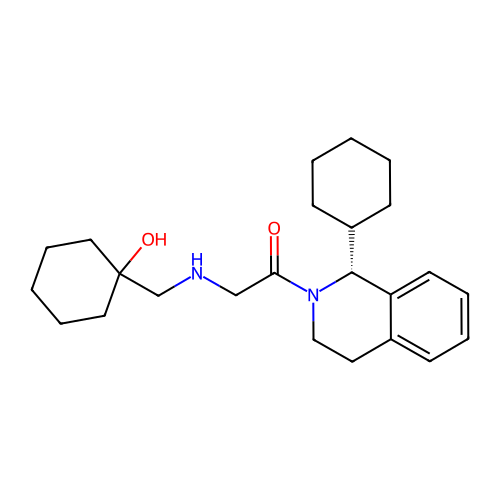

prediction: [9.9959582e-01 4.0415252e-04]
CC(C)n1nc([C@]2(c3cnn(C)c3)N[C@@H](c3nc(-c4ccc(F)cn4)c[nH]3)Cc3c2[nH]c2ccccc32)oc1=O


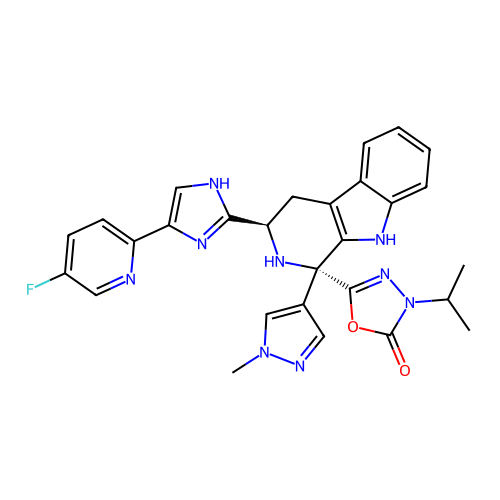

prediction: [9.9958795e-01 4.1207371e-04]
CC(C)(O)c1ccc(-c2cccc(-n3cc(C(=O)NC4CC4)c(=O)c4cccnc43)c2)c[n+]1[O-]


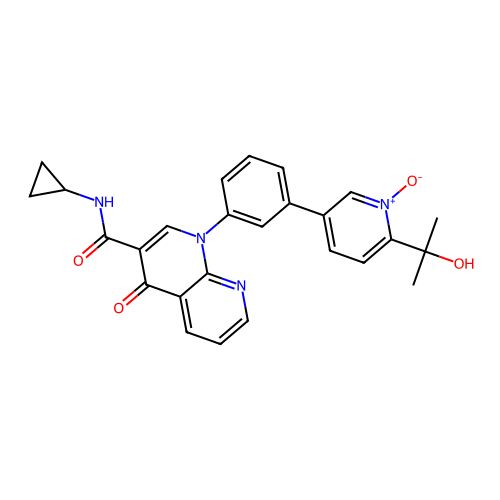

prediction: [9.9957365e-01 4.2639888e-04]
Cc1ccccc1C(=O)N(CC1CCC1)[C@H]1CCNC1


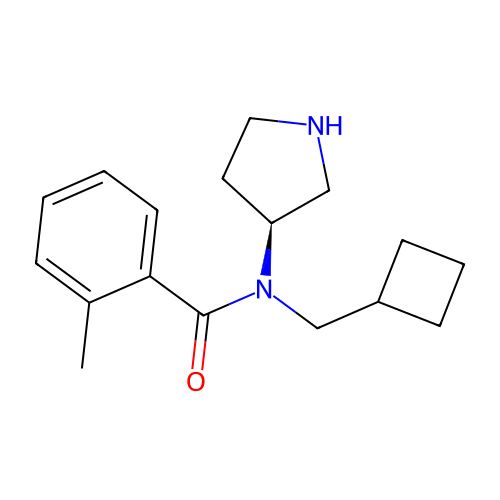

prediction: [9.995621e-01 4.378508e-04]
O=S(=O)(c1cccc2c(O)nccc12)N1CCCNCC1


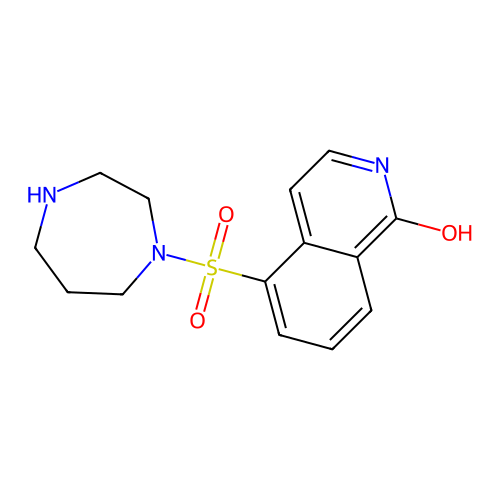

prediction: [9.995579e-01 4.420912e-04]
O=C(CNc1nccc2ncc(C(F)(F)F)cc12)NC1CN([C@H]2CC[C@@](O)(c3cncs3)CC2)C1


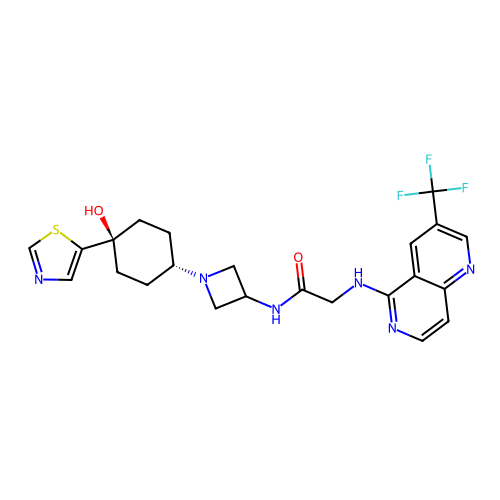

prediction: [9.9955171e-01 4.4822157e-04]
Nc1ccc(-c2cnc3nc(N4CCC(N5CCCCC5)CC4)sc3c2)cn1


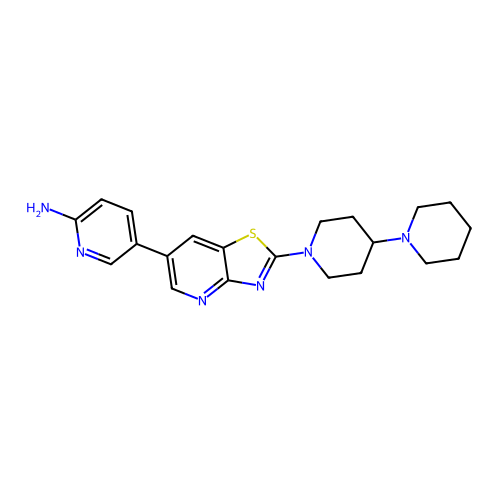

prediction: [9.9954838e-01 4.5164913e-04]
N[C@H]1C[C@@H](N2Cc3cnc(C(F)(F)F)nc3C2)CC[C@@H]1c1cc(F)c(F)cc1F


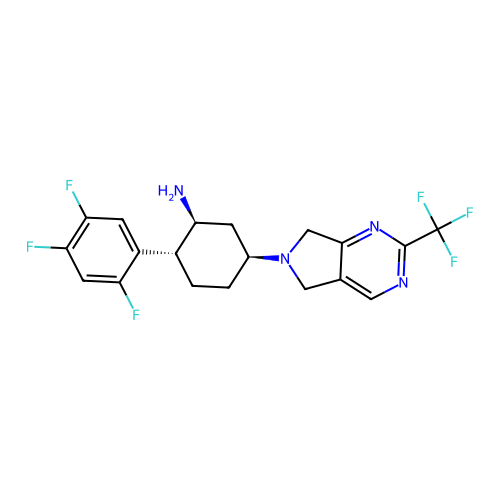

prediction: [9.9953687e-01 4.6314168e-04]
C[C@H]1CCCN1CCCOc1ccc(N2CCN(C(=O)c3ccc(F)cc3)CC2=O)cc1


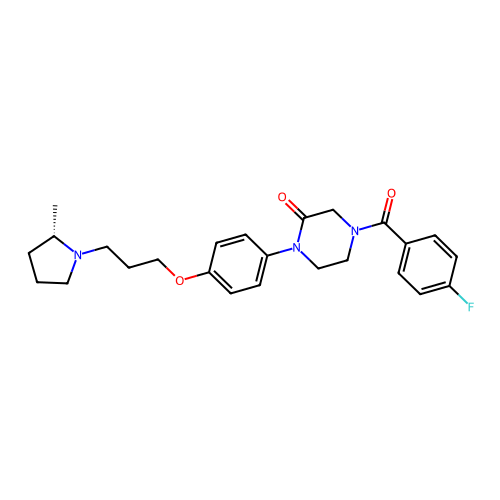

prediction: [9.995116e-01 4.884129e-04]
O=C(Nc1ccccc1)NS(=O)(=O)c1ccc(OCCCCN2CCCCC2)cc1


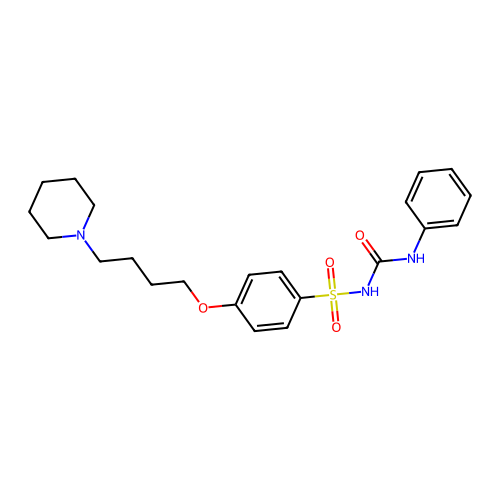

prediction: [9.994598e-01 5.401889e-04]
O=C(c1ccc(C(=O)N2CCN(c3ccc(OCCCN4CCCCC4)cc3)C(=O)C2)cc1)N1CCC1


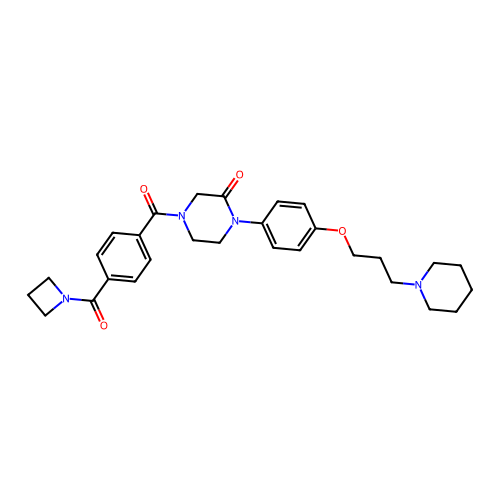

prediction: [9.9945265e-01 5.4732506e-04]
O=C([O-])COCC[NH+]1CC[NH+](C(c2ccccc2)c2ccc(Cl)cc2)CC1


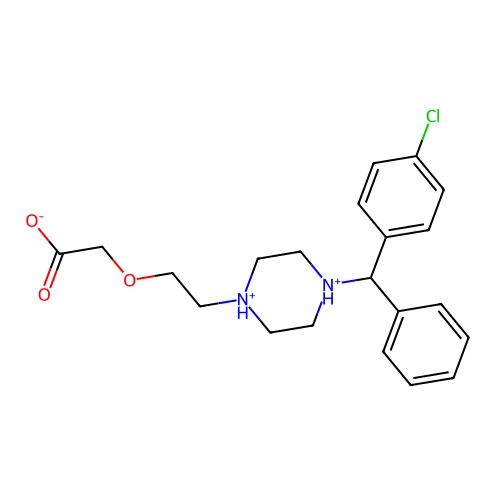

prediction: [9.9942786e-01 5.7214510e-04]
CC(C)N(C)[C@@H]1CC[C@H](N2CC[C@H](NC(=O)c3cccc(C(C)(C)C)c3)C2=O)[C@H](CS(=O)(=O)C(C)C)C1


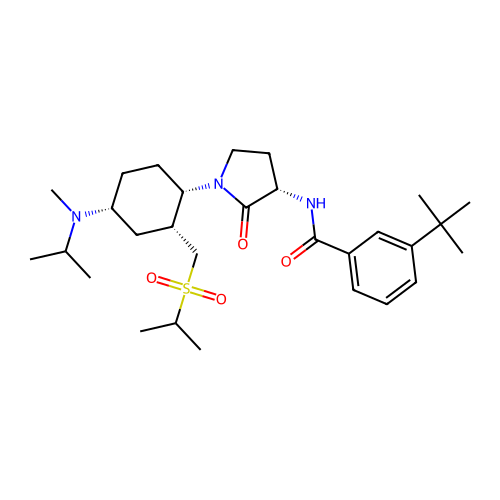

prediction: [9.993907e-01 6.092411e-04]
CN(C)CCC1CCN(c2cc(C(=O)NC[C@H]3CC[C@H](CNC(=O)OC(C)(C)C)CC3)c3ccccc3n2)CC1


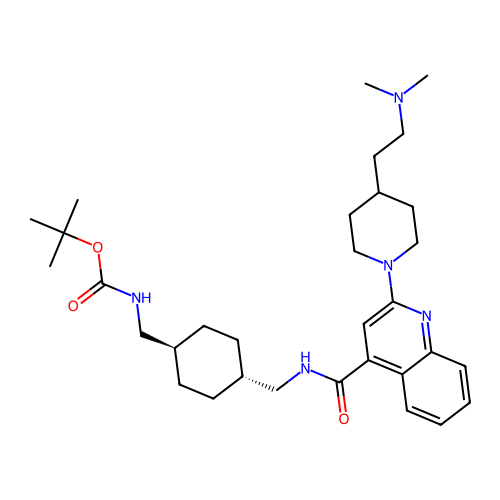

prediction: [9.9938273e-01 6.1725301e-04]
O=C(c1ccccc1C(F)(F)F)N(CC1CCC1)[C@H]1CCNC1


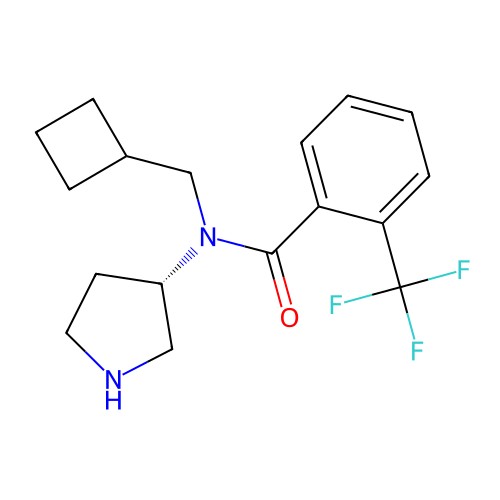

prediction: [9.9936885e-01 6.3118571e-04]
C[C@H]1CCCN1CCCOc1ccc(N2CCN(C(=O)c3ccc(C#N)cc3)CC2=O)cc1


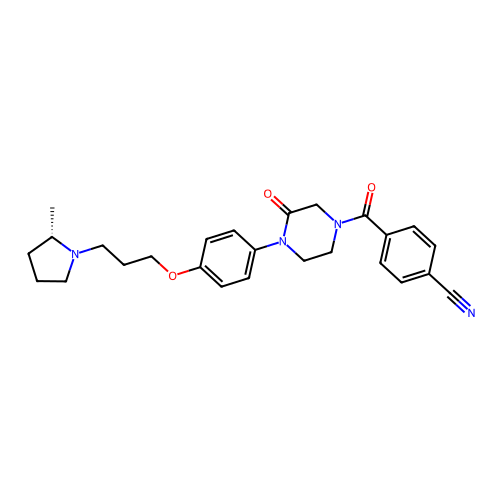

prediction: [9.9935704e-01 6.4292073e-04]
C[C@@H]1CN(c2c(F)c(N)c3c(c2F)[N+](C2CC2)=CC(C(=O)[O-])C3=O)C[C@H](C)[NH2+]1


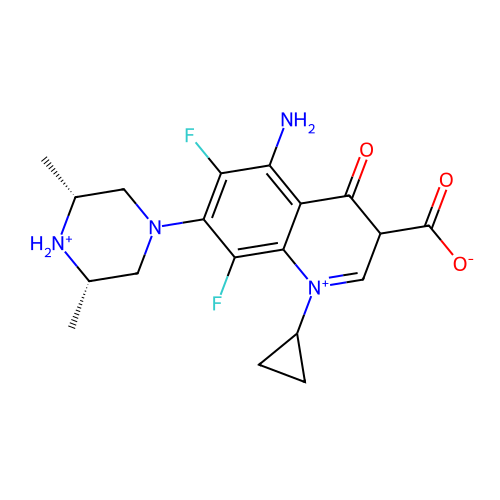

prediction: [9.993267e-01 6.733757e-04]
O=C(c1cnn2cccnc12)N1CCN(c2ccc(OCCCN3CCCCC3)cc2)C(=O)C1


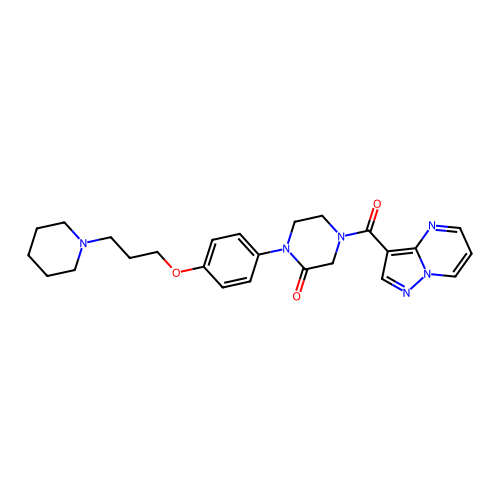

prediction: [9.9931061e-01 6.8937766e-04]
COC1COCCC1N[C@@H]1C[C@H]2C[C@@H](O)C[C@@]2(C(=O)N2CCc3ncc(C(F)(F)F)cc3C2)C1


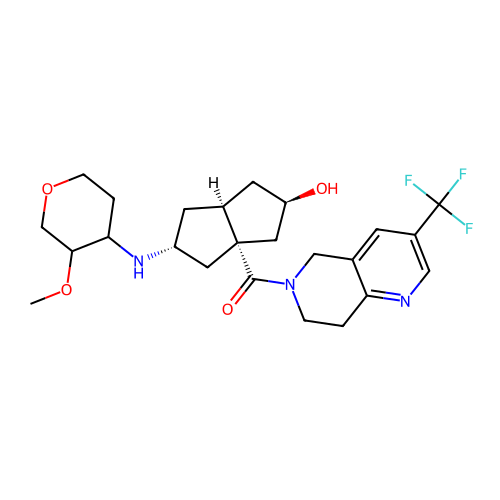

prediction: [9.9928242e-01 7.1761006e-04]
COc1cc(Oc2ccccc2)ccc1-c1nc([C@H]2C[C@@](C)(O)C2)n2ccnc(N)c12


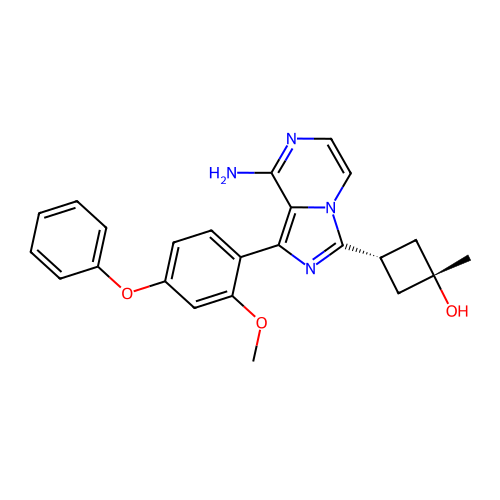

prediction: [9.9923444e-01 7.6552568e-04]
Cc1cc(Cl)ccc1OC1CCN(CC2CCN([C@@H](Cc3ccc(F)cc3)C(=O)O)CC2)CC1


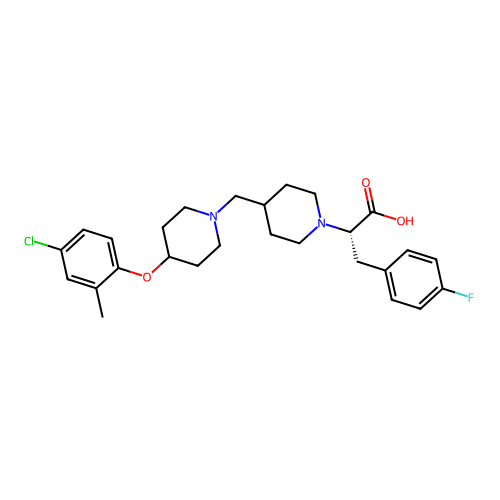

prediction: [9.9922943e-01 7.7062583e-04]
CC(C)N1CCN(Cc2cnc(-c3ccc(C(=O)Nc4ccccc4N)cc3)c(C#N)c2)CC1


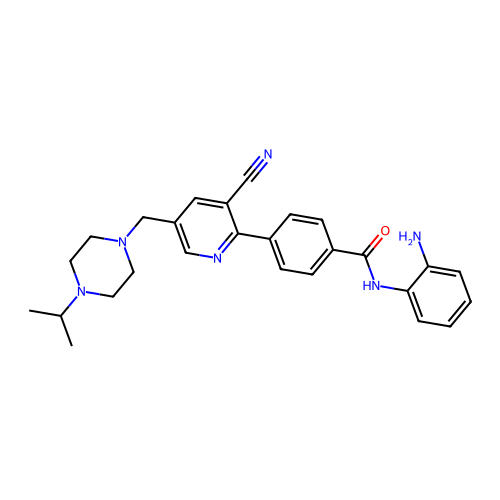

prediction: [9.9919313e-01 8.0692326e-04]
CCOC(=O)C1=C(COCC[NH3+])NC(C)=C(C(=O)OC)C1c1ccccc1Cl


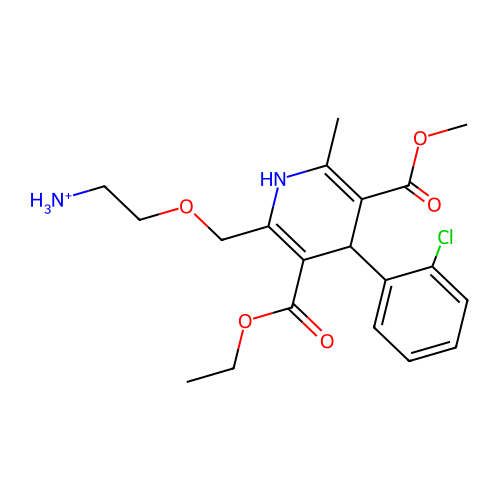

prediction: [9.9909544e-01 9.0452994e-04]
C[C@@H]1CNCCN1c1ccc(=O)n(CCOc2ccccc2C(F)(F)F)n1


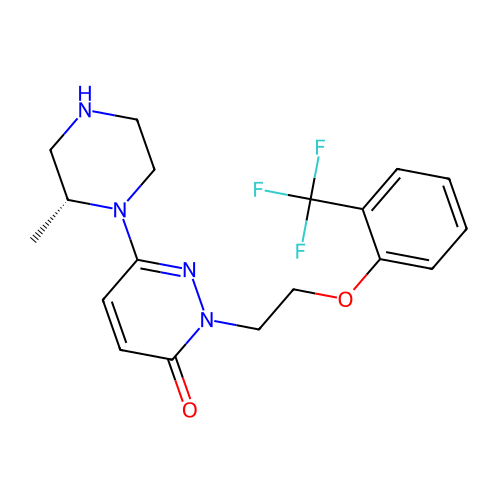

prediction: [9.990828e-01 9.172440e-04]
CN(C)CCC(c1ccc(Cl)cc1)c1ccccn1


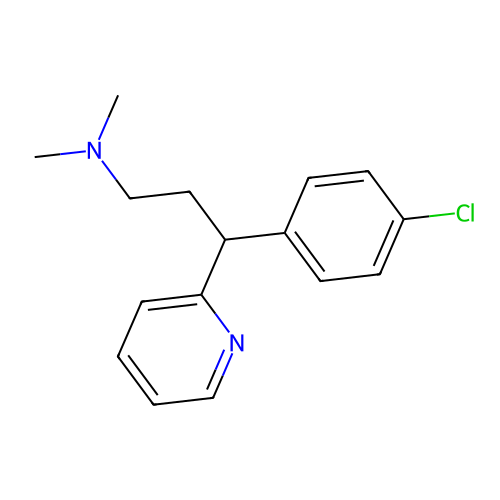

prediction: [9.9904174e-01 9.5825392e-04]
CC(C(=O)O)c1ccc(CN2CCC(COC(=O)c3c4n(c5ccccc35)CCCO4)CC2)cc1


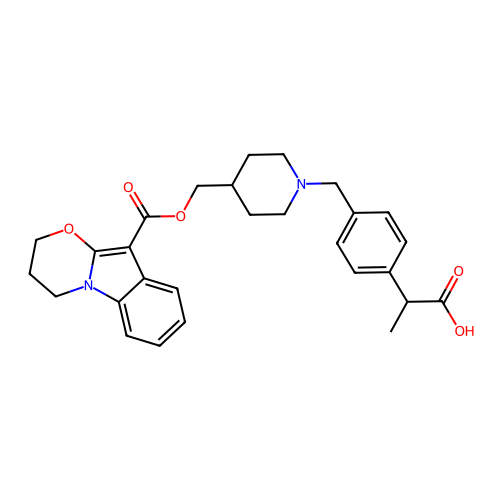

prediction: [9.9904066e-01 9.5926691e-04]
O=S1(=O)CCC(Oc2ccc3c(c2)CCC2(CCN(C4CCC4)CC2)O3)CC1


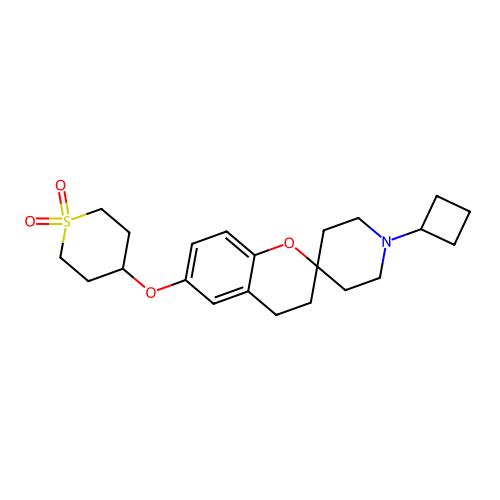

prediction: [9.990243e-01 9.756720e-04]
COC1COCCC1N[C@@H]1C[C@H]2CCC[C@@]2(C(=O)N2CCc3ncc(Br)cc3C2)C1


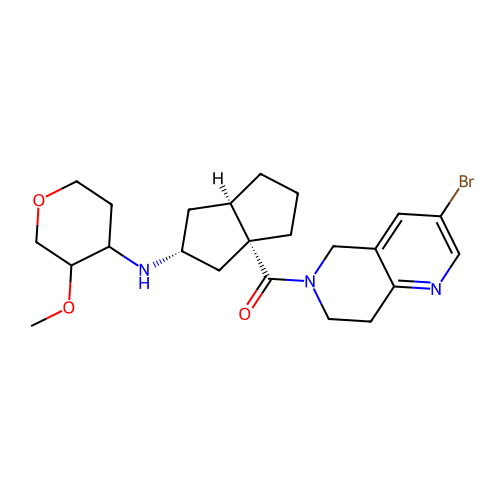

prediction: [0.9989912  0.00100879]
COc1ccc(CCN2C(=O)N(NS(C)(=O)=O)CC2c2ccc(C)c(C)c2)cc1


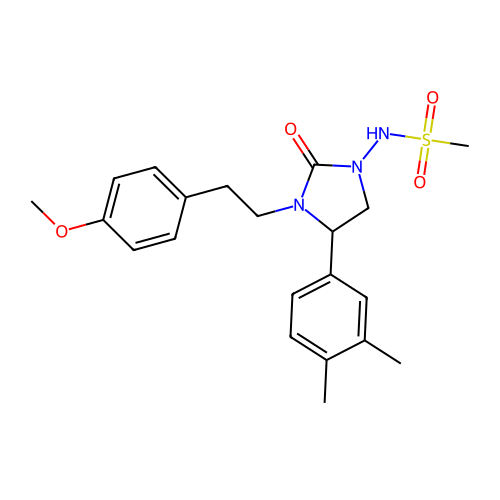

prediction: [0.99895346 0.00104655]
Cc1nc2ccccc2n1C1CC2CCC(C1)N2CCC1(c2ccccc2)CCN(C(=O)c2cccc(S(=O)(=O)N(C)C)c2)CC1


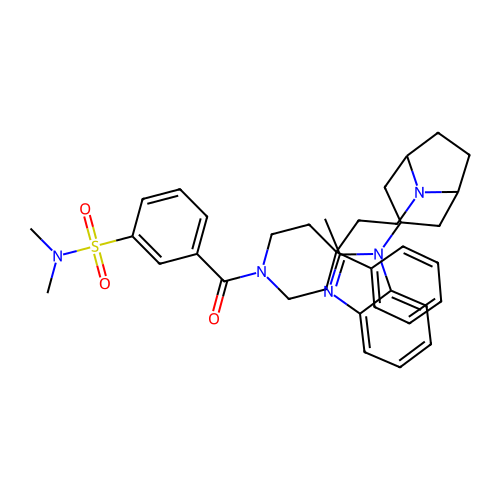

prediction: [0.99891186 0.00108819]
CN1Cc2ccccc2[C@@H](c2ccccc2)N=C1OCc1ccc(NS(C)(=O)=O)cc1


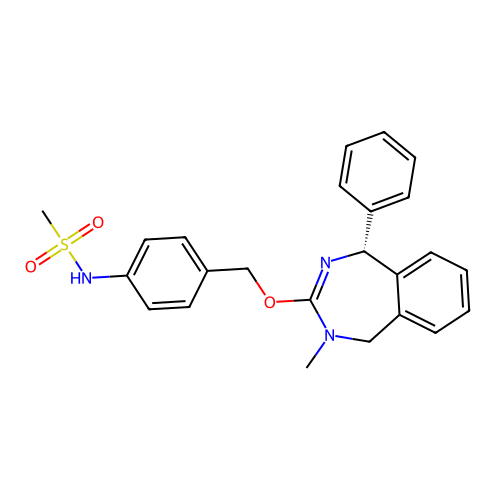

prediction: [0.9989017  0.00109825]
COc1ccc2ncc(=O)n(CCN3CC[C@H](NCc4ccc5c(n4)NC(=O)CO5)[C@@H](F)C3)c2c1


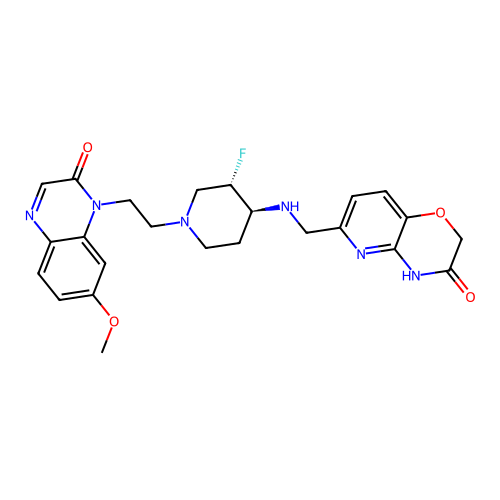

prediction: [0.99889296 0.0011071 ]
COc1cc(N2C(=O)N(c3ccc(-c4ccc(C(=O)O)cc4C)nc3)C(=O)C23CCN(Cc2ncccc2C)CC3)ncn1


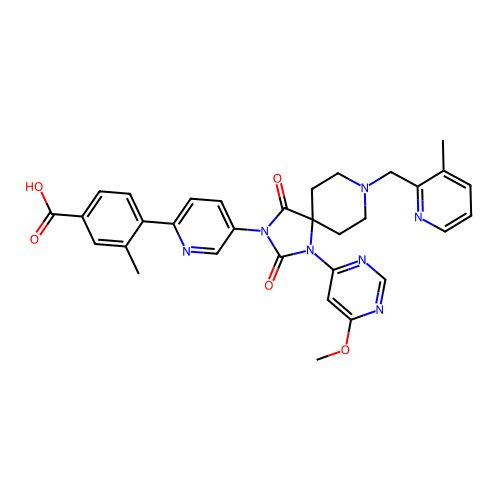

prediction: [0.99886334 0.0011367 ]
N[C@H]1Cn2c(nc3cnccc32)C[C@@H]1c1cc(F)c(F)cc1F


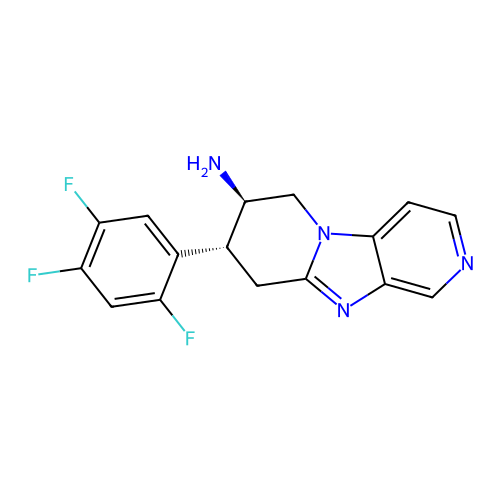

prediction: [0.9987998  0.00120013]
CN(C)C(=O)N[C@H]1CC[C@@H](CCN2[C@@H]3CC[C@H]2C[C@@H](Oc2cccc(C(N)=O)c2)C3)CC1


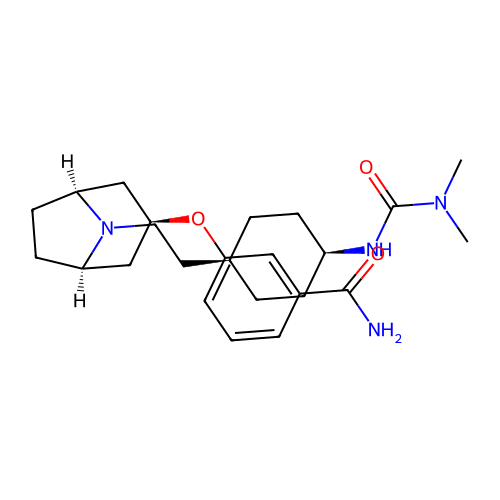

prediction: [0.99877113 0.00122884]
CC(C)NCC(O)COc1cccc2ccccc12


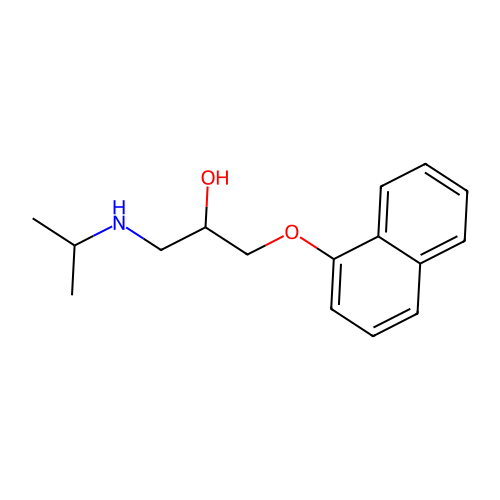

prediction: [0.99877113 0.00122884]
CC(C)NCC(O)COc1cccc2ccccc12


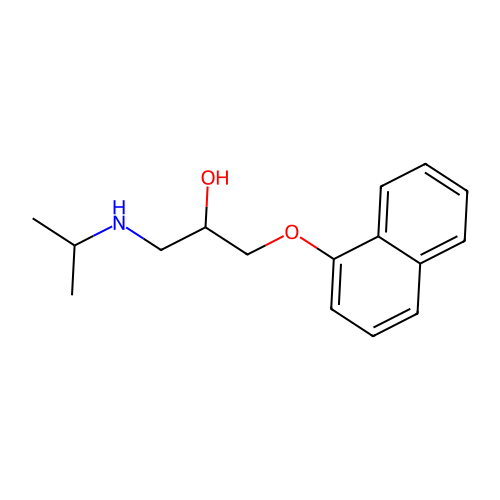

prediction: [0.99872005 0.00128001]
O=C(Nc1ccc(-c2nnc(NCCCN3CCCCC3)o2)cc1)C1CCCCC1


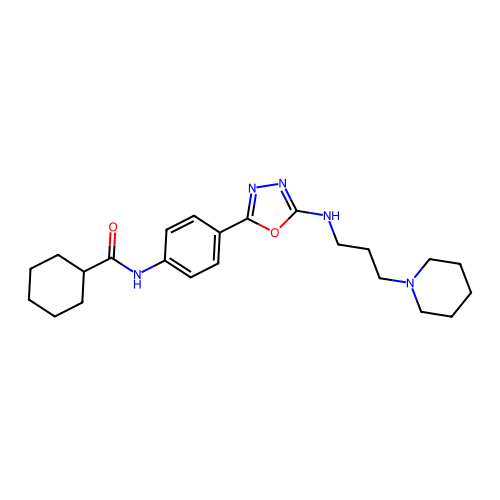

prediction: [0.99867404 0.00132602]
CC(C)COc1ccc(Cl)cc1-c1ccccc1-c1cccc(C(=O)[O-])n1


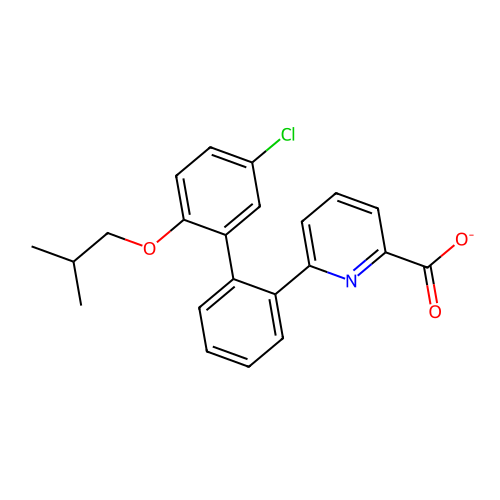

prediction: [0.9986203  0.00137975]
COC1COCCC1N[C@@H]1C[C@H]2CN(C(=O)OCCN3CCCC3)C[C@@]2(C(=O)N2CCc3ncc(C(F)(F)F)cc3C2)C1


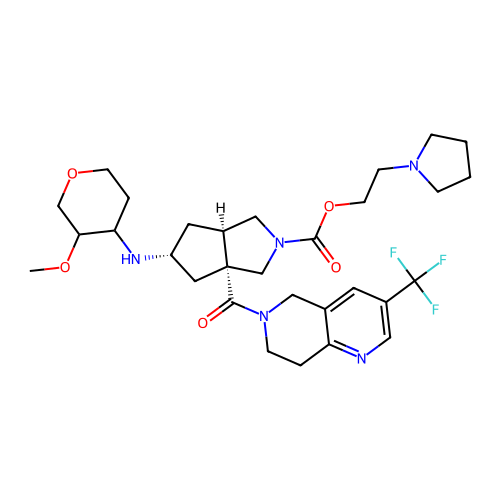

prediction: [0.99860066 0.00139935]
COC(=O)CN1Cc2c(nc(C)c(CN)c2-c2ccc(Cl)cc2Cl)C1=O


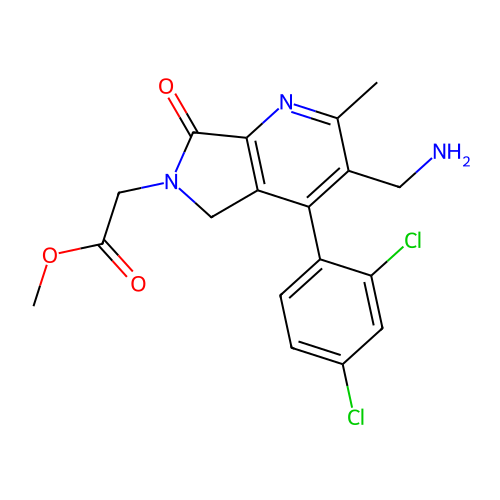

prediction: [0.9985745  0.00142552]
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H]([NH+](C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)C(=NOCOCCOC)[C@H](C)[C@@H](O)[C@]1(C)O


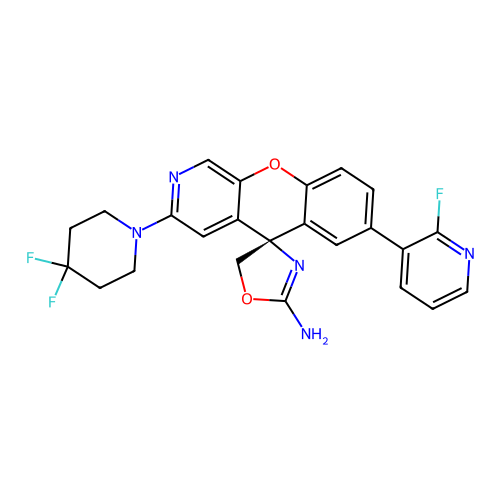

prediction: [0.9985654  0.00143465]
CC(O)(c1ccccc1)c1ccc(C(Cc2cc[n+]([O-])cc2)c2ccc(OC(F)F)c(OC(F)F)c2)cn1


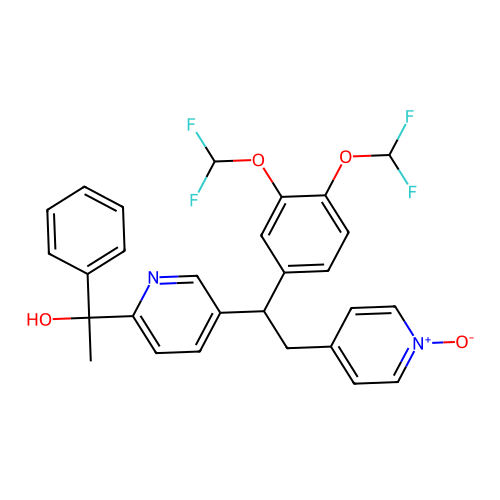

prediction: [0.9985636  0.00143643]
CCN[C@H]1CCC[C@@H](c2c[nH]c3ccc(NC(=N)c4cccs4)cc23)C1


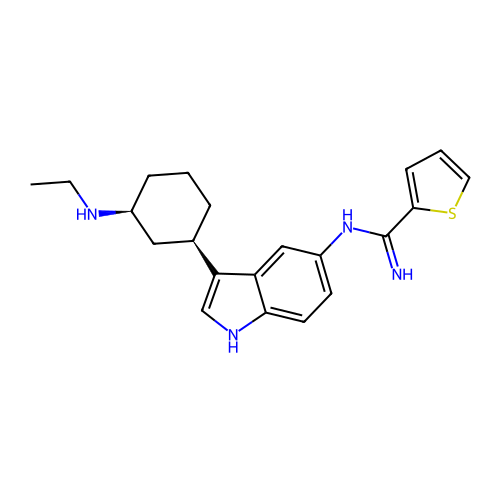

prediction: [0.9985499  0.00145007]
COc1cccc2c1nc(N)n1nc(CN3CCN(c4sc(C)nc4C)C[C@H]3C)nc21


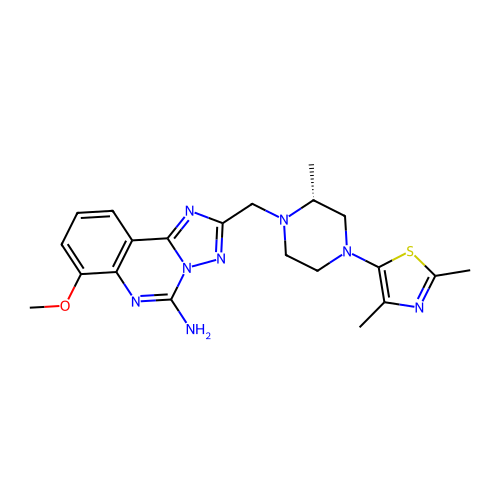

prediction: [0.99854183 0.00145823]
Cc1noc(-c2nnc3n2CCN(C(=O)c2ccc(-c4cccs4)cc2)[C@@H]3C)n1


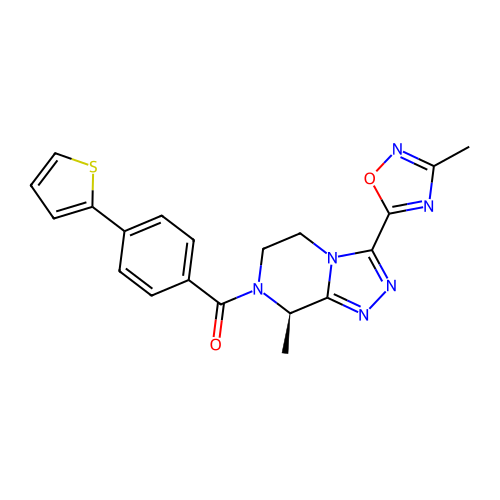

prediction: [0.99851125 0.00148874]
CCOc1ccc(-n2ncc(-c3ccc4cc(CCN5CCC[C@H]5C)ccc4n3)c2C)nn1


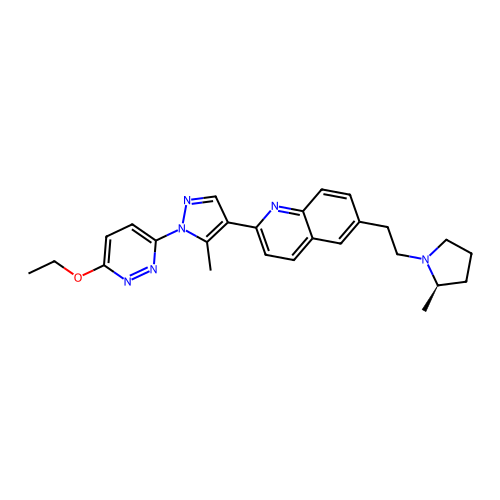

prediction: [0.9984635  0.00153647]
OCC[C@]1(c2ccc(Cl)c(Cl)c2)CCCNC1


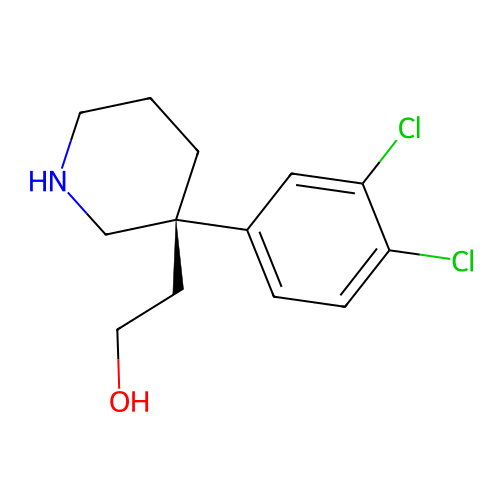

prediction: [0.9984308  0.00156916]
CCCS(=O)(=O)n1c2c(c3cc(C(=O)N4CCC(C)CC4)ccc31)CN(C1CCOCC1)CC2


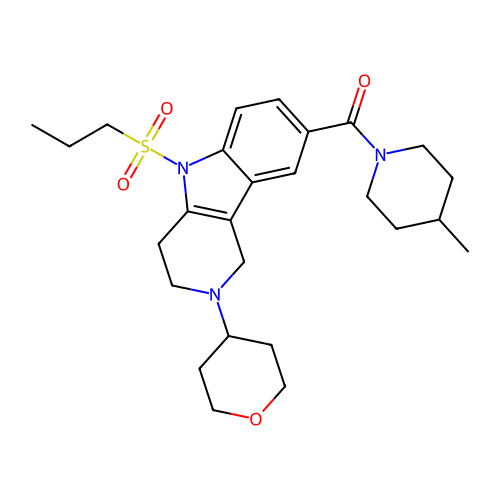

prediction: [0.9984255  0.00157449]
COc1ccc(C(=O)CSc2nnc(-c3ccco3)n2C(C)C2CC3CCC2C3)cc1


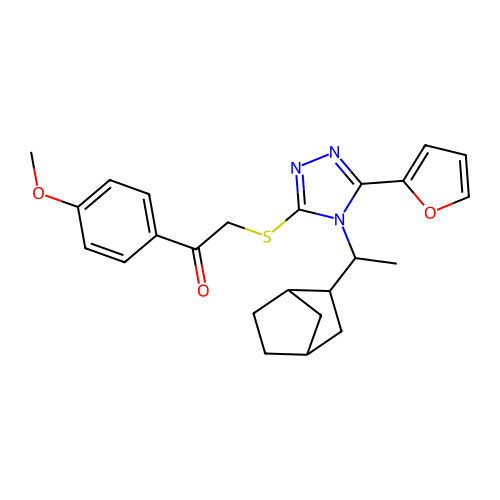

prediction: [0.99836236 0.00163763]
COc1ccc([C@]2(O)CC[C@@H](N3CC(NC(=O)CNC(=O)c4cccc(C(F)(F)F)c4)C3)CC2)cc1


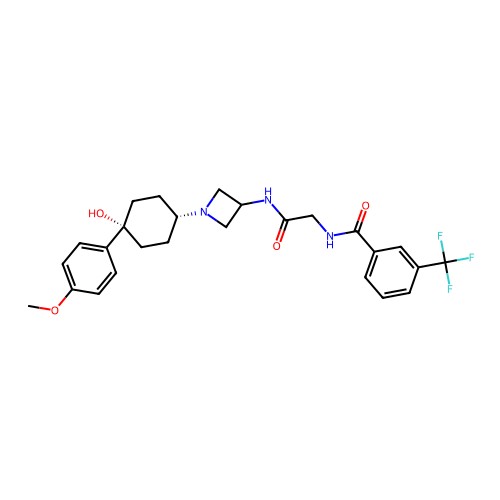

prediction: [0.9982345  0.00176546]
N#Cc1ccc(N2N=C(c3ccc4[nH]c(=O)oc4c3)CC2c2ccc(C(=O)O)cc2)cc1


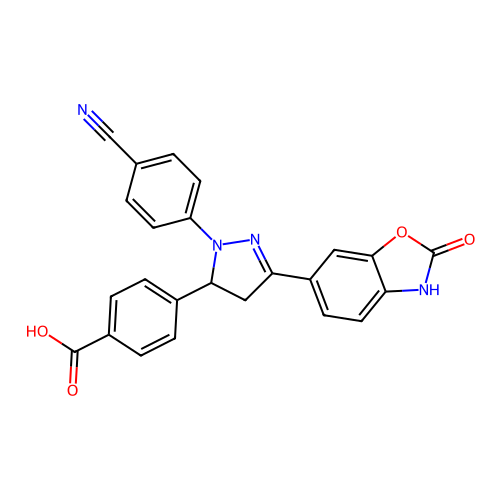

prediction: [0.9982292  0.00177083]
O=C(Nc1cc(Cl)ccc1Cl)NS(=O)(=O)c1ccc(OCCCN2CCCCC2)cc1


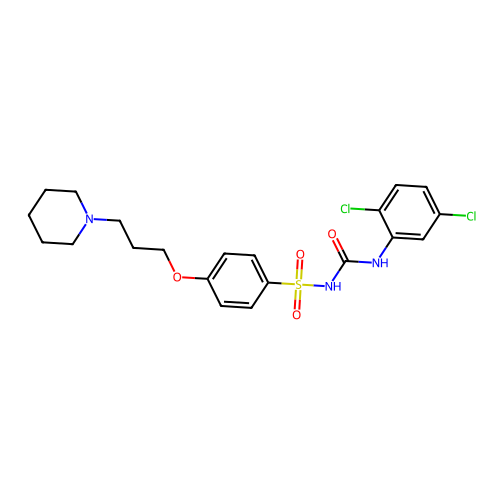

prediction: [0.99821305 0.00178691]
N[C@H](C(=O)N1CC[C@H](F)C1)[C@H]1CC[C@H](NC(=O)c2ccc(F)c(F)c2)CC1


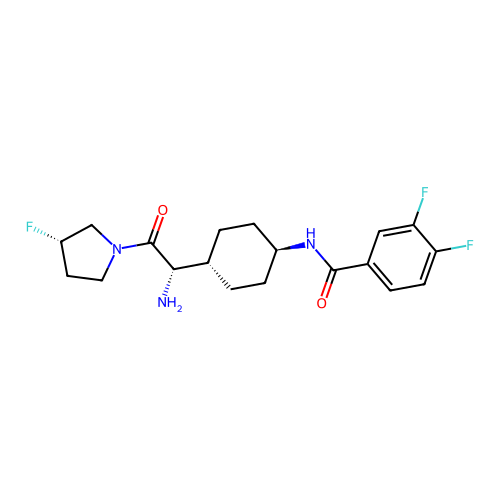

prediction: [0.9981871  0.00181288]
CC(C)C(=O)N(Cc1ccc(Cl)c(Cl)c1Cl)[C@H]1CCNC1


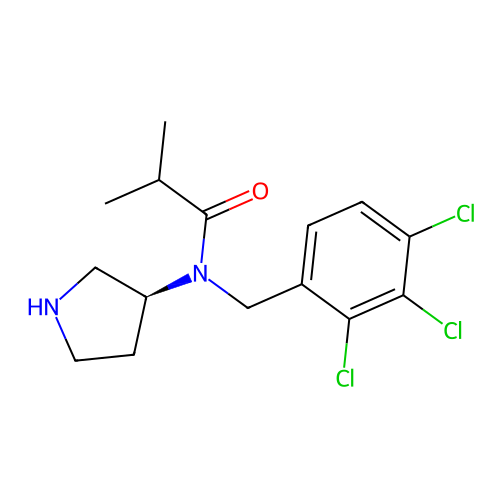

prediction: [0.9981816  0.00181843]
CS(=O)(=O)c1cccc(-c2ccc3ncc(-c4ccc(C(=O)N5CCC(O)C5)cc4)n3n2)c1


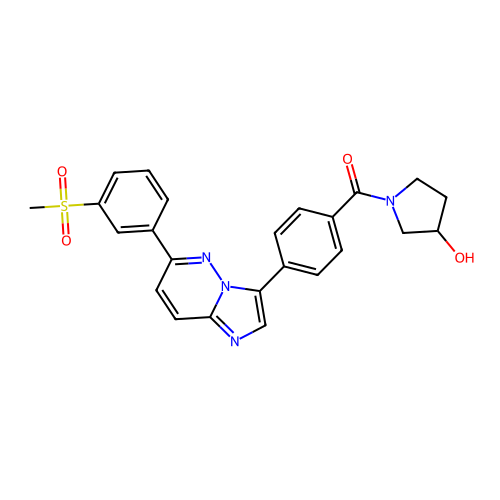

prediction: [0.99816614 0.00183386]
OCC[C@@]1(c2ccc(Cl)c(Cl)c2)CCCNC1


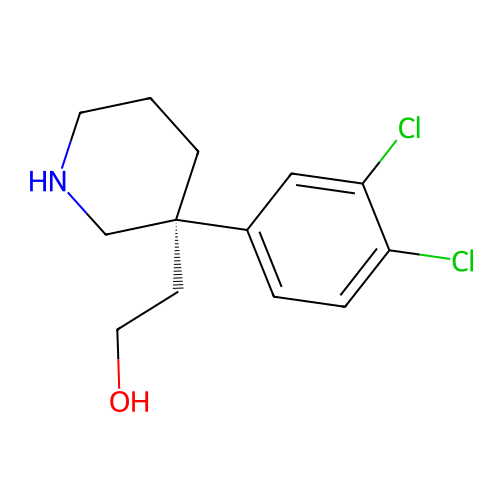

prediction: [0.9981629  0.00183712]
CC1(C)Cc2cccc(CN3CCC4(CC3)CCN(C(=O)c3ncccc3N)CC4)c2O1


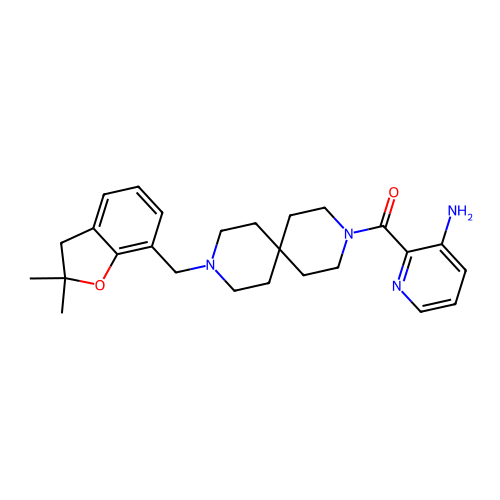

prediction: [0.9979942  0.00200583]
N=C(Nc1ccc2c(c1)CCCN2CCCNCCO)c1cccs1


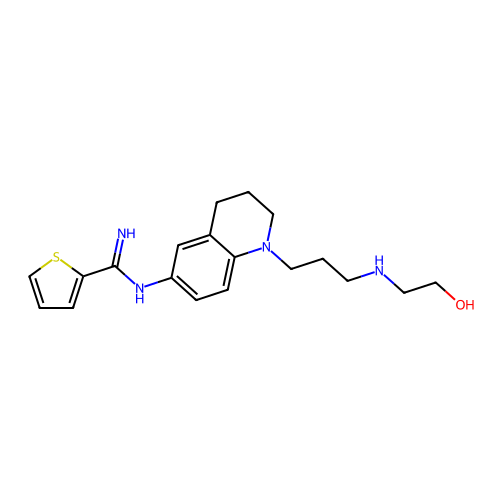

prediction: [0.99798226 0.00201773]
OC(c1cccnc1)(c1cccnc1)C(Cc1ccccc1)N1CCOCC1


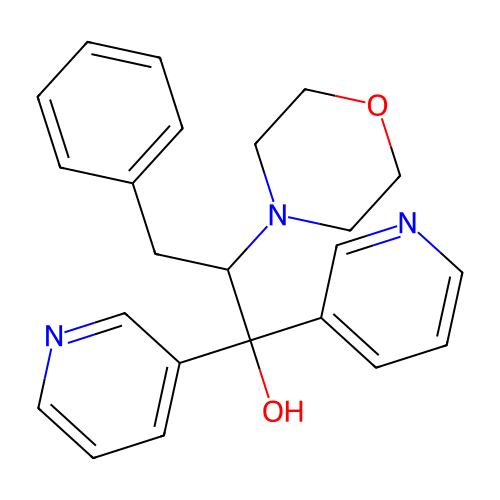

prediction: [0.99796474 0.0020353 ]
COC(=O)C1=CC[C@@H]2CC[C@H]1N2C


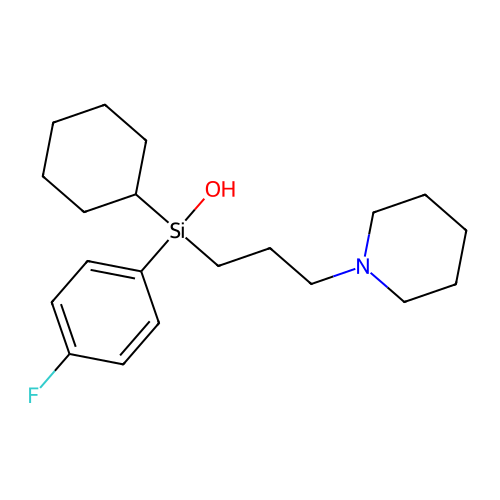

prediction: [0.99793315 0.00206685]
O=c1ccc2ncc(F)c3c2n1C[C@@]3(O)CC12CCC(NCc3cc(Cl)c4c(c3Cl)OCCO4)(CC1)CO2


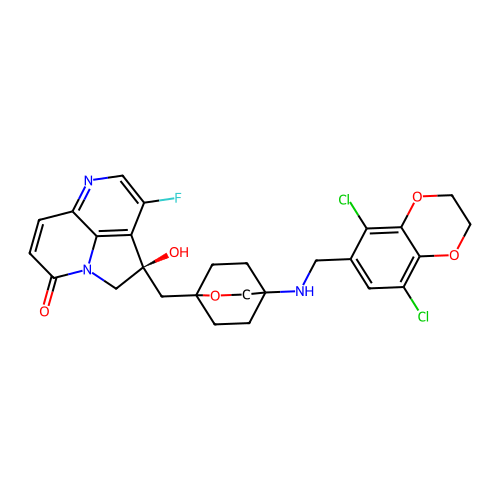

prediction: [0.99785066 0.00214935]
CCCn1c(SCC(N)=O)nc2c(c1=O)C1(CCCC1)Cc1ccccc1-2


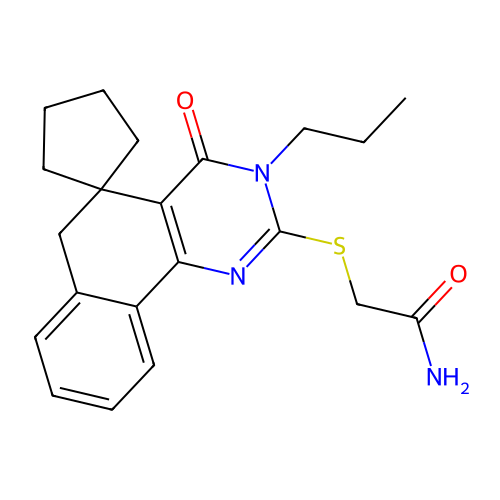

prediction: [0.99779946 0.00220053]
CC(C)N1CCN(C(=O)N2CC=C(c3ccccc3)CC2)CC1


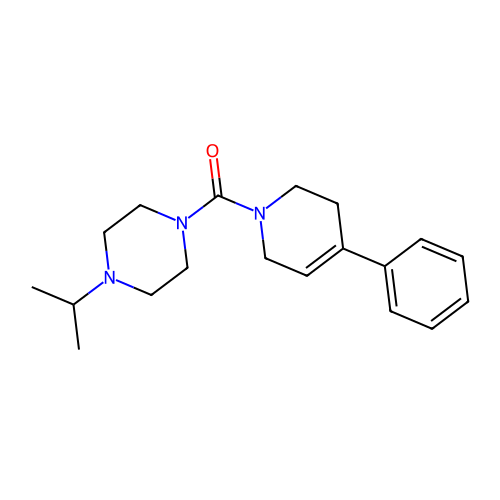

prediction: [0.99776804 0.00223194]
N[C@@H]1CO[C@H]1COc1ccc2ncc(F)c(CCC34CCC(NCc5ccc6c(n5)NC(=O)CO6)(CC3)CO4)c2n1


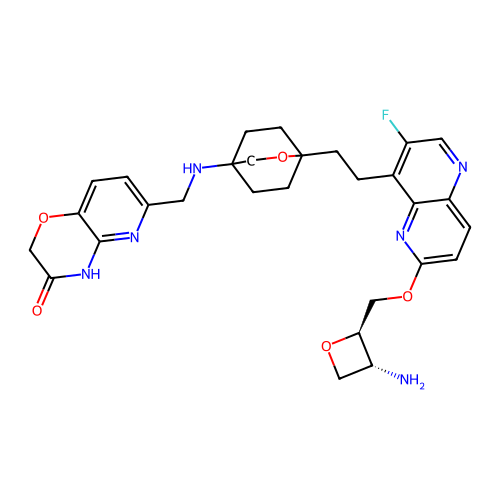

prediction: [0.9977585  0.00224147]
O=C(O)c1ccc(C2CCN([C@@H]3C[C@H]4OCC[C@@]4(C(=O)N4CCc5ncc(C(F)(F)F)cc5C4)C3)CC2)cc1


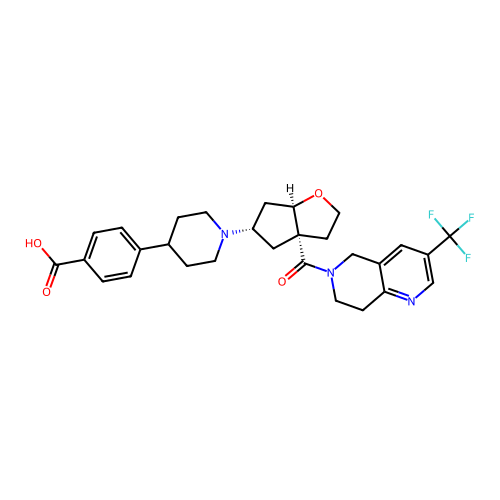

prediction: [0.9976513  0.00234878]
CC(C)N(CCC(C(N)=O)(c1ccccc1)c1ccccn1)C(C)C


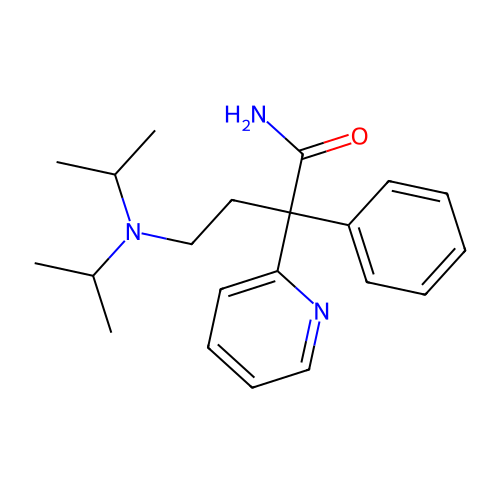

prediction: [0.997463   0.00253703]
COc1cc(F)ccc1-c1cncc(CNC(=O)C2CC2)c1


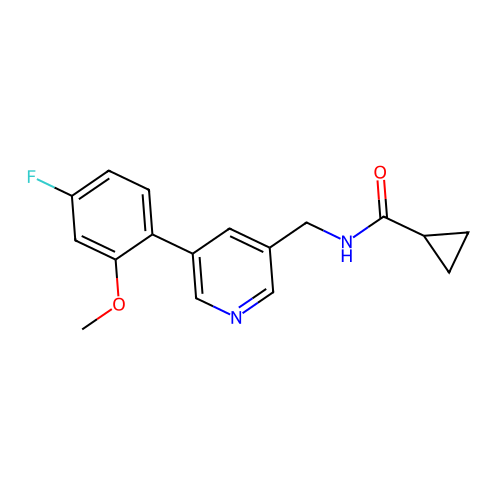

prediction: [0.997408 0.002592]
Cc1cc(CN2CCN(C(C)C)CC2)cnc1-c1ccc(C(=O)Nc2ccccc2N)cc1


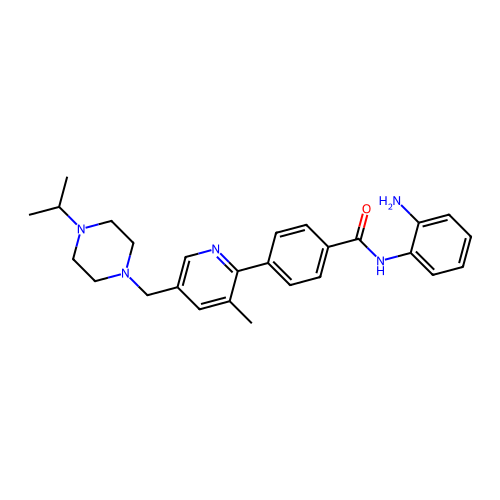

prediction: [0.99723417 0.00276582]
N#Cc1ccc(C(=O)N2CCN(c3ccc(OC4CCN(C5CCC5)CC4)cc3)C(=O)C2)cc1


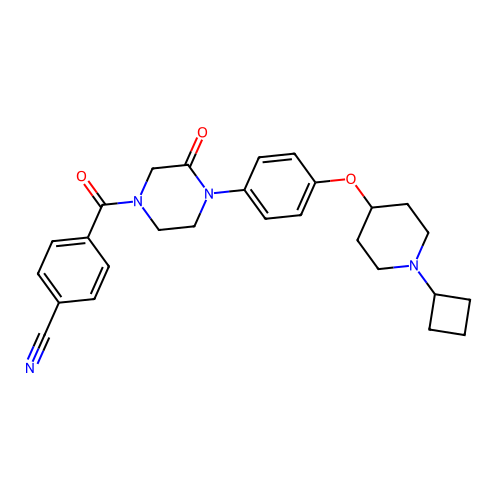

prediction: [0.99710864 0.00289135]
O=C(c1ccc(F)cc1)N1CCN(c2ccc(OCCCN3CCCC3)cc2)C(=O)C1


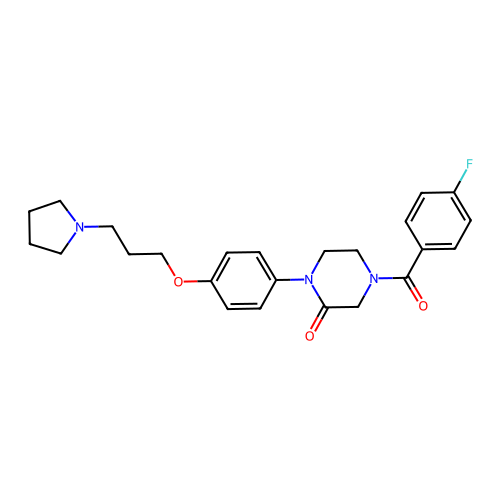

prediction: [0.9970583  0.00294177]
COc1ccc(CNC(=O)/C=C/c2ccc3[nH]cc(CCN(C)C)c3c2)cc1


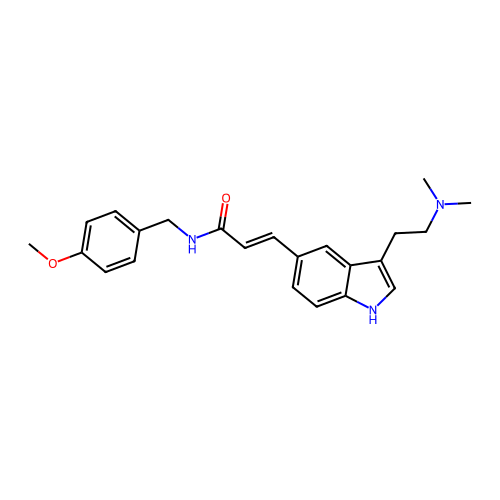

prediction: [0.9968917  0.00310835]
O=C(Nc1cccc([C@@H](c2ccc(C(=O)N3CCC3)cc2)N2CCN(Cc3ccc(F)cc3)CC2)c1)C1CC1


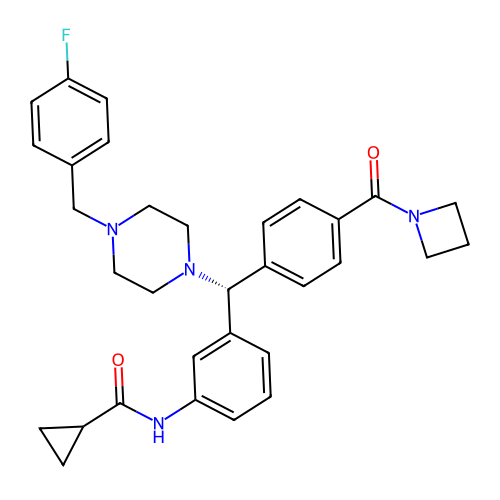

prediction: [0.99683064 0.00316933]
COc1ncc(-c2cccc3c2C[C@H](NC(=O)c2ccc(COCC(F)(F)F)nc2)CO3)cn1


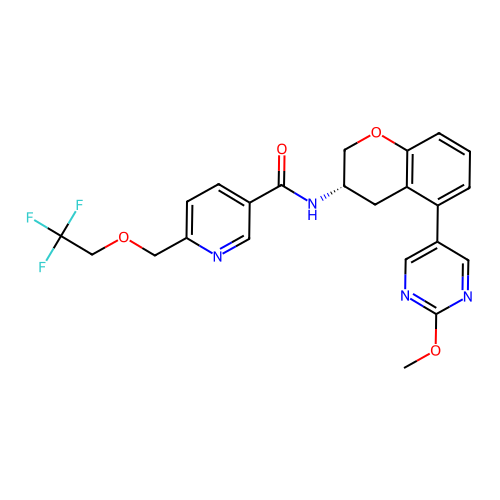

prediction: [0.996673   0.00332701]
CC(C)N1CCC(Oc2ccc(N3CCN(C(=O)c4cc(F)cc(F)c4)CC3=O)cc2)CC1


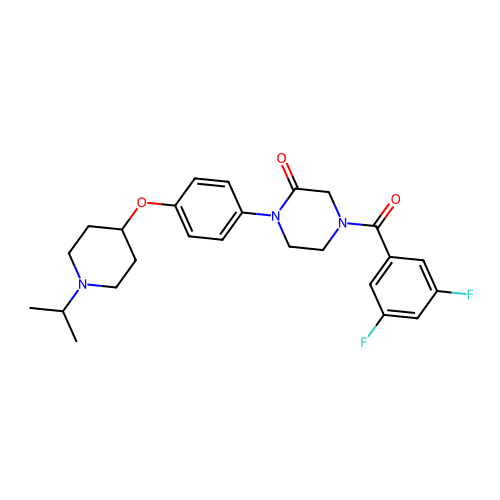

prediction: [0.99639064 0.00360937]
COc1ccc2nccc(NC(=O)[C@]3(O)CC[C@@H](NCc4cc5c(cn4)OCCO5)CC3)c2n1


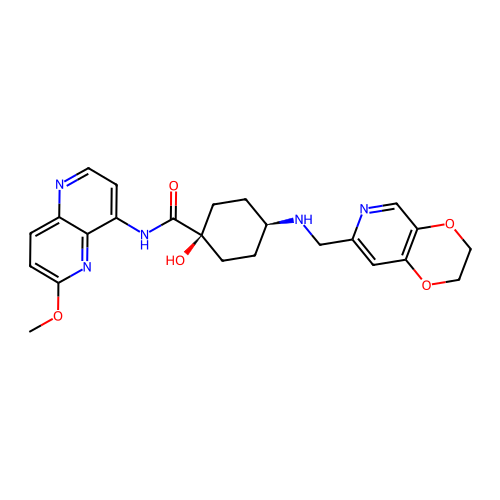

prediction: [0.9963689  0.00363112]
O=C(C1CC2(CCN(c3ccccc3)CC2)C1)N1CCN(C2CCC2)CC1


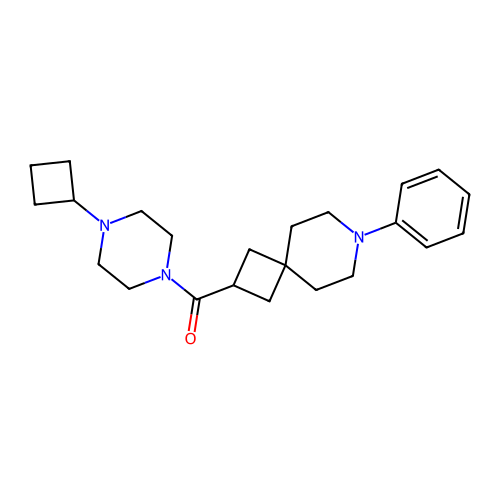

prediction: [0.99594104 0.00405897]
CN(C)CCC(NC(=O)C1(N)CCN(c2ncnc3[nH]ccc23)CC1)c1ccc(Cl)cc1


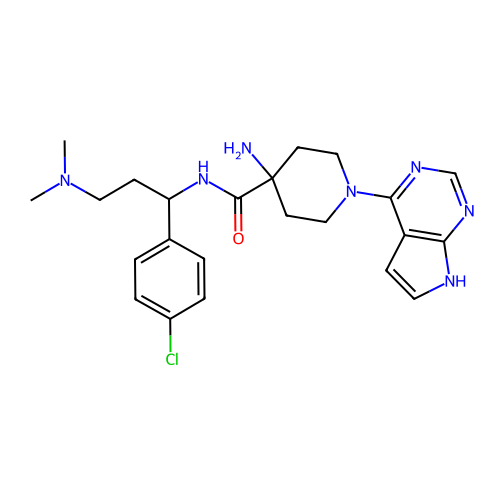

prediction: [0.99584925 0.00415071]
COC(=O)CCCN1CCC(CN2CCC(Oc3ccc(CO)c(Cl)c3)CC2)CC1


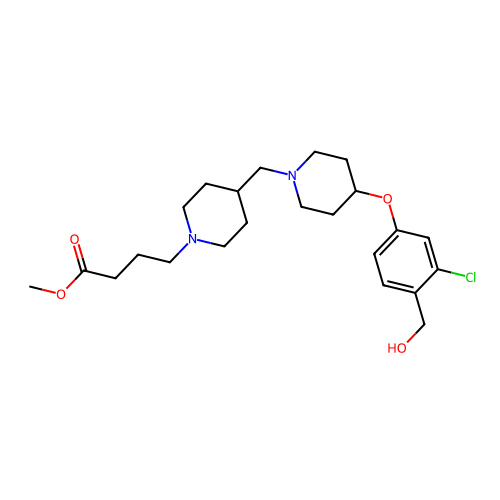

prediction: [0.99584156 0.00415837]
Cn1cc(-c2cnc3ccc4ccc(NS(C)(=O)=O)cc4c(=O)c3c2)cn1


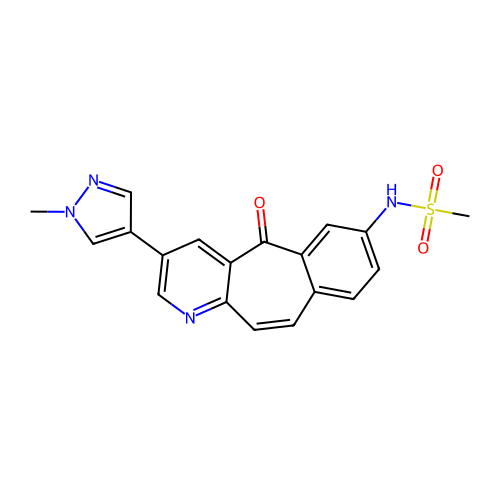

prediction: [0.99583995 0.00416012]
c1ccc2cc(CO[C@H]3CCNC3)ccc2c1


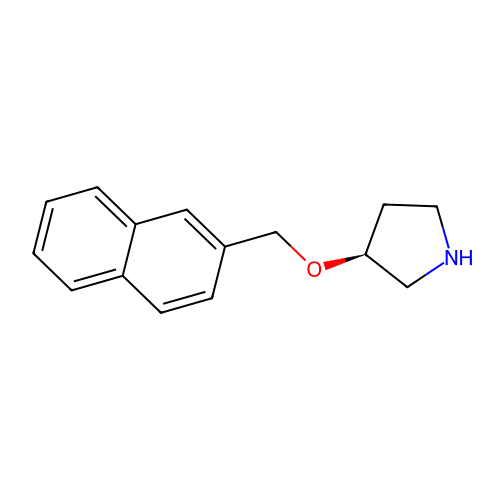

prediction: [0.9958253  0.00417472]
COc1ccc2c(c1)N(CCN1CCC(NCc3cc4c(cn3)OCCO4)CC1)C(=O)CO2


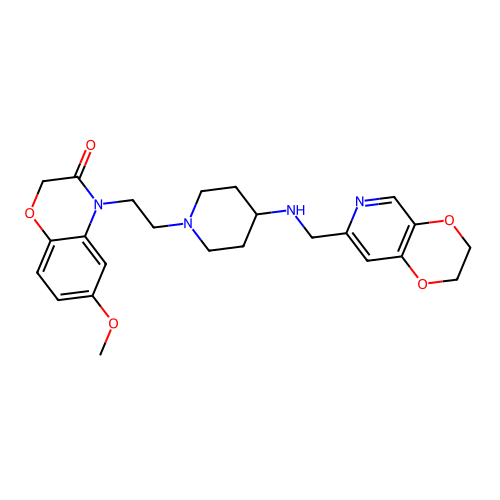

prediction: [0.9956447  0.00435529]
O=C([C@@H]1CCCCN1)N1CCN(c2nc(NCc3ccc(Cl)cc3Cl)c3cccnc3n2)CC1


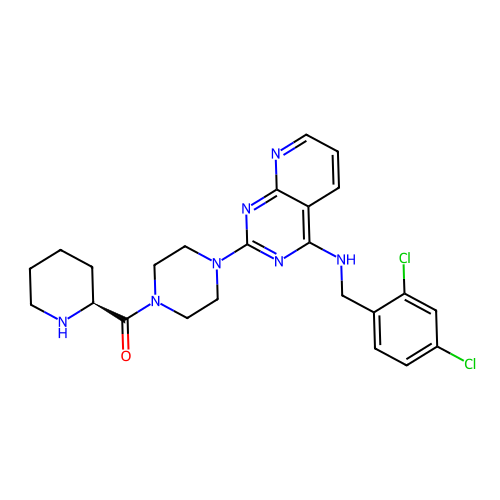

prediction: [0.9952649  0.00473517]
Cc1cc2cc(NC(=N[C@H]3CCCCN(CC(=O)N4CCCC4)C3=O)NC#N)ccc2o1


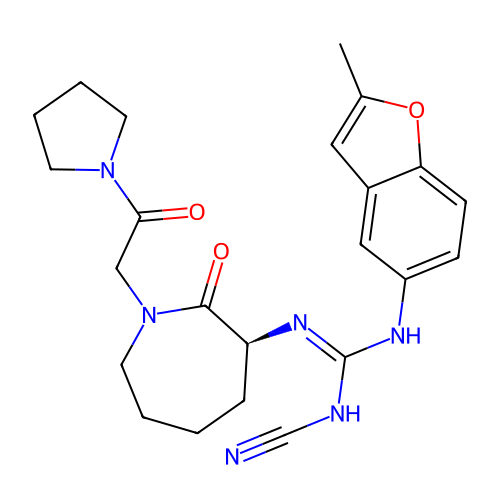

prediction: [0.9943124  0.00568758]
Cc1cc(-c2nc(-c3ccc4cc(CCN5CCC[C@H]5C)ccc4n3)cs2)no1


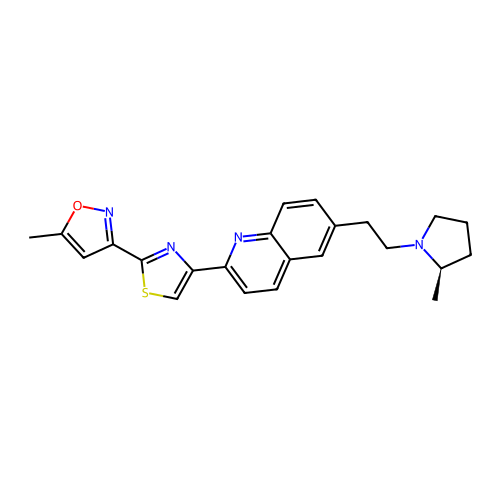

prediction: [0.99428976 0.0057102 ]
Cc1ncc(-c2ccnc(Nc3ccc(C(=O)NC4CC4)cc3)n2)n1C(C)C


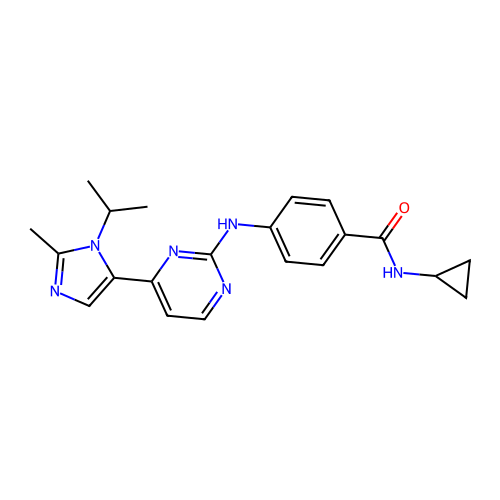

prediction: [0.994162   0.00583801]
Cc1cccc(NC(=O)c2ccc(-c3ccc(C#N)cc3)o2)c1


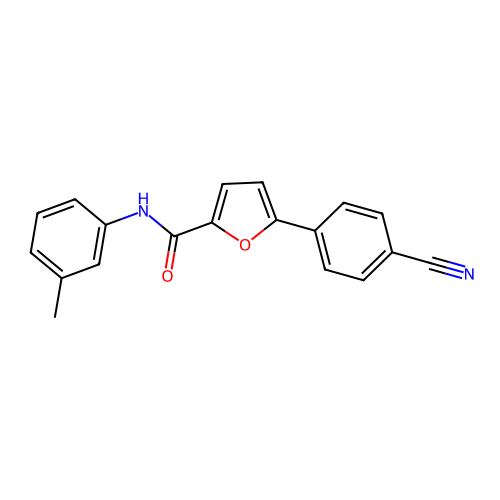

prediction: [0.9937977 0.0062022]
COc1cc(N2CCN(C(=O)CO)CC2)ccc1Nc1ncc(Cl)c(-c2cnc3ccccn23)n1


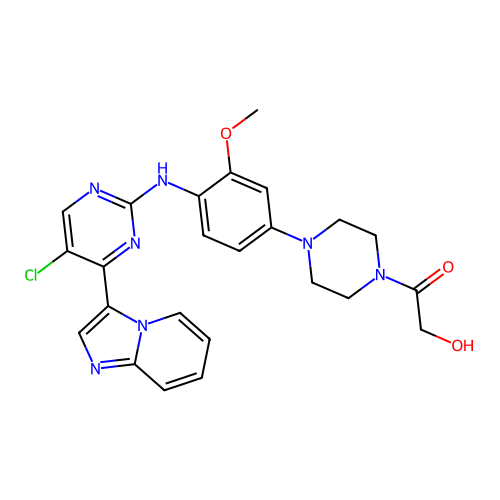

prediction: [0.9937615  0.00623848]
CC[NH+](CC)CCNC(=O)c1ccc(N[S+2](C)([O-])[O-])cc1


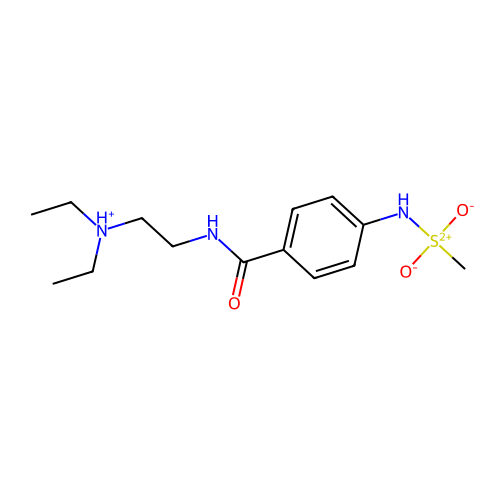

prediction: [0.99362034 0.00637965]
c1ccc(C2(c3ccccc3)CC2C2=NCCN2)cc1


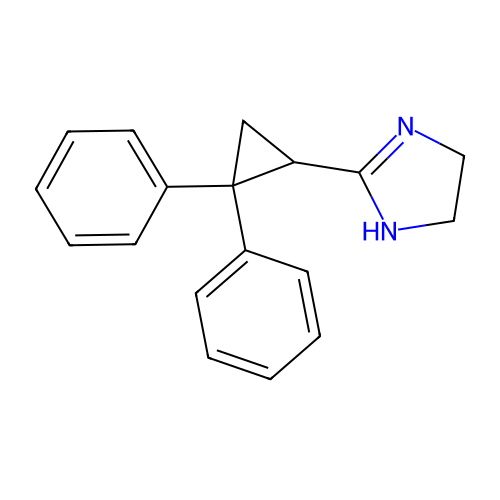

prediction: [0.99340254 0.00659751]
Cc1nc(N2CCOCC2)sc1-c1ccc2cc(CCN3CCC[C@H]3C)ccc2n1


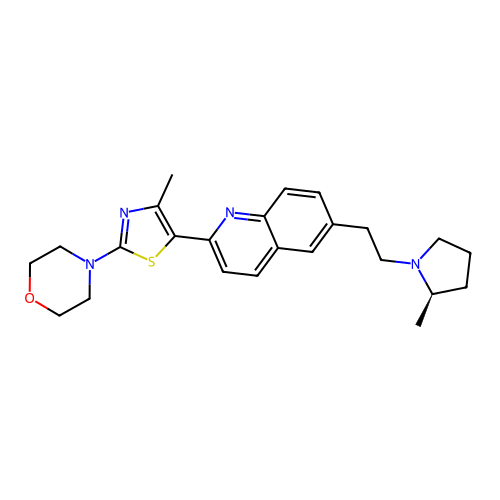

prediction: [0.99339277 0.00660722]
Cc1nc2ccccc2n1-c1ccc(C(=O)N(C)[C@@H]2CCN(C(C)C)C2)cc1


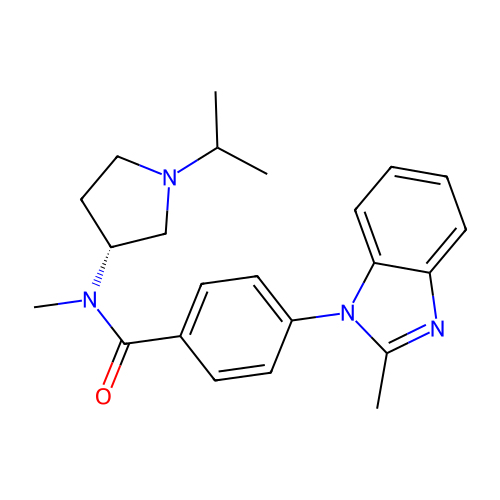

prediction: [0.9929242  0.00707583]
COc1cnc(-c2cccc3c2C[C@H](NC(=O)c2ccc(OCC(F)(F)F)nc2)CO3)cn1


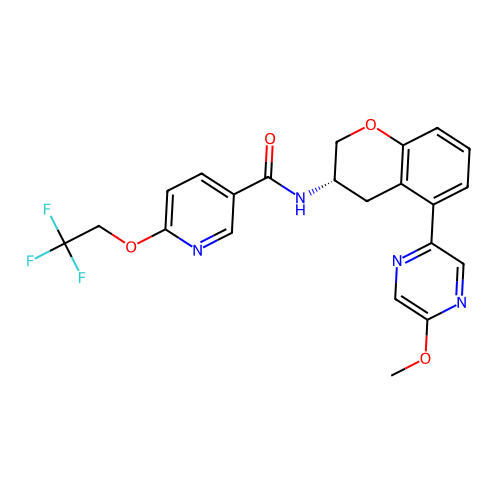

prediction: [0.9928444  0.00715562]
CC[C@](O)(c1cn(Cc2ccc3c(-c4cccc(F)c4)c(C(N)=O)sc3c2)nn1)C(F)(F)F


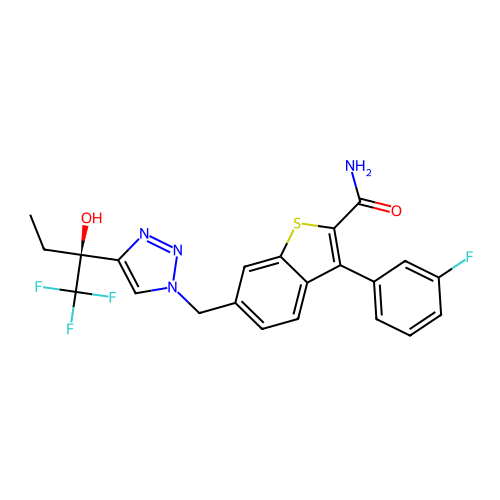

prediction: [0.9923701 0.0076298]
O=C(O)C(c1ccccc1)N1CCC(N2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)CC1


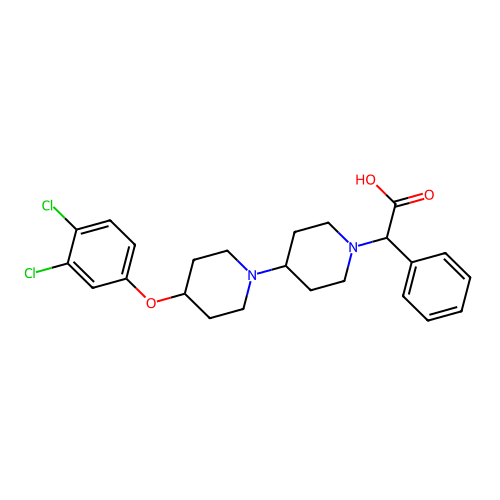

prediction: [0.99216366 0.00783631]
COc1ccc2c(c1)C1CC1(C(=O)N1C3CNCC1C3)Cn1c-2c(C2CCCCC2)c2ccc(C(=O)NS(=O)(=O)N(C)C)cc21


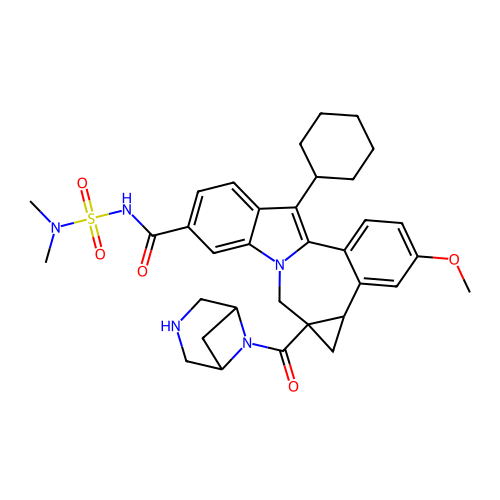

prediction: [0.9921164  0.00788356]
CC(C)c1ccccc1C(=O)N(C1CCC1)[C@H]1CCNC1


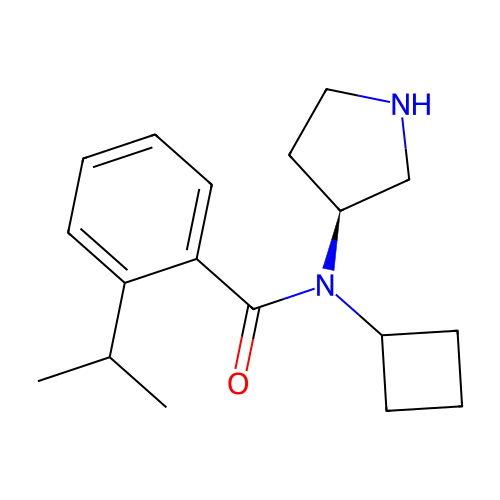

prediction: [0.9919809  0.00801912]
Nc1nc2cc3c(cc2s1)CCN(Cc1ccncc1)CC3


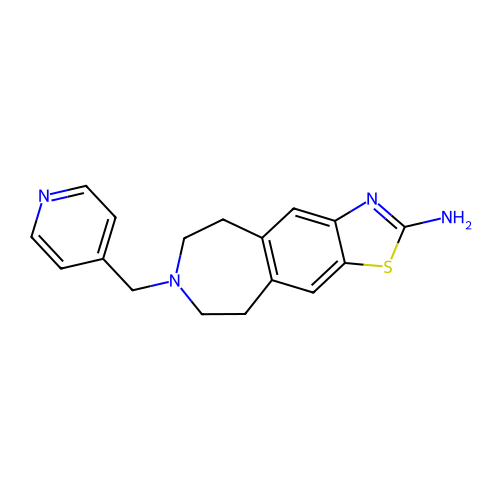

prediction: [0.9919624  0.00803762]
O=C(c1cc(F)cc(F)c1)N1CCN(c2ccc(OCCCN3CCCCCC3)cc2)C(=O)C1


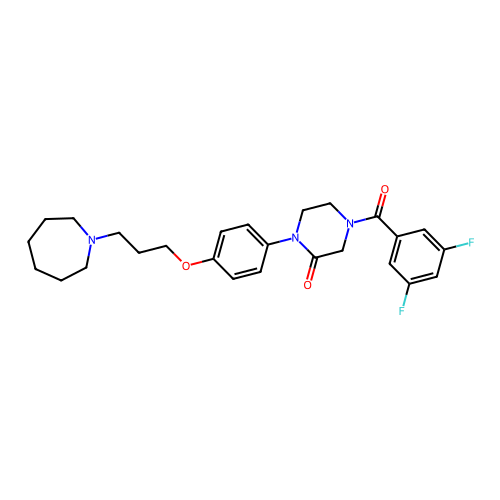

prediction: [0.9917584  0.00824157]
CN(C)C(=O)N[C@H]1CC[C@H](CN2[C@@H]3CC[C@H]2C[C@@H](Oc2cccc(C(N)=O)c2)C3)CC1


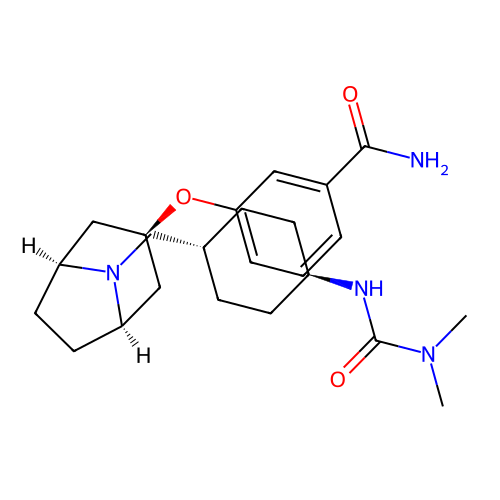

prediction: [0.99171853 0.00828147]
COc1cccc2nc(C#Cc3cccnc3)ccc12


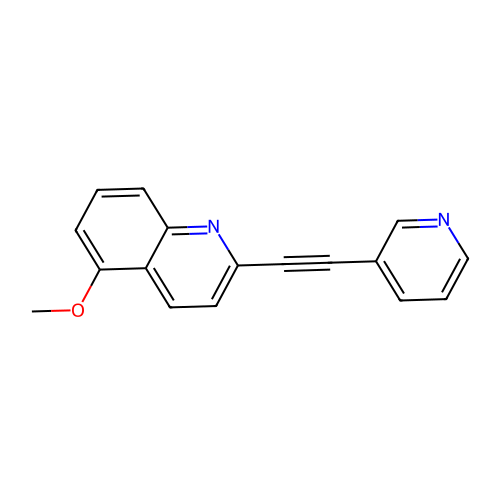

prediction: [0.9915456  0.00845438]
Cc1cc(Nc2ccccc2)nc(NCc2ccccn2)n1


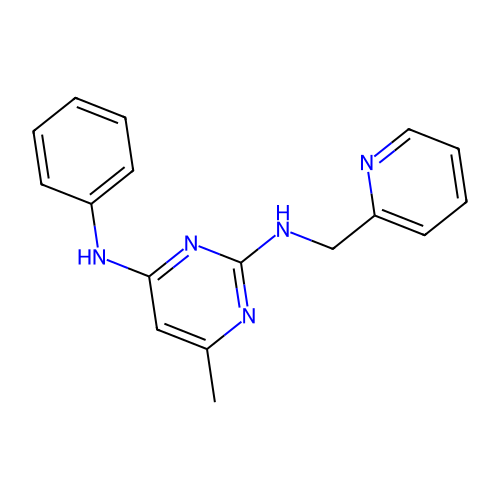

prediction: [0.9913912  0.00860884]
N#Cc1ccc(-c2noc(-c3cc(F)cc(C#N)c3)n2)nc1


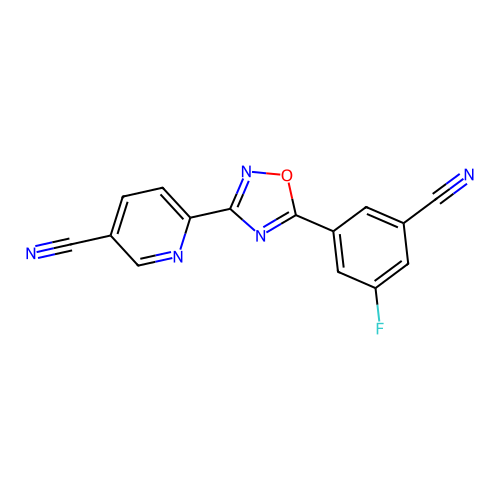

prediction: [0.9911714  0.00882862]
O=c1ccc(-c2ccc(OC3CCN(C4CCC4)CC3)cc2)n[nH]1


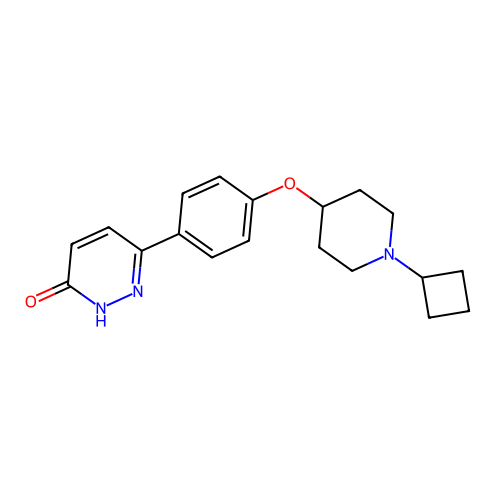

prediction: [0.9908022  0.00919777]
CN1CCc2ccccc2Cc2[nH]c3ccccc3c2CC1


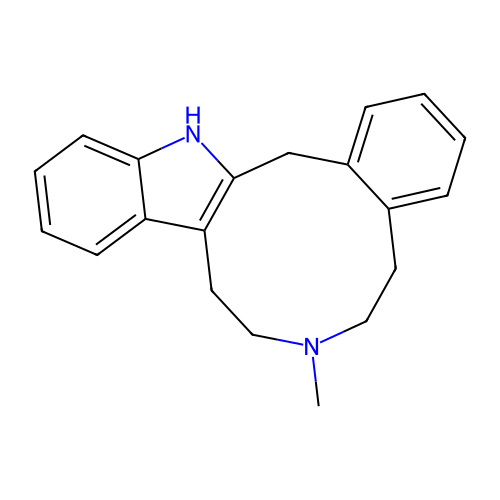

prediction: [0.9907023 0.0092977]
COc1cccc2c1nc(N)n1nc(CN3CCN(c4ccccn4)C[C@H]3C)nc21


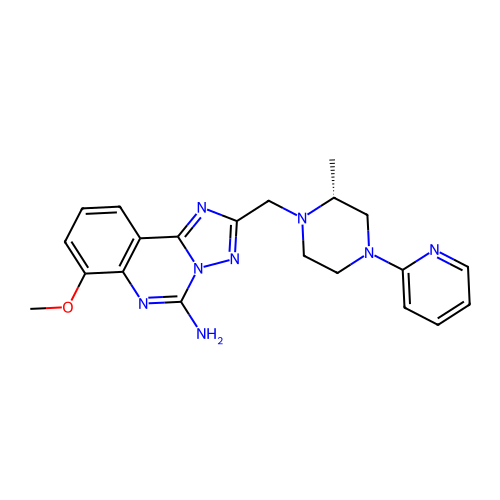

prediction: [0.9906611  0.00933887]
O=C(NCCCCN1CCN(c2ccccc2)CC1)c1ccc2ncccc2c1


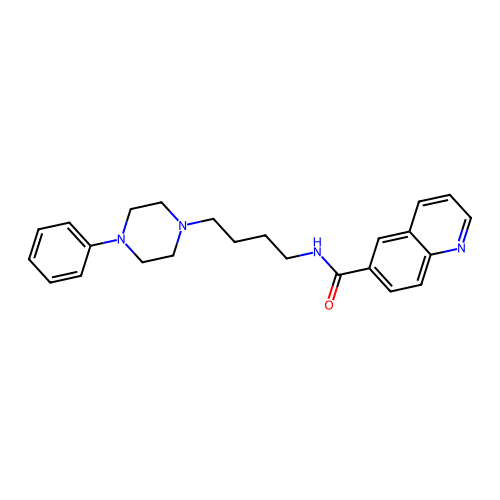

prediction: [0.9904975  0.00950239]
C[C@@H]1CN(c2nc(C(F)(F)F)no2)CCN1c1ncc(OCc2ccc(C[S+](C)[O-])cc2F)cn1


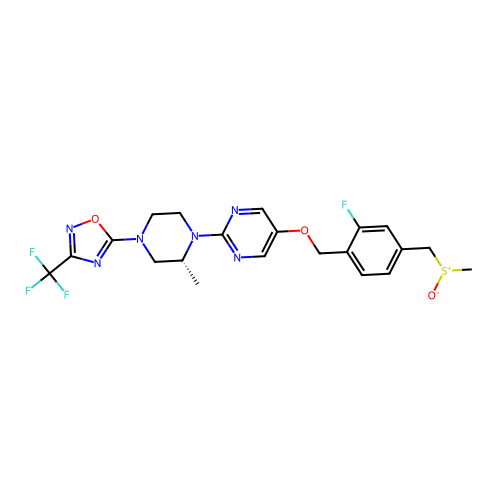

prediction: [0.99016905 0.00983096]
CN(C)c1ccc(Cc2ccc(N(C)C)cc2)cc1


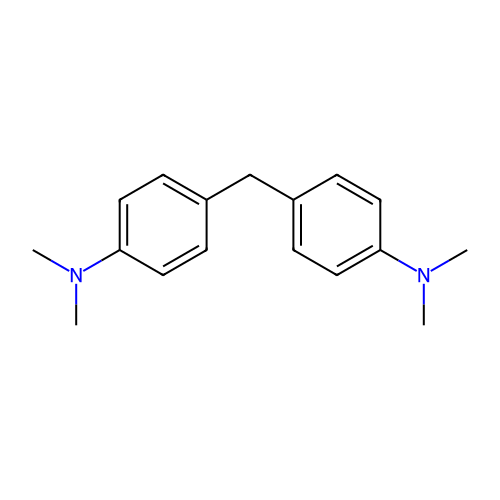

prediction: [0.989528   0.01047194]
Cc1cc(OC2CCN(CC3CCN([C@@](C)(Cc4ccc(F)cc4)C(=O)O)CC3)CC2)ccc1Cl


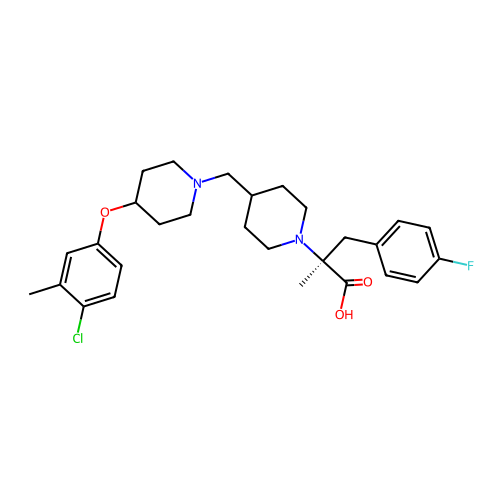

prediction: [0.98811674 0.0118833 ]
O=C(C1CCC1)N(Cc1ccccc1C(F)(F)F)[C@H]1CCNC1


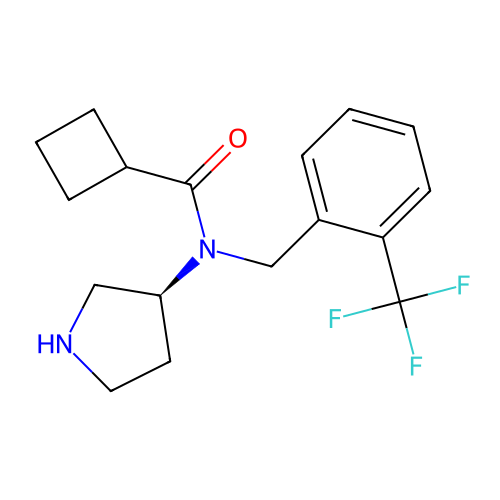

prediction: [0.9878     0.01219995]
C[C@@H]1CCCN1CCc1ccc2nc(-c3c(C(F)(F)F)[nH]ccc3=O)ccc2c1


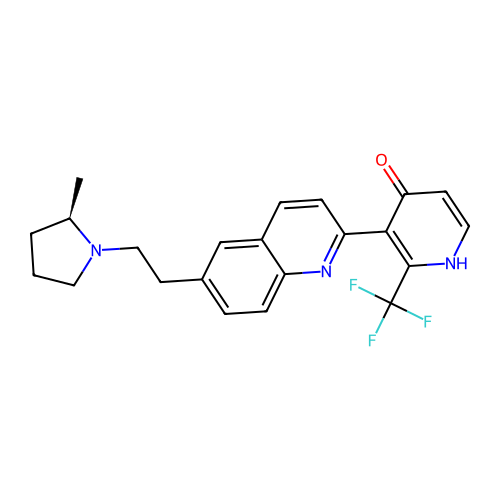

prediction: [0.9876846  0.01231534]
Cc1cc(Nc2cncc(N[C@@H](C)c3ncc(F)cn3)n2)n[nH]1


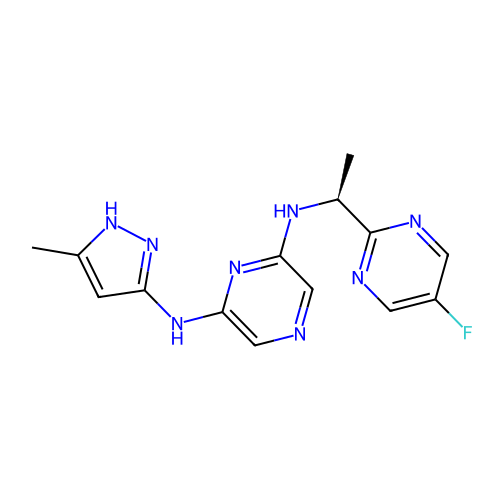

prediction: [0.987463   0.01253692]
COc1cc(C(F)(F)F)cc(COCC2(c3ccc(F)cc3)CCN(C)CC2)n1


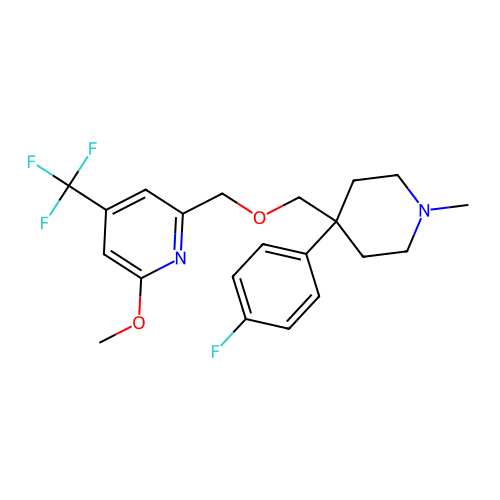

prediction: [0.9850503 0.0149497]
O=C(CNC(=O)c1cccc(C(F)(F)F)c1)NC1CN([C@H]2CC[C@@](O)(c3ccc(F)nc3)CC2)C1


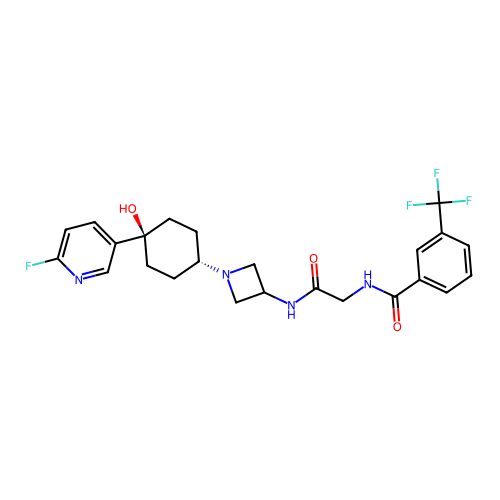

prediction: [0.9844674  0.01553263]
COc1cnc(-c2c(F)ccc(F)c2CCNC(=O)c2ccc(COCC(F)(F)F)nc2)cn1


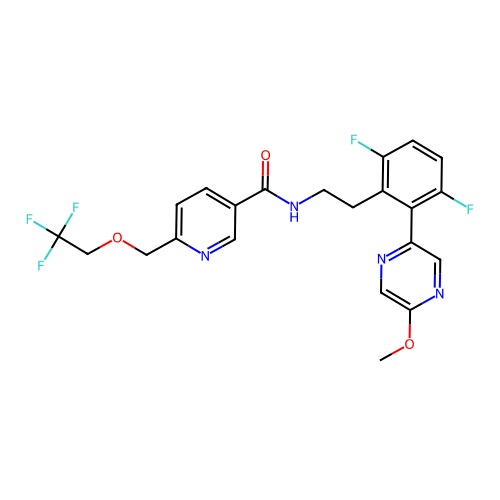

prediction: [0.98423135 0.01576866]
CCO[C@H]1CN([C@H]2CC[C@@](O)(c3ccc4c(c3)OCO4)CC2)C[C@@H]1NC(=O)CNC(=O)c1cccc(C(F)(F)F)c1


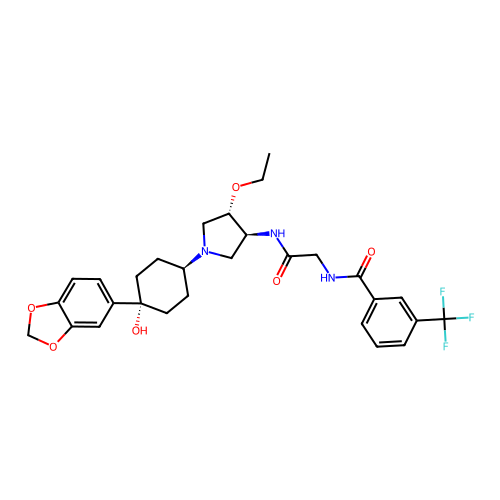

prediction: [0.9833619 0.0166381]
O=C(NCc1ccc(F)c(C(F)(F)F)c1)C1c2ccccc2C(=O)N1CCc1ncc(F)cn1


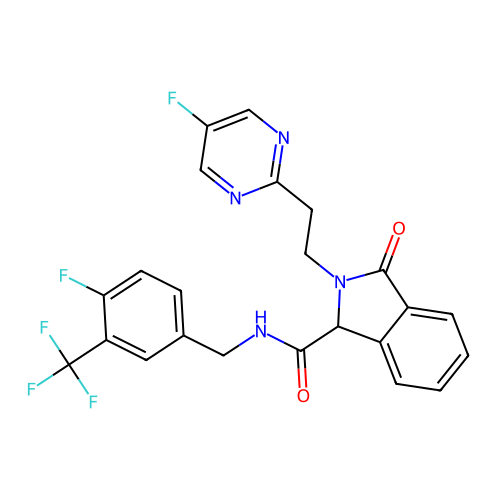

prediction: [0.9824113  0.01758867]
CC(C)(Cc1cccc(CC(=O)NCc2cccc(-c3ccc(O)cc3)c2)c1)NC[C@H](O)c1ccc(O)c(NS(C)(=O)=O)c1


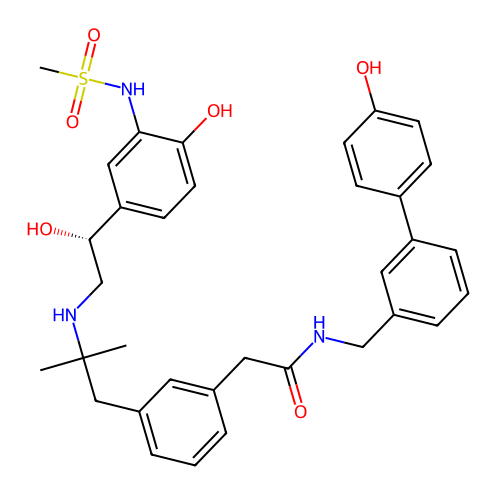

prediction: [0.9817934 0.0182066]
C[C@@H]1CCCN1CCc1ccc2nc(-c3cccnc3)ccc2c1


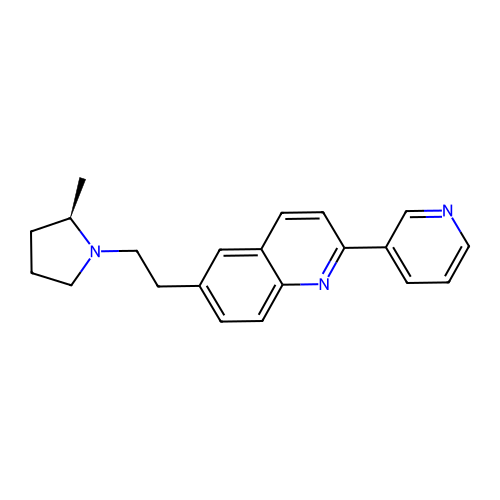

prediction: [0.981429   0.01857109]
CCNC1(C(N)=O)CCN(c2ncnc3c2nc(-c2ccccc2Cl)n3-c2ccc(Cl)cc2)CC1


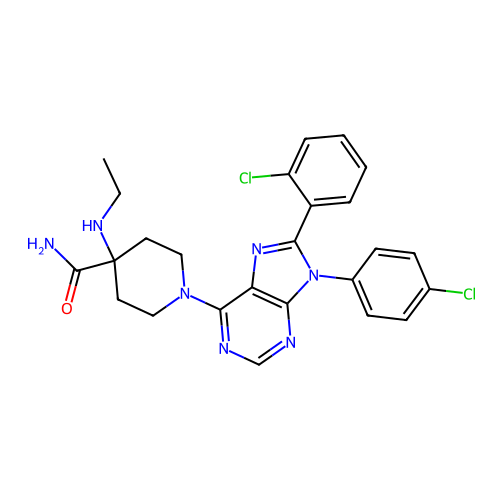

prediction: [0.9811214  0.01887859]
Cc1ncccc1C(=O)N1CCC([NH2+]Cc2cncn2Cc2ccc(C#N)cc2)C1=O


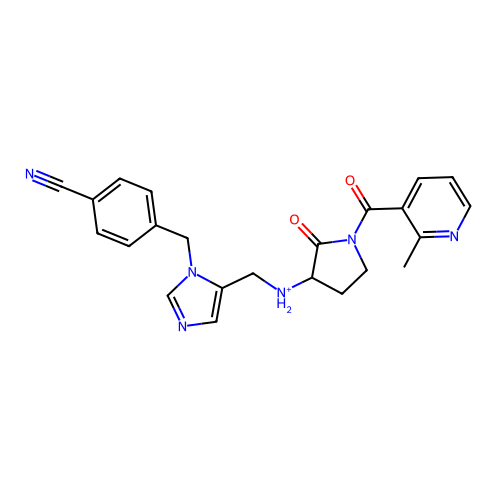

prediction: [0.9803507 0.0196493]
C[C@@H]1CCCN1CCc1ccc(-c2ccc(S(=O)(=O)CCCO)cc2)cc1


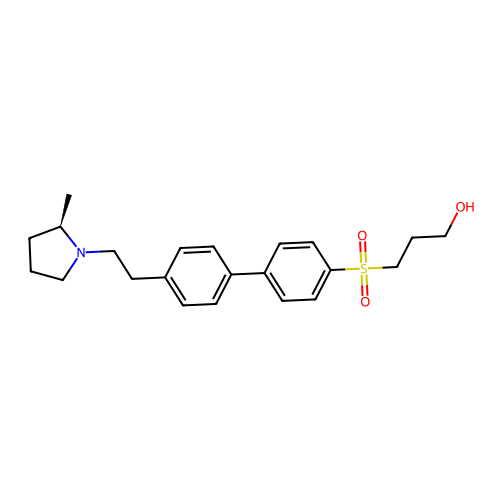

prediction: [0.97789395 0.02210607]
Clc1ccc2c(c1)N=C(N1CC[NH2+]CC1)c1ccccc1N2


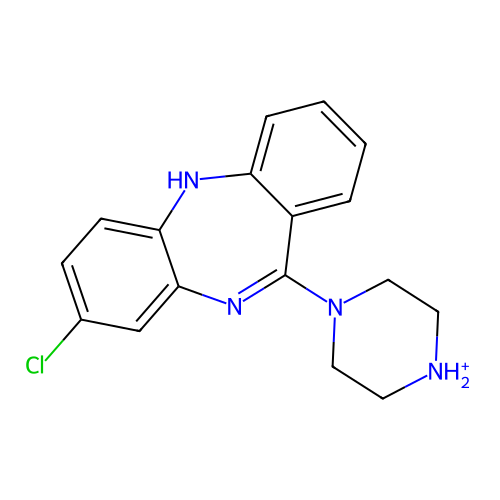

prediction: [0.9774244  0.02257562]
COc1cc2c(Nc3ncc(CC(=O)Nc4cccc(F)c4)s3)ncnc2cc1OCCCN1CCC(CO)CC1


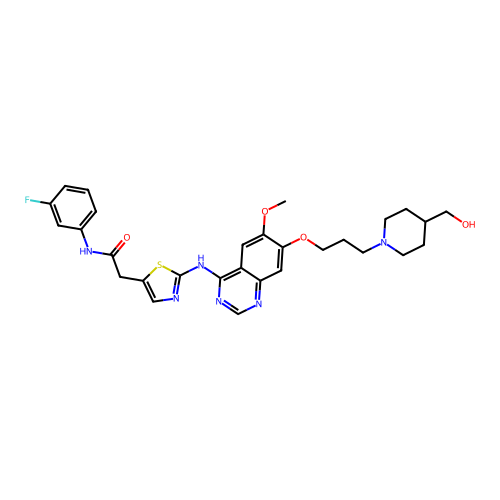

prediction: [0.976747   0.02325299]
COc1ccc2ncc(=O)n(CC(N)C3(F)CCC(NCc4ccc5c(n4)NC(=O)CO5)CC3)c2c1


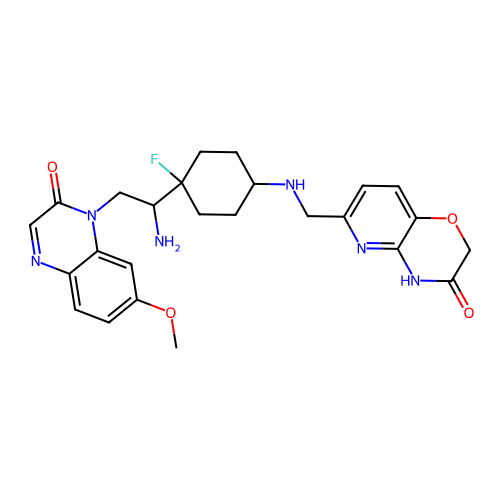

prediction: [0.9756285  0.02437145]
CC(Cc1ccccn1)N1C(=O)c2ccccc2C1C(=O)NCc1ccc(OC(F)(F)F)cc1


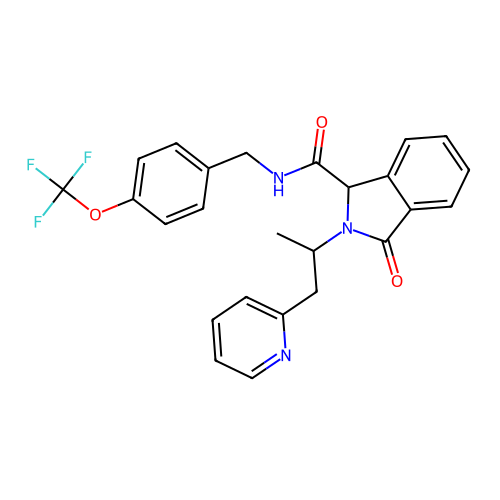

prediction: [0.97526634 0.0247337 ]
COC(=O)C1=CCC2CCC1[NH+]2C


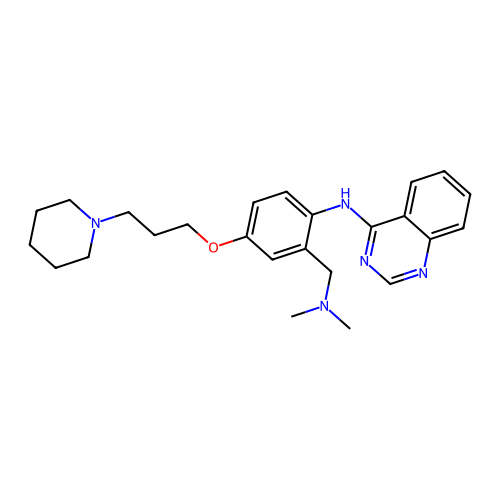

prediction: [0.9739412 0.0260588]
COC(C)(C)COc1ccc2c(c1)[C@]1(COC(N)=N1)c1cc(-c3cncnc3)ccc1O2


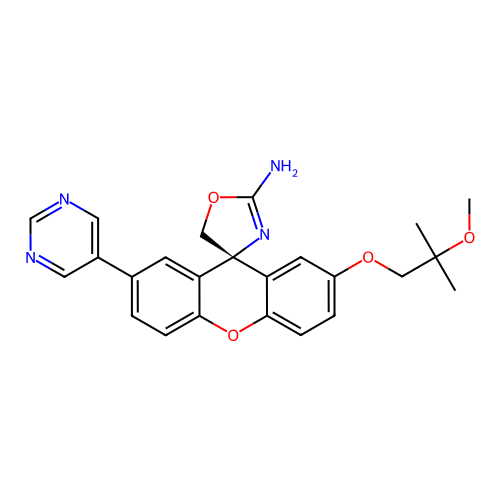

prediction: [0.97337544 0.02662451]
O=C(CNc1nccc2ccc(C(F)(F)F)cc12)NC1CN([C@H]2CC[C@@](O)(c3cncs3)CC2)C1


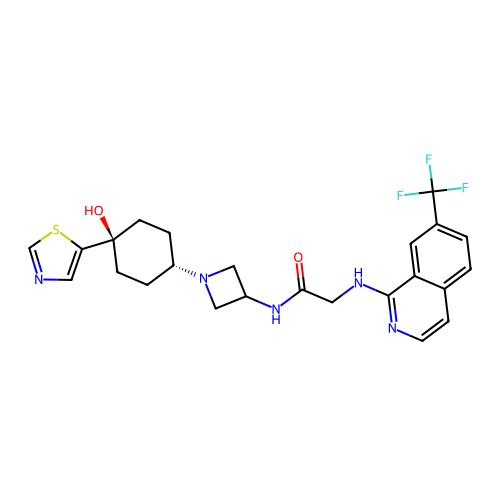

prediction: [0.9731707  0.02682924]
Fc1ccc(C2(COCc3cc(C(F)(F)F)cc(Cl)n3)CCNCC2)cc1


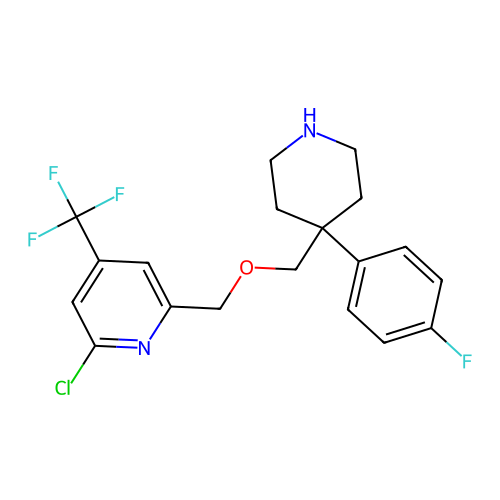

prediction: [0.9730823 0.0269177]
C[C@H]1CCCN1CCCOc1ccc(N2CCN(C(=O)c3cc(F)cc(F)c3)CC2=O)cc1


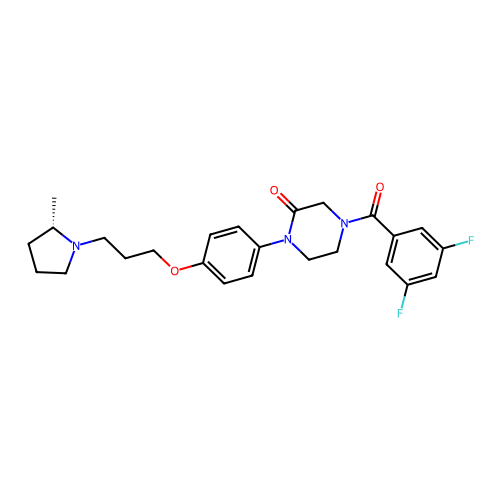

prediction: [0.9729734  0.02702663]
CCN(CC)C(=O)[C@@H]1C=C2c3cccc4[nH]cc(c34)C[C@H]2N(C(=O)Nc2ccccc2)C1


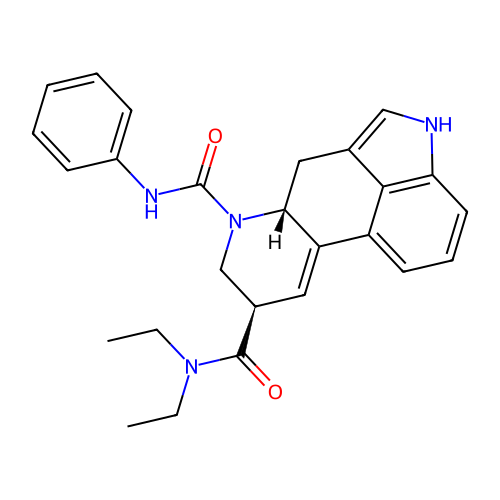

prediction: [0.9729269  0.02707303]
O=C(CC1CCN(Cc2ccn(-c3ccc(C(F)(F)F)cc3)c2)CC1)N1CCOC(C(=O)N2CCCC2)C1


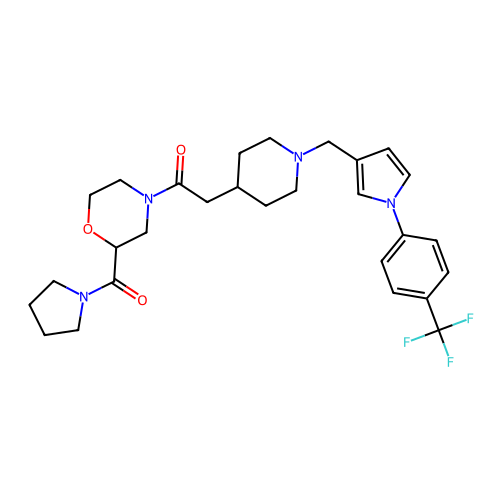

prediction: [0.9727791  0.02722083]
N#Cc1ccccc1[C@H]1CC[C@@H](N2CC(NC(=O)CNc3ncnc4ccc(C(F)(F)F)cc34)C2)CC1


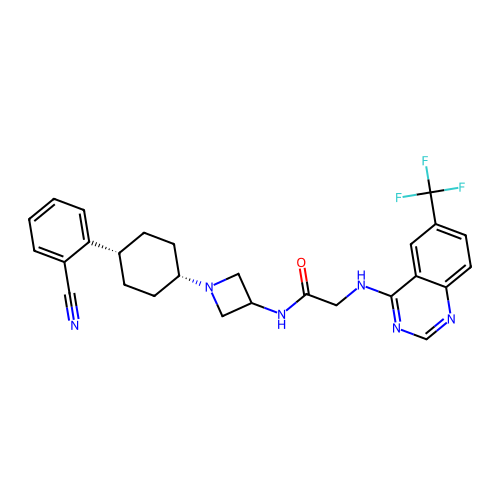

prediction: [0.9717865 0.0282135]
Cc1nc2cc3c(cc2o1)CCN(CCCSc1nnc(C2CCOCC2)n1C)CC3


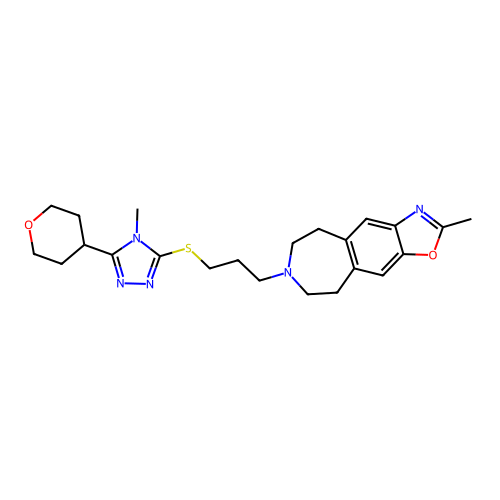

prediction: [0.9713623  0.02863776]
C[C@@H](N1CCn2nc(-c3ccc(C#N)nc3)nc2C1)[C@](O)(Cn1cncn1)c1ccc(F)cc1F


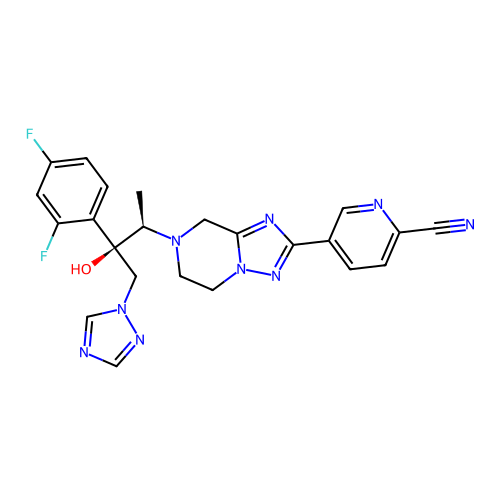

prediction: [0.9699526  0.03004737]
C[C@@H]1CCCN1CCCOc1ccc(N2CCN(C(=O)c3cc(F)cc(F)c3)CC2=O)cc1


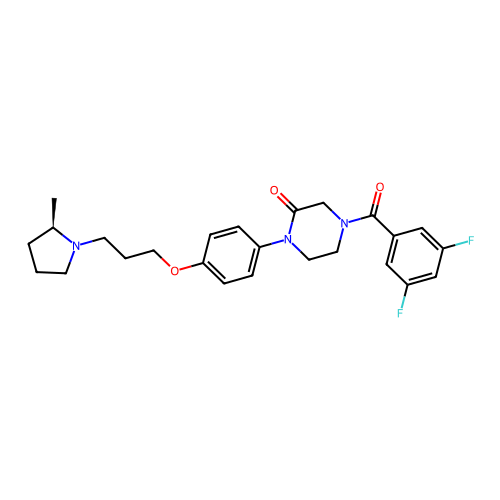

prediction: [0.9686285  0.03137141]
COc1cc([C@@H](O)CN2CCN(C[C@H](O)c3ccc4c(c3C)COC4=O)CC2)ncc1C#N


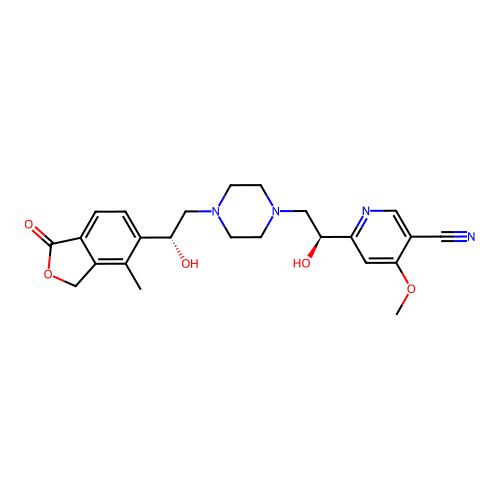

prediction: [0.9660284  0.03397164]
C[C@@H]1CCCN1CCc1ccc2nc(C3=NCCS3)ccc2c1


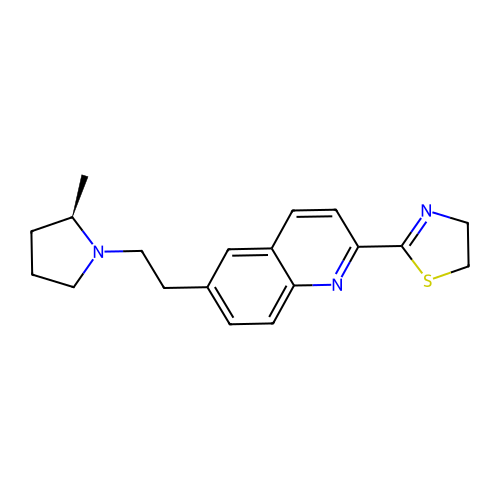

prediction: [0.966013   0.03398699]
COc1cc(NC(=O)c2ccccc2F)ccc1-c1nnc(NCCCCN2CCCCC2)o1


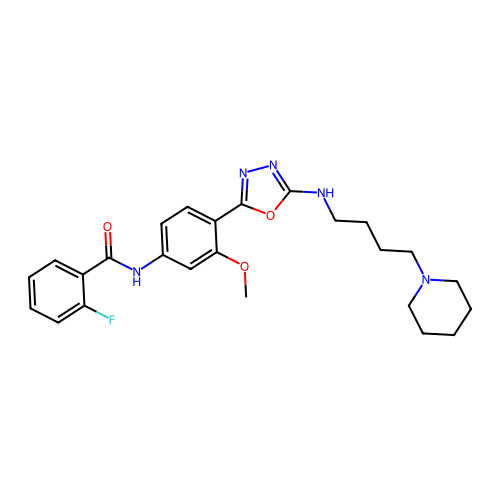

prediction: [0.96498066 0.03501935]
COc1cccc(-n2cc3nc(-c4cccnc4C)n(C[C@H]4CCCN(C[C@H]5CCCO5)C4)c(=O)c3n2)c1


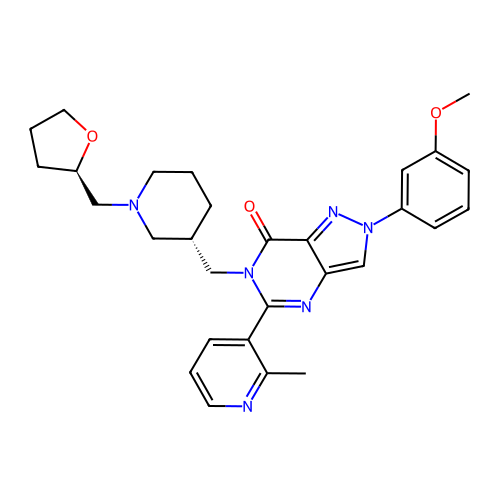

prediction: [0.9639484  0.03605151]
Cc1ncoc1-c1ccc(CC(=O)N[C@H](C)c2ccc(OCC(F)(F)F)cn2)cc1


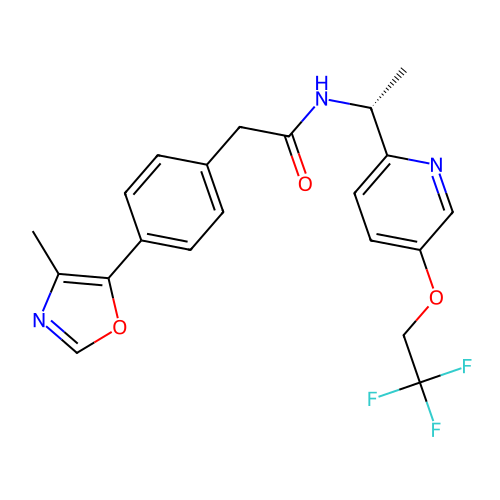

prediction: [0.9633902  0.03660987]
CC(c1ccc(C#N)cc1)N1C[C@H](N)[C@H](C(=O)N2CCC[C@H]2C#N)C1


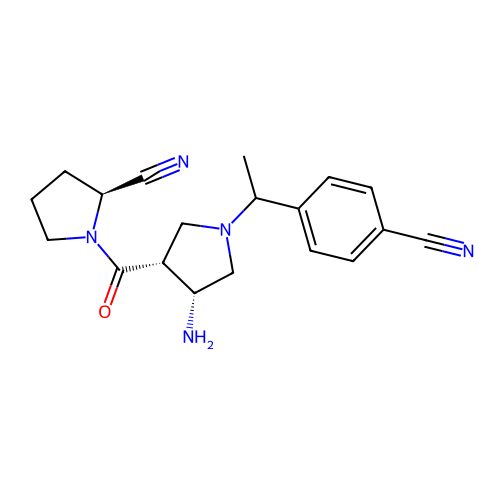

prediction: [0.9604458  0.03955416]
Cn1nccc1CCOc1ccc(C2CCN(c3ccc4nnc(C(F)(F)F)n4n3)CC2)cc1


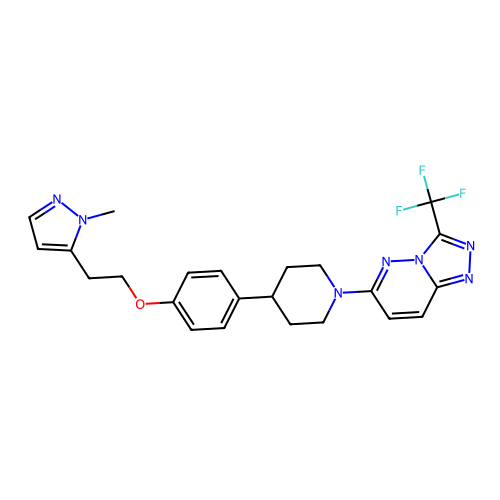

prediction: [0.9593128  0.04068723]
COc1ccccc1Oc1ccccc1CN1CCC2(CC1)CCN(C(=O)c1ccccc1C(=O)O)CC2


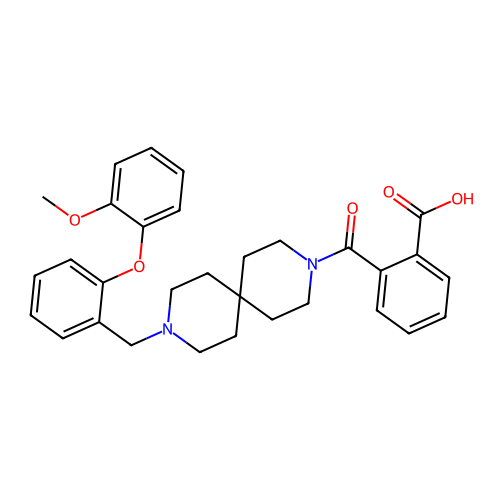

prediction: [0.95650256 0.04349746]
O=C1CCC(c2ccc(Nc3ccncc3)cc2)=NN1


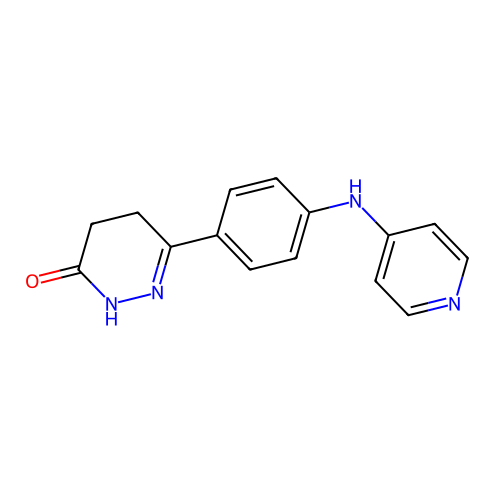

prediction: [0.9537127  0.04628727]
O=C(CNc1n[nH]c2ccc(C(F)(F)F)cc12)NC1CN([C@H]2CC[C@@H](c3ccccc3)CC2)C1


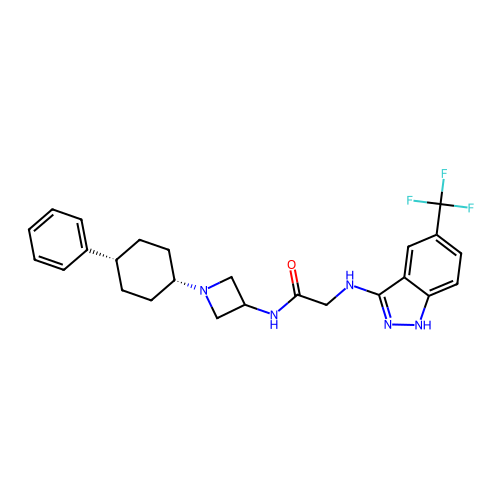

prediction: [0.95266676 0.04733326]
CCOc1nc(NC(=O)C2(NC(=O)c3ccc4c(c3)c(C)c(-c3ccc(F)cn3)n4C3CCCCC3)CCC2)ccc1/C=C/C(=O)O


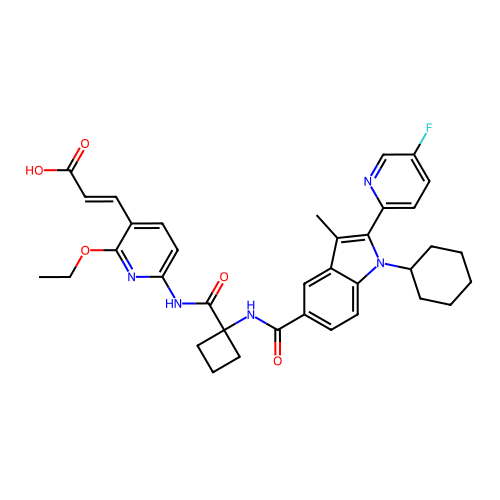

prediction: [0.95208263 0.04791734]
O=C(c1cc(Cl)c(O)cc1OC[C@@H](O)CN1CCC2(CC1)Cc1cc(Cl)ccc1O2)N1CC[C@H](O)C1


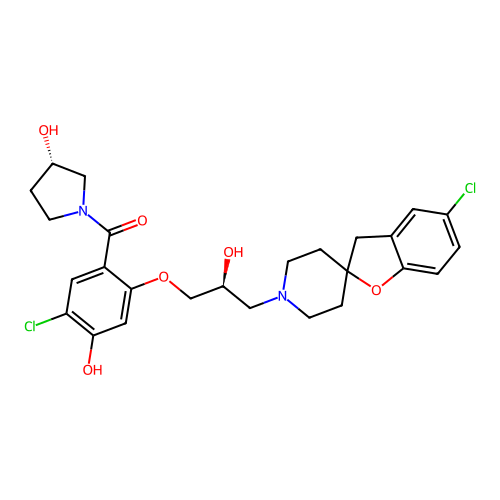

prediction: [0.95197535 0.04802458]
Cc1cncc(-c2nnc3n2CCN(C(=O)c2ccc(-c4cccs4)cc2)[C@@H]3C)n1


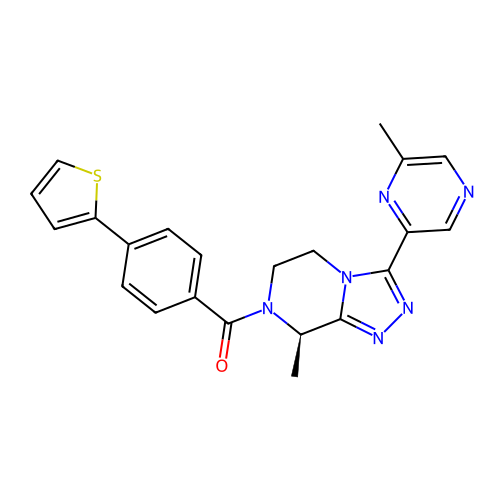

prediction: [0.9504265  0.04957347]
CC(=O)Nc1ccc2c(c1)C(N1CCC(NC(=O)c3cc(=O)c4ccc(F)cc4o3)CC1)CC2


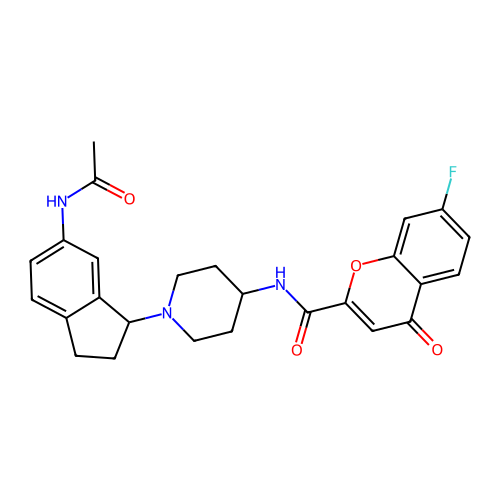

prediction: [0.94800425 0.05199571]
COC(=O)C1(CNC(=O)c2cc(OC)cc(OC)c2)CCN(CC2=Cc3ccccc3OC2(C)C)CC1


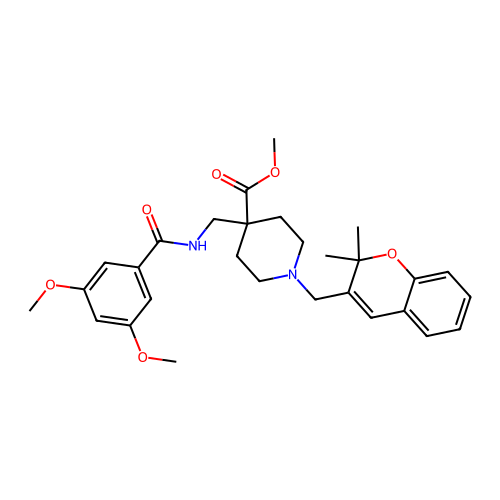

prediction: [0.9422189  0.05778113]
Cc1ncc(-c2cccc3c2C[C@H](NC(=O)c2ccc(OCC(F)(F)F)nc2)CO3)cn1


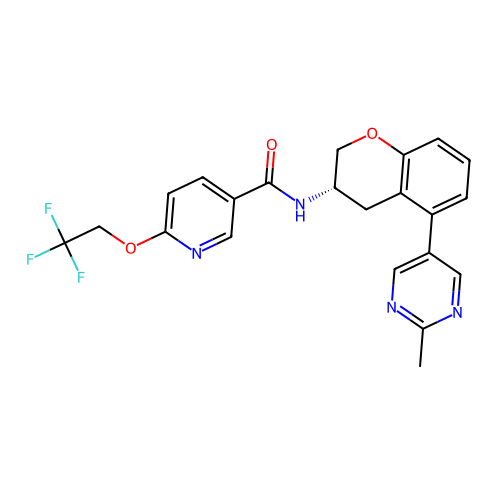

prediction: [0.9383143  0.06168563]
O=C(c1cccc(Cl)c1Cl)N(c1ccccc1)[C@H]1CCNC1


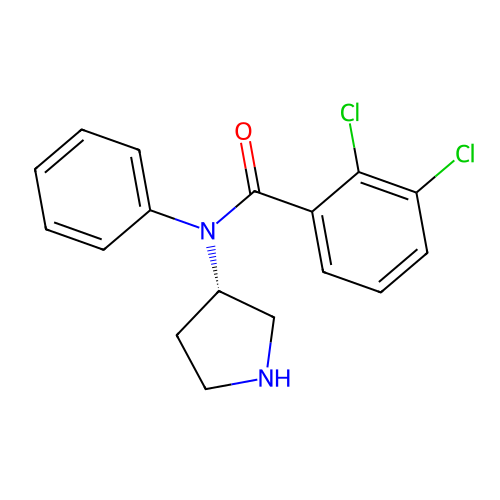

prediction: [0.93756104 0.06243901]
O=C(CNCCc1c(Cl)cccc1Cl)N1CCc2ccccc2C1C1CCCCC1


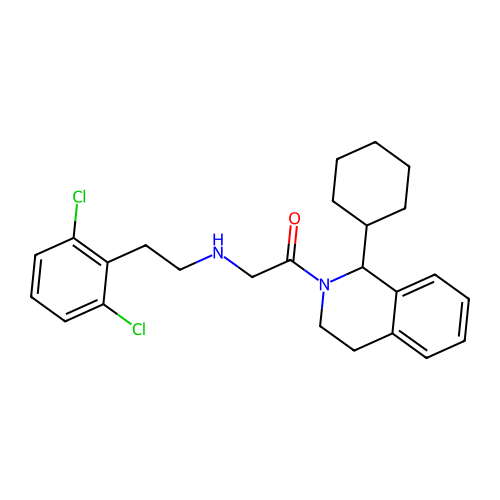

prediction: [0.9369771  0.06302285]
O=C1CCc2ncccc2N1CCCN1CCC(n2c(=O)[nH]c3ccccc32)CC1


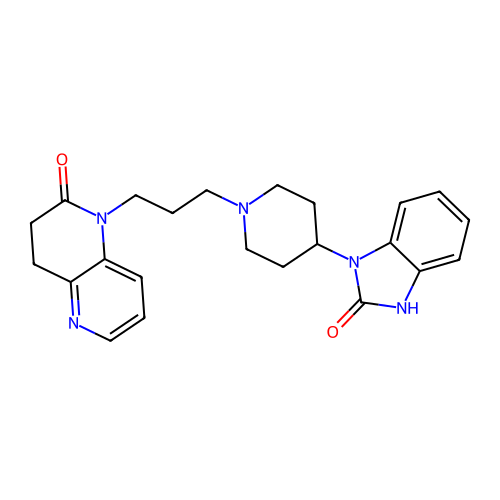

prediction: [0.9356698  0.06433018]
Cc1ccc(S(=O)(=O)N[C@@H](Cc2ccccc2)C(=O)CCl)cc1


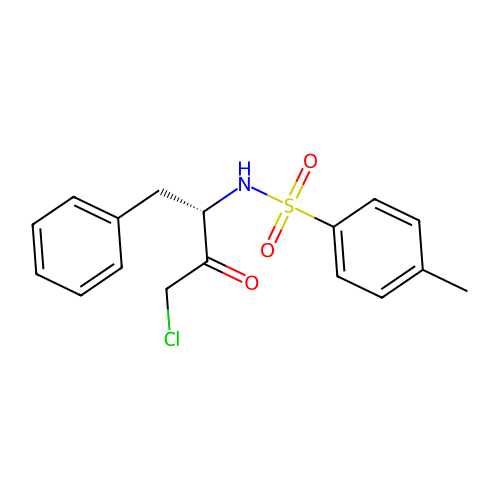

prediction: [0.9346118  0.06538825]
CCC(O)c1cn(-c2ccc(F)cc2)c2ccc(Cl)cc12


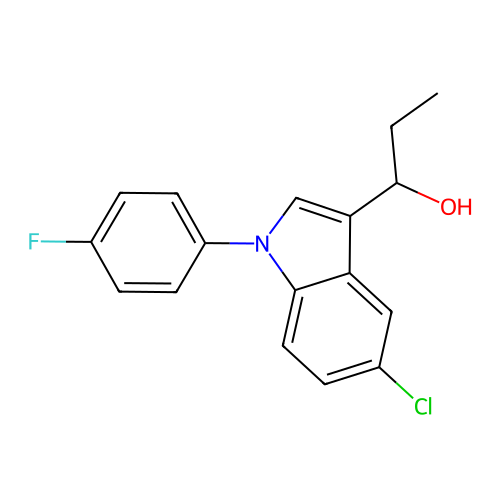

prediction: [0.9321014  0.06789855]
C[C@@H]1CCCN1CCc1ccc2nc(-c3cncnc3)ccc2c1


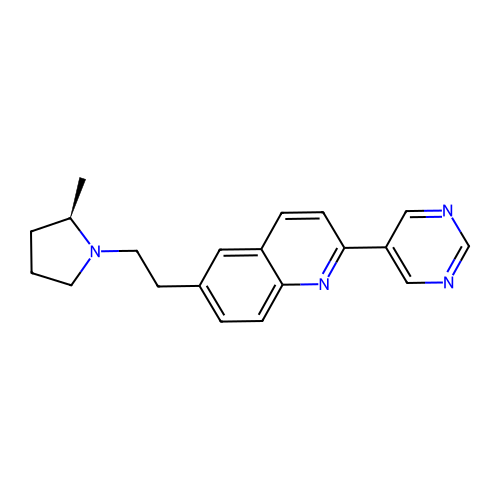

prediction: [0.9297938  0.07020624]
O=C(Nc1ccc(F)cn1)[C@H](CN1CC(O)C1)Oc1ncnc2c1cnn2-c1ccccc1Cl


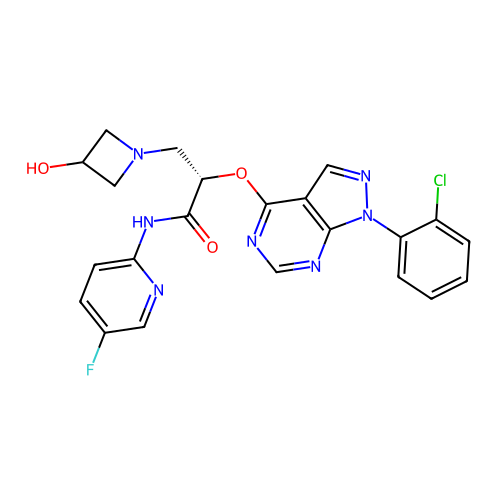

prediction: [0.92905104 0.07094898]
CC(=O)N[C@H]1CCN(C(=O)c2ccc(O)cc2OC[C@@H](O)CN2CCC3(CC2)Cc2cc(Cl)ccc2O3)C1


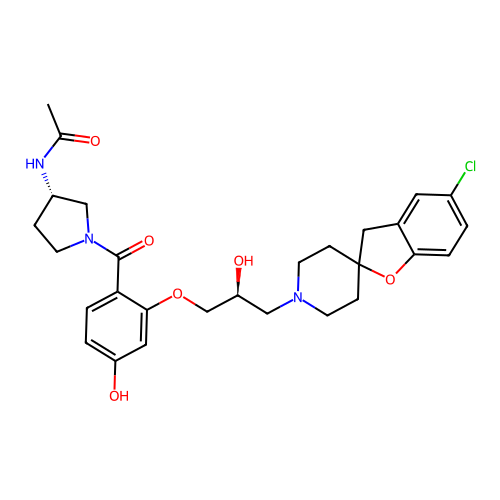

prediction: [0.9249604  0.07503967]
N#Cc1cccc([C@]2(O)CC[C@@H](N3CC(NC(=O)CNC(=O)c4cccc(C(F)(F)F)c4)C3)CC2)c1


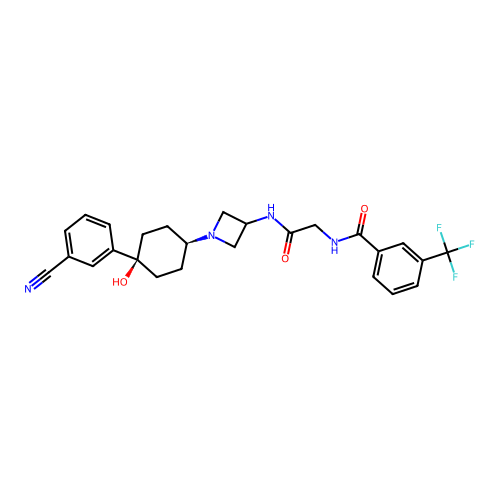

prediction: [0.92483485 0.07516515]
C[C@@H]1CN(c2noc(C(F)(F)F)n2)CCN1c1ncc(OCc2ccncc2C#N)cn1


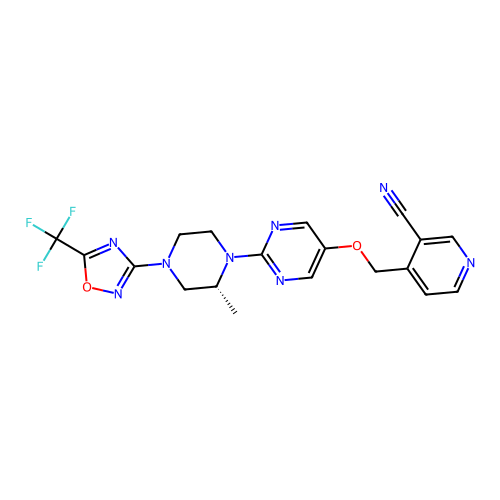

prediction: [0.91219944 0.08780052]
COc1ccc(CC(=O)Nc2cc3c(cc2[N+](=O)[O-])OC(C)(C)[C@H](O)[C@H]3NC2CC2)cc1


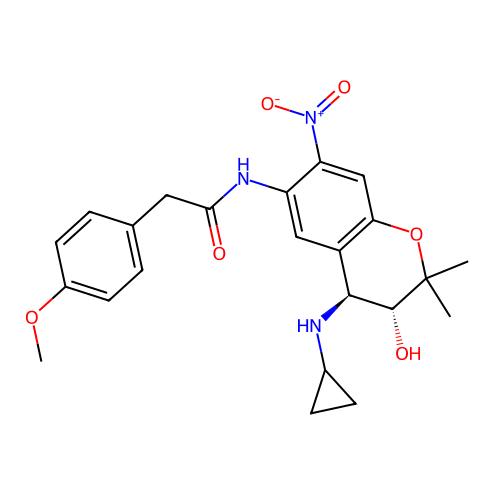

prediction: [0.9112884  0.08871164]
O=C(CCc1ccccc1)N[C@H]1CC[C@H](c2ccc(O)cc2)CC1


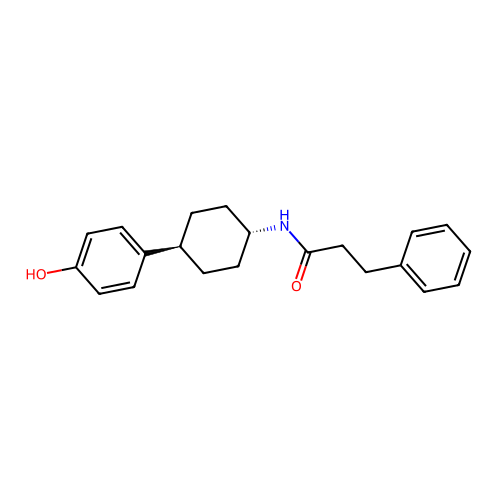

prediction: [0.8998564  0.10014364]
N[C@H](C(=O)N1CCC(F)(F)C1)[C@H]1CC[C@H](NC(=O)OCc2ccccc2)CC1


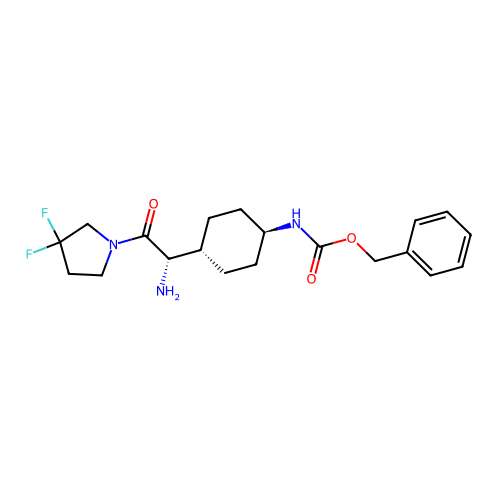

prediction: [0.89954597 0.10045403]
O=C1OCCN1C1CCN(Cc2ccc(Oc3nc4ccccc4s3)cc2)CC1


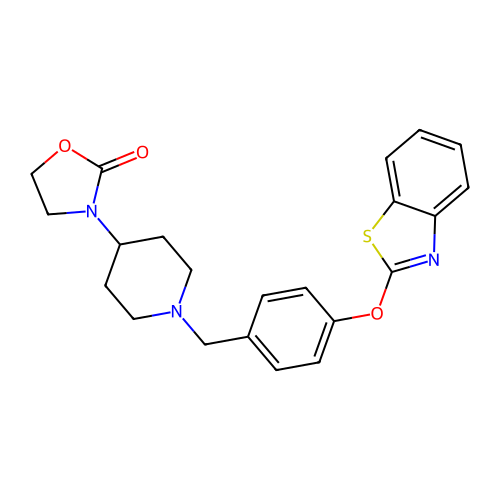

prediction: [0.8975415  0.10245853]
O=C(CNC(=O)c1cccc(C(F)(F)F)c1)NC1CN([C@H]2CC[C@H](c3cccnc3)CC2)C1


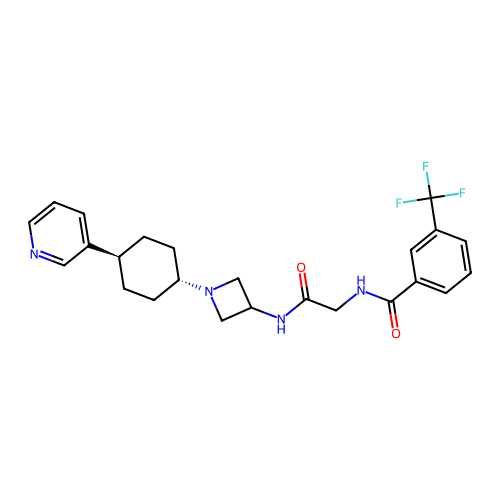

prediction: [0.8940352  0.10596485]
CCCS(=O)(=O)N1CCN(C2(CNC(=O)c3c(F)cccc3F)CCC(F)(F)CC2)CC1


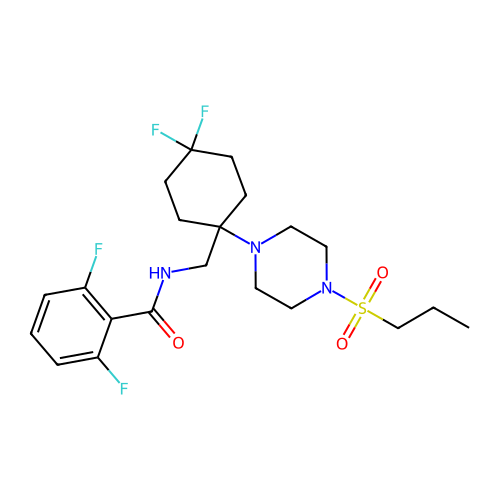

prediction: [0.8918271  0.10817285]
CC(=O)NCCc1ccccc1-c1noc([C@H]2CNCC[C@]2(O)c2ccc(F)c(F)c2)c1Br


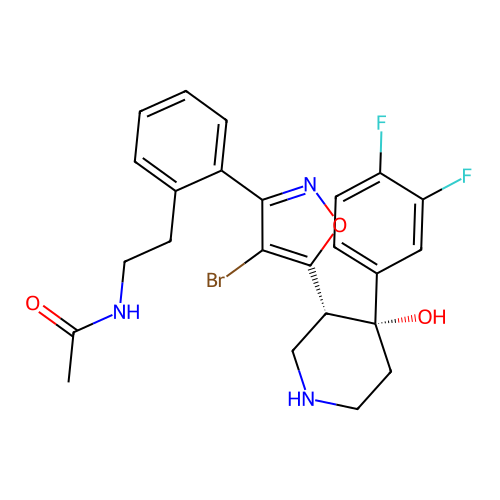

prediction: [0.88978344 0.1102165 ]
CC(C)N(CCc1c[nH]c2ccccc12)Cc1ccc(/C=C/C(=O)NO)cc1


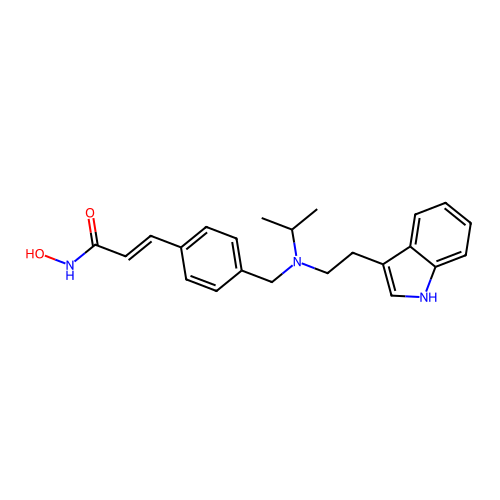

prediction: [0.88303405 0.11696596]
N#Cc1ccc(-c2ccc(C[C@@H](C#N)NC(=O)C3(N)CCOCC3)cc2)cc1


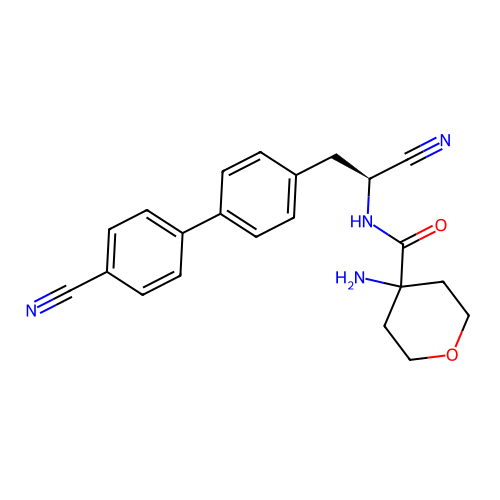

prediction: [0.878595   0.12140497]
COc1ccc2c(c1)N(CCN1CCC(NCc3cc4c(cn3)OCCO4)CC1)C(=O)CS2


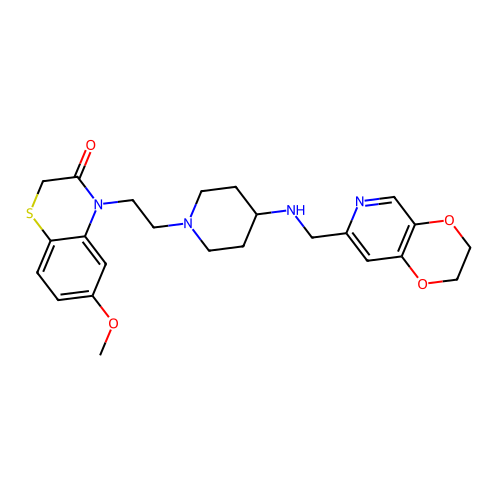

prediction: [0.8780579  0.12194205]
Cc1nc2ccccc2n1C1CC2CCC(C1)N2CCC1(c2ccccc2)CCN(C(=O)c2cccc(-c3noc(=S)[nH]3)c2)CC1


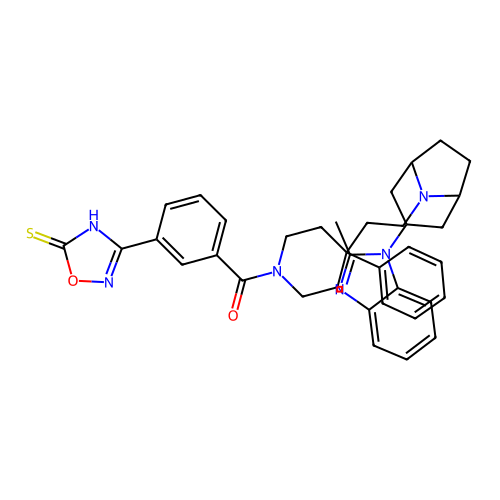

prediction: [0.8663127  0.13368726]
NC(=O)C(c1ccccc1)(c1ccc(F)cc1)c1ccc(F)cc1


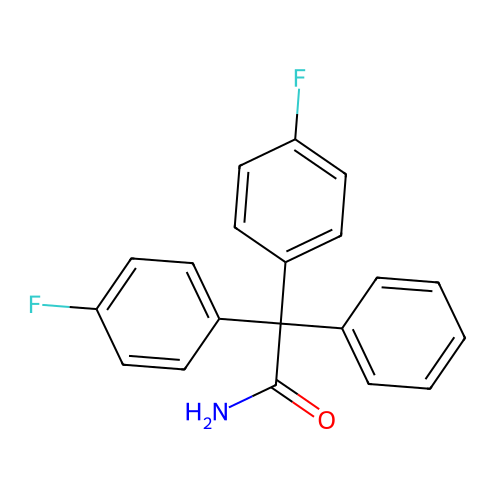

prediction: [0.85299623 0.14700375]
NS(=O)(=O)c1ccc(Oc2cnc3ccc(=O)n(CCN4CCC(c5nc6cc(C(F)(F)F)ccc6[nH]5)CC4)c3c2)cc1


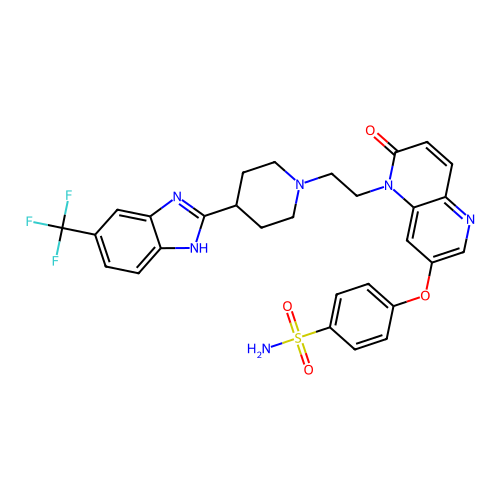

prediction: [0.8476033  0.15239668]
Cc1cc(-c2ccc3cc(CCN4CCC[C@H]4C)ccc3n2)nc(-c2ccccc2)n1


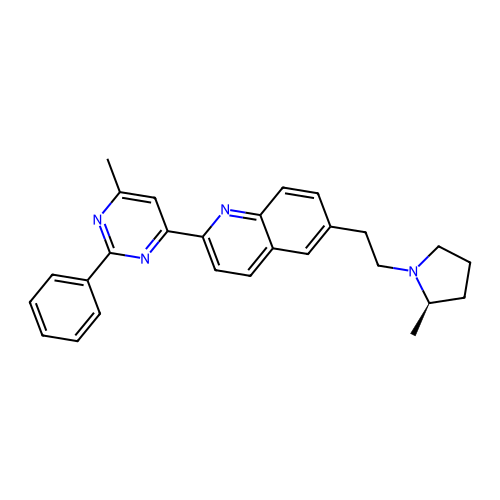

prediction: [0.84568    0.15431991]
O=C(NC1CCN(Cc2ccn(-c3ccc(C(F)(F)F)cc3)c2)CC1)N1CCC(c2ccccc2O)CC1


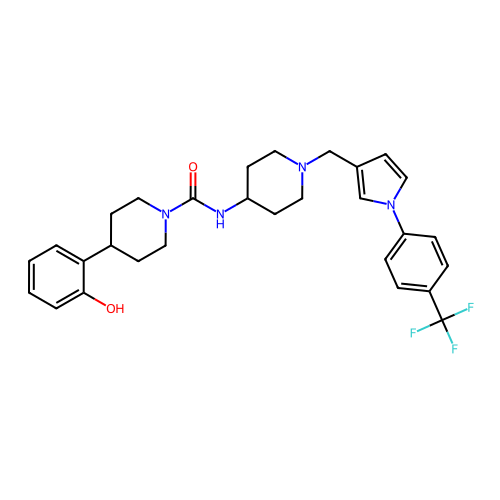

prediction: [0.840433   0.15956698]
C[NH+](C)CCC=C1c2ccccc2CCc2ccccc21


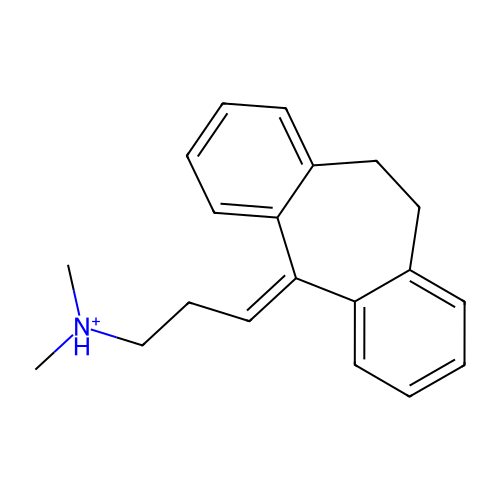

prediction: [0.8396389 0.1603611]
COc1ccccc1Oc1cccc(CN2CCC3(CC2)CCN(C(=O)c2ccncn2)CC3)c1


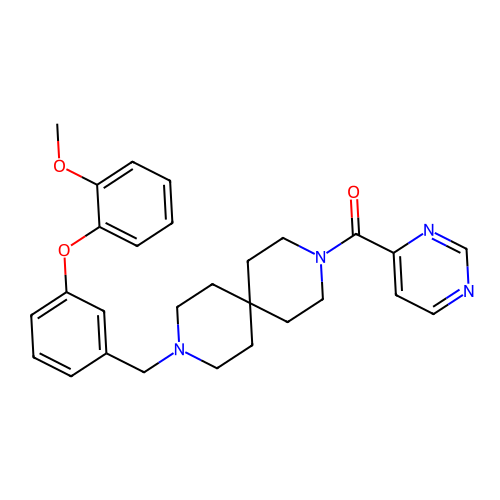

prediction: [0.8343553  0.16564468]
O=C1COc2ccc(CNC34CCC(CCc5c(F)cnc6ccc(OCC(O)CO)nc56)(CC3)OC4)nc2N1


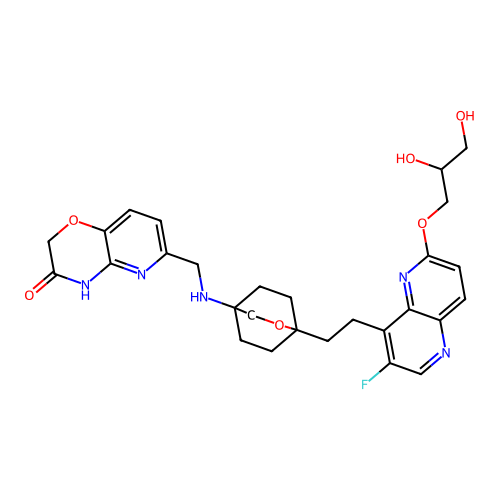

prediction: [0.828657   0.17134304]
Nc1cc(CN2CCC(N(C(=O)NCc3ccc(F)cc3)c3ccc(Cl)cc3)CC2)ccn1


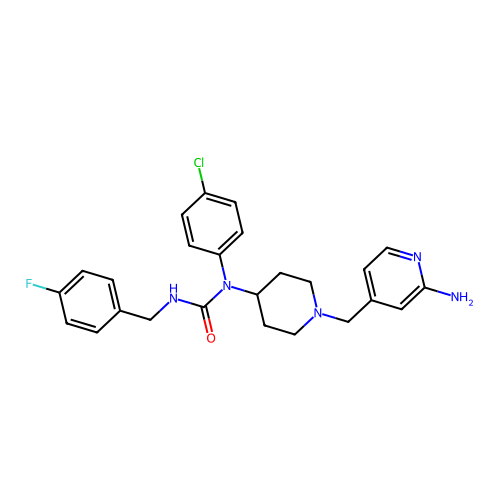

prediction: [0.8188279  0.18117203]
Cc1ccccc1C1CCN(C[C@@H]2Cc3cccnc3[C@@H](O)C2)CC1


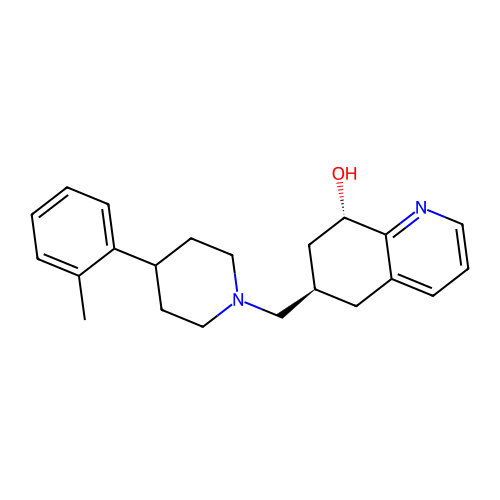

prediction: [0.81823266 0.18176739]
Cc1cn(CC(O)c2ccc(Cl)cc2Cl)c(N)n1


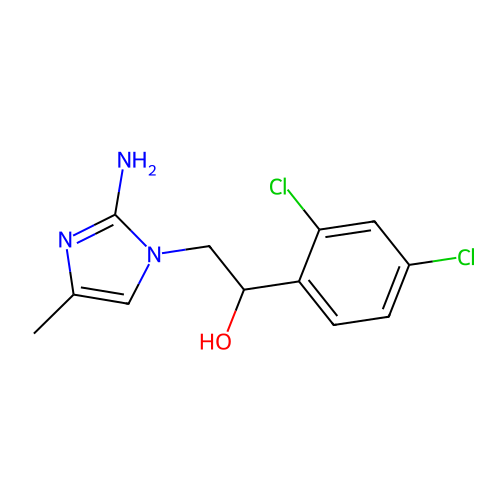

prediction: [0.8071896  0.19281046]
C[C@@H]1CCCN1CCCOc1ccc(C2=NNC(=O)CC2)cc1


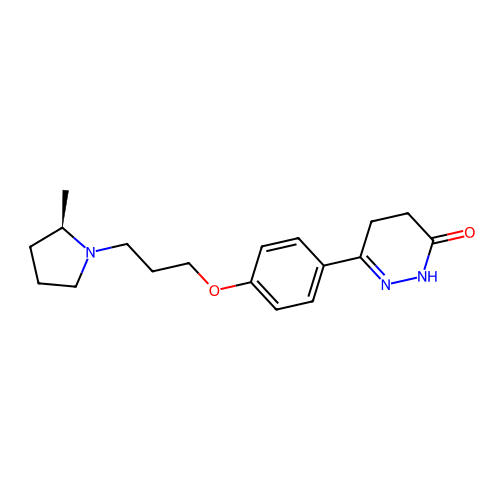

prediction: [0.801714   0.19828597]
COc1ccc2c(=O)n(CC(CO)NCc3cccnc3)c(C#N)c(-c3ccccc3)c2c1


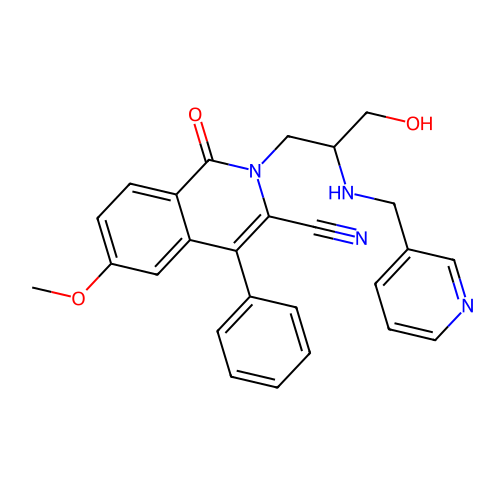

prediction: [0.799638 0.200362]
CN(C)C1(CNC(=O)N2CCC(c3nc(-c4ccc5ccccc5n4)no3)CC2)CCCC1


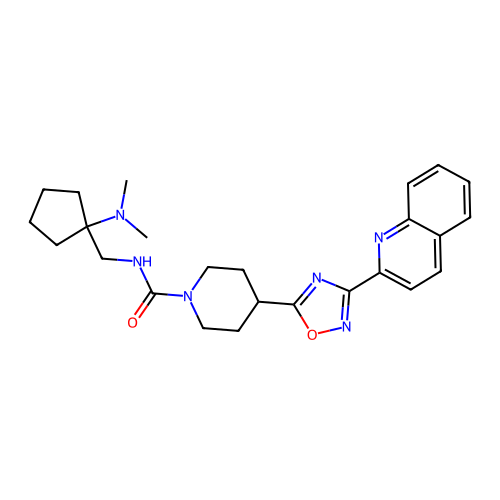

prediction: [0.7909368  0.20906313]
COCc1nc(-c2ccc(N3C(=O)N(c4cc(=O)nc[nH]4)C4(CCN(Cc5ncccc5C)CC4)C3=O)cc2)no1


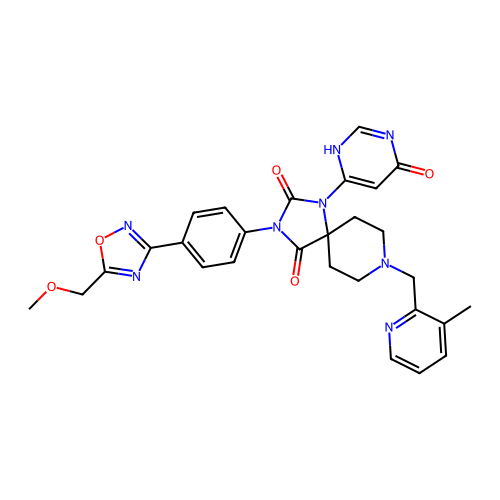

prediction: [0.7901489  0.20985115]
COc1ccc(C(CC(=O)N2CCN(Cc3nc4ccc(C)cc4o3)CC2)c2ccccc2)cc1


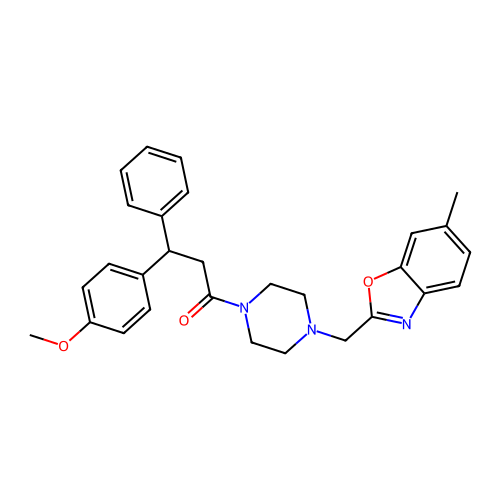

prediction: [0.78730357 0.21269642]
CCCc1nc(C)c2c(=O)nc(-c3cc([S+2]([O-])([O-])N4CC[NH+](CC)CC4)ccc3OCC)[nH]n12


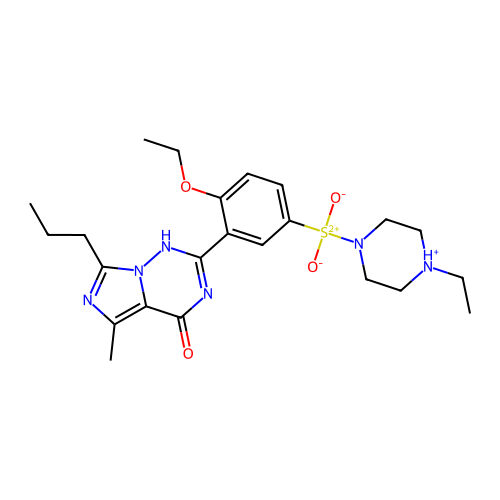

prediction: [0.7862342  0.21376579]
N#Cc1ccnc(N2CCC(C(=O)N3CC[C@H](N[C@H]4CC[C@@](O)(c5ccc(-c6ncccn6)cn5)CC4)C3)CC2)c1


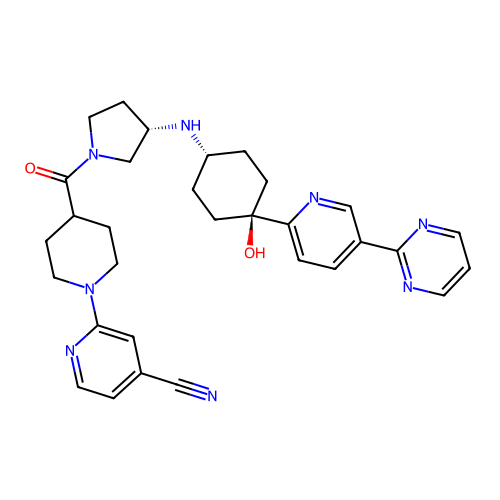

prediction: [0.78591543 0.2140846 ]
C[C@]1(CS(=O)(=O)N2CCC(Oc3ccc(OC(F)(F)C(F)F)cc3)CC2)NC(=O)NC1=O


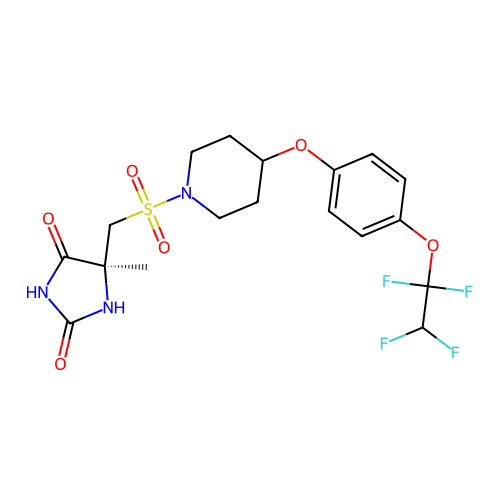

prediction: [0.7841958  0.21580419]
Cn1ccc([C@H]2CCNC[C@@H]2C(=O)N(Cc2cc(CCCC#N)cc(Cl)c2Cl)C2CC2)cc1=O


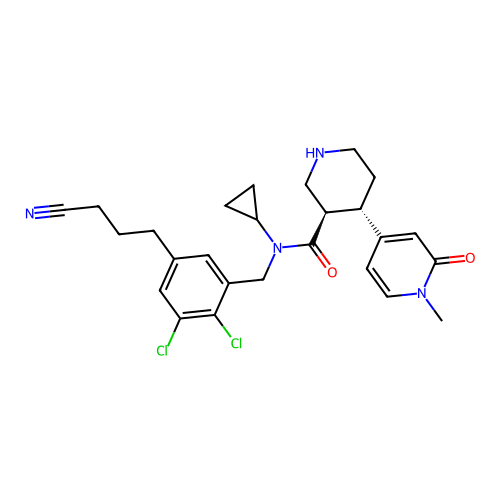

prediction: [0.7763784  0.22362159]
O=C(Nc1ccc(-c2nnn[nH]2)cc1F)[C@H](C1CCCCC1)n1c(-c2ccc(Cl)cc2)nc2cc(F)c(F)cc21


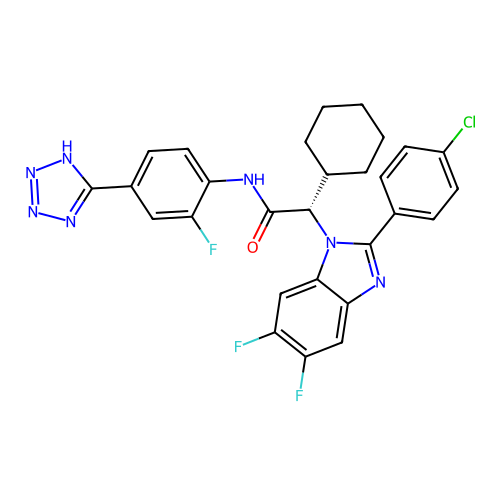

prediction: [0.7686903  0.23130971]
COc1ncc2ccc(=O)n(CCN3CCC(NCc4cc5c(cn4)OCCO5)CC3)c2n1


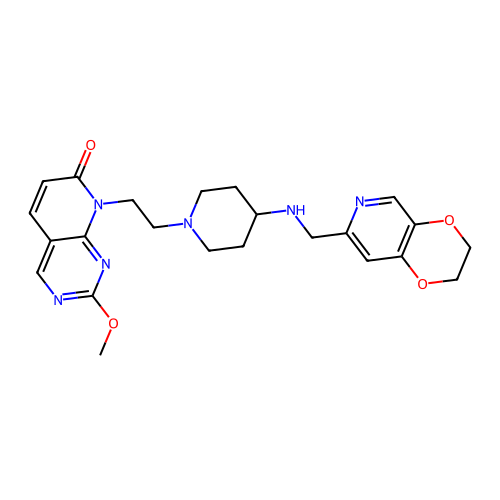

prediction: [0.76326394 0.23673612]
Cc1nn(-c2ccnc(Nc3ccc4c(c3)c(Cl)c(C)n4C)n2)cc1CN1CC(O)C1


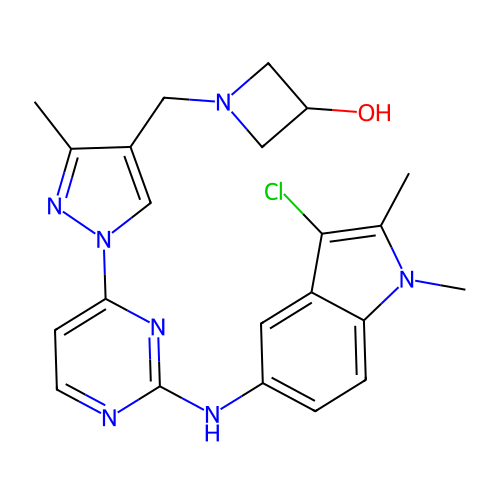

prediction: [0.75944763 0.24055241]
O=C(Cc1ccc(-n2cnnn2)cc1)N1CCN(CCc2ccc3nonc3c2)CC1


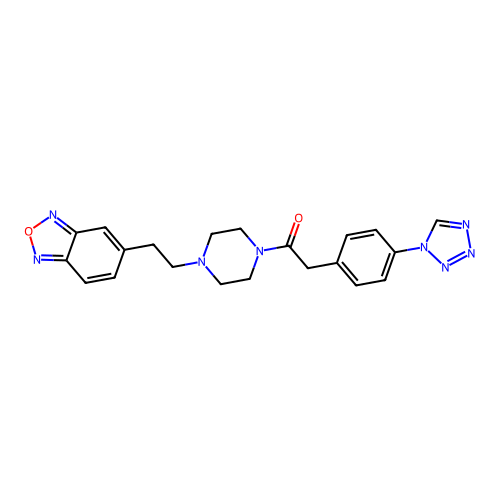

prediction: [0.7344221 0.2655779]
O=C(NO)C1(S(=O)(=O)c2ccc(Oc3ccc(OC(F)(F)F)cc3)cc2)CCC2(CCNCC2)C1


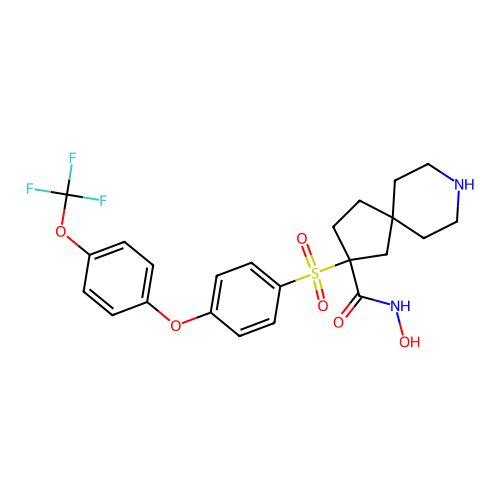

prediction: [0.7303583 0.2696417]
COc1cc(N2C(=O)N(c3ccc(-c4ccc(C(=O)O)c(Cl)c4)cc3)C(=O)C23CCN(Cc2ncccc2C)CC3)ncn1


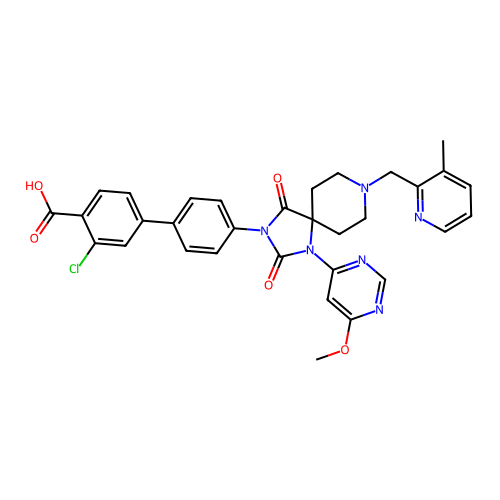

prediction: [0.7045162  0.29548386]
O=C(NC1CC1)c1ccc(OCCC2CC2C2CCN(c3ncc(Cl)cn3)CC2)cc1F


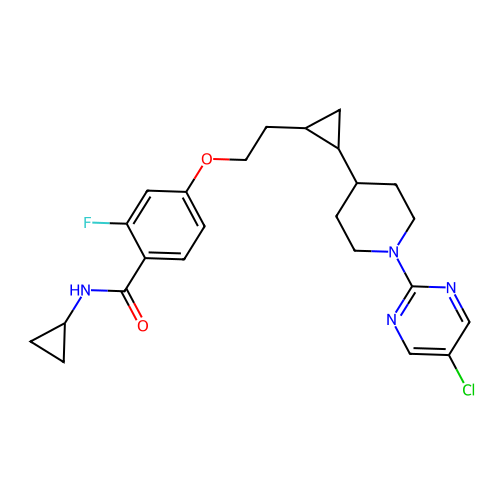

prediction: [0.6948078  0.30519223]
O=C(NCc1ccc(OC(F)(F)F)cc1)C1c2ccccc2C(=O)N1CCC1CCOCC1


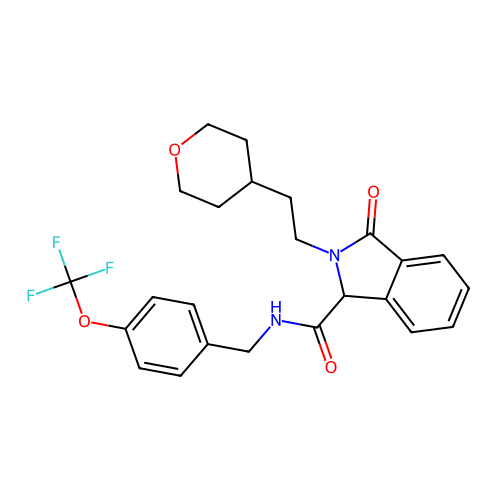

prediction: [0.69282895 0.30717105]
CSc1ncccc1C(=O)N1CCC([NH2+]Cc2cncn2Cc2ccc(C#N)cc2)C1=O


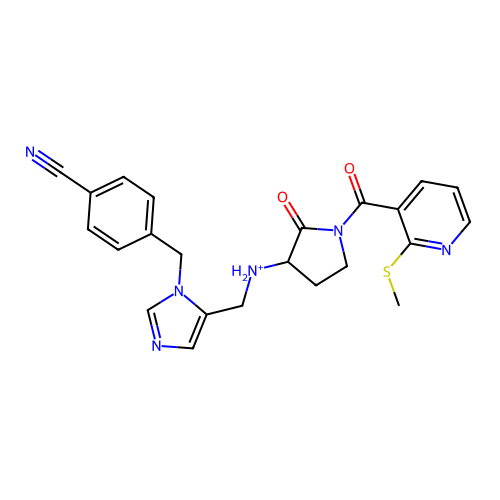

prediction: [0.67858535 0.32141462]
Cc1c([C@@H](O)CN2CCN(C[C@H](O)c3ccc(C#N)cn3)CC2)ccc2c1COC2=O


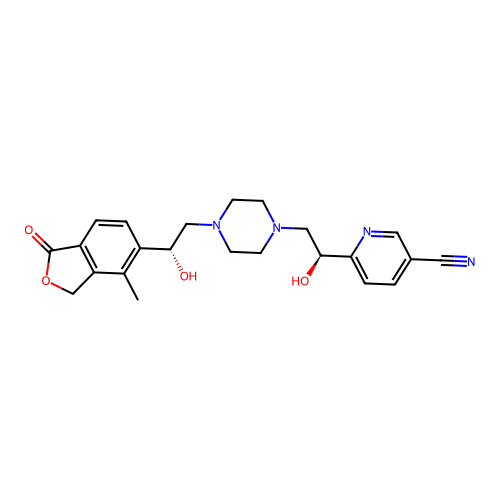

prediction: [0.6731353  0.32686472]
COCCCc1cc(CN(C(=O)[C@H]2CNCC[C@]2(O)c2ccccc2)C2CC2)cc(OCCOC)c1


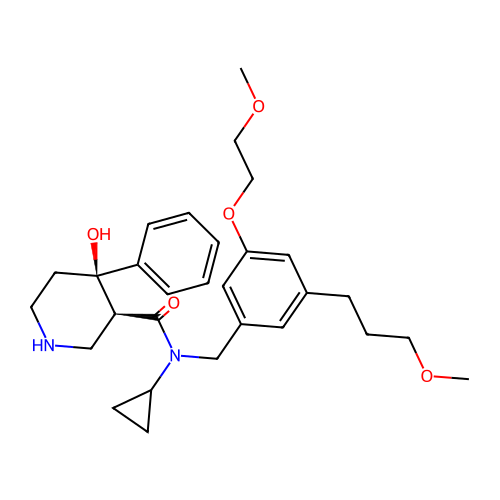

prediction: [0.6647047  0.33529532]
N#Cc1cccc2c1C(=O)Nc1ncc(-c3ccccc3)cc1C2


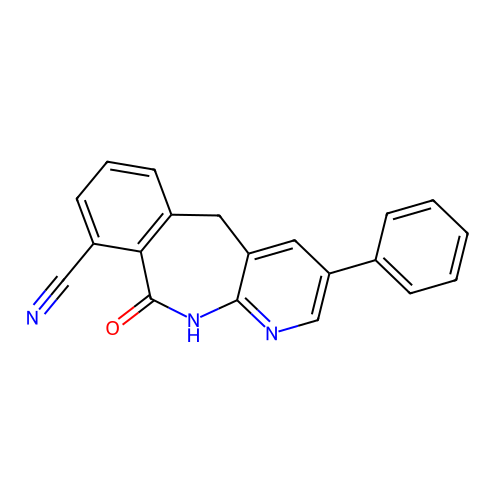

prediction: [0.6607448  0.33925518]
C[C@@H](c1ccc(-c2ccc(=O)n(C)c2)cc1)[C@H](N)C(=O)N1CC[C@H](F)C1


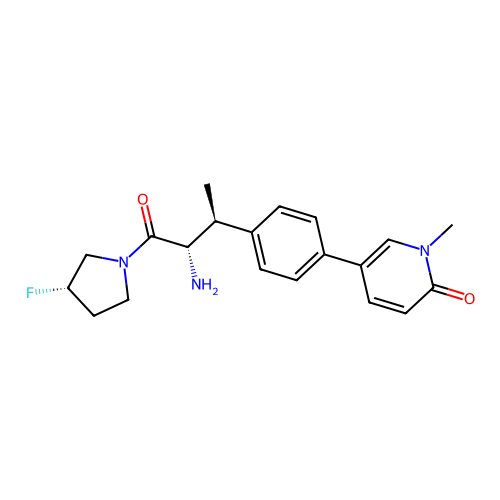

prediction: [0.63249385 0.3675061 ]
O=c1ccc2ncc(F)c3c2n1C[C@@]3(O)CC12CCC(NCc3ccc4c(c3)OC(F)(F)O4)(CC1)CO2


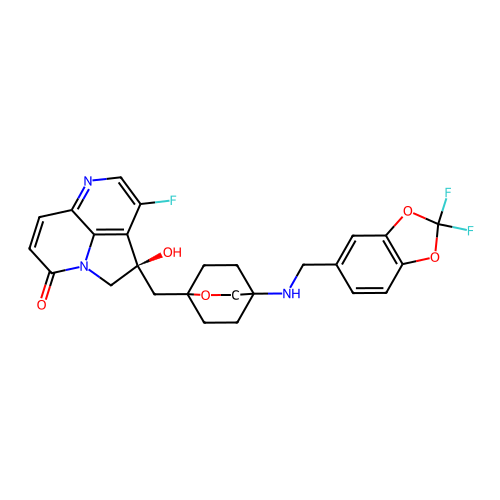

prediction: [0.63102263 0.3689774 ]
CN(CC(N)=O)Cc1nc(-c2cn(CC3CCOCC3)c3c(Cl)cccc23)no1


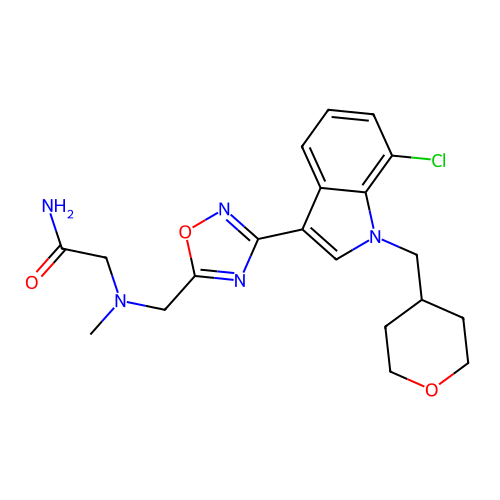

prediction: [0.6269618 0.3730382]
Cc1nc2cc3c(cc2o1)CCN(CCCSc1nnc(-c2ccc(C(F)(F)F)cc2)n1C)CC3


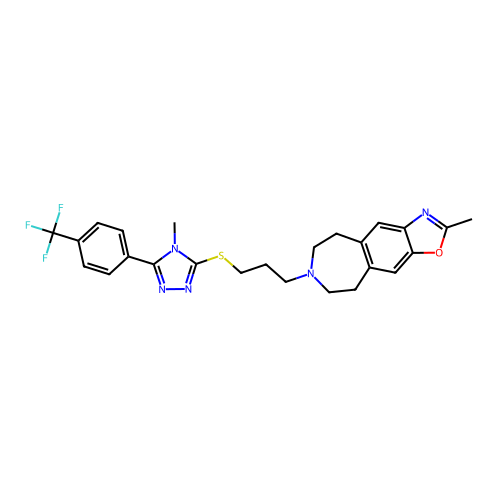

prediction: [0.62317044 0.3768296 ]
CCCCCCCCCCCCCCC[C@H](O)[C@H](N)CO


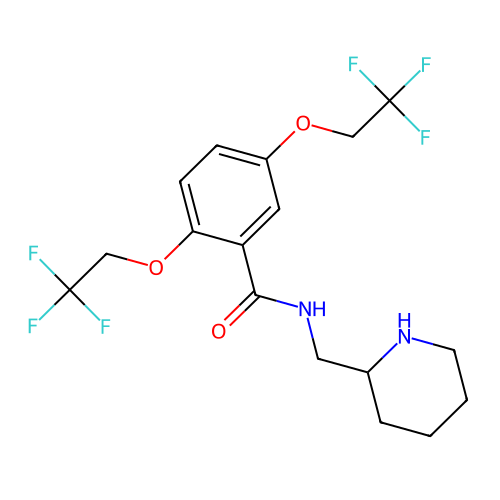

prediction: [0.59681886 0.40318117]
O=C(CNC(=O)c1cccc(C(F)(F)F)c1)NC1CN([C@H]2CC[C@@](O)(c3ccc(OC4CCC4)nc3)CC2)C1


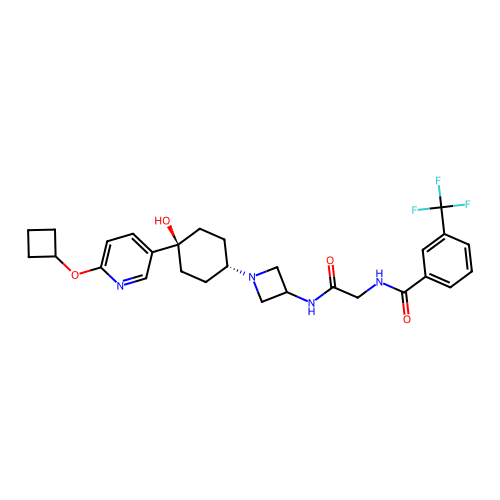

prediction: [0.5593871 0.4406129]
O=C(NC1CCN(Cc2cccc(F)c2)CC1)c1cc(=O)c2ccc(F)cc2o1


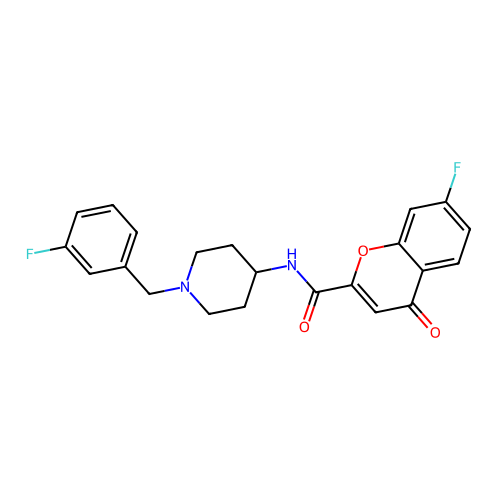

prediction: [0.5439154  0.45608464]
O=C(CC1CCN(Cc2ccn(-c3ccc(C(F)(F)F)cc3)c2)CC1)NC(c1ccc(F)cc1)c1ccc(=O)[nH]c1


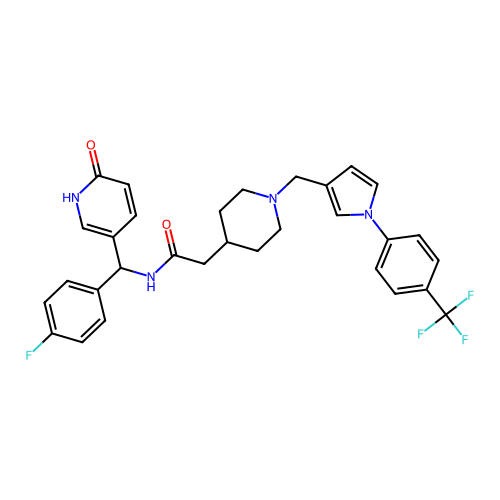

prediction: [0.5273564  0.47264364]
CO[C@@H]1COCC[C@@H]1N[C@@H]1CC[C@@](C(=O)N2CCN(c3cc(C(F)(F)F)cnn3)CC2)(C(C)C)C1


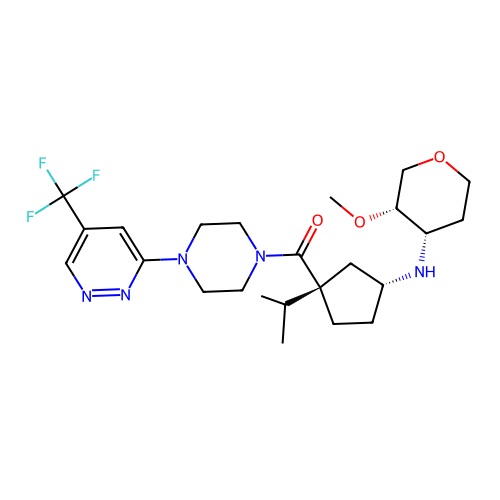

prediction: [0.5231187 0.4768813]
c1ncc(-c2cc3sc(N4CCC(N5CCCCC5)CC4)nc3cn2)cn1


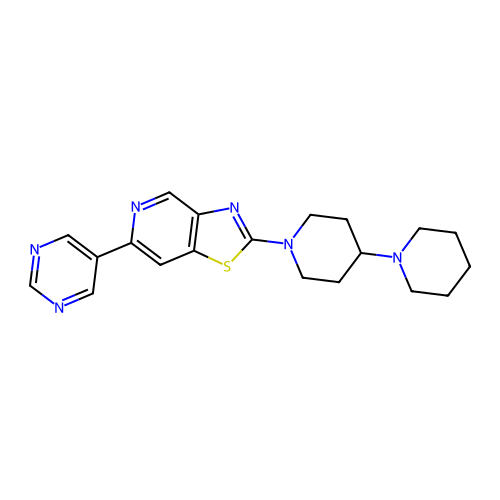

prediction: [0.5199402  0.48005983]
O=[N+]([O-])c1cn2c(n1)OC[C@@H](OCc1ccc(OC(F)(F)F)cc1)C2


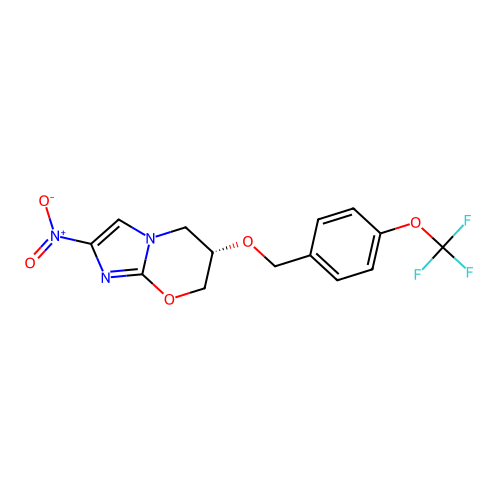

prediction: [0.5101802 0.4898198]
O=C(Nc1cccc(Cl)c1)N1CCN(C[C@@H]2CCCN(C3CC3)C2)CC1


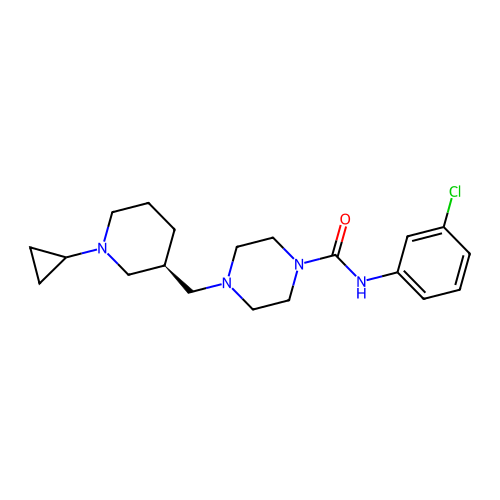

prediction: [0.50924957 0.49075046]
COc1c(-n2cnc(C)c2)ccc(-c2cn([C@H]3CCc4c(F)cccc4N(CC(F)(F)F)C3=O)nn2)c1F


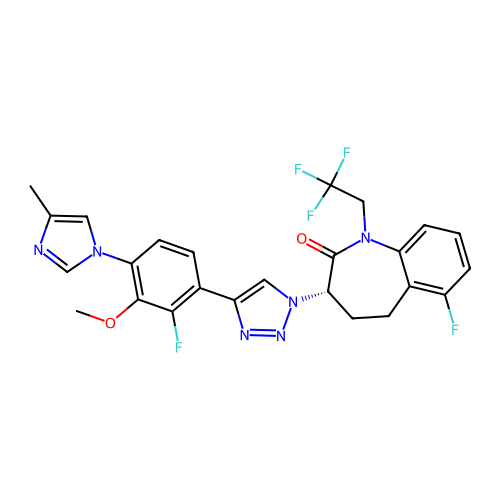

prediction: [0.5078577 0.4921423]
CS(=O)(=O)c1ccc(-n2cc(Cl)c(OC3CCN(c4ncc(Cl)cn4)CC3)cc2=O)c(F)c1


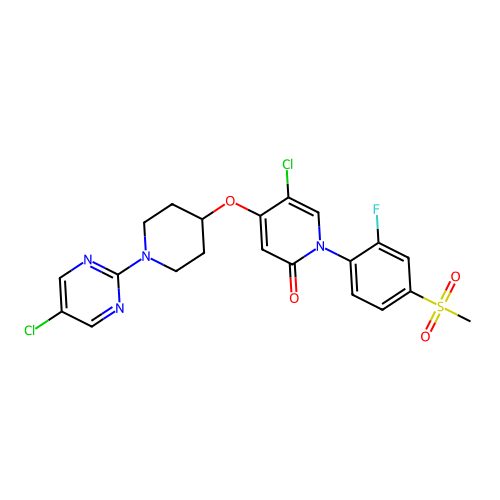

prediction: [0.504432   0.49556795]
CS(=O)(=O)c1ccc2c(c1)nc(C(F)(F)F)n2Cc1ccccc1


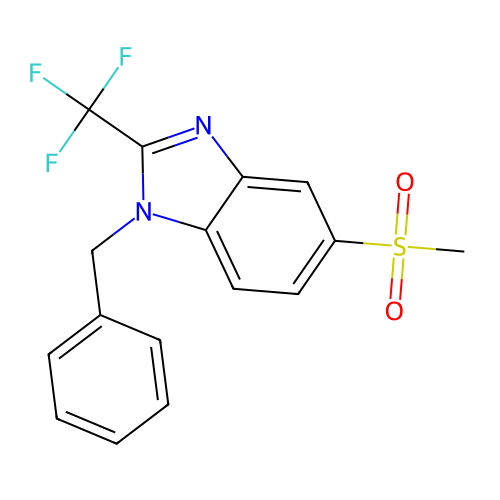

prediction: [0.4471025 0.5528975]
N[C@H](C(=O)N1CC(c2cc(F)ccc2F)=C[C@H]1c1ccccc1)C1CC1


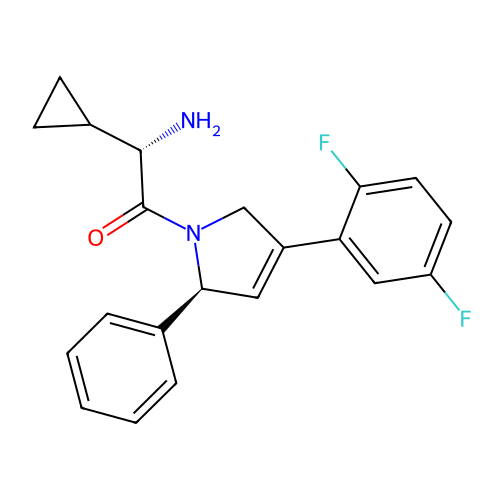

prediction: [0.4440062 0.5559938]
CCN(CC)CCNC(=O)c1c(C)[nH]c(/C=C2\C(=O)Nc3ccc(F)cc32)c1C


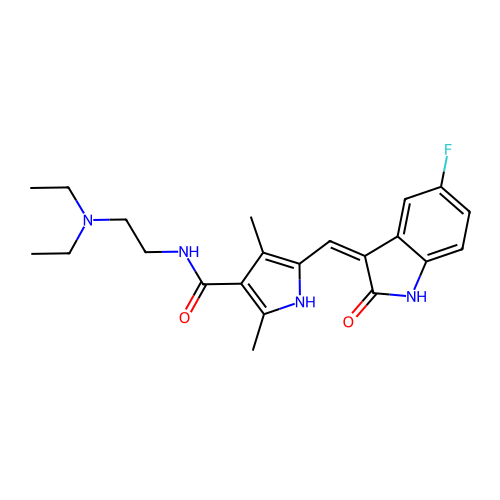

prediction: [0.42930865 0.57069135]
O=C([C@H]1CNCC[C@@]12OCc1cc(F)c(F)cc12)N(Cc1cccc2cccnc12)C1CC1


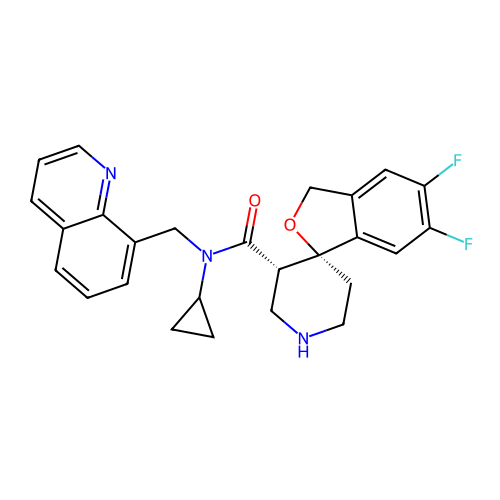

prediction: [0.42784873 0.57215124]
COc1cc(N2CCN(S(C)(=O)=O)CC2)ccc1Nc1ncc(Cl)c(-c2cnc3ccccn23)n1


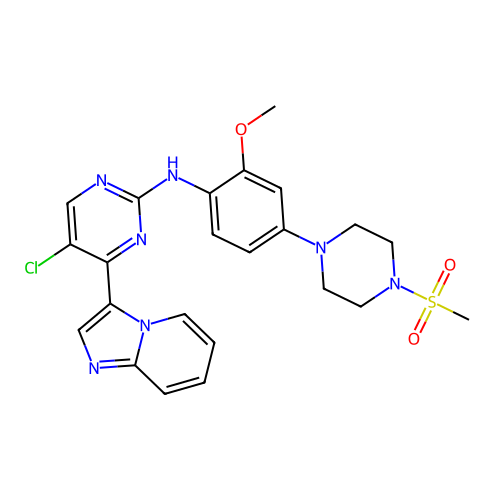

prediction: [0.40489185 0.59510815]
COc1ccc2ncc(F)c([C@@H](O)CN3CCC(NCc4cc5c(cn4)OCCO5)CC3)c2n1


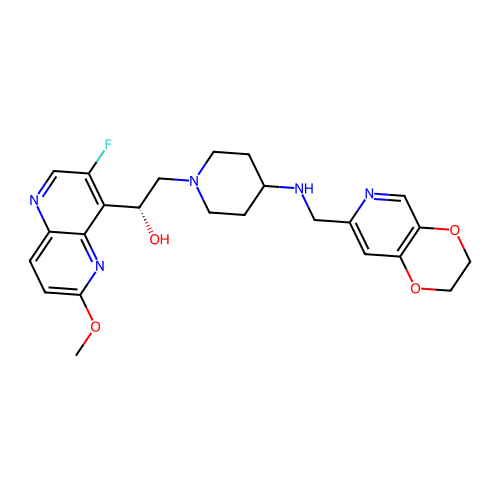

prediction: [0.40066686 0.5993331 ]
CCN(CC)C(=O)c1ccc(C2=CC3(CCNCC3)Oc3ccccc32)o1


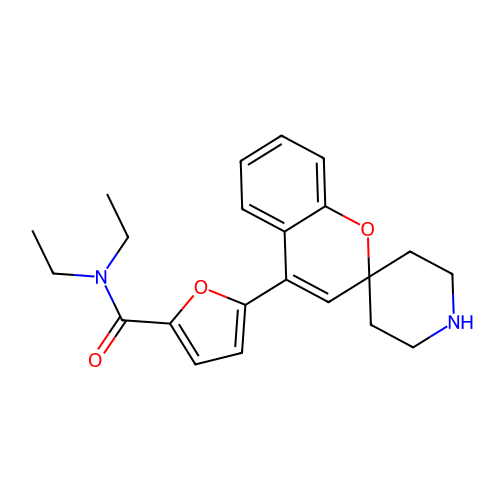

prediction: [0.40054804 0.5994519 ]
O=C(c1cccc(Cl)c1Cl)N(C1=CCOC=C1)[C@H]1CCNC1


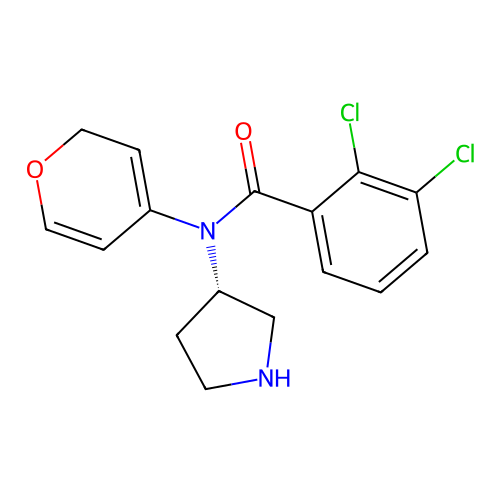

prediction: [0.3834661  0.61653394]
O=C([C@H]1CNCC[C@@]12OCc1cc(F)c(F)cc12)N(Cc1cc(Cl)ccc1Cl)C1CC1


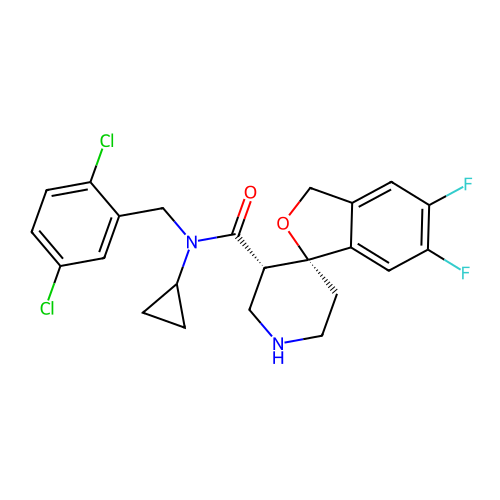

prediction: [0.37638646 0.6236135 ]
Cc1nc2cc3c(cc2o1)CCN(CCCSc1nnc(-c2ccc(F)c(F)c2)n1C)CC3


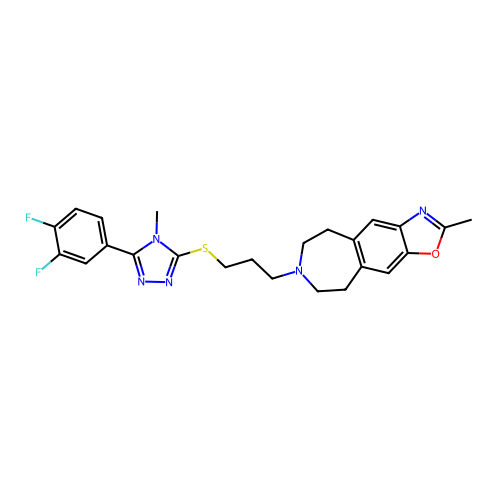

prediction: [0.36743167 0.6325683 ]
CCN(CC)C(=O)c1ccc(C2=CC3(CCN(C)CC3)Oc3ccccc32)cc1


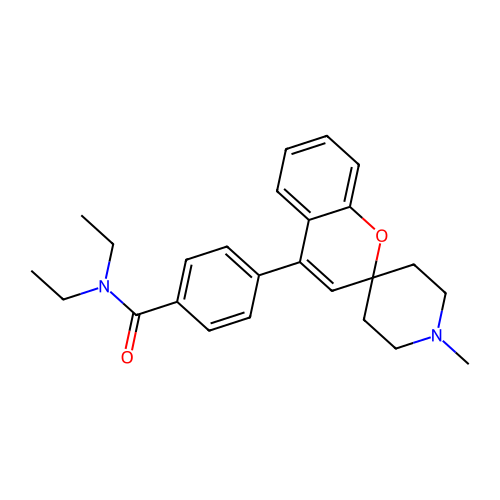

prediction: [0.36694494 0.633055  ]
COc1ccc(Oc2cc(C)c(-c3csc(NC(=O)c4ccnc(F)c4)n3)c(C)c2)cc1


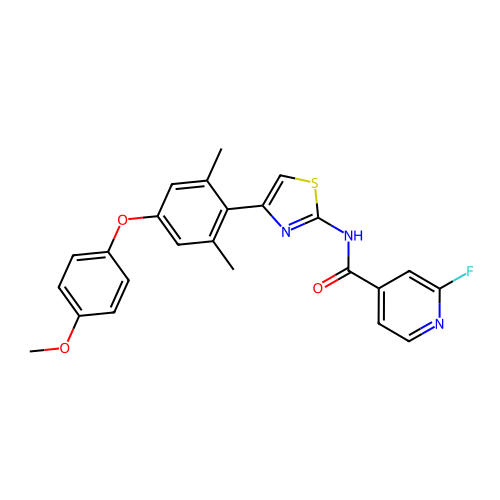

prediction: [0.35669783 0.6433022 ]
O=C(NCCN1CCCCC1)c1ccc(CN2CCC(NC(=O)c3cc(=O)c4ccc(F)cc4o3)CC2)cc1


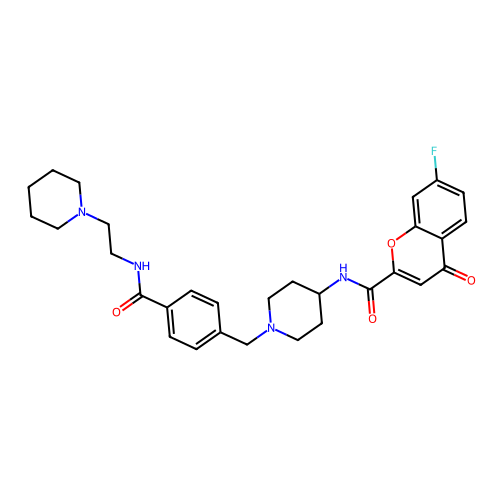

prediction: [0.35645166 0.64354837]
O=C(O)[C@H](Cc1ccc(Cl)cc1)N1CCC(CN2CCC(Oc3ccc(Cl)c(Cl)c3)CC2)CC1


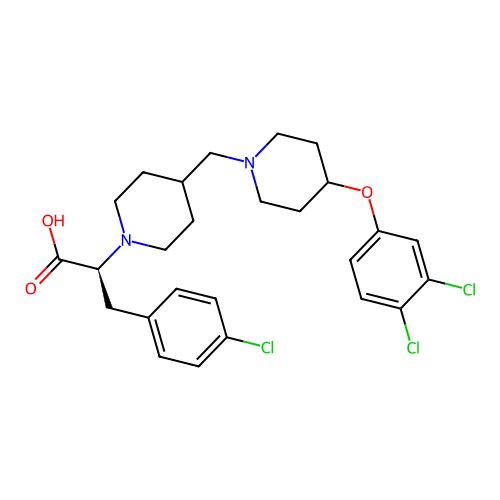

prediction: [0.3511715 0.6488285]
CNS(=O)(=O)c1ccc(-c2cnc(N)c(-c3ccc(C(F)(F)F)nc3)n2)cc1


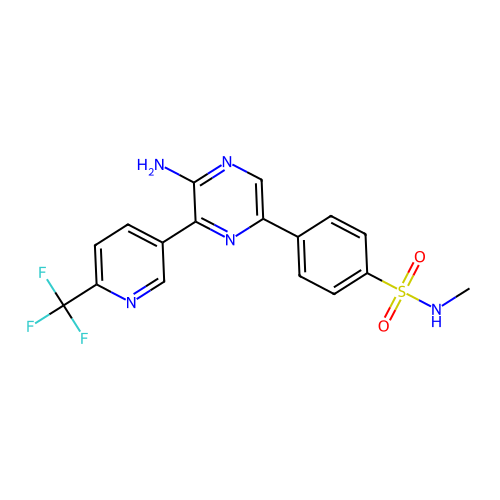

prediction: [0.34833175 0.6516683 ]
COCCCc1cc(Cl)cc(CN(C(=O)[C@H]2CNCC[C@@H]2c2ccn(C)c(=O)c2)C2CC2)c1


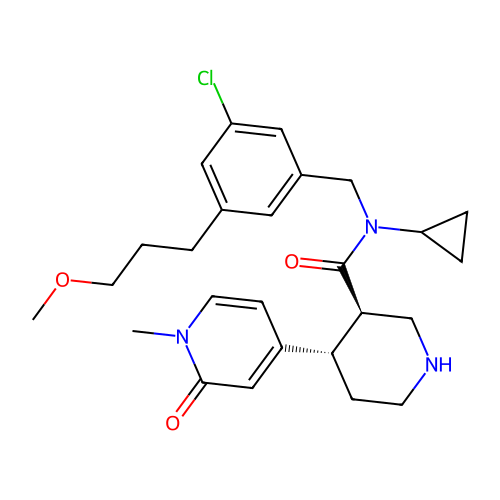

prediction: [0.34145352 0.65854645]
Cc1cc(-n2cnnn2)ccc1CC(=O)N1CCN(CCc2ccc3c(c2)COC3=O)CC1


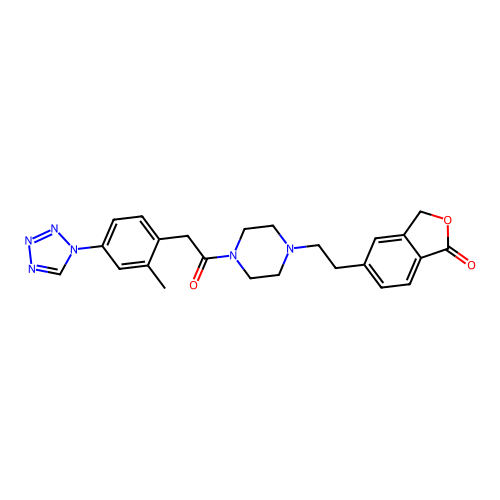

prediction: [0.3228774 0.6771226]
O=C(CC1CCN(Cc2ccn(-c3ccc(C(F)(F)F)cc3)c2)CC1)NC(c1ccc(F)cc1)c1c[nH]c(=O)c(Cl)c1


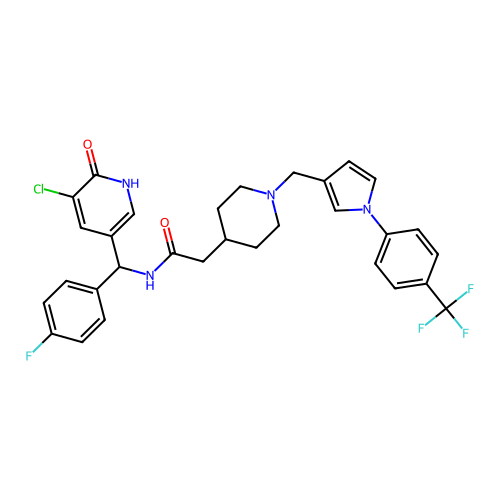

prediction: [0.31699446 0.6830056 ]
O=C(/C=C/c1ccc(CNCCc2c[nH]c3ccccc23)cc1)NO


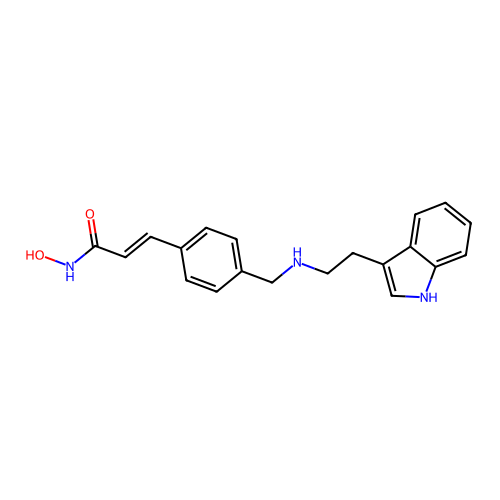

prediction: [0.3105557 0.6894443]
Oc1cc2c(c(Cl)c1O)CCNCC2c1ccccc1


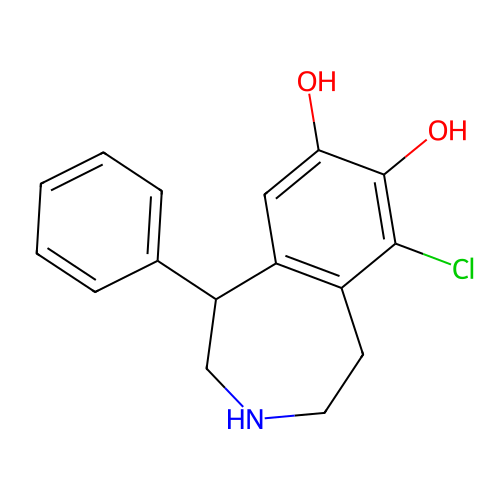

prediction: [0.3049395  0.69506043]
CC(CN(C)C)CN1c2ccccc2CCc2ccccc21


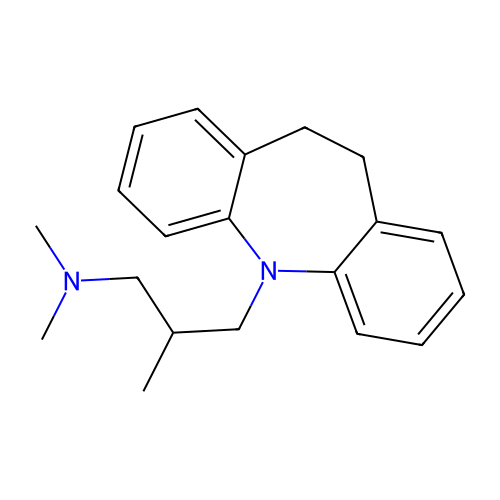

prediction: [0.29029745 0.7097026 ]
COc1cc(-c2cn([C@H]3C[C@@H](C(C)(C)C)CCN(CC(C)(C)C)C3=O)nn2)ccc1-n1cnc(C)c1


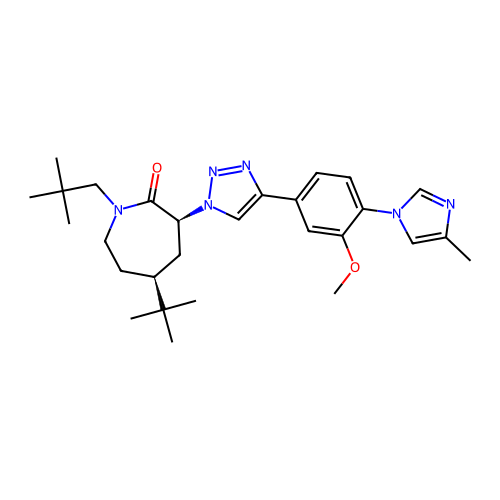

prediction: [0.2854919 0.7145081]
C(=C/c1ccccc1)\CN1CCN(C(c2ccccc2)c2ccccc2)CC1


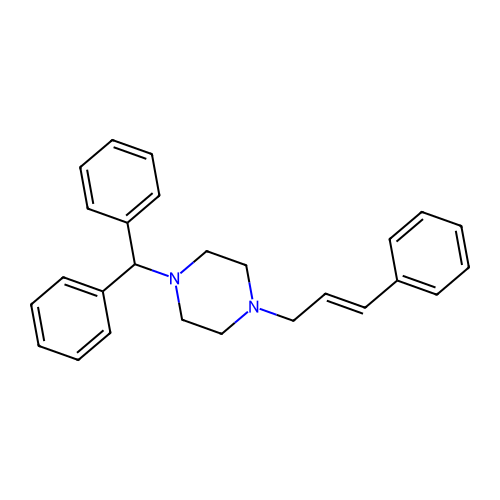

prediction: [0.2792609  0.72073907]
O=C(Nc1ccc(Cl)c(C(F)(F)F)c1)N1CCN(C[C@@H]2CCCN(C3CC3)C2)CC1


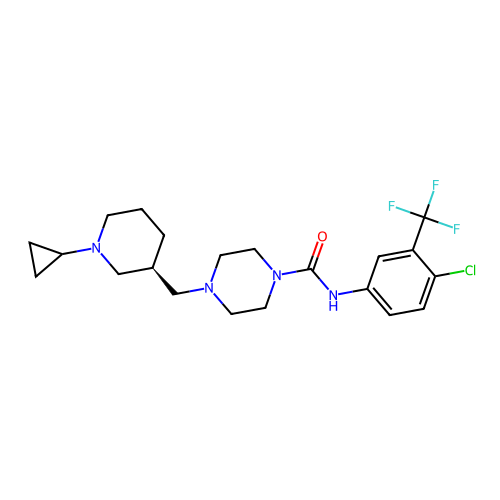

prediction: [0.27879646 0.7212035 ]
CN(CCN1CCCCC1)C(=O)[C@H]1CC[C@@]2(CC1)OC(=O)c1ccccc12


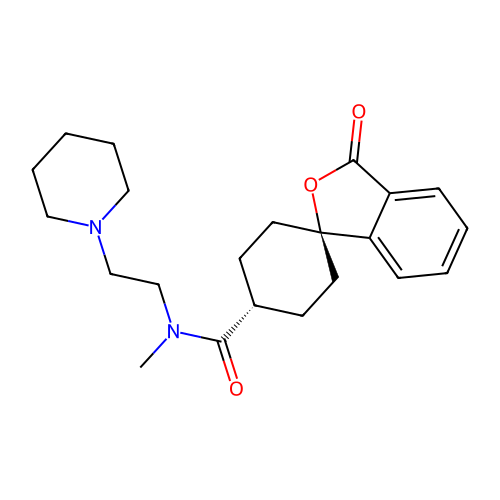

prediction: [0.27407604 0.725924  ]
O=C(N[C@@H]1COc2cccc(-c3ccnc(CO)c3)c2C1)c1ccc(OCC(F)(F)F)nc1


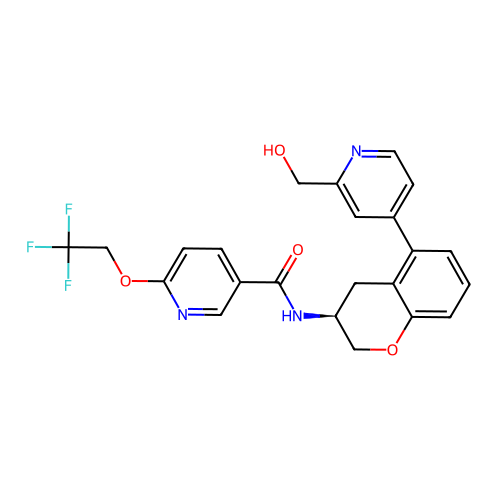

prediction: [0.2718968 0.7281032]
O=C1Nc2cc(NC(=O)c3c[nH]cc(-c4ccccc4F)c3=O)ccc2/C1=C/c1ccc[nH]1


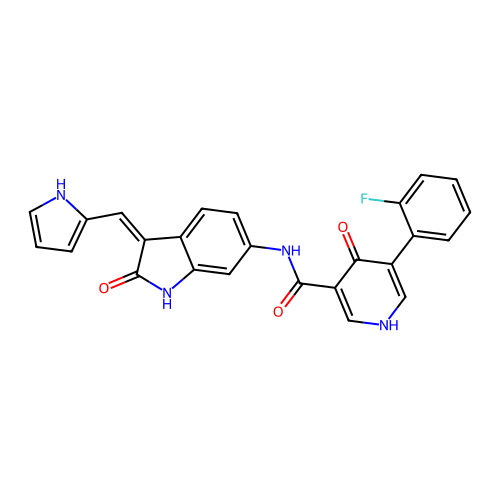

prediction: [0.26846853 0.7315315 ]
CC(C)CN(CC(C)C)c1cc(C(F)(F)F)cc(COCC2(c3ccc(F)cc3)CCN(C)CC2)n1


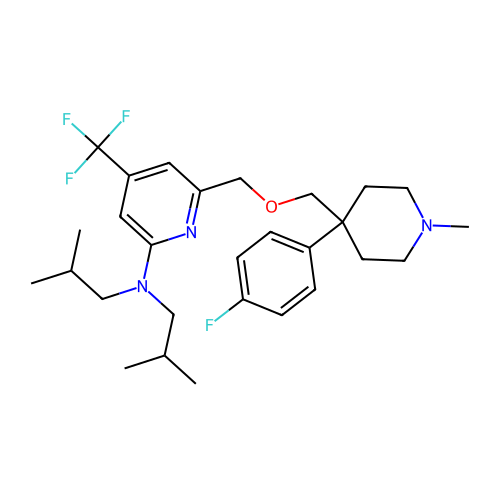

prediction: [0.26841614 0.73158383]
CCN1CCOC(C(=O)N2CCN(C(=O)Nc3ccc(Cl)c(Cl)c3)CC2)C1


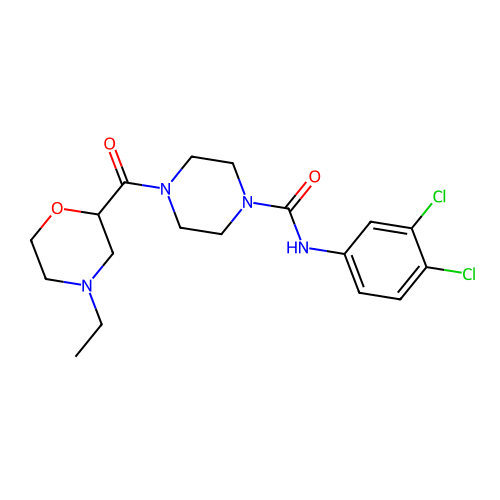

prediction: [0.26016435 0.73983574]
N#Cc1ccc(Cn2cncc2C[NH2+]C2CCN(c3ccncc3)C2=O)cc1


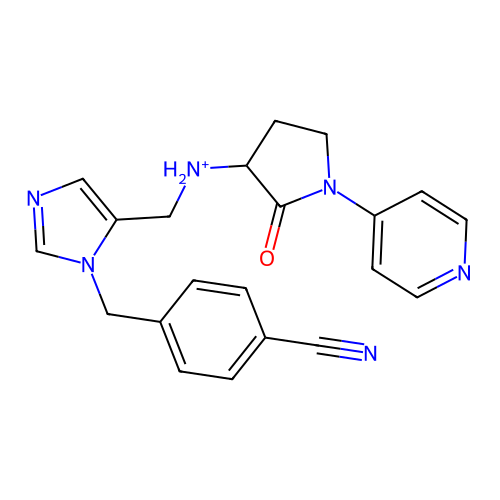

prediction: [0.24924722 0.75075275]
Cc1ccc(Cn2cnc(=O)c3cc(Oc4ncccc4C(F)(F)F)ccc32)cc1


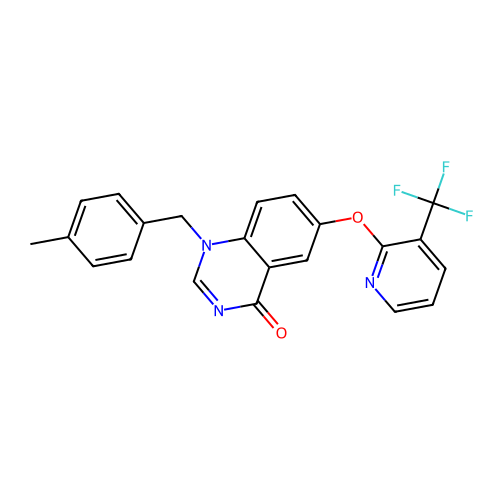

prediction: [0.24212962 0.7578704 ]
CCN(C)C(=O)c1ccc([C@H](c2ccccn2)N2CCN(Cc3ccccn3)CC2)cc1


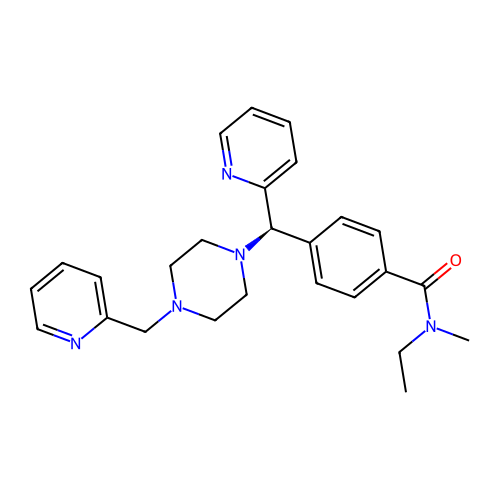

prediction: [0.23639522 0.7636048 ]
COc1cc(-c2cn(CC(=O)Nc3cccc4ccccc34)nn2)ccc1-n1cnc(C)c1


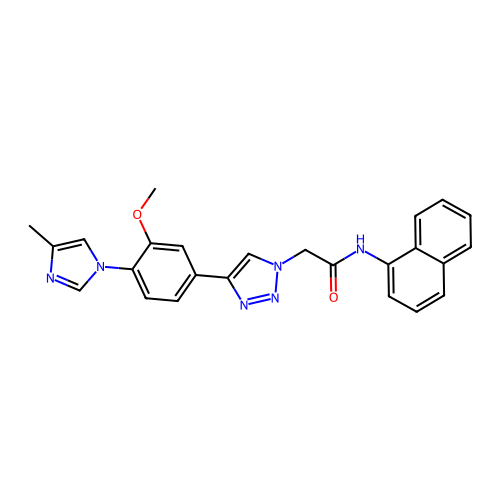

prediction: [0.23196007 0.76803994]
CC1(C)C[C@@H](NC(=O)c2n[nH]c3c2CCC3)c2cc(-c3ccc(Cl)cc3)c(-c3ccc(Cl)cc3Cl)nc2O1


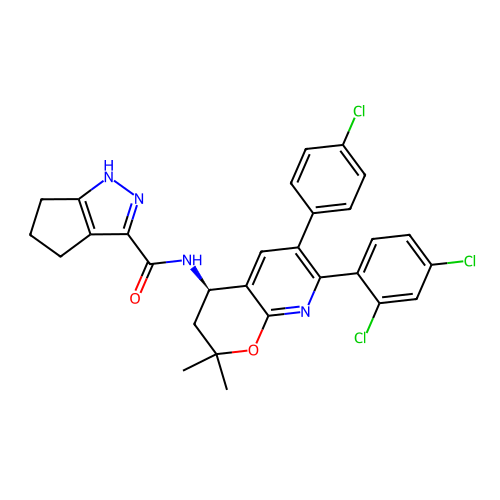

prediction: [0.22624888 0.77375114]
Cc1cc(C#N)ccc1-c1ccnc(NCc2n[nH]c3nc(F)ccc23)c1


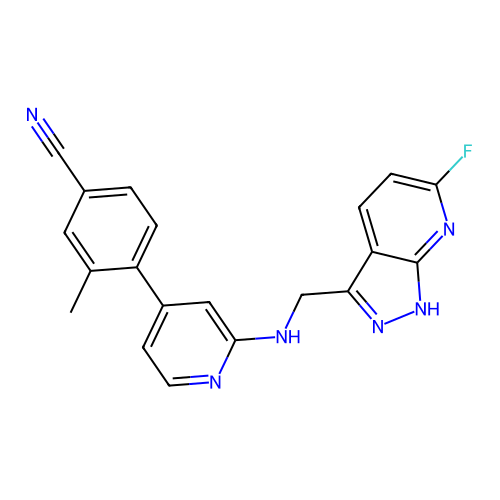

prediction: [0.22351252 0.7764874 ]
C[C@@H]1CCCN1CCc1ccc2nc(-c3ccc4nccnc4c3)ccc2c1


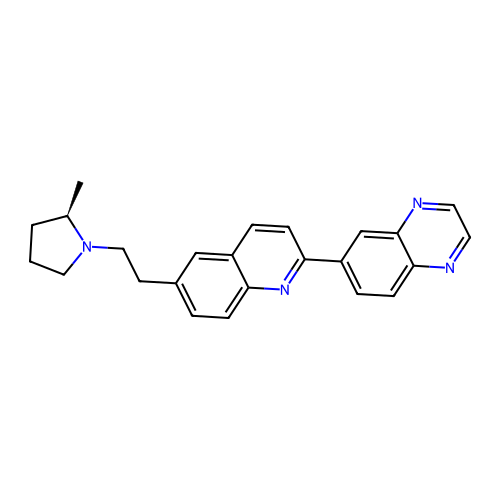

prediction: [0.22073504 0.7792649 ]
Cc1nc(C)c(-c2ccc(N3C(=O)N(c4cc(O)ncn4)C4(CCN(Cc5ncccc5C)CC4)C3=O)cc2)s1


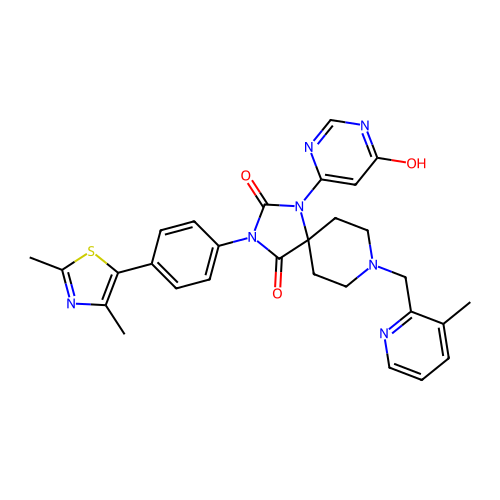

prediction: [0.21584268 0.78415734]
O=C(NC1CCN(Cc2ccn(-c3ccc(C(F)(F)F)cc3)c2)CC1)NC(c1ccccc1)c1ncc[nH]1


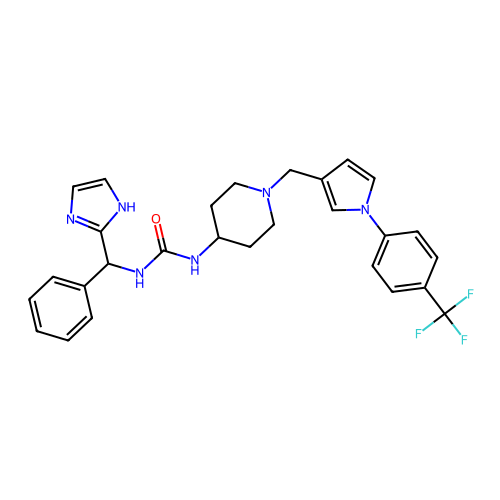

prediction: [0.2151862 0.7848138]
O=C(Nc1ccc(-c2nnc(NCCCN3CCCC3)o2)cc1)c1ccccc1F


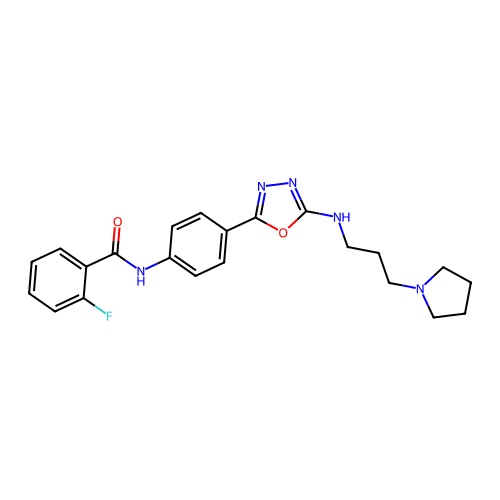

prediction: [0.21382773 0.78617233]
Cc1[nH]c2ccccc2c1CCN(CCF)Cc1ccc(/C=C/C(=O)NO)cc1


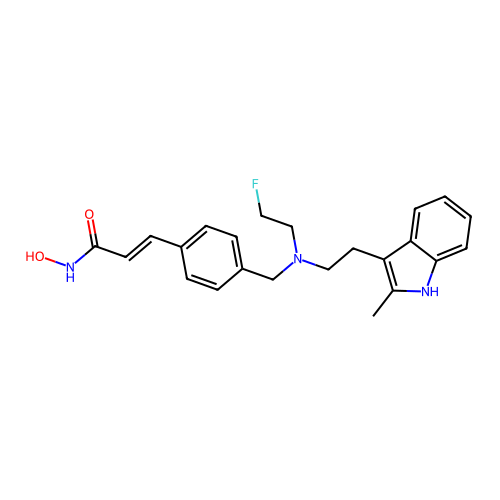

prediction: [0.20944174 0.79055834]
COc1ccc(CNC(=O)C2(c3ccccc3)CCN(c3cc(N)ccn3)CC2)cc1


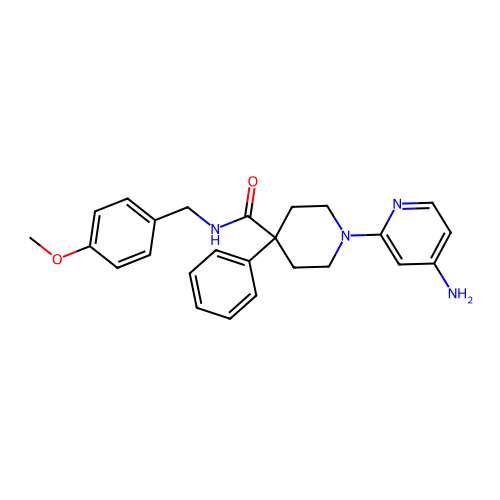

prediction: [0.20792955 0.79207045]
CN1CCC(Nc2nccc(-c3c[nH]nc3-c3ccc(Cl)cc3)n2)CC1


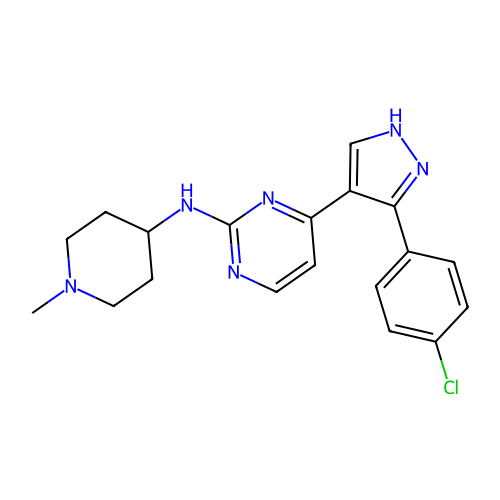

prediction: [0.20678398 0.793216  ]
CC(C)(C)c1ccc(C(=O)CC(=O)c2cc(Cl)ccc2O)cc1


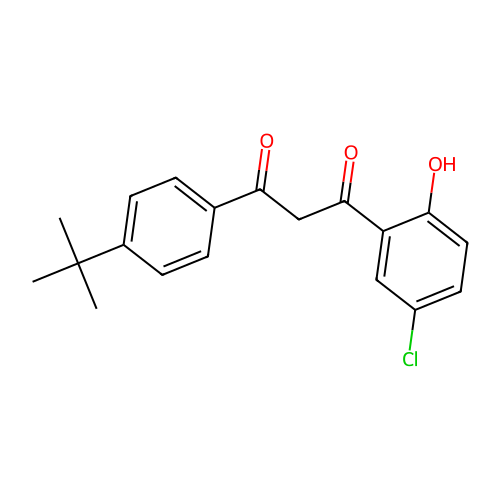

prediction: [0.20364939 0.79635066]
CCOC(=O)Nc1ccccc1[C@@H](c1ccc(C(=O)N(CC)CC)cc1)N1CCN(Cc2ccccn2)CC1


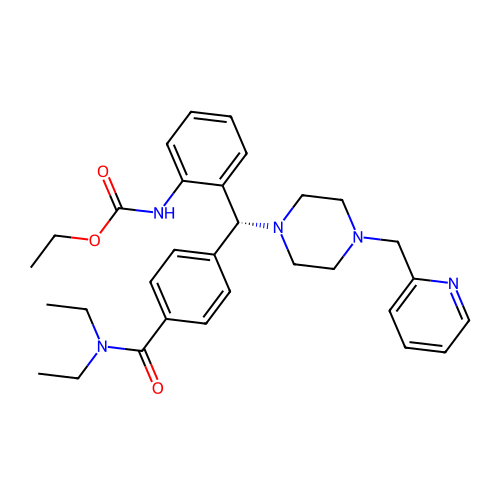

prediction: [0.19033727 0.80966276]
CNC(=O)[C@@]12C[C@@H]1[C@@H](n1cnc3c(NCc4cccc(Cl)c4)nc(C#Cc4ccc(F)c(F)c4)nc31)[C@H](O)[C@@H]2O


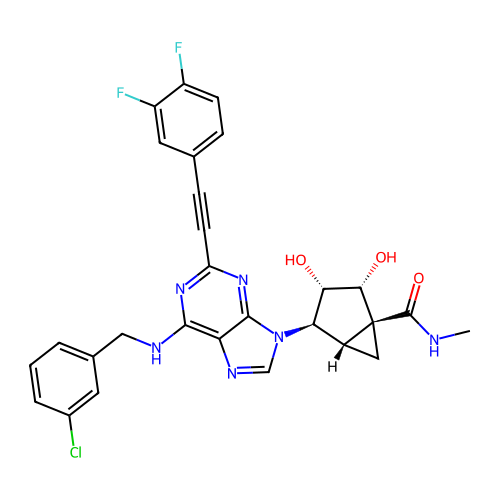

prediction: [0.18894263 0.8110573 ]
COc1ccc2ncc(S(C)(=O)=O)c(CCC34CCC(NCc5ccc6c(n5)NC(=O)CO6)(CC3)CO4)c2n1


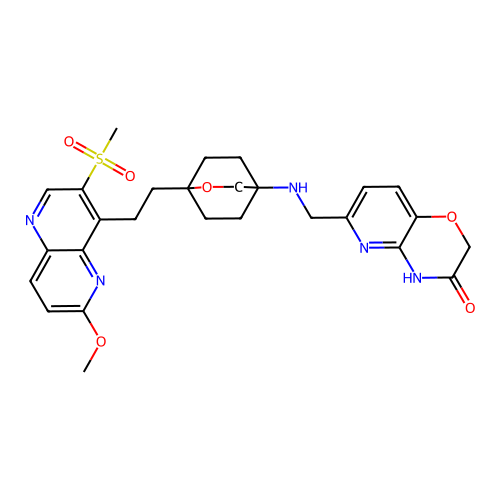

prediction: [0.18696667 0.81303334]
O=C(O)c1cc(CN2CCN(c3ccc(C(F)(F)F)cc3)CC2)c2ccccn2c1=O


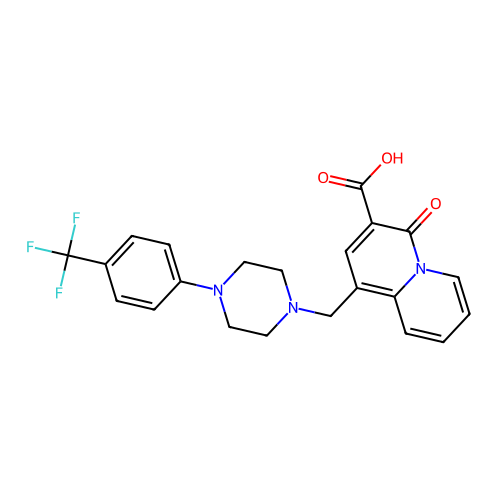

prediction: [0.17208263 0.8279174 ]
O=C(CCCN1CCCCC1)Nc1cc(-c2cccc(F)c2)n[nH]1


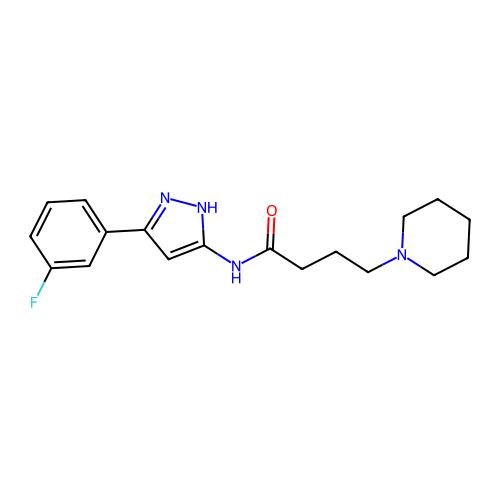

prediction: [0.16402753 0.8359724 ]
COc1cc([C@]23CNC[C@H]2C3)ccc1NS(=O)(=O)c1ccc(C(C)C)cc1


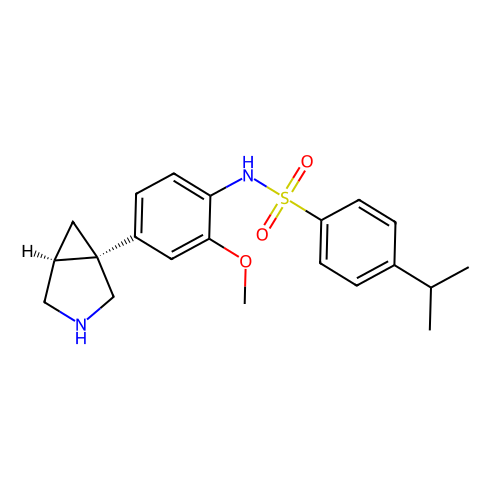

prediction: [0.1639998 0.8360002]
CNc1nc(NCCCN(C)C)c2sc(-c3ccccc3)cc2n1


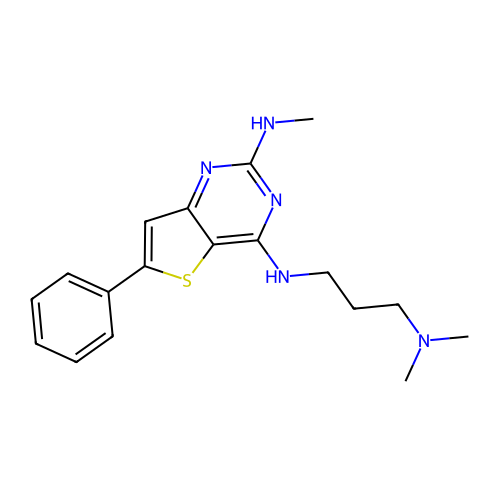

prediction: [0.16255596 0.837444  ]
CCn1cc(C2(c3cccc(-c4cncnc4)c3)N=C(N)c3c(F)cccc32)cc(C)c1=O


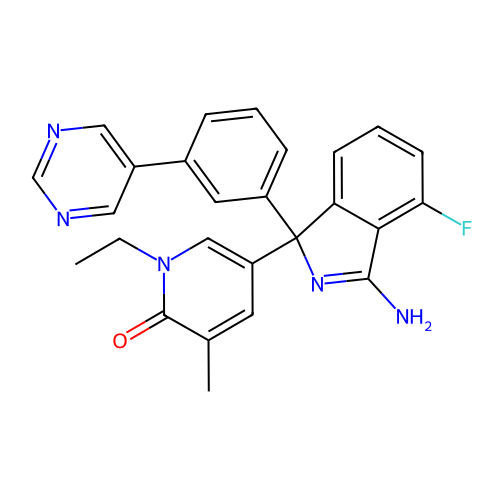

prediction: [0.15385963 0.8461404 ]
CN1CCc2cc(O)cc3c2[C@H]1Cc1ccc(O)c(O)c1-3


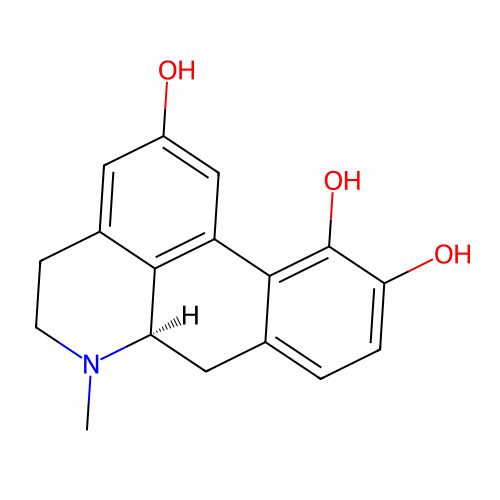

prediction: [0.1478589 0.8521411]
C[C@H](Oc1ccc(S(C)(=O)=O)cc1C(=O)N1CCN(c2ncc(C(F)(F)F)cc2F)CC1)C(C)(C)C


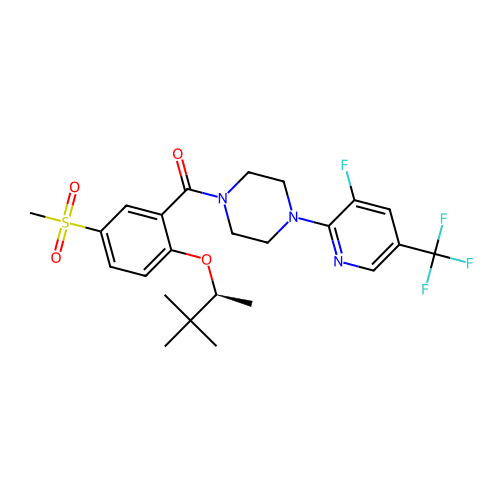

prediction: [0.14151478 0.8584853 ]
COc1cccc2[nH]c(-c3nc(N[C@@H]4CCOC[C@@H]4N)cnc3C(N)=O)cc12


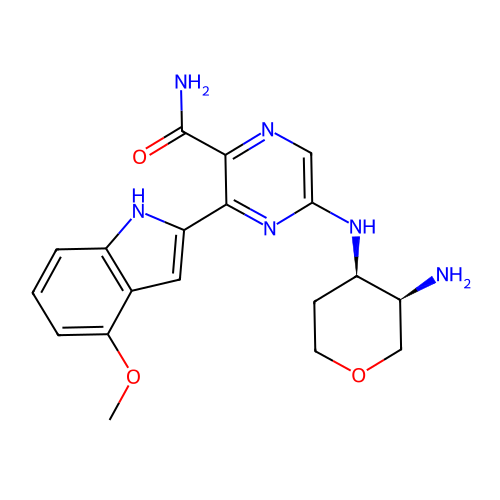

prediction: [0.13742441 0.8625756 ]
CC(C)n1nc(C(=O)NCC2CCN(CCc3ccc(N)cc3)CC2)c2ccccc21


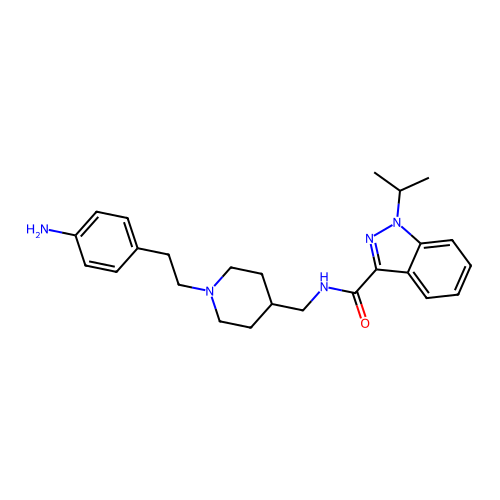

prediction: [0.13728836 0.86271167]
C=CC(=O)Nc1cc(Nc2ncc(Cl)c(-c3c[nH]c4ccccc34)n2)c(OC)cc1N(C)CCN(C)C


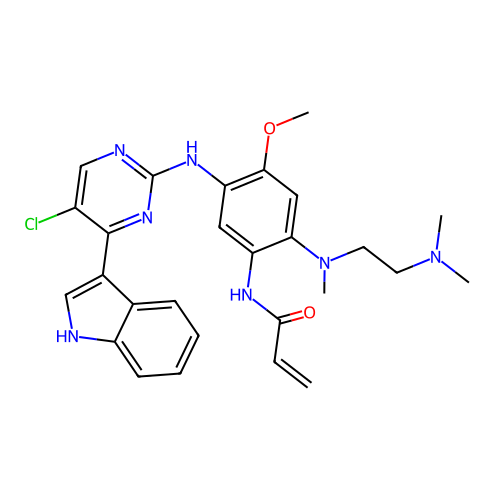

prediction: [0.13370082 0.86629915]
COc1cccc(N2CCN(C[C@H](O)COc3ccc(C(F)(F)F)cc3)CC2)c1


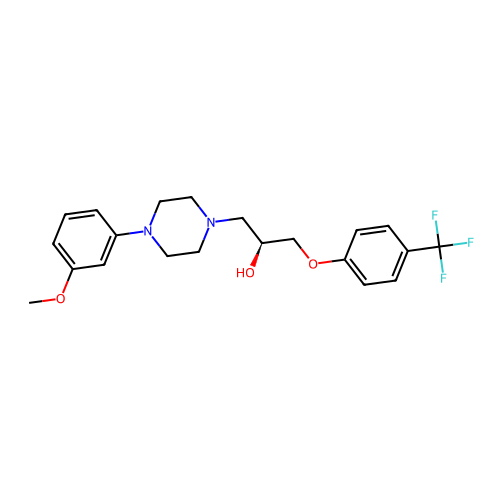

prediction: [0.13118944 0.8688106 ]
CNC(C)C1(c2ccc(Cl)c(Cl)c2)CCCCC1


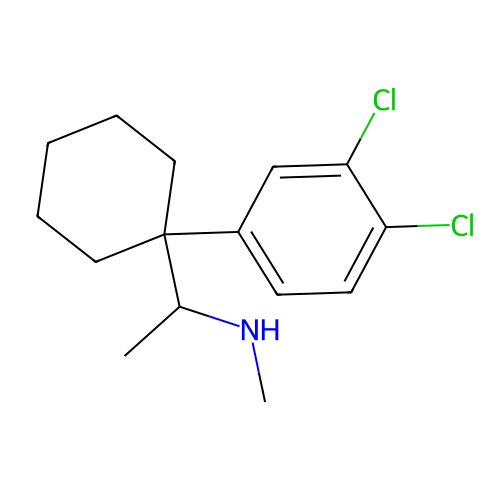

prediction: [0.13118944 0.8688106 ]
CNC(C)C1(c2ccc(Cl)c(Cl)c2)CCCCC1


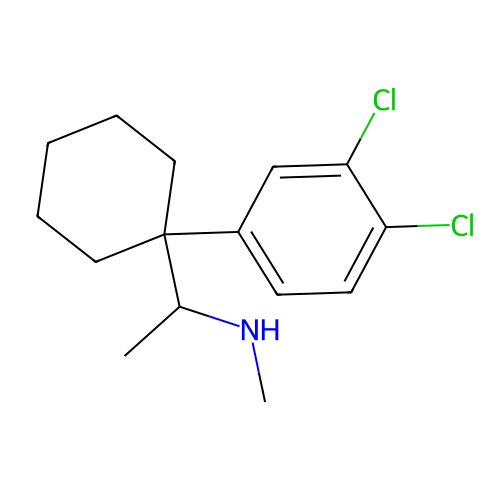

prediction: [0.12882966 0.87117034]
CC(C)=CCn1c(N2CCC[C@H](N)C2)c(C#N)c2ncn(Cc3ccnc4ccccc34)c(=O)c21


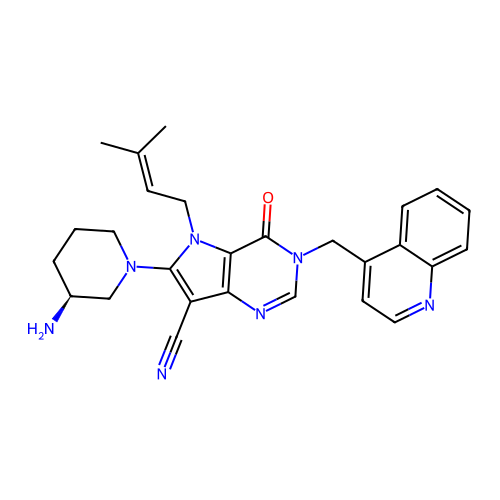

prediction: [0.1266376 0.8733625]
Cn1c(=O)cnn(CCCCN2CCN(c3cccc4ccc(O[11CH3])cc34)CC2)c1=O


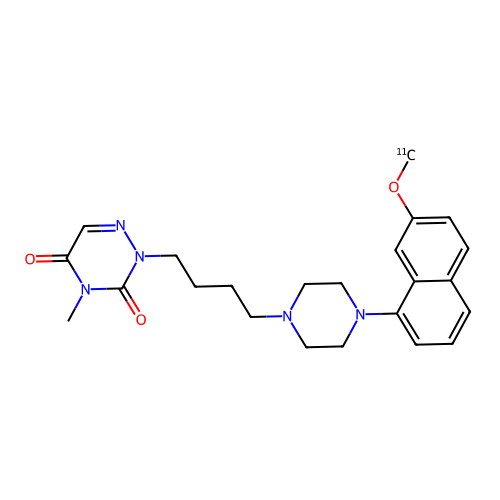

prediction: [0.12306105 0.8769389 ]
COCC[C@@H]1C[C@H](N(C)C(C)C)CC[C@@H]1NC(=O)CNC(=O)c1cccc(C(F)(F)F)c1


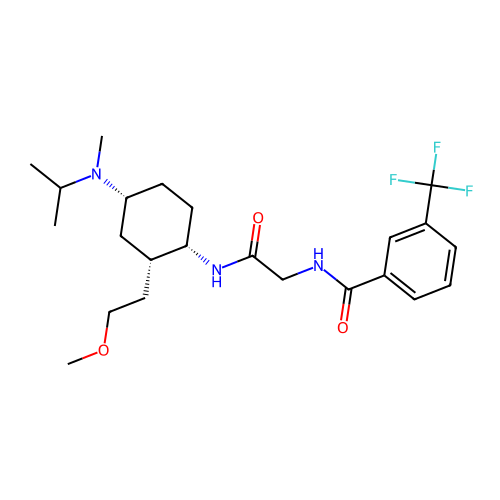

prediction: [0.12008134 0.8799187 ]
C[n+]1cc2c3c(ccc2c2ccc4cc5c(cc4c21)OCO5)OCO3


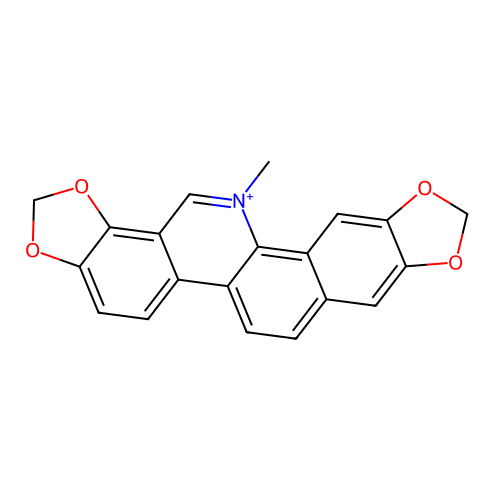

prediction: [0.11896694 0.881033  ]
CCCN(CCc1c[nH]c2ccccc12)Cc1ccc(/C=C/C(=O)NO)cc1


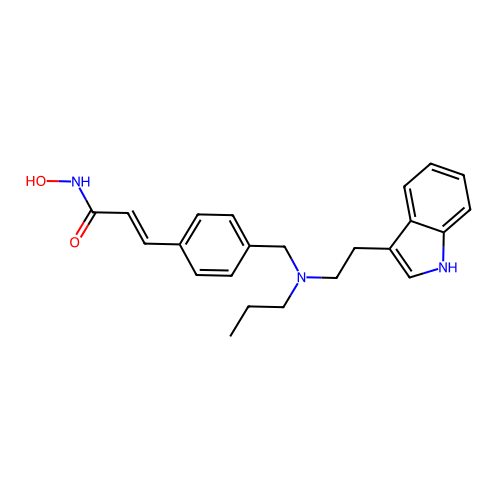

prediction: [0.11835822 0.88164175]
NC1=NC2(c3cc(-c4cncnc4)ccc3OCC23CC3)C(F)(F)CO1


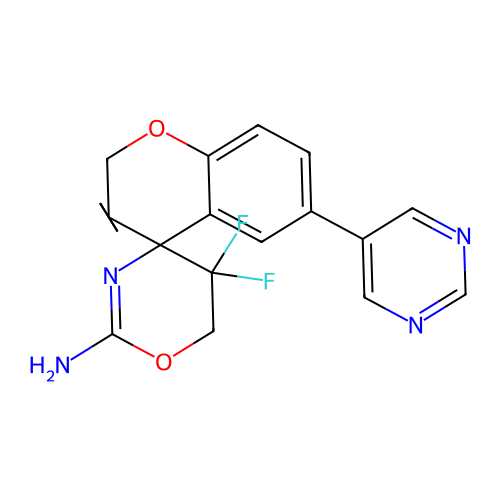

prediction: [0.11482918 0.8851708 ]
O=C(NC1CC1)c1ccc(OCC2CC2C2CCN(c3ncc(Cl)cn3)CC2)cc1F


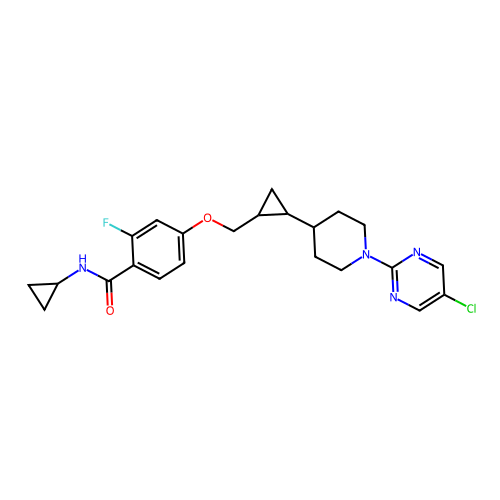

prediction: [0.11317383 0.8868261 ]
CCN(C(=O)Cc1ccc(S(C)(=O)=O)cc1)C1CCN(CC[C@@H](c2cc(Cl)cc(Cl)c2)C2CCN(S(C)(=O)=O)CC2)CC1


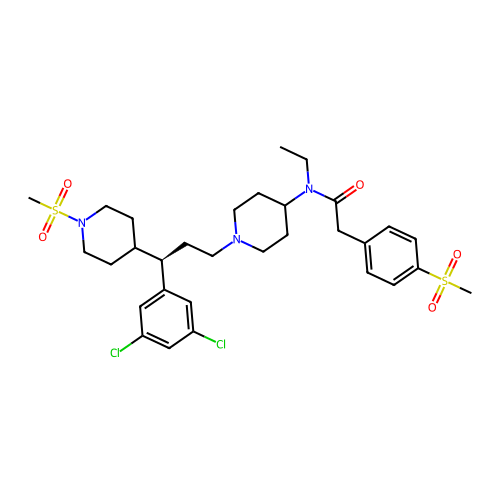

prediction: [0.11259476 0.8874052 ]
COc1cnc(-c2c(C)ccc(F)c2CCNC(=O)c2ccc(COCC(F)(F)F)nc2)cn1


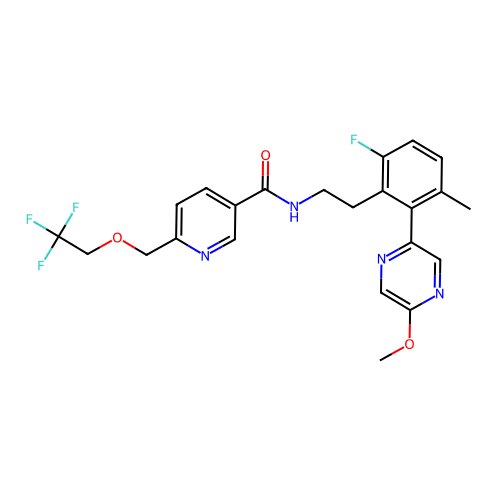

prediction: [0.11203861 0.8879613 ]
Brc1cnc2nc(N3CCN4CCC3CC4)oc2c1


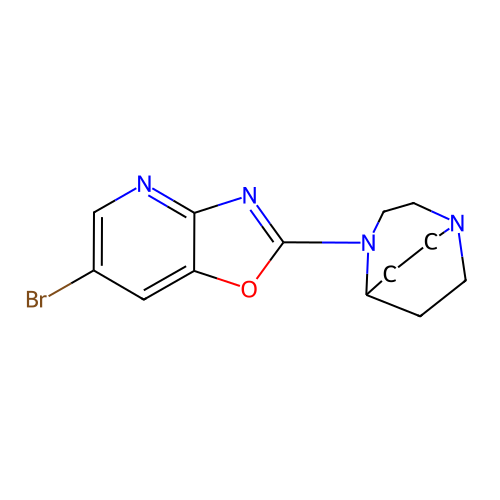

prediction: [0.10936435 0.89063567]
O=C([C@H]1CNCC[C@@]12OCc1cc(F)c(F)cc12)N(Cc1cccc(C(F)(F)F)c1Cl)C1CC1


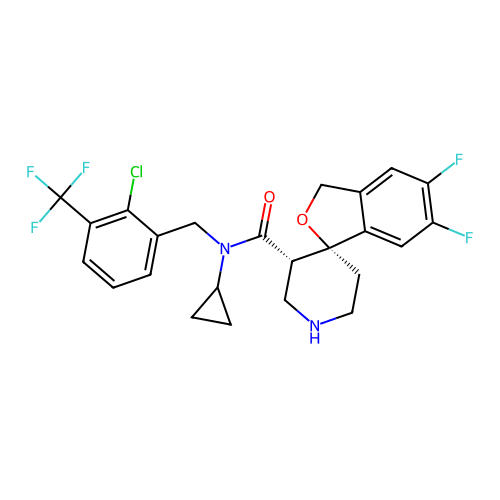

prediction: [0.1067441 0.8932559]
COc1cccnc1Nc1ccc2c(c1)C1(COC(N)=N1)C1(COC1)C1(CCC1)O2


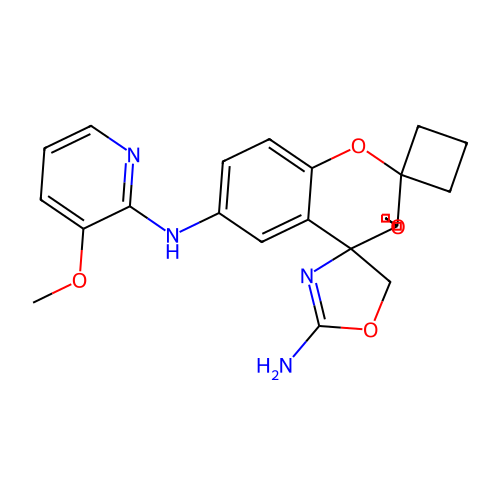

prediction: [0.10564843 0.89435154]
N#Cc1ccc2cc1Oc1ccc(Br)c(c1)CN1CC[C@@H](NCc3cncn3C2)C1=O


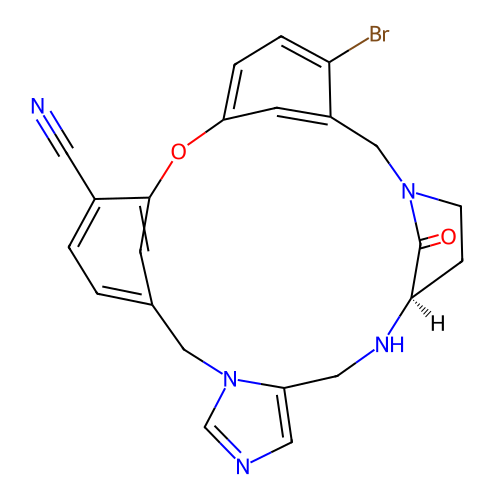

prediction: [0.10099145 0.8990085 ]
Cc1cc(C)nc(Nc2cc(NC[C@@H](N)CCS(C)(=O)=O)cnc2C(N)=O)c1


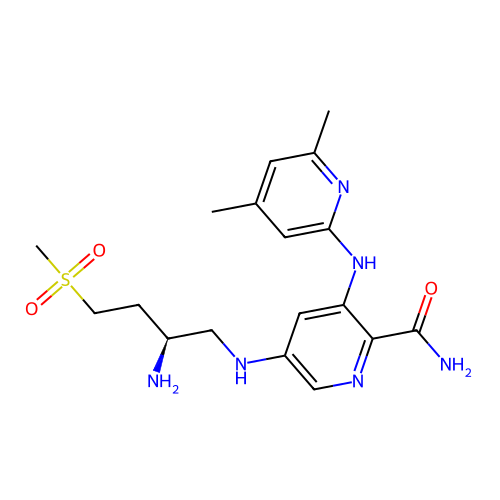

prediction: [0.09659738 0.90340257]
CC(C)S(=O)(=O)N[C@H]1CN(C)C[C@@H]1c1ccc(-c2cccc(NS(C)(=O)=O)c2)cc1


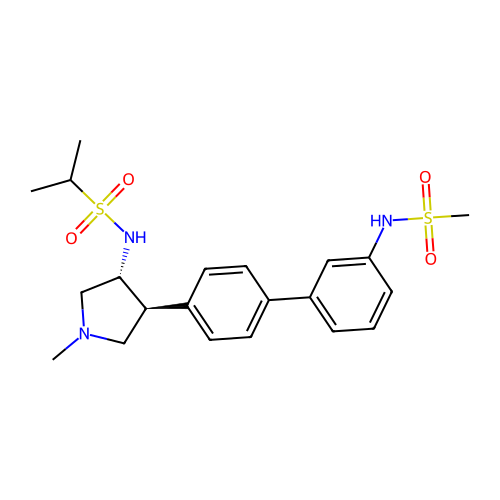

prediction: [0.09324392 0.90675604]
O=C(c1ccc(-c2ccc3c(c2)CCN(CCN2CCCC2)C3=O)c(F)c1)N1CCCC1


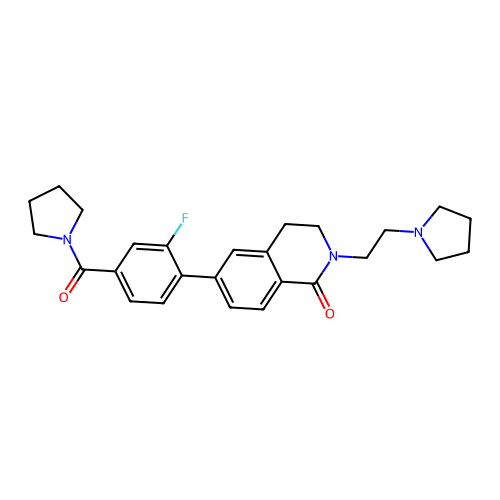

prediction: [0.09209641 0.9079036 ]
NCCCOc1ccc2ncc(F)c(CCC34CCC(NCc5ccc6c(n5)NC(=O)CO6)(CC3)CO4)c2n1


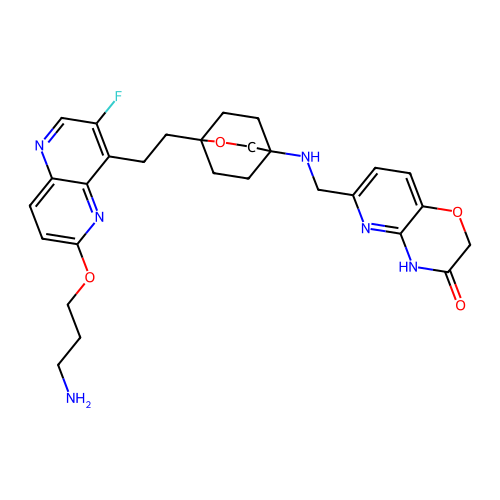

prediction: [0.09162432 0.9083757 ]
O=C1OCc2cc(CCN3CCN(C(=O)Cc4ccc(-n5cnnn5)cc4C4CC4)CC3)ccc21


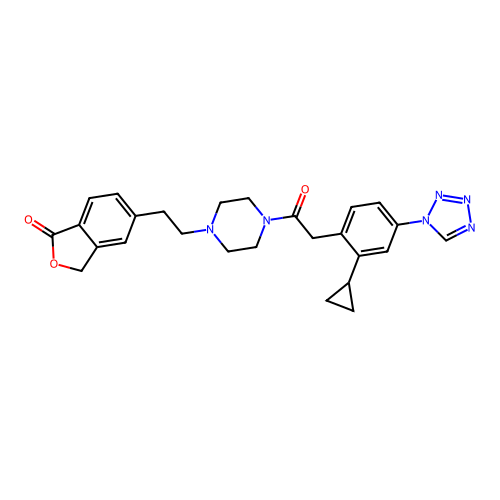

prediction: [0.08908232 0.91091764]
N#Cc1cccc(N2CCN(CCN3Cc4ccccc4C3)C2=O)c1


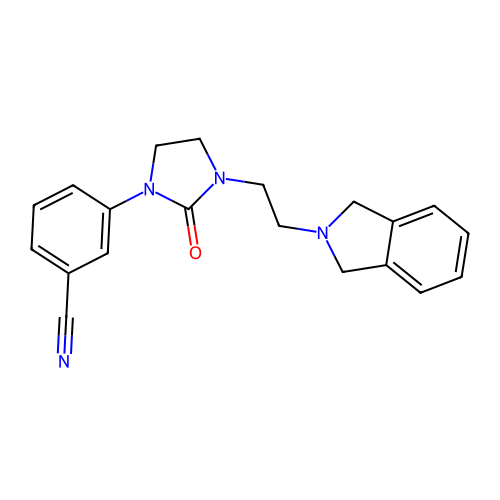

prediction: [0.08738837 0.9126116 ]
N[C@H](C(=O)N1CC(c2cc(F)ccc2F)=C[C@H]1c1cccc(O)c1)C1CC1


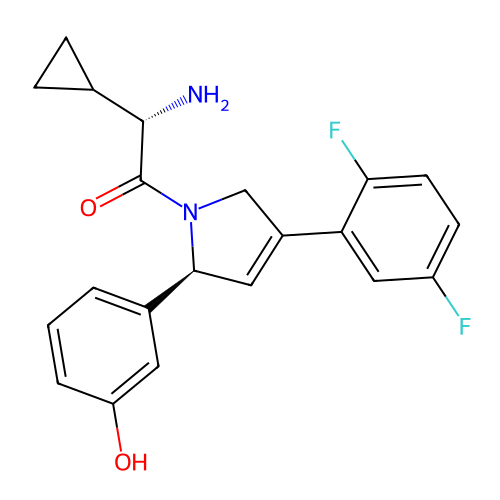

prediction: [0.08689359 0.9131064 ]
COC(=O)C1(CNC(=O)c2cc(OC)cc(OC)c2)CCN(Cc2ccccc2C(F)(F)F)CC1


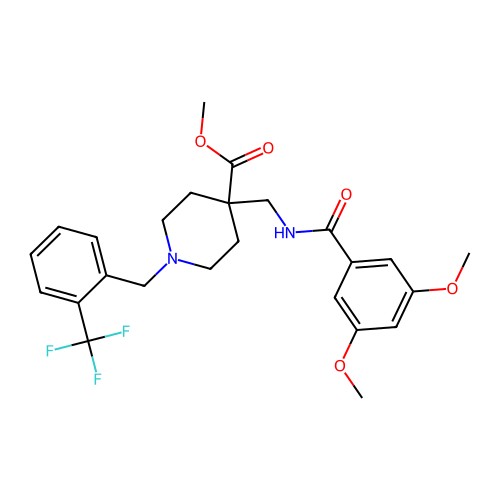

prediction: [0.08554027 0.9144597 ]
Cc1c2c(n3c1CCCN1CCC[C@@H](C1)Nc1cc-3ccc1C(N)=O)CC(C)(C)CC2=O


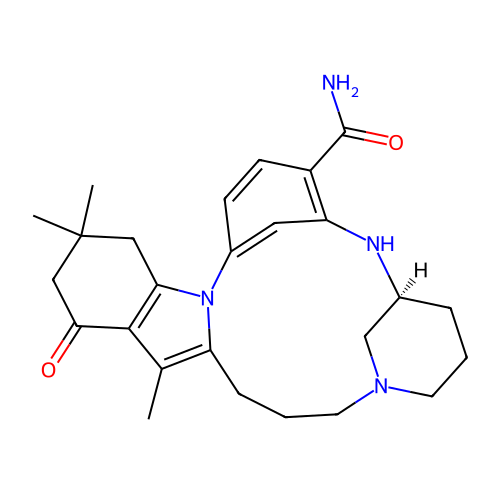

prediction: [0.07755882 0.9224412 ]
O=C1N(CCN2CCC(C(F)(F)F)CC2)CCN1c1cccc(O)c1


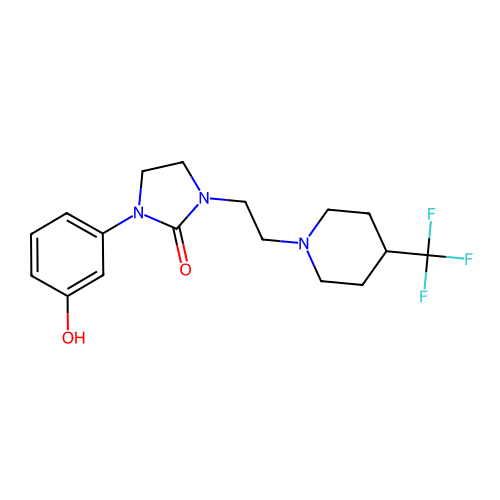

prediction: [0.07703084 0.9229691 ]
COc1c(C)cc(C2(c3cccc(-c4cncnc4)c3)N=C(N)c3c(F)cccc32)cc1C#N


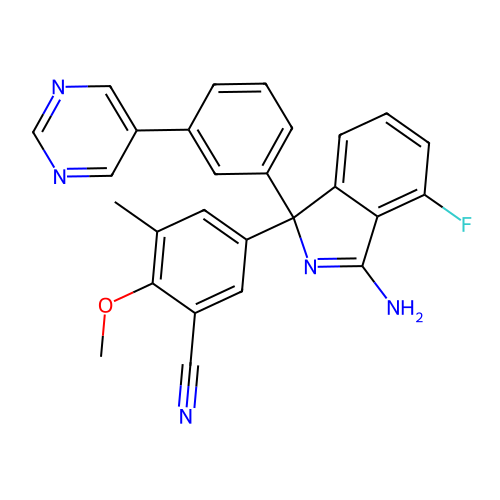

prediction: [0.07609765 0.92390233]
CCOc1cc2nccc(Oc3cnc(CC(=O)Nc4n[nH]c(CC)c4C)c(OC)c3)c2cc1OC


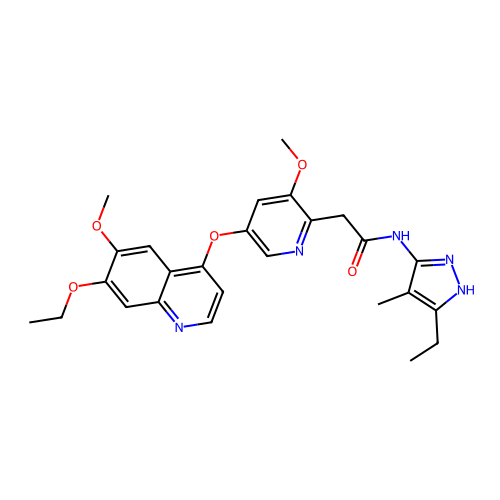

prediction: [0.07545343 0.9245466 ]
Cc1ccc2c(-c3nnc(SCCCCN4CCc5cc6nc(C)oc6c(C)c5CC4)n3C)cccc2n1


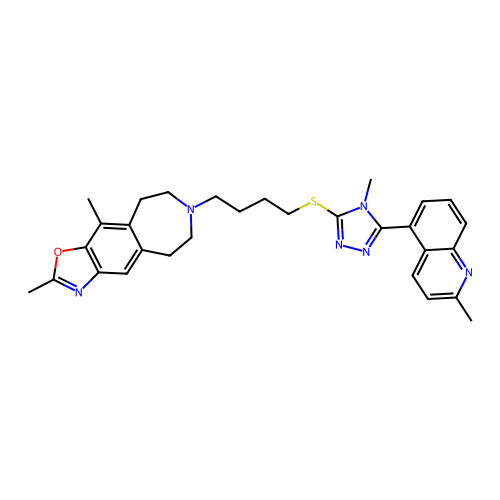

prediction: [0.07493325 0.92506677]
O[Si](CCCN1CCCCC1)(c1ccc(F)cc1)C1CCCCC1


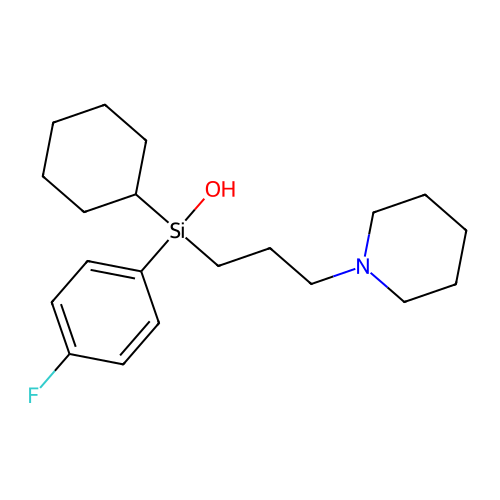

prediction: [0.07456896 0.92543095]
Nc1ccc(-c2ccccc2)cc1NC(=O)c1ccc(CNC(=O)OCc2cccnc2)cc1


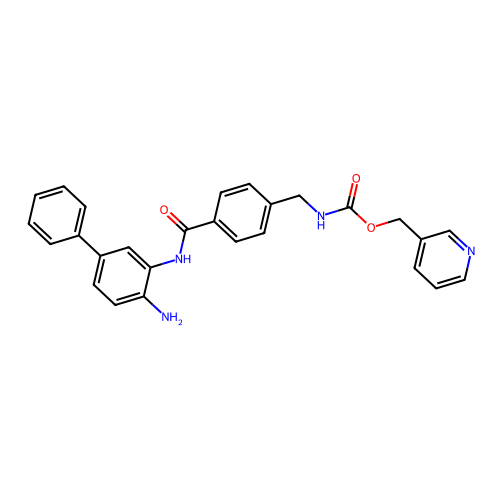

prediction: [0.07429635 0.92570364]
CN1CCC(=C2c3ccccc3CC(=O)c3sccc32)CC1


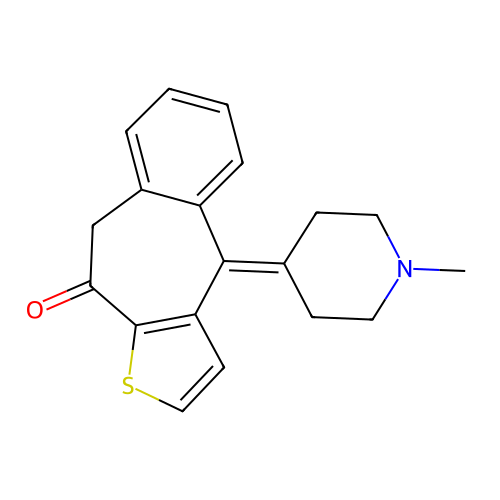

prediction: [0.0731421 0.9268579]
COCCS(=O)(=O)c1ccc(-c2ccc(CCN3CCC[C@H]3C)cc2)cc1


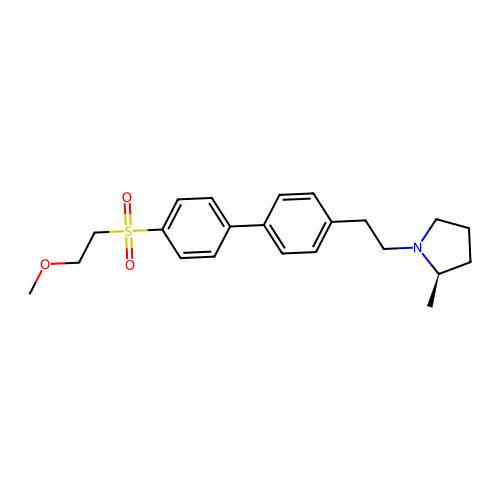

prediction: [0.07310061 0.9268994 ]
Cc1ccc2c(-c3nnc(SCCC(C)N4CCc5cc6c(cc5CC4)C(=O)N(C(C)C)C6)n3C)cccc2n1


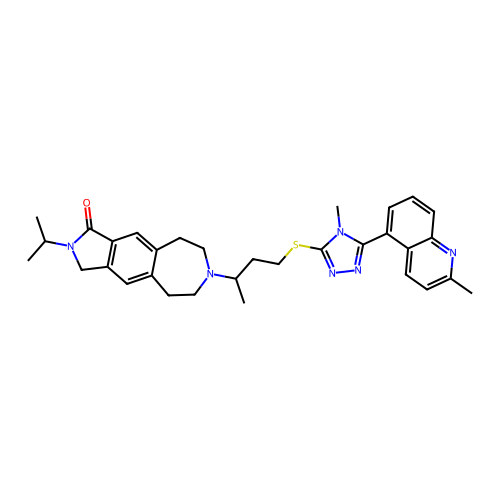

prediction: [0.0714634  0.92853665]
Cc1c(CN[C@H]2CC[C@@H](F)C2)nn(CCC#N)c1-c1cc(F)cc(F)c1


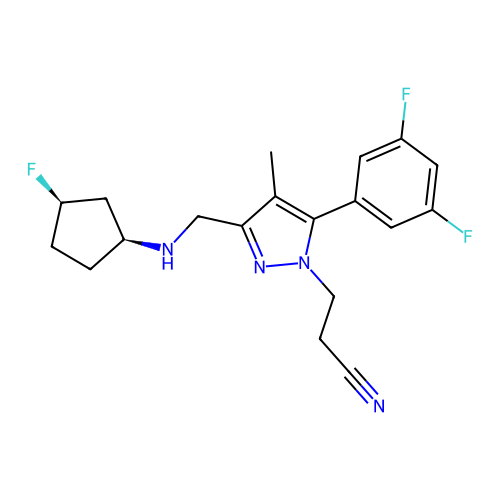

prediction: [0.0713028 0.9286972]
Nc1nc(N2CCNCC2)c2ccc(-c3ccco3)cc2n1


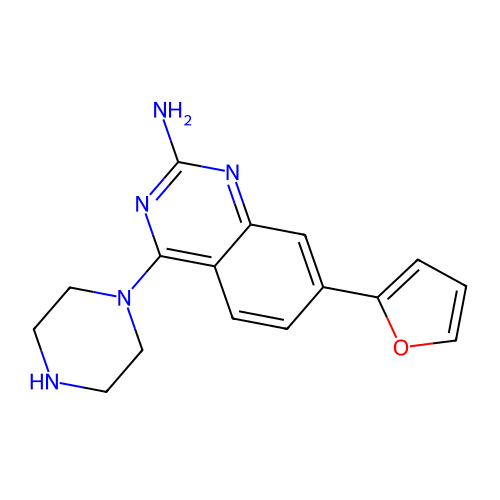

prediction: [0.07095093 0.9290491 ]
Cc1ccc(-c2cnc3nc(N4CCC(N5CCCCC5)CC4)sc3c2)cn1


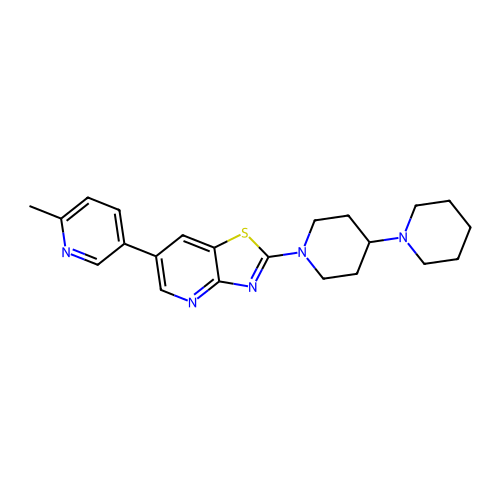

prediction: [0.07073361 0.92926645]
COc1cc(-c2cnc3nc(N4CCC(N5CCCCC5)CC4)sc3c2)ccn1


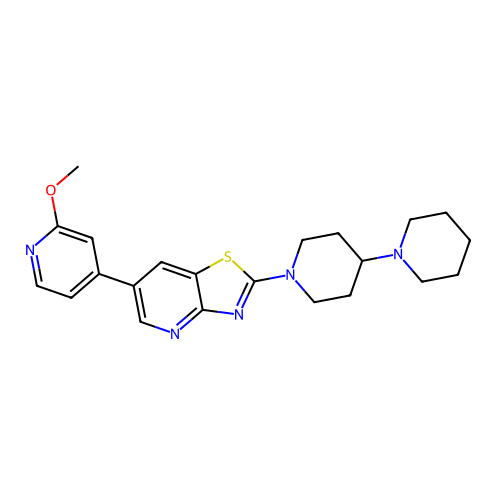

prediction: [0.06313383 0.93686616]
Cc1cc(OCCN2CCOCC2)nn1-c1ccc(Cl)cc1Cl


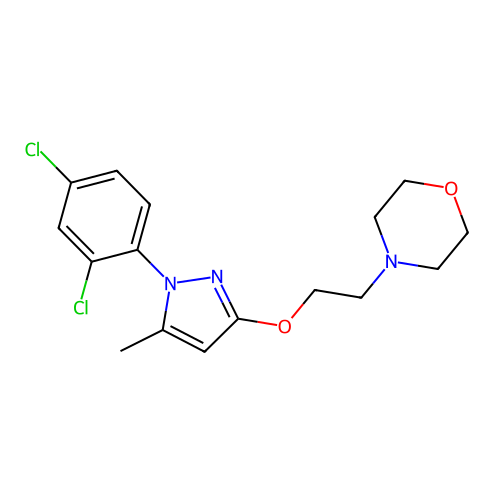

prediction: [0.06196935 0.9380306 ]
CC(C)(C)c1cc(C(=O)N2CCN(CCCCCC(c3ccc(F)cc3)c3ccc(F)cc3)CC2)cc(C(C)(C)C)c1O


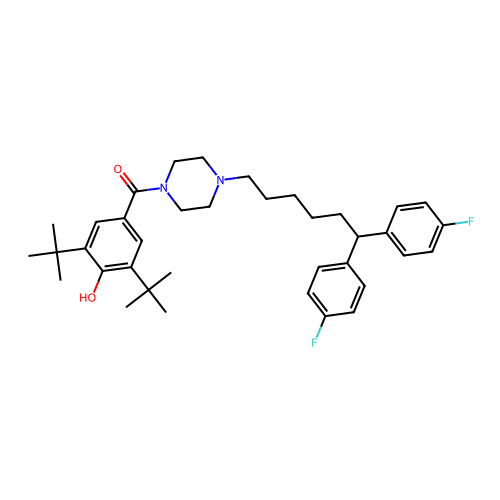

prediction: [0.05950116 0.9404988 ]
COc1ccc2c(=O)n(CCO)c(C#N)c(-c3cccc(F)c3)c2c1


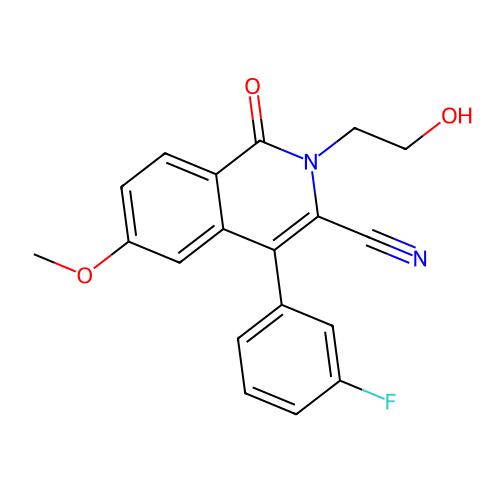

prediction: [0.05924329 0.9407567 ]
Clc1cnc(N2CCC([C@H]3C[C@H]3CCOc3ccc(-n4ccnn4)cc3)CC2)nc1


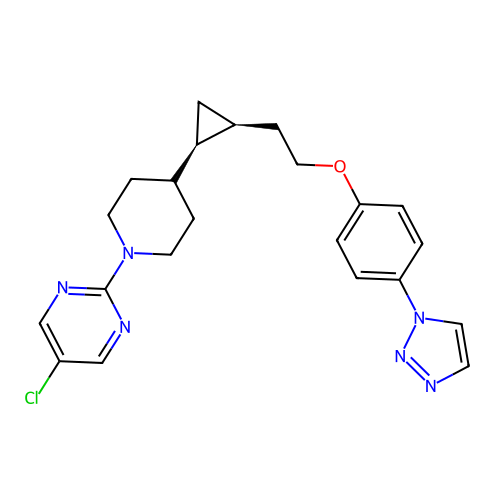

prediction: [0.05853987 0.9414601 ]
CN(C(=O)Cc1ccc(Cl)c(Cl)c1)C(CN1CCCC1)c1cccc(OCC(=O)O)c1


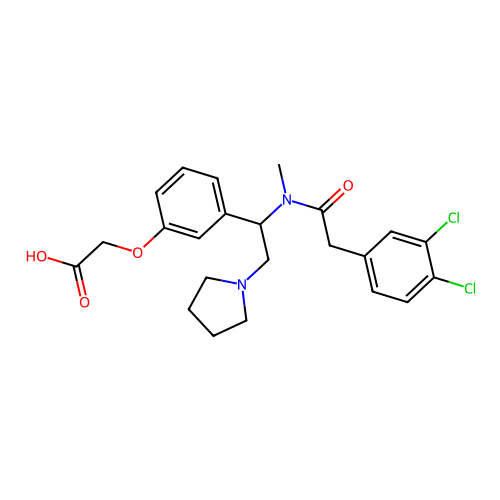

prediction: [0.05795646 0.9420436 ]
COc1cc(N2C(=O)N(c3ccc(-c4ccc(C(=O)O)s4)cc3)C(=O)C23CCN(Cc2ncccc2C)CC3)ncn1


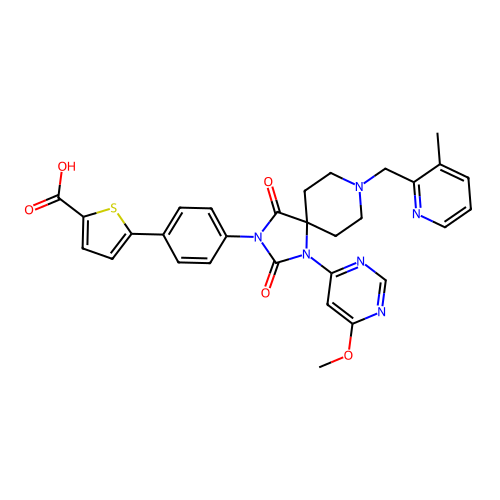

prediction: [0.05777478 0.9422253 ]
Fc1ccc(CN2CCN(C3=Nn4c(nnc4C(F)(F)F)CC3)CC2)cc1


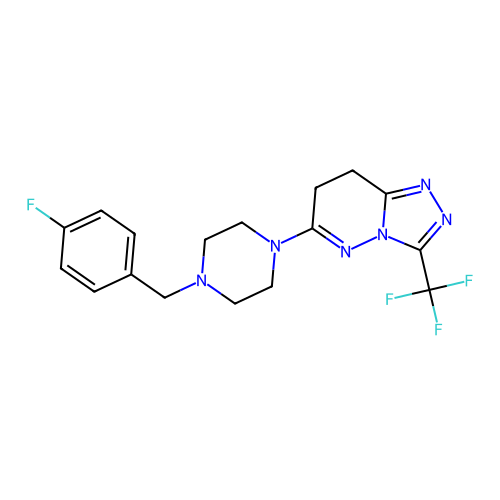

prediction: [0.05761299 0.942387  ]
O=c1nc(NC2CC3CCC(C2)N3Cc2ccc3c(c2)OCO3)c2cc(Cl)ccc2n1CC(F)(F)F


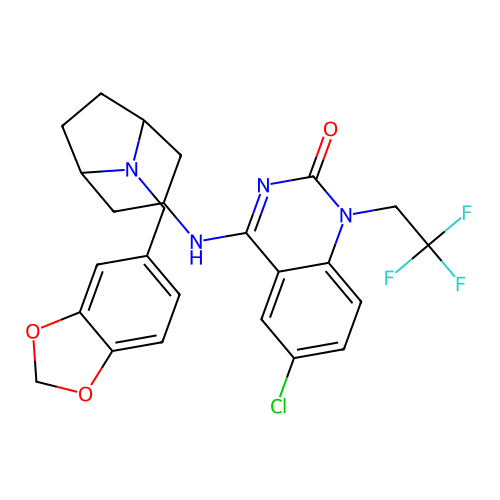

prediction: [0.055395 0.944605]
CC(C)=CCn1c(N2CCC[C@H](N)C2)c(C#N)c2c1c(=O)n(Cc1nc(C)c3ccccc3n1)c(=O)n2C


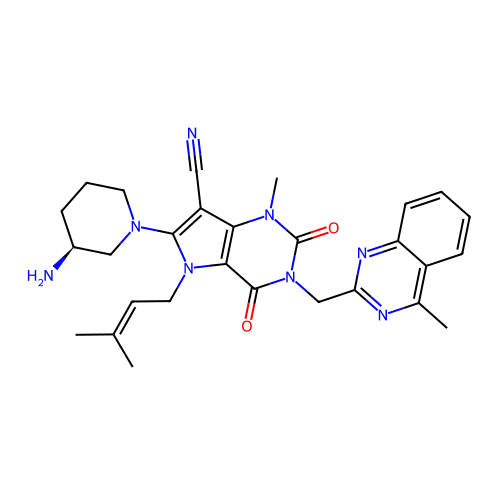

prediction: [0.05487837 0.9451216 ]
CN1Cc2cc(N3CCOCC3)ccc2[C@@H](c2ccc3sccc3c2)C1


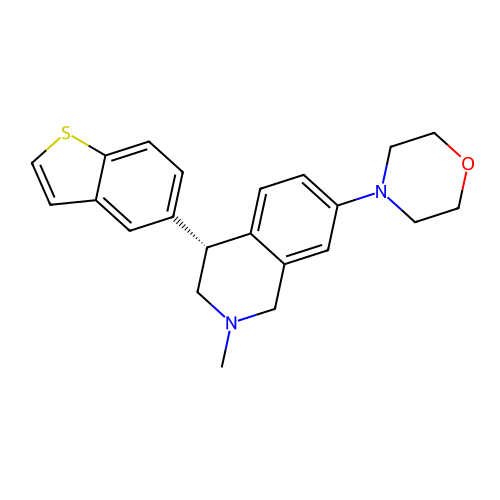

prediction: [0.05290272 0.94709724]
COc1ccccc1CC(c1cccc(F)c1)N1CCNCC1


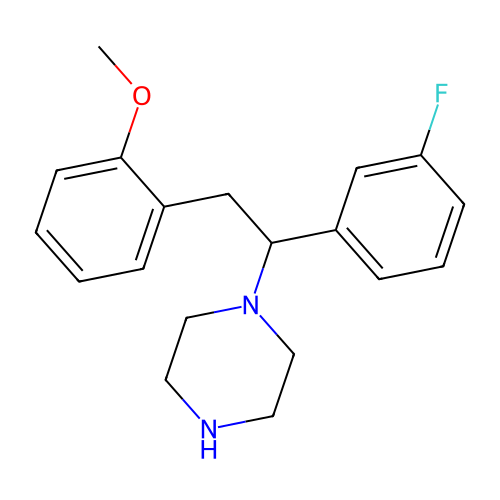

prediction: [0.04916047 0.9508396 ]
CCNc1cc(C(F)(F)F)cc(COCC2(c3ccc(F)cc3)CCN(C)CC2)n1


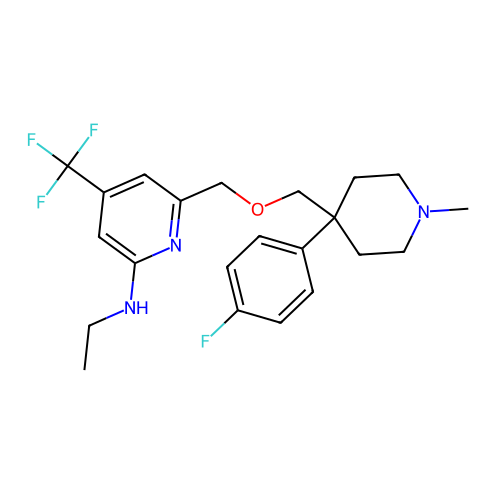

prediction: [0.04709351 0.9529064 ]
Cc1cc(C(C)(C)O)cc(Nc2cc(N[C@@H]3CCCC[C@@H]3N)cnc2C(N)=O)n1


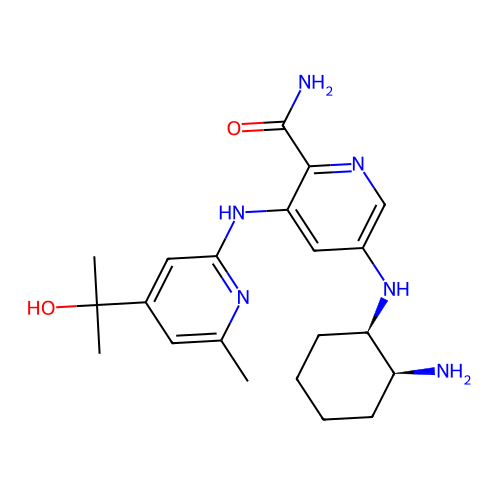

prediction: [0.04705835 0.95294166]
CC(=O)N1CCC(N(C)C(=O)N2CC(c3cc(F)ccc3F)=C[C@H]2c2ccccc2)CC1


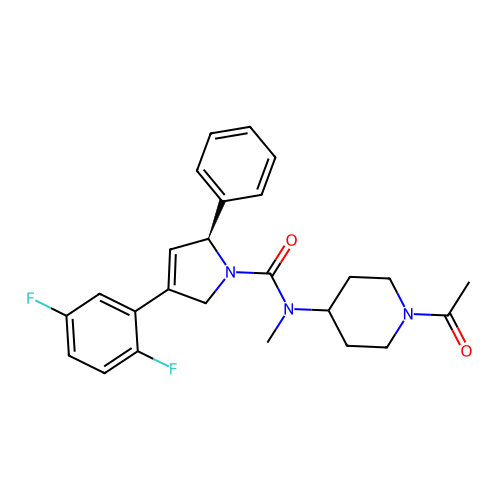

prediction: [0.04550589 0.9544941 ]
COc1ccc2nccc([C@@H]3CN(C4CCN(Cc5cc6ccccc6[nH]5)CC4)C(=O)O3)c2c1


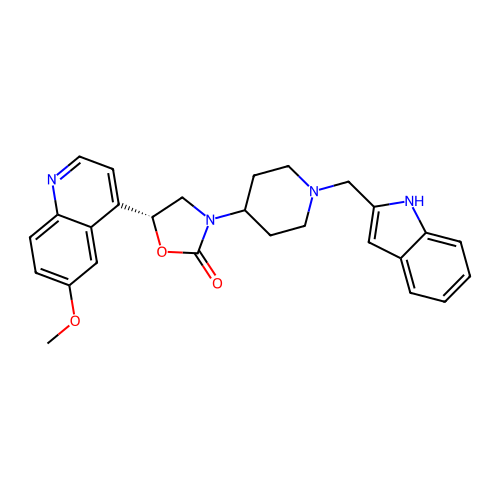

prediction: [0.04480166 0.95519835]
COc1cc2c(c(N3CCN(C)CC3)c1)O[C@@H](C(=O)Nc1ccc(N3CCOCC3)cc1)CC2


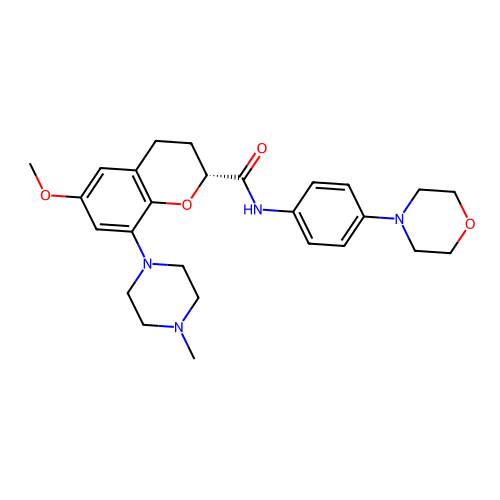

prediction: [0.04461877 0.9553812 ]
CCCOCCn1c(=O)c(NCCNCCO)nc2cnc(-c3ccc(OC)nc3)cc21


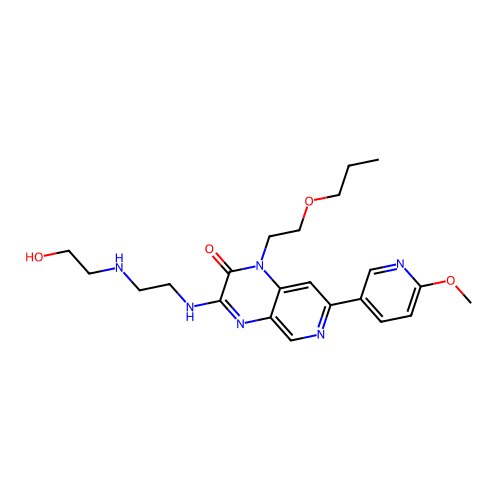

prediction: [0.04322909 0.95677096]
Cc1ccnc(CN2CCC(Oc3ncnc4c3ccn4Cc3ccccc3)CC2)c1


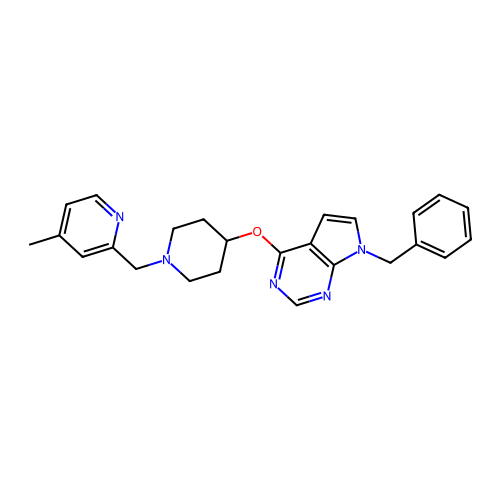

prediction: [0.04317357 0.9568264 ]
CC(C)(C)NC(=O)CN1CCC(CNC(=O)c2cc(Cl)cc(Cl)c2)CC1


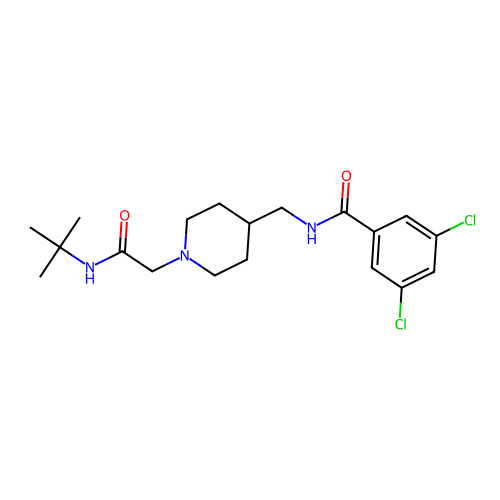

prediction: [0.04300708 0.956993  ]
CC(C)(c1cc(Br)c(O)c(Br)c1)c1cc(Br)c(O)c(Br)c1


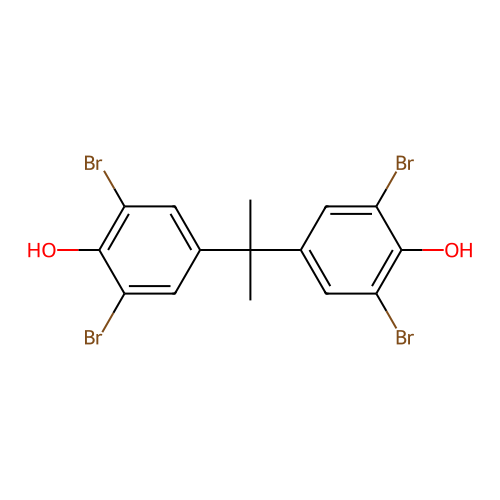

prediction: [0.04049298 0.959507  ]
Cc1nc(C)c(-c2ccc3cc(CCN4CCCC4C)ccc3n2)cc1C(N)=O


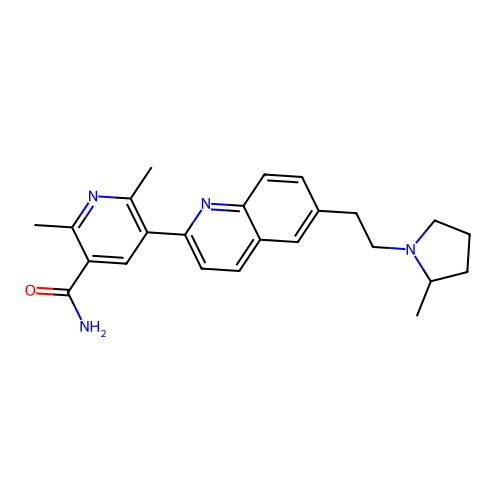

prediction: [0.04047448 0.9595255 ]
CC(C)(C)NC(=O)c1c[nH]c2ncc(-c3nn(CCC(O)CO)c4ccc(OC(F)F)cc34)nc12


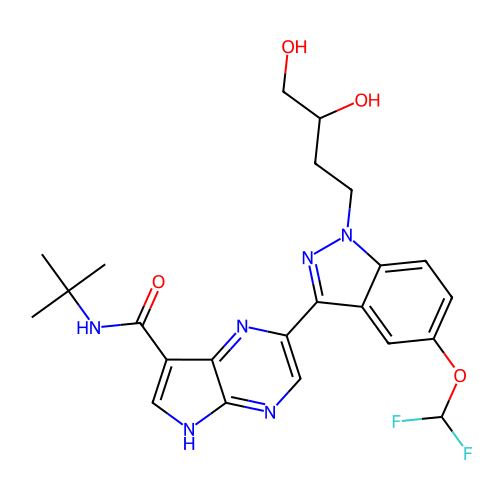

prediction: [0.04033438 0.9596656 ]
CCN1CCC(N(C(=O)NCc2ccc(F)cc2)c2ccc(Cl)cn2)CC1


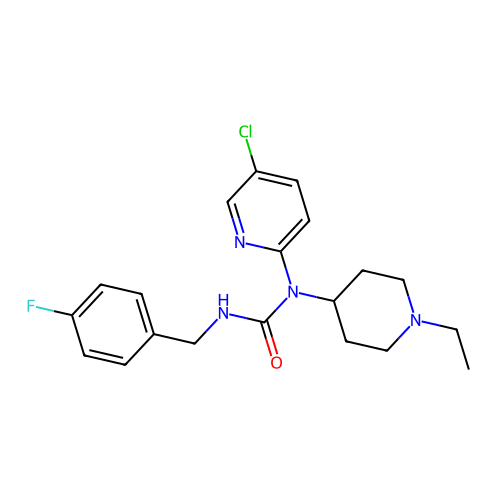

prediction: [0.04025288 0.9597471 ]
CCN=C(NS(=O)(=O)c1cccc(Cl)c1)N1CC2(C=N1)CCNCC2


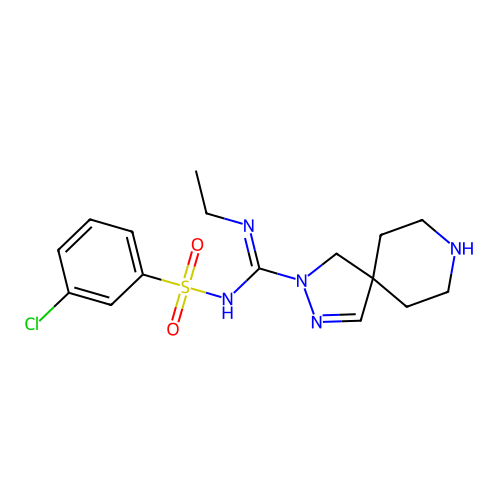

prediction: [0.04015244 0.95984757]
Cc1c2c(n3c1CCCN1CCOC[C@@H]1CNc1cc-3ccc1C(N)=O)CC(C)(C)CC2=O


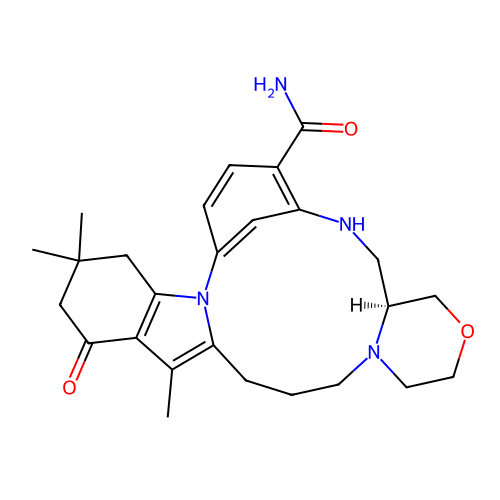

prediction: [0.03919965 0.9608004 ]
CCOC(=O)N1CCC(C)(CN2CCC3(CC2)CN(S(C)(=O)=O)c2ncccc23)CC1


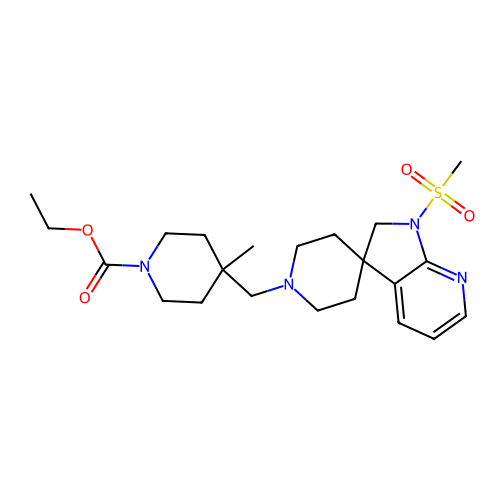

prediction: [0.0390283  0.96097165]
CCC(=O)C(CC(C)[NH+](C)C)(c1ccccc1)c1ccccc1


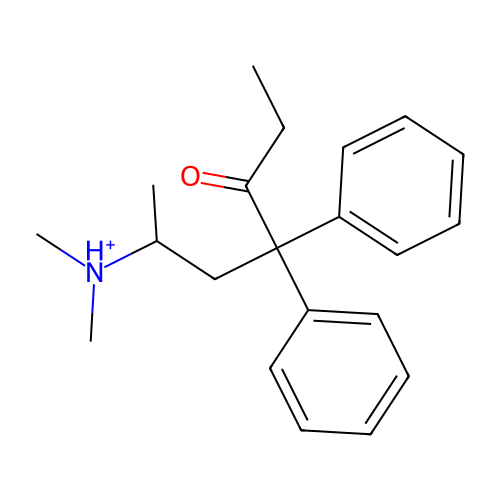

prediction: [0.03893858 0.9610614 ]
O=C1NCC(c2ccccc2)C12CCN(C1(c3ccccc3)CCOCC1)CC2


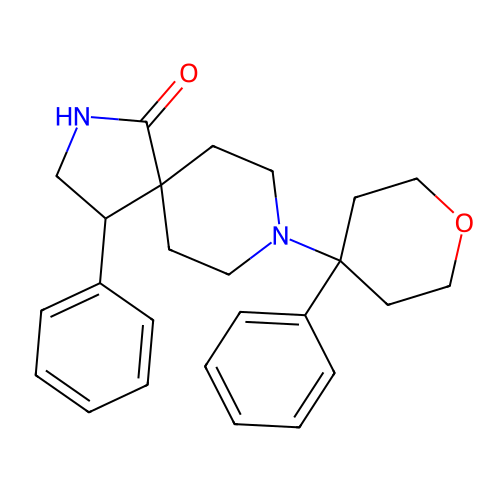

prediction: [0.03893858 0.9610614 ]
O=C1NCC(c2ccccc2)C12CCN(C1(c3ccccc3)CCOCC1)CC2


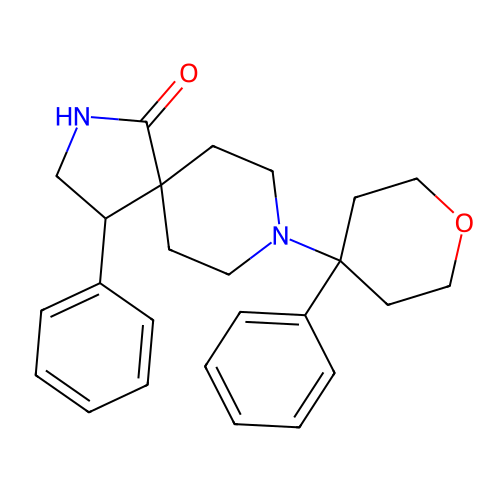

prediction: [0.03869328 0.96130663]
Cc1cc(Nc2ncc(Cl)c(Nc3ccccc3S(=O)(=O)C(C)C)n2)c(OC(C)C)cc1C1CCN(CCO)CC1


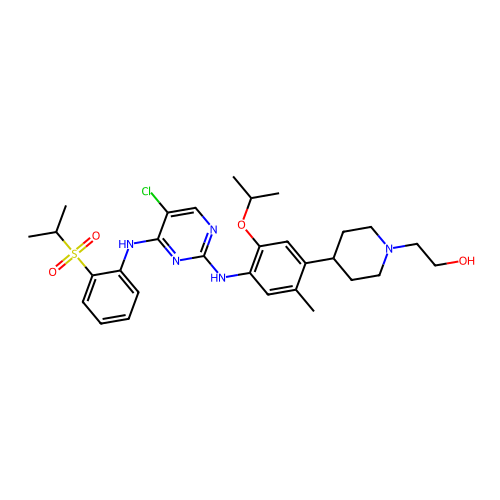

prediction: [0.03830073 0.96169925]
CN(C)Cc1ccc2c(c1)CC[C@H](N(C)C(=O)c1ccc(-c3ccc(F)cc3)cn1)C2


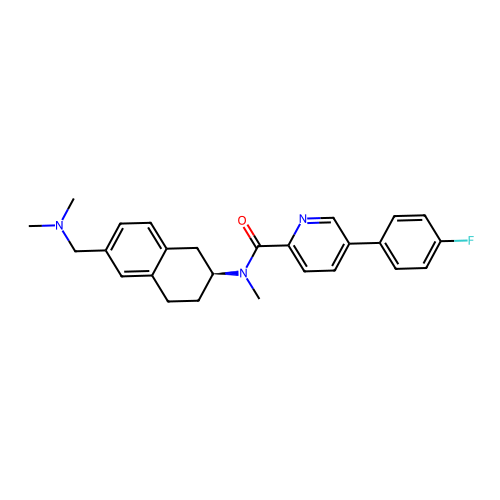

prediction: [0.03816285 0.9618372 ]
CC(C)(C)COc1ccc2c(c1)[C@]1(COC(N)=N1)c1cc(-c3ccncc3)ccc1O2


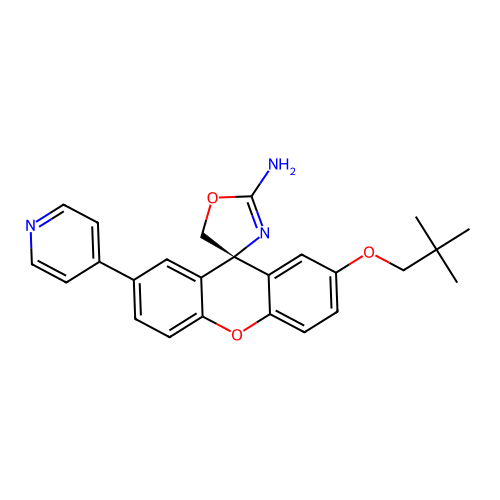

prediction: [0.03634567 0.96365434]
C[C@H](c1ccccc1)N1C(=O)O[C@](Cc2ccccc2)(c2nnc(C3(c4ccccc4)CC3)o2)C1=O


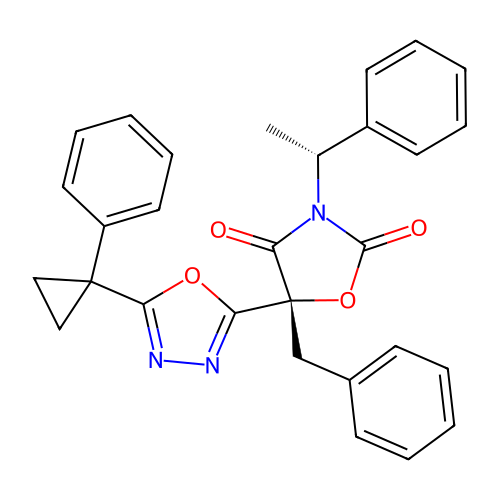

prediction: [0.03625881 0.96374124]
Cc1ccc2c(N3CCN(CCc4cccc5c4OCC(=O)N5C)CC3)cccc2n1


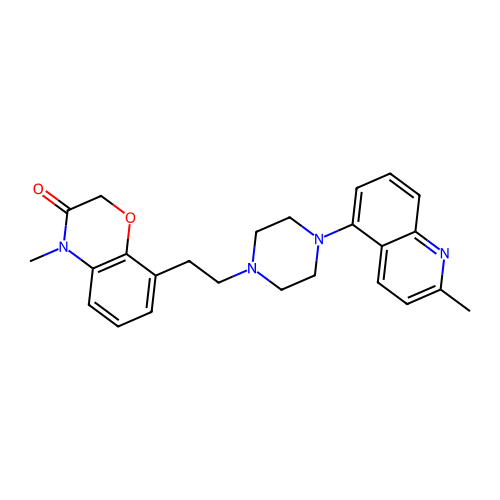

prediction: [0.03600218 0.96399784]
CNC(=O)c1ccc(Nc2nccc(-c3cnc(C)n3C(C)C)n2)cc1F


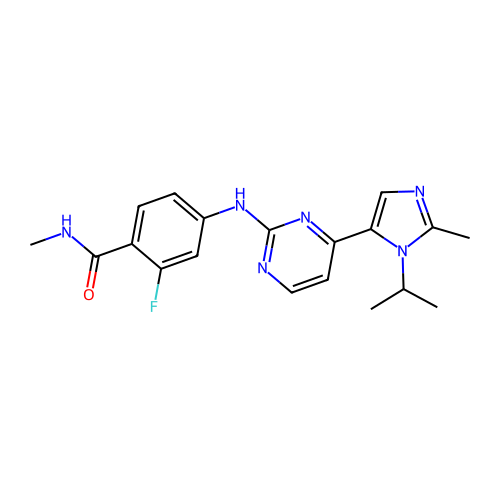

prediction: [0.03573625 0.9642638 ]
CC(C)(CN1CCC(=C2c3ccc(F)cc3COc3ccccc32)CC1)C(=O)O


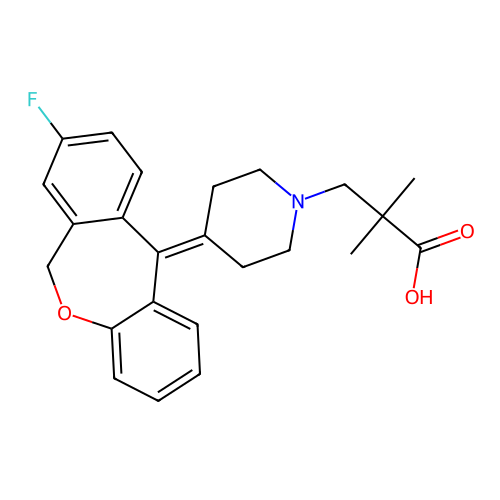

prediction: [0.03496351 0.9650365 ]
COc1cc(OC)cc(C(=O)NCC2(C#N)CCN(Cc3ccccc3C(F)(F)F)CC2)c1


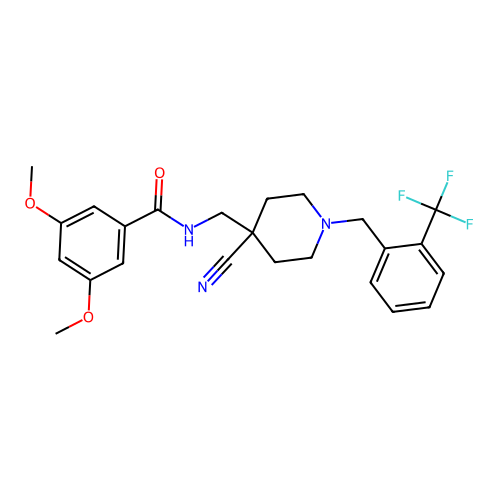

prediction: [0.0349509 0.9650491]
CCCCN(CC)CC#CC#Cc1ccc(Cl)cc1


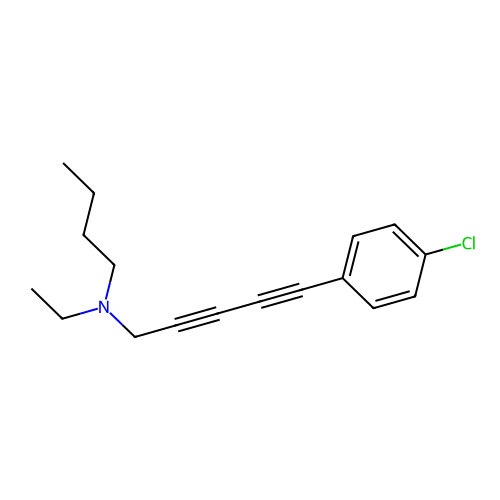

prediction: [0.03479103 0.96520895]
Cc1c(NC(=O)OC[C@@H]2COCCN2)cn2ncnc(Nc3ccc4c(cnn4Cc4cccc(F)c4)c3)c12


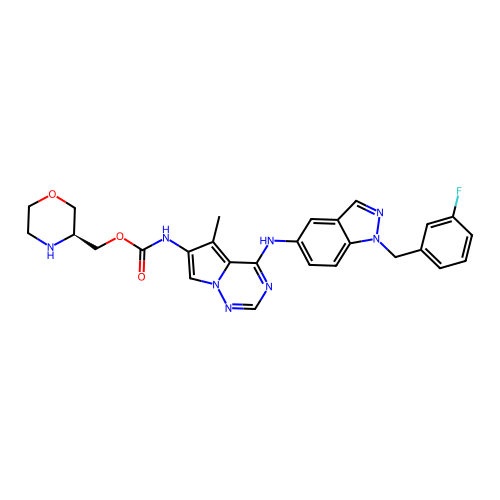

prediction: [0.03461613 0.96538395]
O=C(NCCc1ccccc1-c1ccc(CO)nc1)c1ccc(OCCC(F)(F)F)nc1


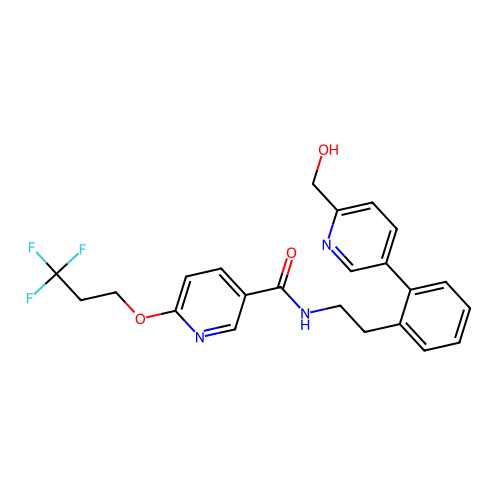

prediction: [0.03418688 0.96581304]
COc1ccc2c(c1)CCC1(CCN(CCc3ccc(F)cc3F)CC1)O2


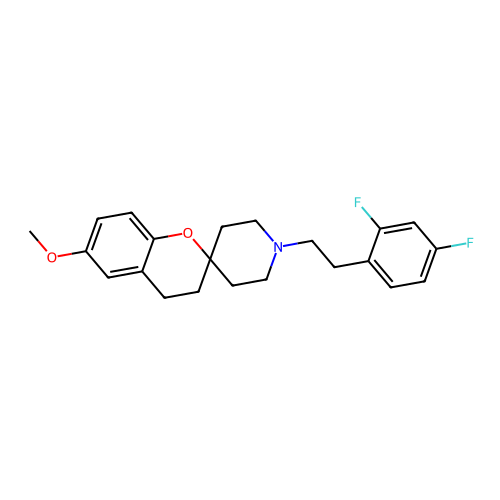

prediction: [0.0326275 0.9673725]
NC1COCC1Oc1ccc2ncc(F)c(CCC34CCC(NCc5ccc6c(n5)NC(=O)CO6)(CC3)CO4)c2n1


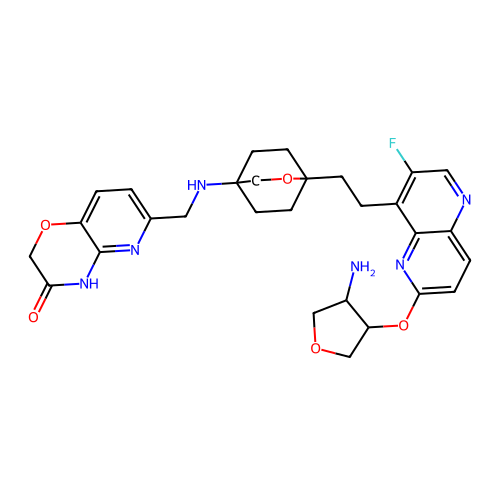

prediction: [0.03234944 0.96765053]
N#Cc1ccc2cc1Oc1ccc3c(c1)[C@@H](CCO3)N1CC[C@H](NCc3cncn3C2)C1=O


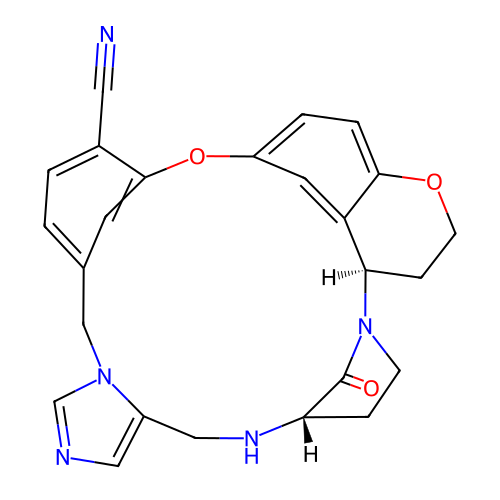

prediction: [0.0323298 0.9676702]
Cc1cc(SCCN2CCOCC2)nn1-c1ccc(Cl)c(Cl)c1


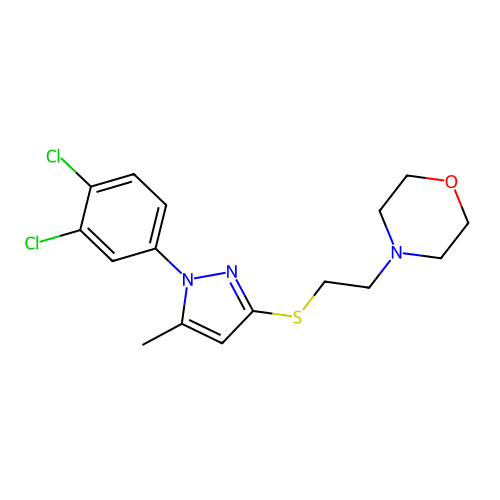

prediction: [0.03221458 0.9677854 ]
Cc1c([C@@H](O)CN2CCN(CC(O)c3cc(C4CC4)c(C#N)cn3)CC2)ccc2c1COC2=O


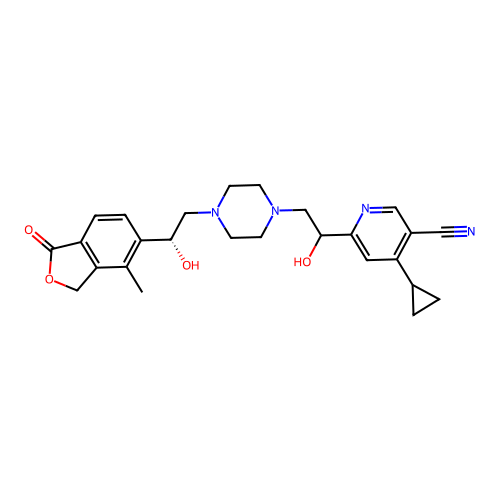

prediction: [0.03179428 0.96820575]
CN[C@@H]1CCN(c2nc(N)nc3c2oc2ncc(Cl)cc23)C1


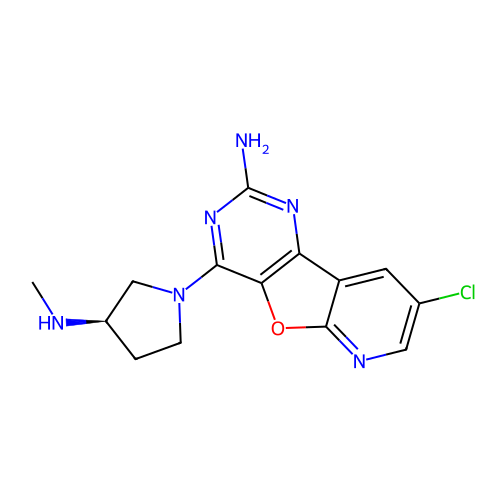

prediction: [0.03174315 0.9682568 ]
CSc1ccc(Oc2ccccc2CN(C)C)cc1


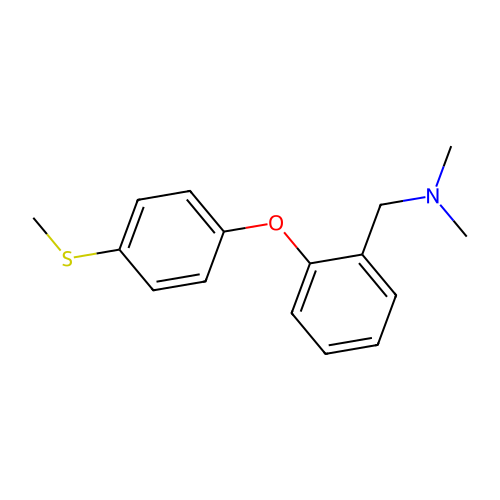

prediction: [0.03060813 0.9693918 ]
CC(C)=CCn1c(N2CCCNCC2)c(C#N)c2c1c(=O)n(Cc1ncc3ccccc3c1C#N)c(=O)n2C


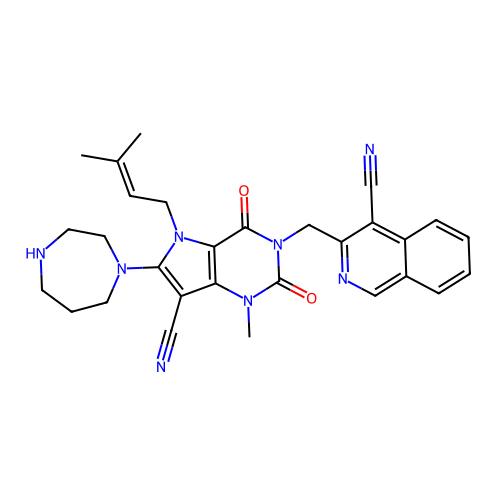

prediction: [0.03023497 0.969765  ]
CN1C[C@H](C(=O)Nc2ccc(Cl)cc2)[C@@H](c2ccc(/C=C/C(=O)Nc3ccccc3N)cc2)C1


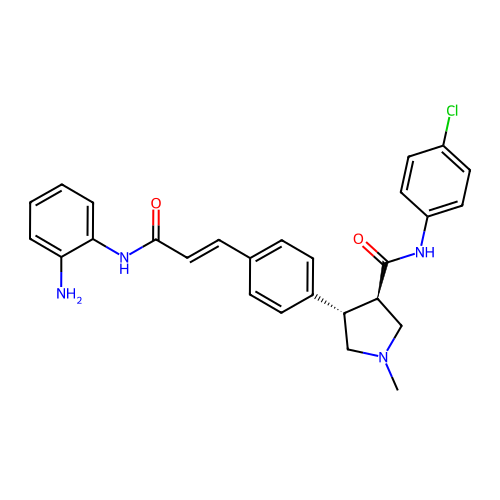

prediction: [0.02966044 0.9703396 ]
N#Cc1ccc2[nH]c(C3CCN(CCn4c(=O)ccc5ncc(Oc6cccnc6)cc54)CC3)nc2c1


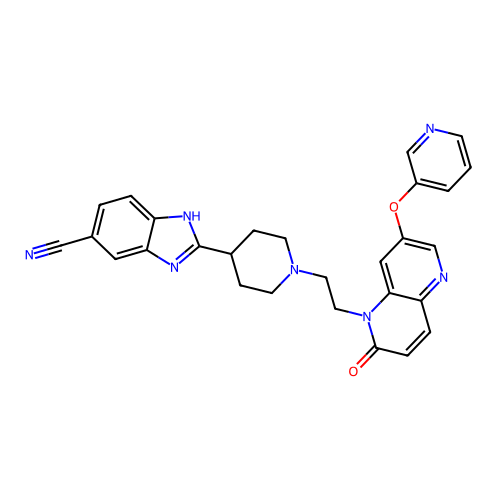

prediction: [0.02878227 0.97121775]
COc1cc(F)ccc1-c1cncc(NCc2ccccc2)c1


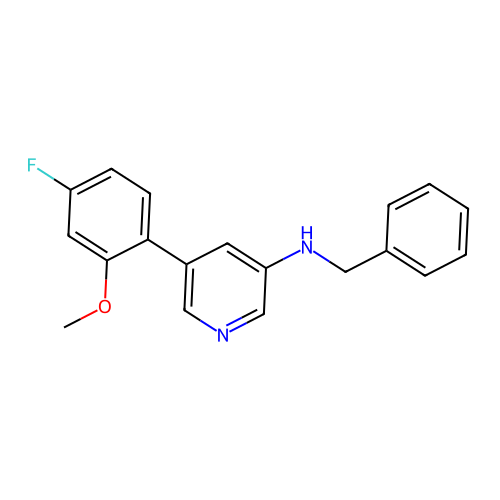

prediction: [0.02857468 0.9714253 ]
CC(=O)c1cn(-c2ccc(F)cc2)c2ccc(Cl)cc12


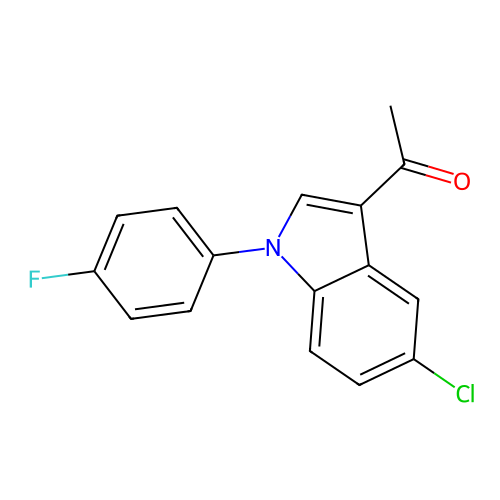

prediction: [0.02854239 0.97145754]
Cc1cc(Cl)ccc1OC1CCN(C[C@H](O)CNC(=O)c2c[nH]c(=O)cc2C(F)(F)F)CC1


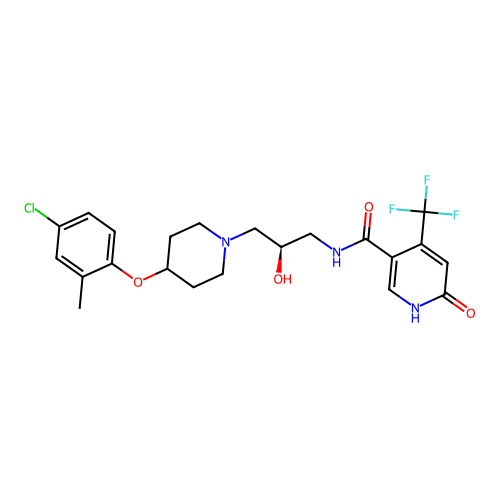

prediction: [0.0281864 0.9718137]
C[C@@H]1NC(c2ccc(=O)n(C(F)F)c2)=N[C@@]1(c1ccc(F)cc1)c1ccc(F)nc1


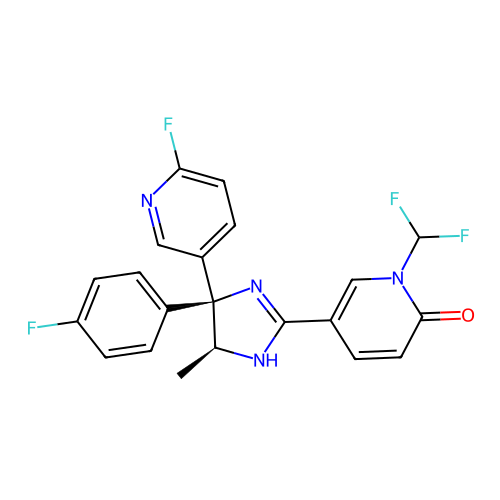

prediction: [0.02809323 0.9719068 ]
CC(=O)c1cccc(-c2cccc(-n3cc(C(=O)NC(C)C)c(=O)c4cccnc43)c2)c1


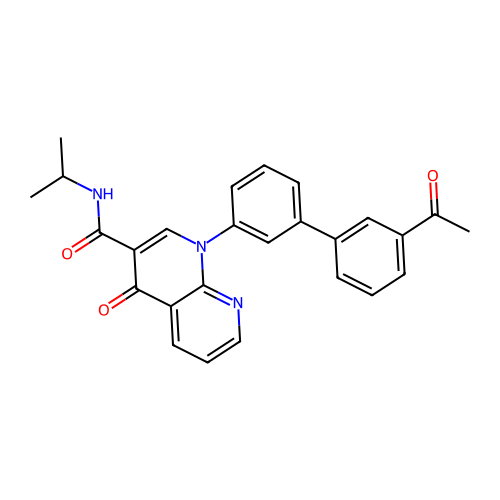

prediction: [0.02667861 0.9733213 ]
Cc1cccnc1C(=O)N1CCC(C)(N2CCC(N(c3ccccc3)c3cccnc3)CC2)CC1


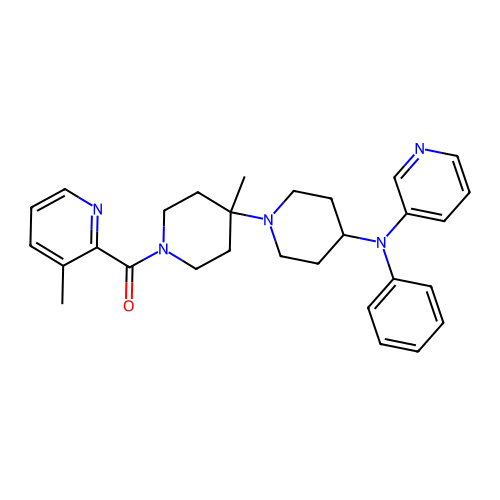

prediction: [0.02653391 0.97346604]
COc1ccc(-n2cc3nc(-c4ccccc4C)n(CC4CCCN(C(C)C)C4)c(=O)c3n2)cc1


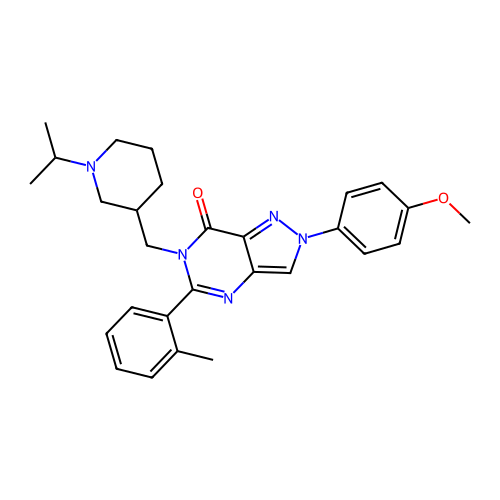

prediction: [0.02578227 0.9742177 ]
Cc1cccc2c1C(C(=O)NCc1ccc(OC(F)(F)F)cc1)N(CCc1ccccn1)C2=O


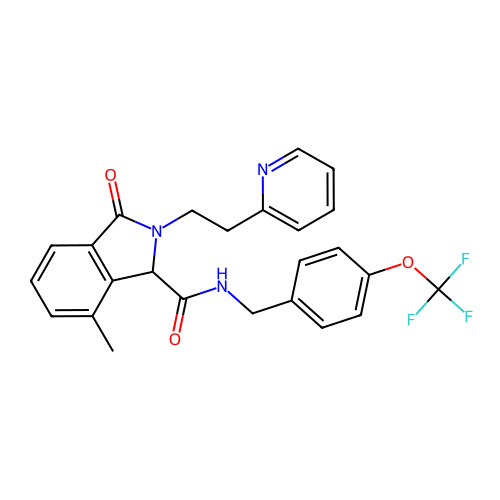

prediction: [0.02569914 0.9743009 ]
Cc1cc[n+]([O-])c(C)c1C(=O)N1CCC(C)(N2CCC(N(Cc3ccccc3)c3ccccc3)CC2)CC1


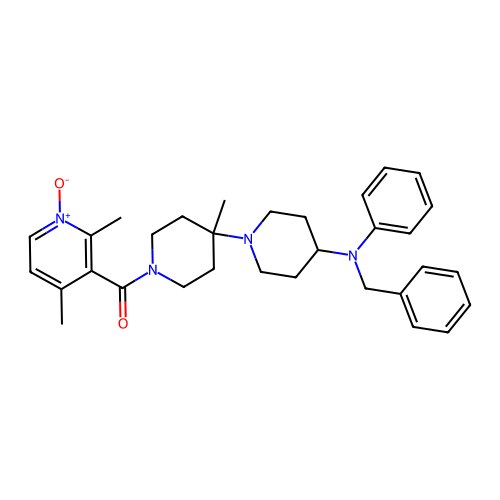

prediction: [0.02538901 0.9746109 ]
CCCCc1ccc(S(=O)(=O)Nc2ccc([C@]34CNC[C@H]3C4)cc2)cc1


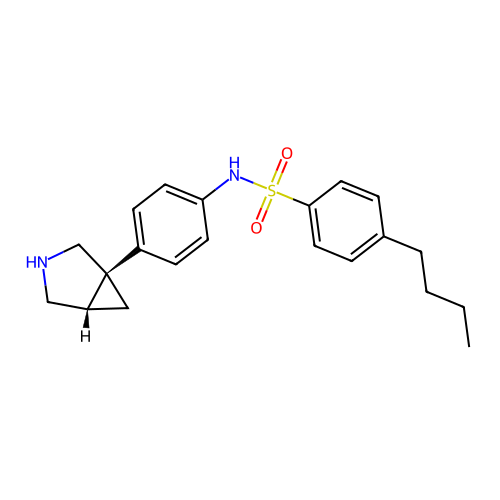

prediction: [0.02514902 0.97485095]
NC1=NC2(c3cc(-c4cncnc4)ccc3OCC23CC3)c2cccc(F)c21


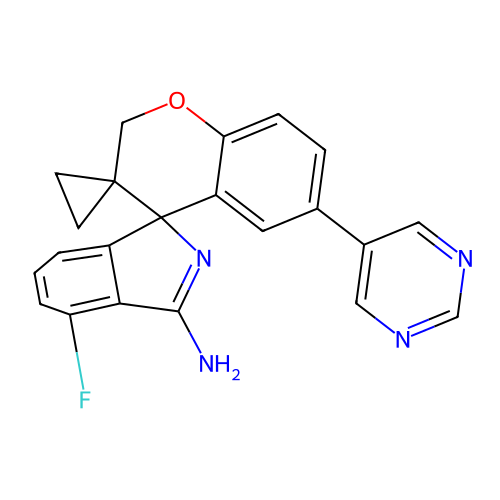

prediction: [0.02509482 0.9749052 ]
Fc1ccc(-n2cc(C3CC[NH+](CCN4CCNC4=S)CC3)c3cc(Cl)ccc32)cc1


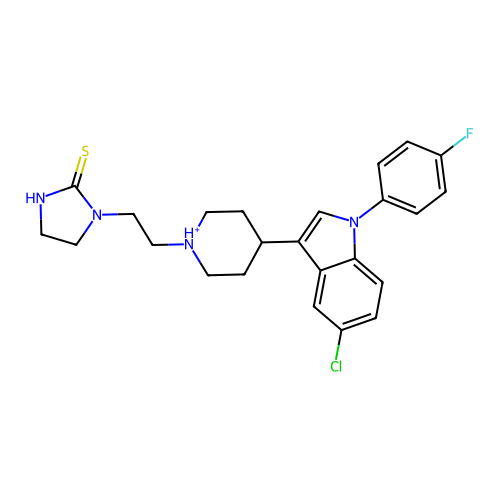

prediction: [0.02484894 0.975151  ]
CN1CCCC(c2nc3ccccc3n2CC2CCCO2)C1


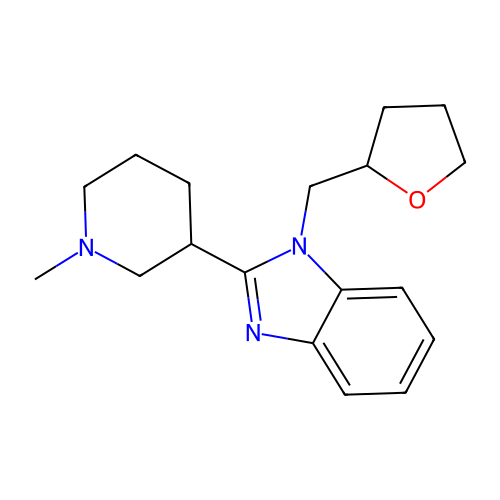

prediction: [0.02482177 0.97517824]
Cc1nc2cnc(Oc3cccc4cccnc34)cc2c(=O)n1C[C@H]1CCCN(C(C)C)C1


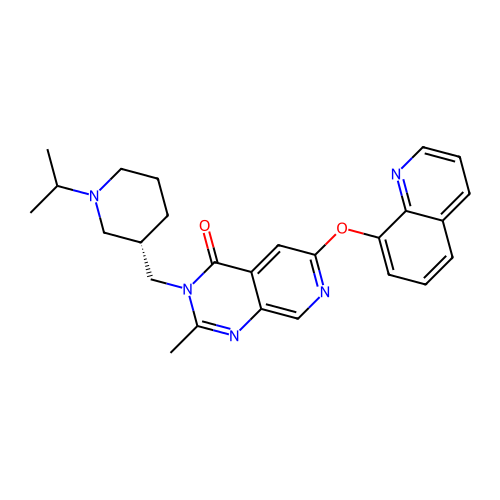

prediction: [0.02469089 0.9753091 ]
O=C(NC(c1ccccc1)c1ccccc1)[C@@H]1CC[C@@H](N2CCOCC2)C[C@H]1c1ccccc1


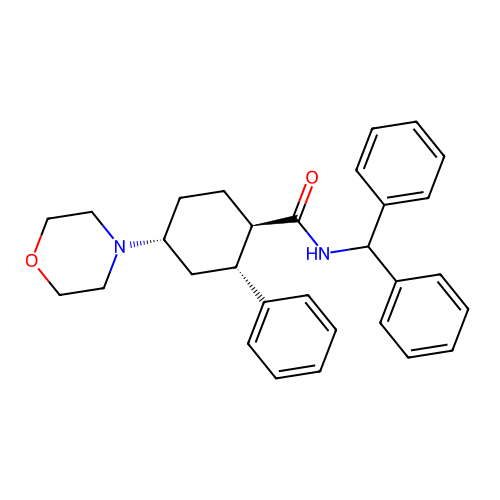

prediction: [0.02458507 0.9754149 ]
CC(N)Cc1c[nH]c2ccc(OCc3cccs3)cc12


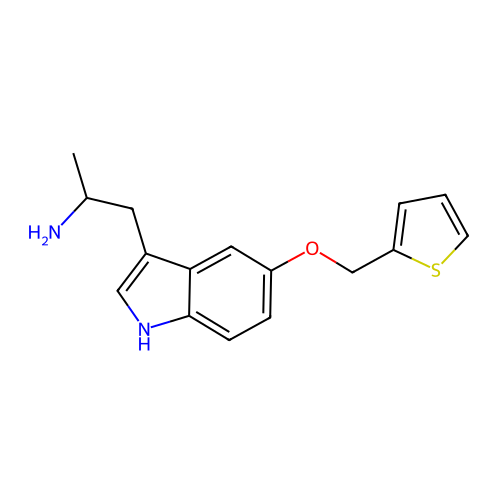

prediction: [0.02438074 0.9756193 ]
O=C1CCc2ccccc2N1OCCN1CCC(n2c(=O)[nH]c3ccccc32)CC1


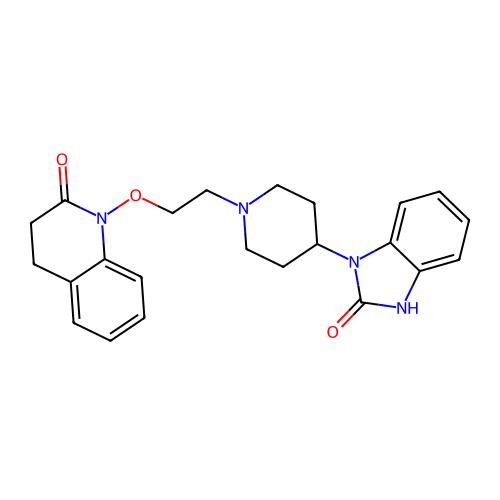

prediction: [0.02426553 0.9757345 ]
O=C1COc2ccc(CNC34CCC(CCc5c(F)cnc6ccc(OC(F)F)nc56)(CC3)OC4)nc2N1


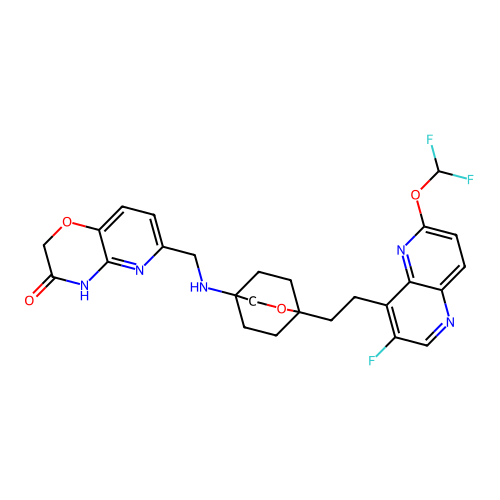

prediction: [0.02348255 0.97651744]
CCOC(=O)NCCc1ccccc1-c1ccc([C@H]2CNCC[C@@H]2c2ccn(C)c(=O)c2)c(Cl)c1


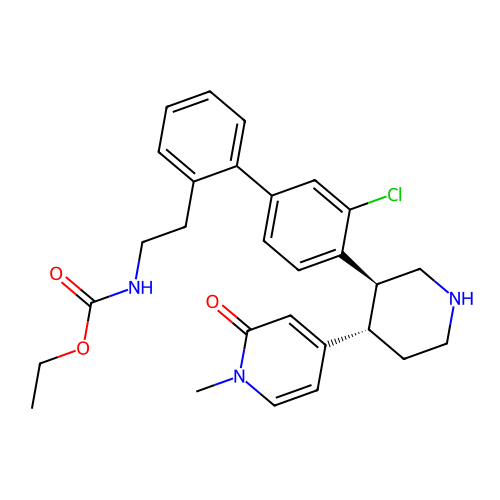

prediction: [0.02347798 0.97652197]
CN1CCc2cccc3c2C1Cc1ccc(O)c(O)c1-3


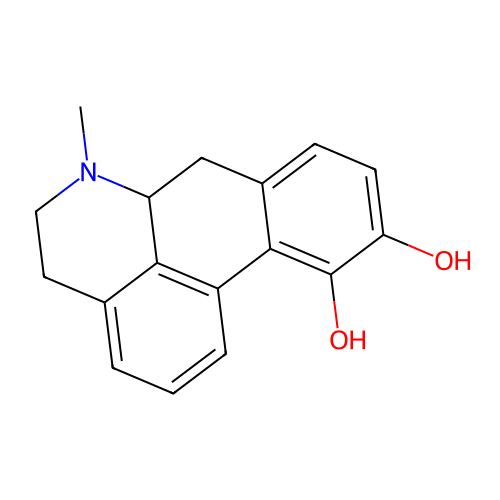

prediction: [0.02329632 0.97670364]
CC(C)Oc1ncc(-c2nc(-c3ccc4c(c3)CCNCC4)no2)cc1C#N


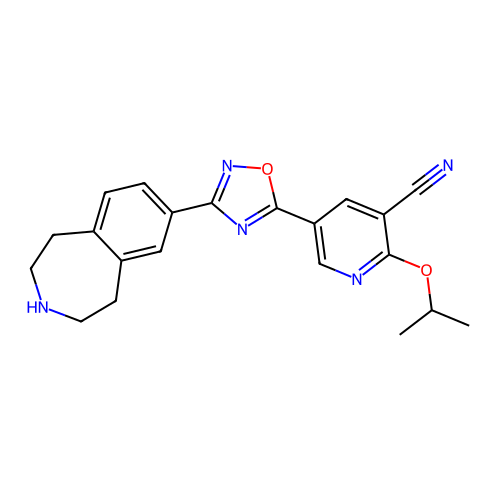

prediction: [0.02319795 0.97680205]
O=C(NC1CCN(Cc2ccc3c(c2)OCO3)CC1)c1cc(=O)c2ccccc2o1


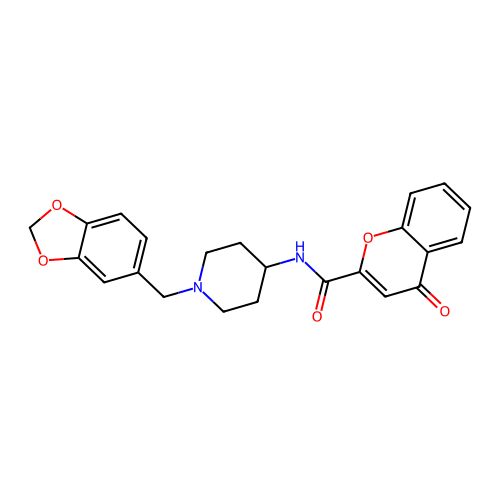

prediction: [0.023014 0.976986]
Cc1ccnc(C)c1C(=O)N1CCC(C)(N2CCC(N(c3ccccc3)c3cccnc3)CC2)CC1


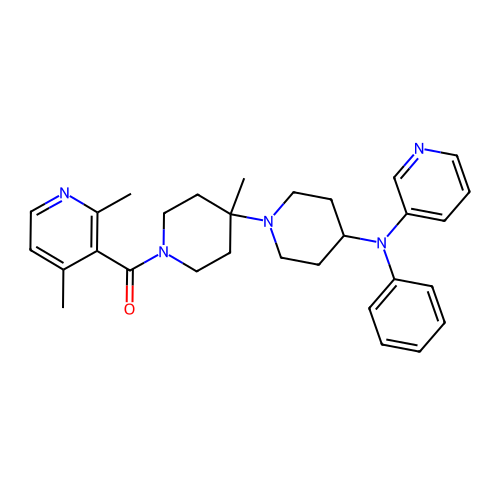

prediction: [0.02297932 0.97702074]
CN(C(=O)c1ccc(-c2ccc(C(F)(F)F)cc2)cc1)[C@H]1CCN(C(=O)N(C)[C@@H]2CCN(CCCc3ccc(Cl)cc3)C2)C1


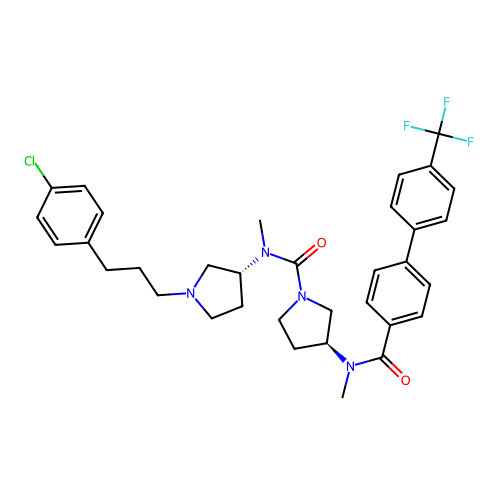

prediction: [0.02295317 0.9770468 ]
[2H]C([2H])(O)CN1CCN(c2cnc3cc(C(F)(F)F)cc(NCc4cccc([N+](=O)[O-])c4)c3c2)CC1


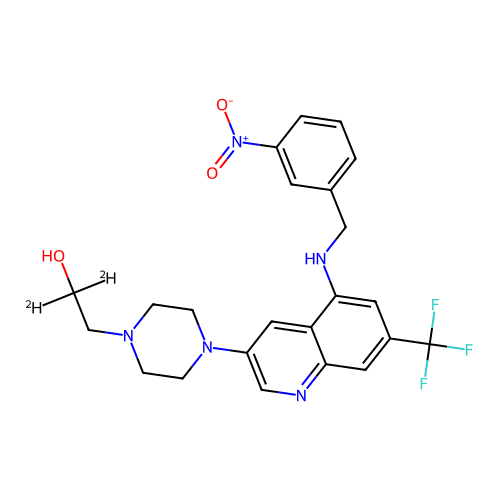

prediction: [0.02283946 0.9771606 ]
COc1cc(-c2cn(CC(=O)N(Cc3ccccc3)CC(F)(F)F)nn2)ccc1-n1cnc(C)c1


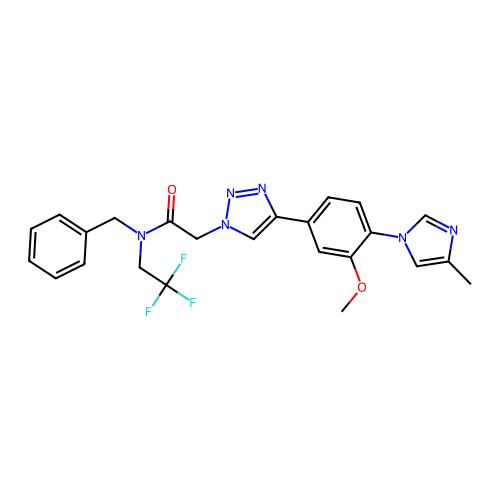

prediction: [0.02227693 0.9777231 ]
CC1(c2cccc(-c3cncnc3)c2)N=C(N)c2ccccc2O1


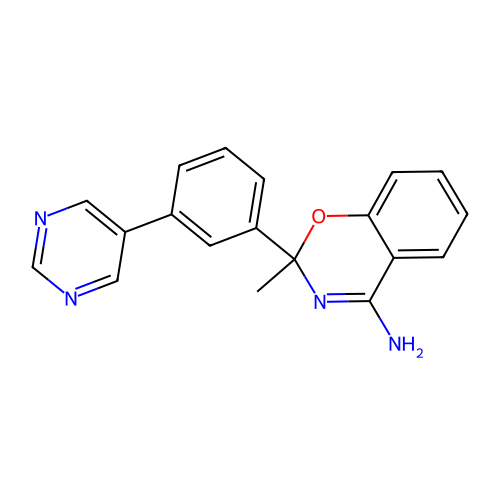

prediction: [0.02222628 0.97777367]
CNCc1ccccc1Oc1ccc(Cl)cc1F


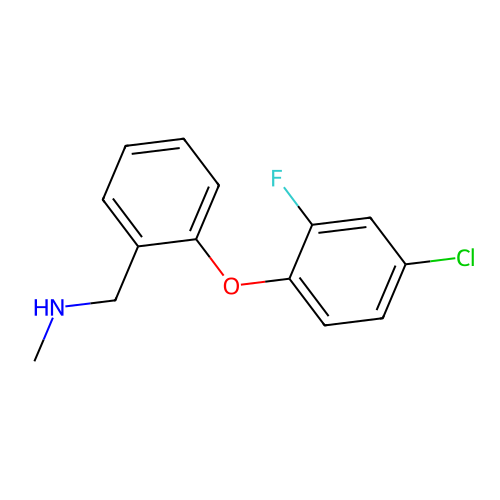

prediction: [0.02220533 0.97779465]
CNc1cc(Nc2cnc(C#N)c(O[C@H](C)CN(C)C)n2)ncc1Cl


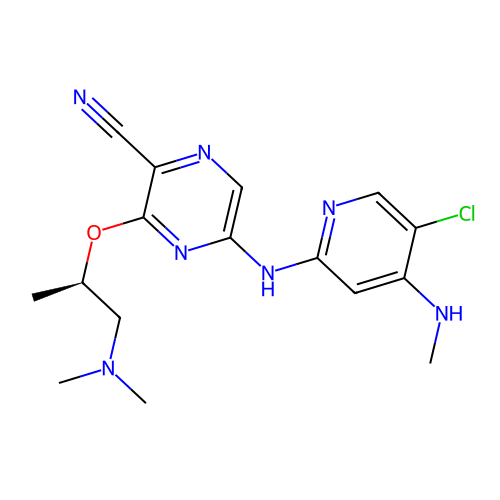

prediction: [0.02174631 0.9782537 ]
CS(=O)(=O)N1CCC2(CCN(c3ccc(C(=O)Nc4cc(-c5cccs5)ccc4N)cn3)CC2)C1


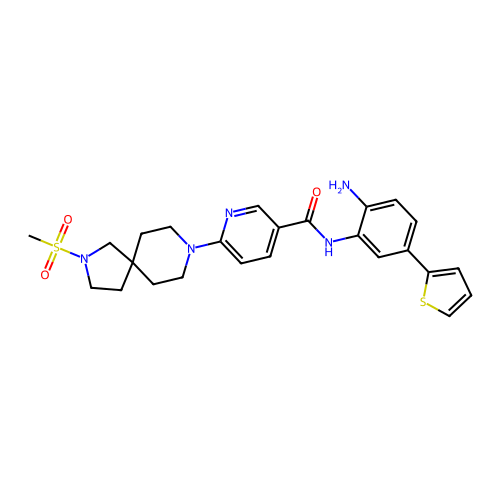

prediction: [0.02164206 0.9783579 ]
COc1ccc(CN[C@@H]2CC[C@@H](C(=O)N3CCC(C(=O)N4CCCC4)(c4ccccc4)CC3)C(C)(C)C2)cc1


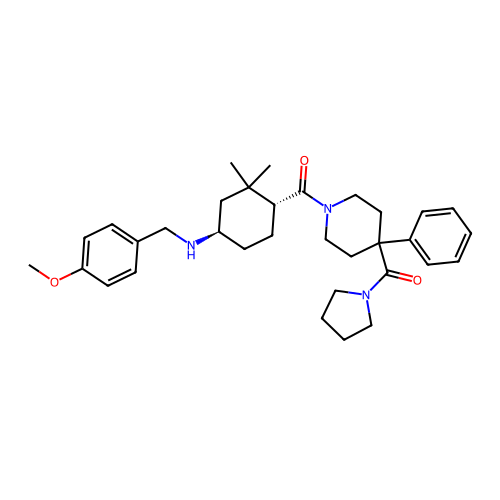

prediction: [0.02143169 0.9785684 ]
COC[C@H]1CCCN1CCn1ncc2cc(-n3ccc(OCc4ccccc4)cc3=O)ccc21


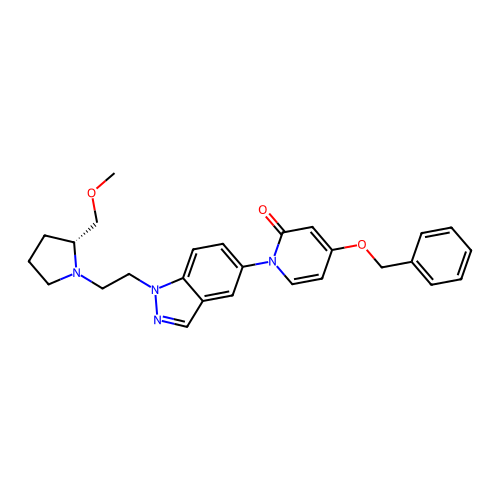

prediction: [0.02131301 0.978687  ]
CC(C)(C)c1[nH]c2ccccc2c1CCNCc1ccc(/C=C/C(=O)NO)cc1


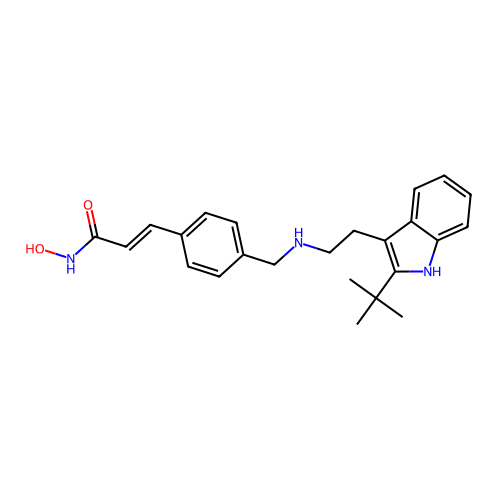

prediction: [0.02130055 0.97869945]
CCN(C(=O)Cc1ccc(S(C)(=O)=O)cc1)C1CCN(CC[C@@H](c2ccccc2)N2CCN(S(=O)(=O)C(F)(F)F)CC2)CC1


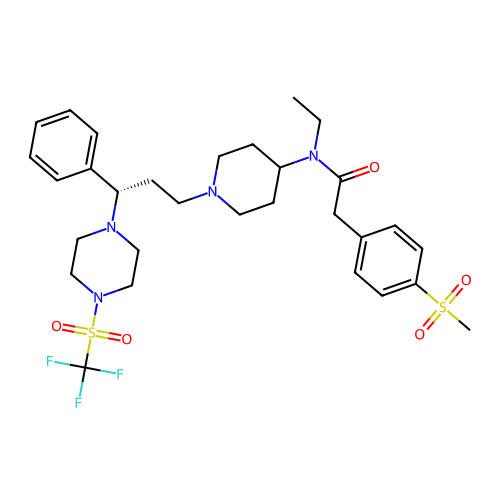

prediction: [0.02119296 0.97880703]
O=S(=O)(c1ccccc1)c1ccc(/C=C/c2ccc(F)cc2F)nc1


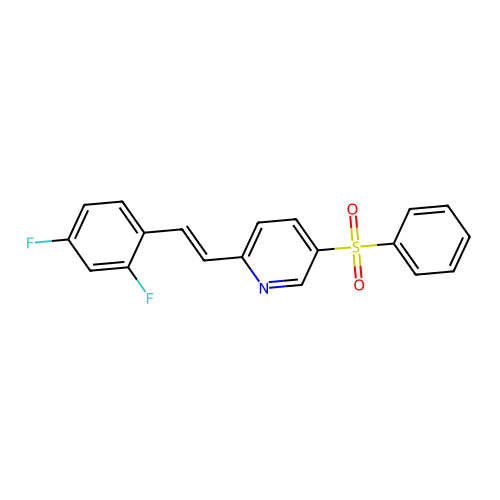

prediction: [0.02119104 0.97880894]
COc1cccc(-n2cc3nc(CC(C)C)n(C[C@H]4CCCN(C[C@H]5CCCO5)C4)c(=O)c3n2)c1


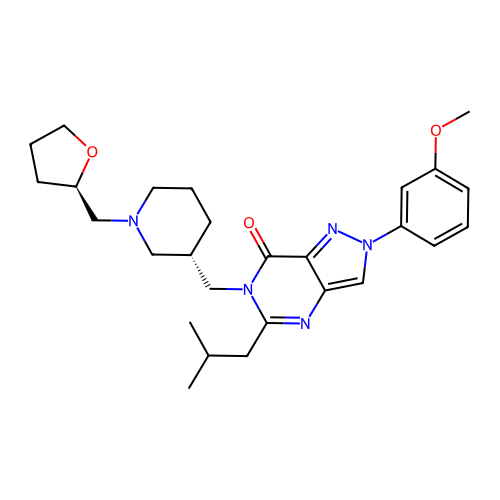

prediction: [0.02097606 0.97902393]
O=C(Nc1cccc(N2CCN(CCCCNS(=O)(=O)CC3CCCCC3)CC2)c1)C1CC1


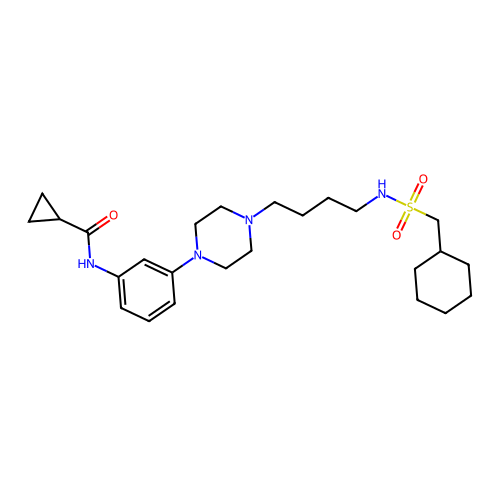

prediction: [0.02090094 0.97909904]
COc1ccc(C(=O)N(c2cc(C)ccn2)C2CCN(c3cc(N)ccn3)CC2)cc1


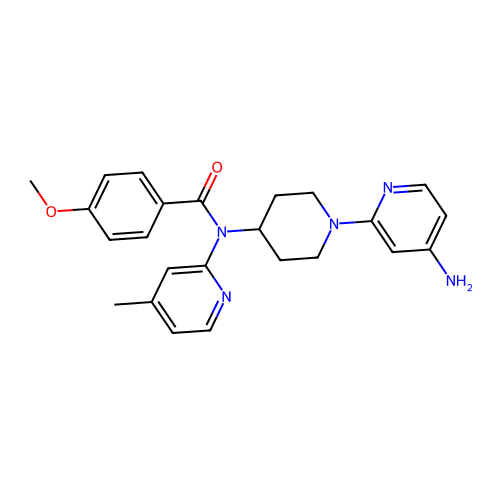

prediction: [0.02076725 0.9792327 ]
O=C1O[C@]2(CC[C@H](c3nc4cc(OC(F)(F)F)ccc4[nH]3)CC2)CN1c1ccccn1


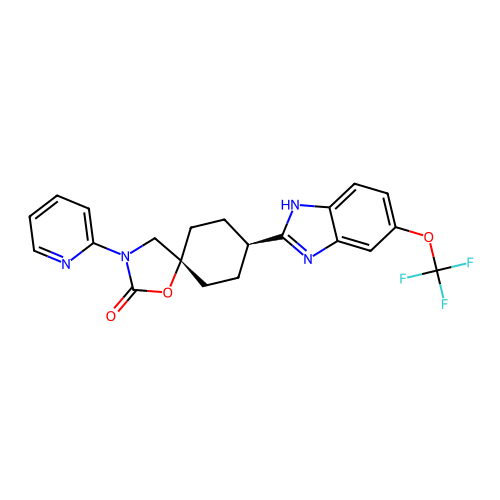

prediction: [0.02056566 0.9794343 ]
Nc1ccc(-c2ccc(F)cc2)cc1NC(=O)c1ccc(N2CCC3(CC2)CNC(=O)O3)nc1


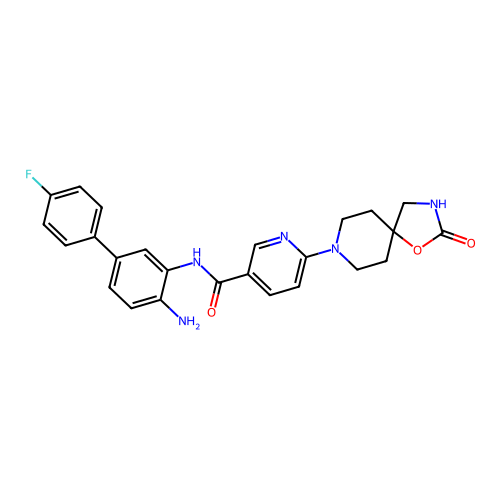

prediction: [0.02003566 0.9799643 ]
O=C1COc2ccccc2N1CCCN1CCC(n2c(=O)[nH]c3ccc(F)cc32)CC1


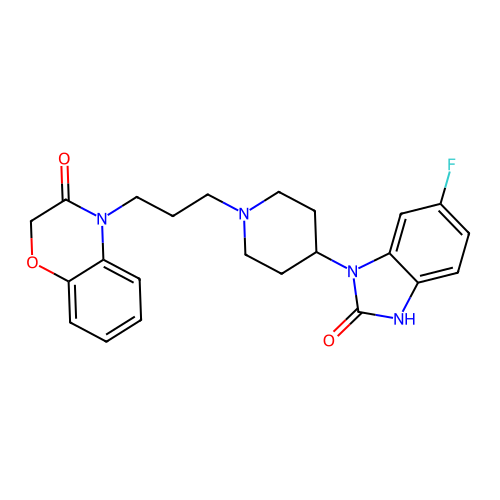

prediction: [0.02002768 0.9799723 ]
N#Cc1ccc2[nH]c([C@H]3CC[C@]4(CC3)CN(c3ccccn3)C(=O)O4)nc2c1


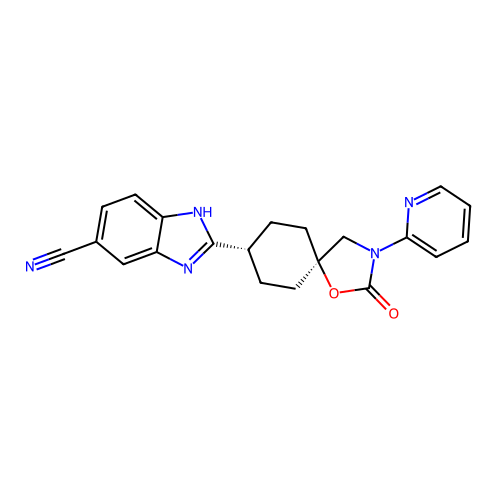

prediction: [0.01997028 0.98002976]
CN(C)Cc1ccccc1Oc1ccc(Cl)cc1Cl


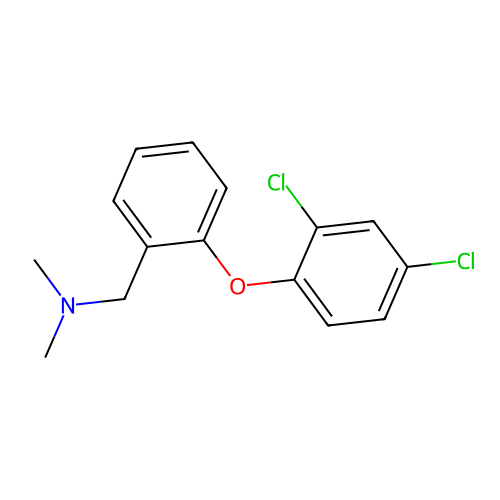

prediction: [0.01982626 0.9801737 ]
OCCN1CCN(c2ccc3nc(-c4ccccc4)c(-c4ccc(CN5CCC(c6nnc(-c7ncccn7)[nH]6)CC5)cc4)nc3n2)CC1


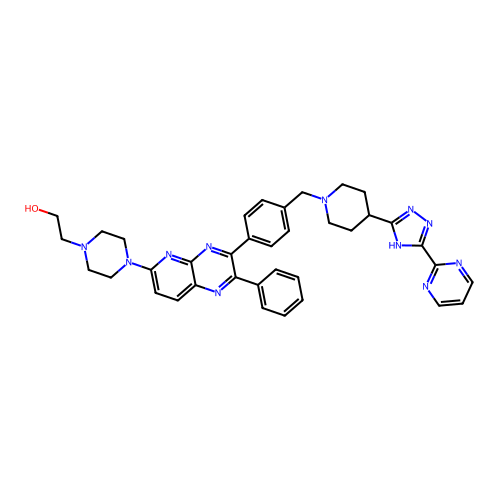

prediction: [0.01978979 0.98021024]
NC1=N[C@@]2(CO1)c1cc(-c3cccnc3F)ccc1Oc1cnc(C3CCOCC3)cc12


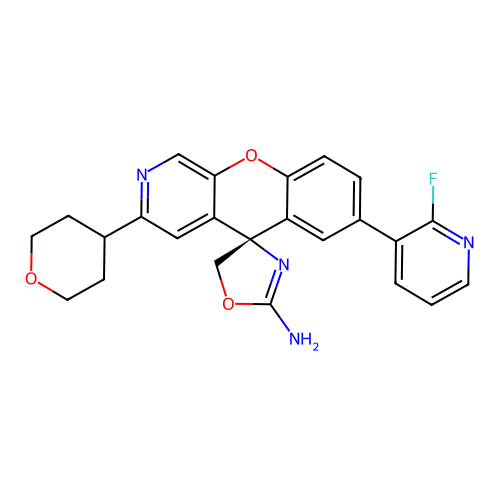

prediction: [0.0197754  0.98022455]
Cc1ccc2c(-c3nnc(SCCCCN4CCc5cc6c(cc5CC4)C(=O)N(C)C6)n3C)cccc2n1


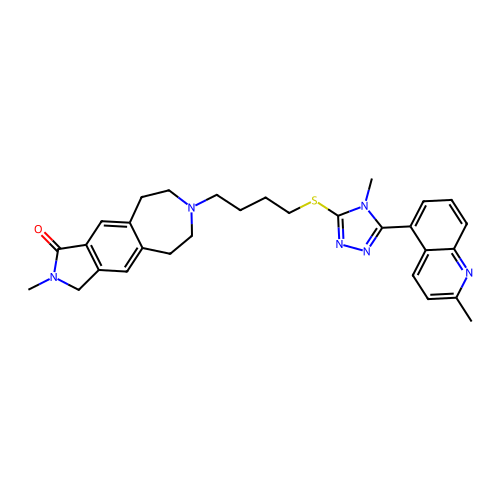

prediction: [0.01937607 0.9806239 ]
COc1cc(N2CCN(C(=O)[C@@H](C)N)CC2)ccc1Nc1ncc(Cl)c(-c2cnc3ccccn23)n1


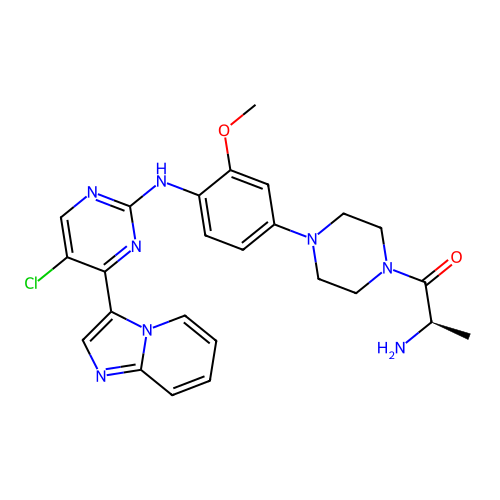

prediction: [0.01925378 0.98074627]
O=C(Cc1ccc(Cl)cc1)N[C@H](Cc1ccc(Cl)cc1)C(=O)N[C@H]1C[C@H]2CC[C@@H](C1)N2


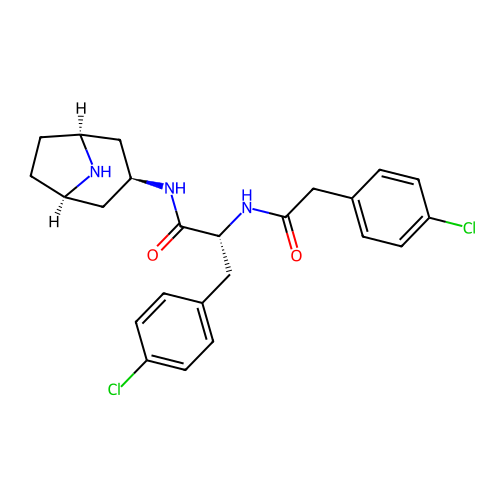

prediction: [0.01923707 0.98076284]
O=C1O[C@]2(CC[C@H](c3nc4cc(C(F)(F)F)ccc4[nH]3)CC2)CN1c1ccccn1


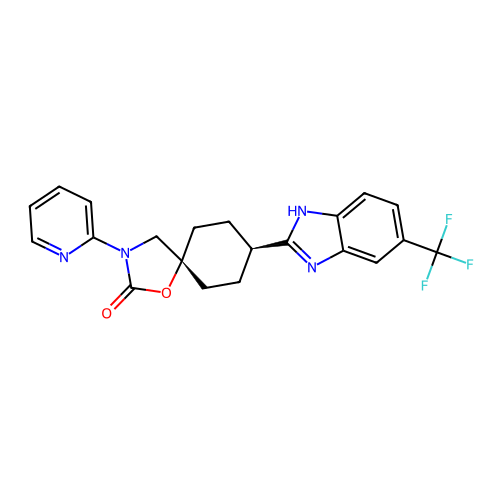

prediction: [0.01874843 0.9812516 ]
Nc1ccc(-c2nnc(C3CCN(Cc4ccc(-c5nc6nc(N7CCN(CCO)CC7)ccc6nc5-c5ccccc5)cc4)CC3)[nH]2)cn1


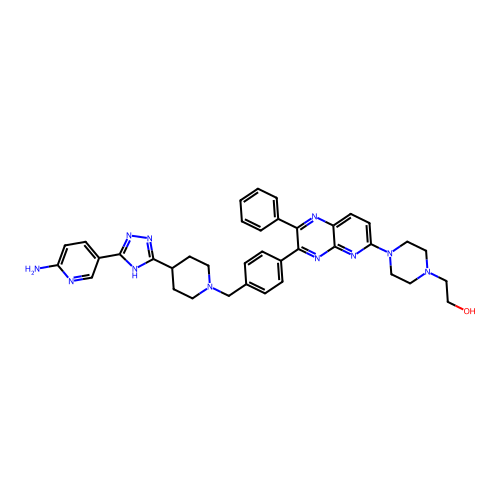

prediction: [0.01855314 0.98144686]
OCCN(CCO)Cc1csc(-c2cn(CC3CCOCC3)c3c(Cl)cccc23)n1


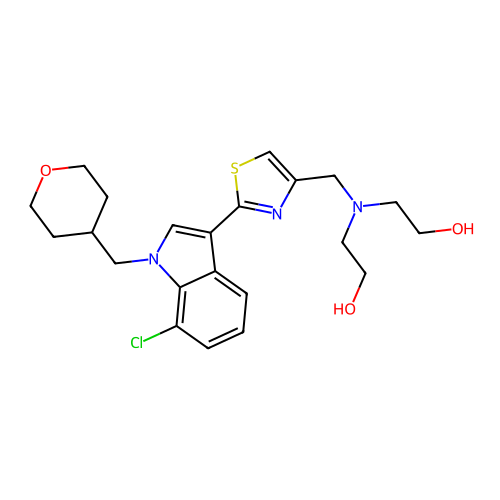

prediction: [0.01852425 0.98147583]
CCC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1


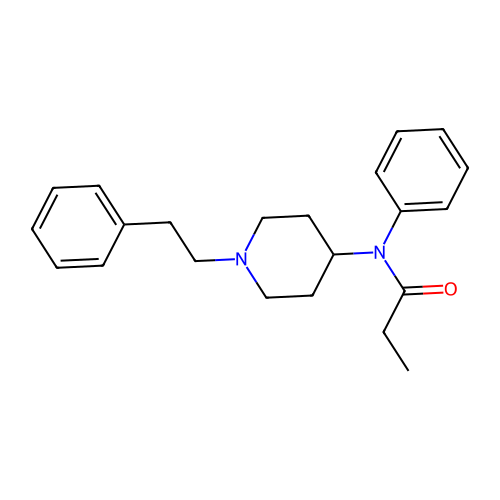

prediction: [0.01843 0.98157]
Fc1ccc(Cn2cc(NCCN3CCCCC3)nn2)cc1


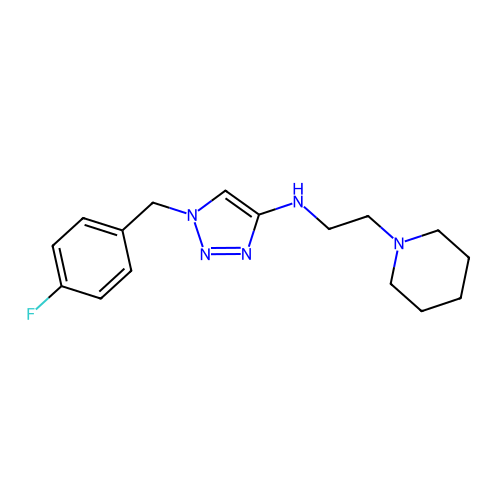

prediction: [0.01840557 0.98159444]
O=C(O)CCCOc1cccc(CCCCCCOc2cc(-c3ccsc3)cc(-c3ccc4c(c3)OCO4)c2)c1CCC(=O)O


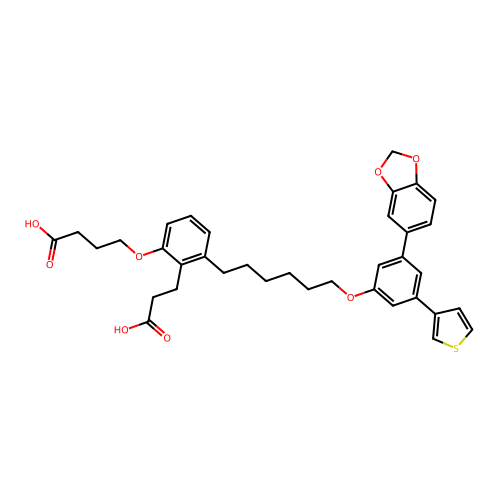

prediction: [0.01831252 0.9816875 ]
Fc1ccc2[nH]c(-c3ccccc3)c(C3C[NH2+]CCC3F)c2c1


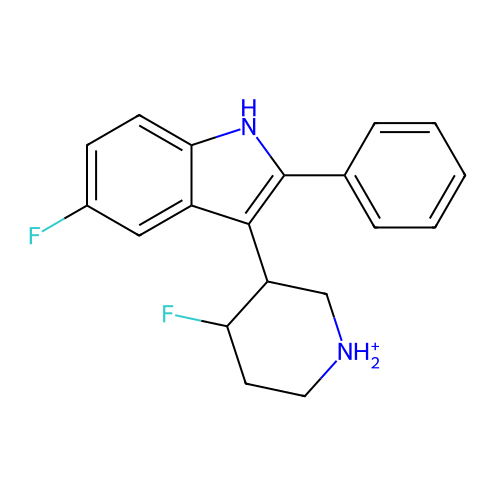

prediction: [0.01815202 0.981848  ]
CS(=O)(=O)Nc1ccc2c(c1)nc1n2C[C@H](N)[C@@H](c2cc(F)c(F)cc2F)C1


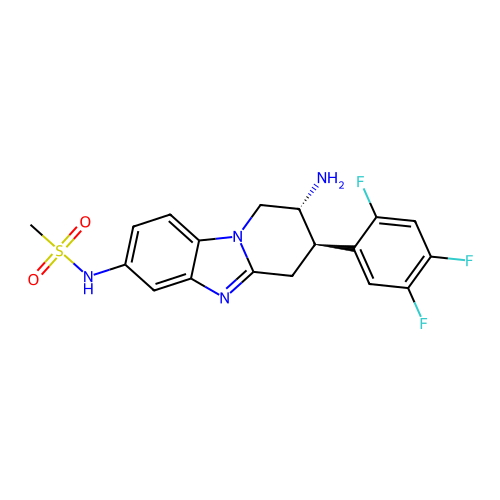

prediction: [0.0180347  0.98196524]
COc1cnc(-c2ccccc2CCNC(=O)c2ccc(OCCC(F)(F)F)nc2)cn1


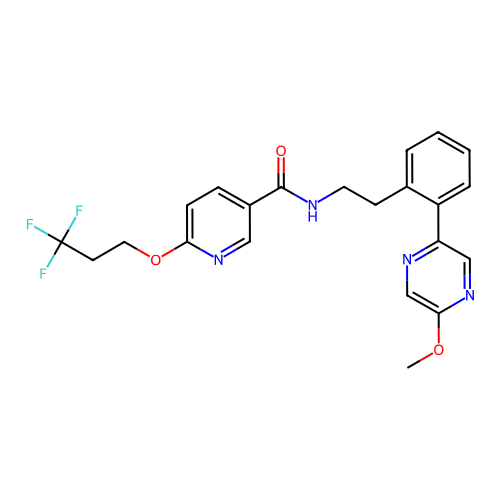

prediction: [0.01789234 0.9821077 ]
NCCNS(=O)(=O)c1cccc2cnccc12


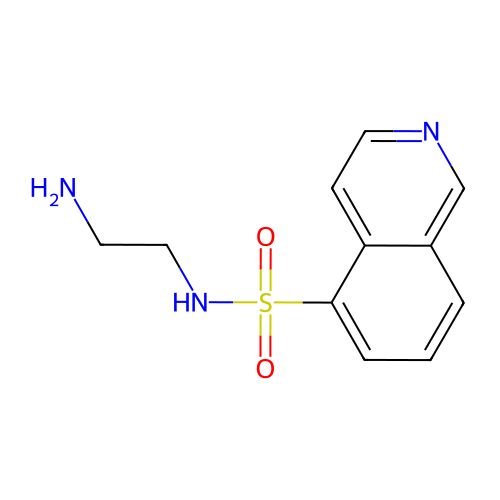

prediction: [0.0177882  0.98221177]
COc1cc(C)nc(Nc2cc(N[C@@H]3CCCC[C@@H]3N)cnc2C(N)=O)c1


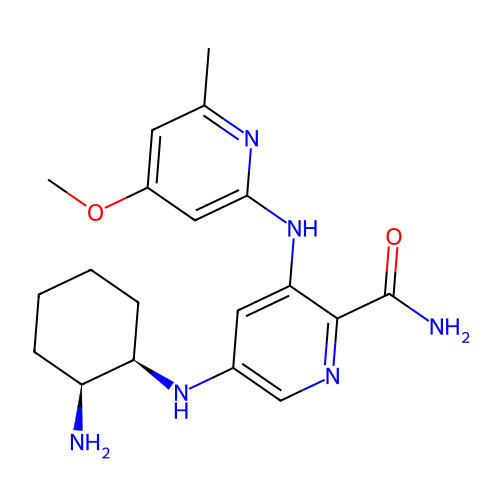

prediction: [0.01771349 0.9822865 ]
Cc1c(CN(C2CCOCC2)[C@H]2CCNC2)cccc1C(F)(F)F


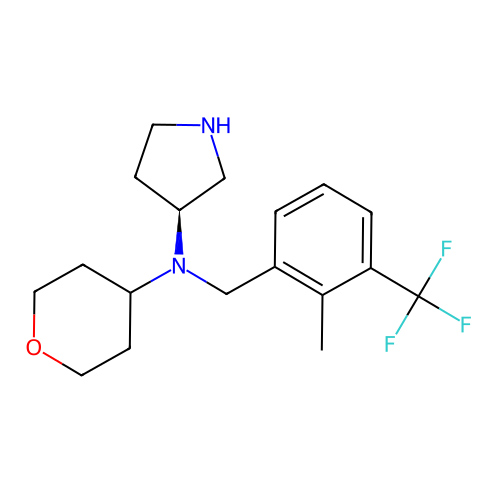

prediction: [0.01767972 0.98232025]
Cc1ccc2c(N3CCN(CCc4cccc5c4OCc4cncn4-5)CC3)cccc2n1


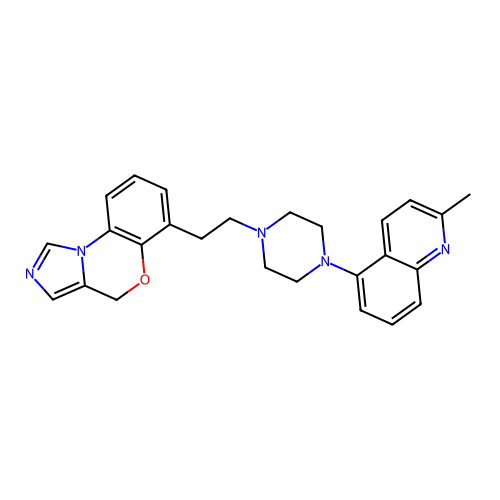

prediction: [0.01754797 0.98245203]
O=C1O[C@]2(CC[C@H](c3nc4cc(OC(F)(F)F)ccc4[nH]3)CC2)CN1c1cccc(F)n1


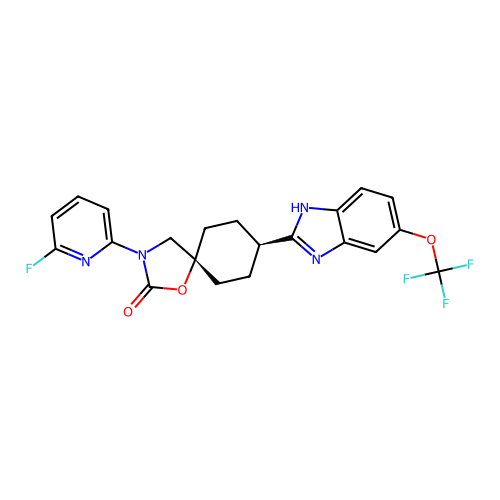

prediction: [0.01709652 0.9829034 ]
CCOC[C@@H](CC(C)C)NC(=O)[C@@H]1CNC[C@H](C(=O)N(c2ccc(C(C)C)c(OCCCOC)n2)C2CC2)C1


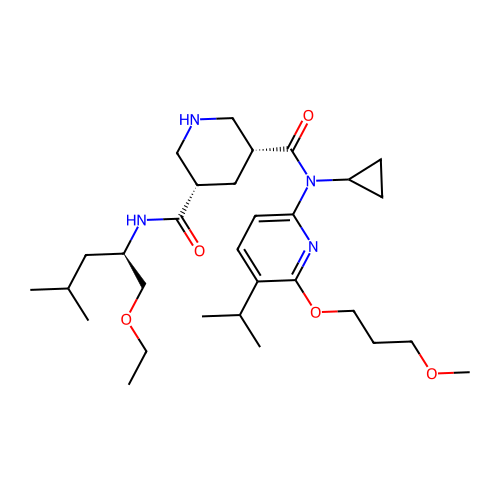

prediction: [0.01703063 0.9829694 ]
Cc1cccnc1CN1CCC(Oc2ncnc3c2ccn3Cc2ccccc2)CC1


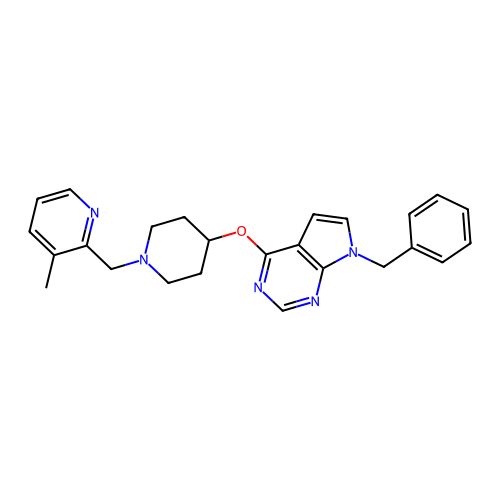

prediction: [0.01694545 0.9830546 ]
CC1(C)CC(NC(=O)C(F)(F)CO)c2cc(-c3ccc(Cl)cc3)c(-c3ccc(Cl)cc3Cl)nc2O1


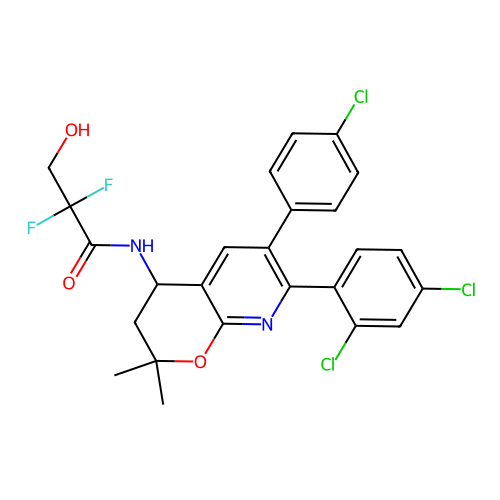

prediction: [0.01657159 0.9834284 ]
C[C@H]1c2c([nH]c3ccc(C(F)(F)F)cc23)C[C@H]2CCN(CCCC3CCOCC3)C[C@@H]21


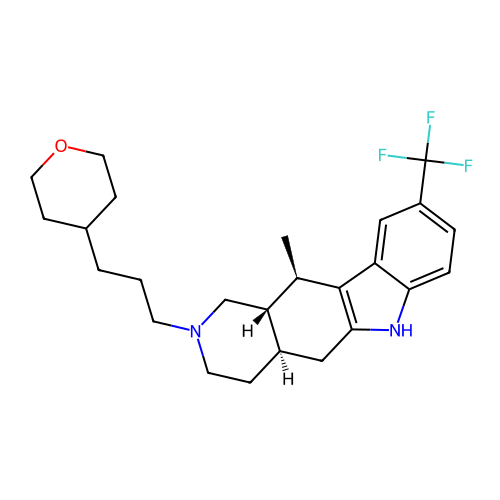

prediction: [0.01636509 0.98363495]
N#Cc1ccc2cc1Oc1ccc3c(c1)[C@@H](CC3)N1CC[C@H](NCc3cncn3C2)C1=O


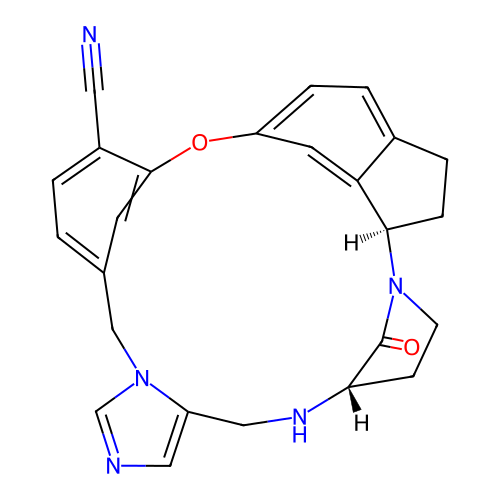

prediction: [0.0162638 0.9837362]
CC(C)c1cccc(N2CCN(CCN3Cc4ccccc4C3)C2=O)c1


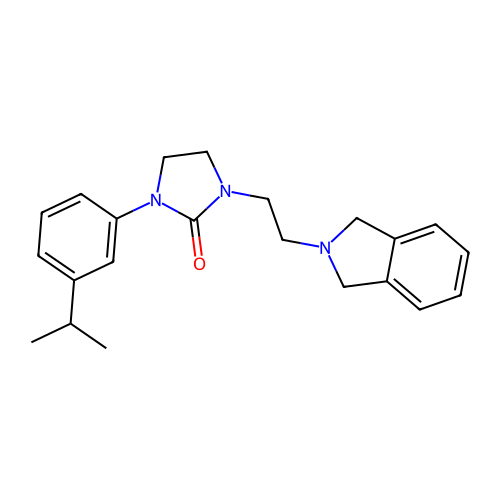

prediction: [0.01614171 0.9838583 ]
Cc1cccc(Nc2nc(N[C@@H]3COCC[C@@H]3N)ncc2C(N)=O)c1


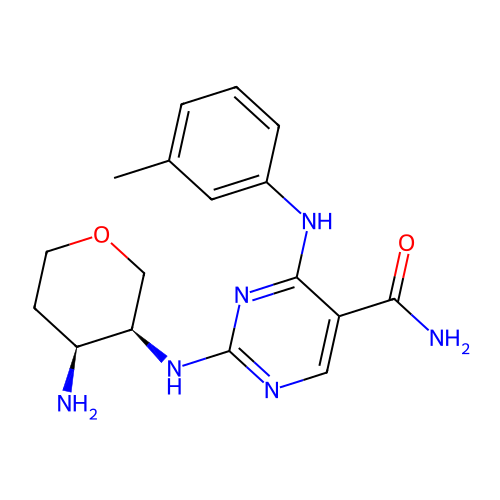

prediction: [0.01613521 0.9838648 ]
N#Cc1ccc(Cn2cncc2C[NH2+]C2CCN(C(=O)c3cccc(Cl)c3)C2=O)cc1


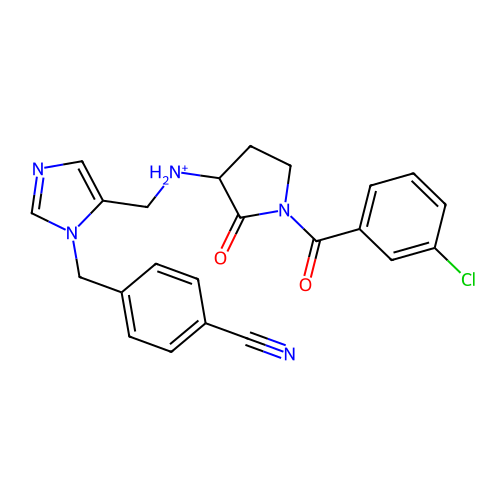

prediction: [0.01599688 0.9840031 ]
Cc1cc(CN2CCN(c3c(Br)cnc4[nH]c(N5CCN(C)CC5)nc34)CC2)no1


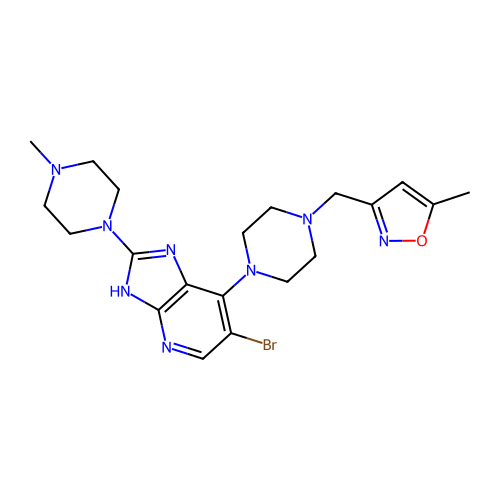

prediction: [0.01596062 0.98403937]
CCOCCn1nc(C)c2nc(NC3CCNCC3)nc(Nc3cc(C)ccn3)c21


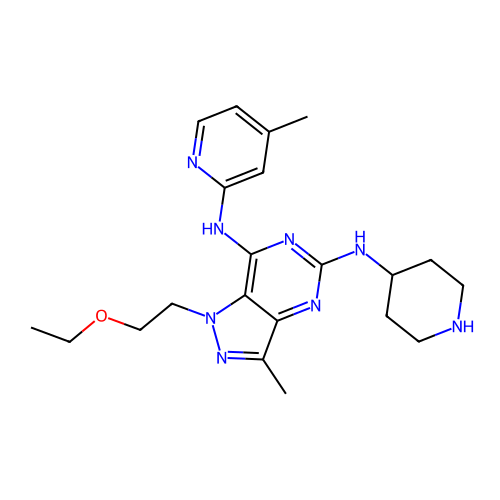

prediction: [0.0159362  0.98406386]
O=C(Nc1ccc(Cl)c(Cl)c1)N1CCN(CC2CCCNC2)CC1


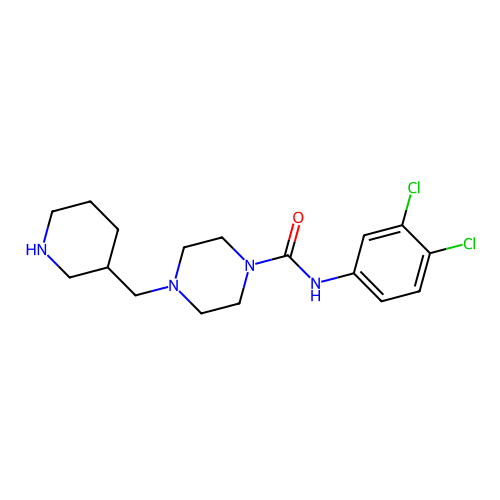

prediction: [0.015908 0.984092]
N#Cc1ccc2cc1Oc1ccc3c(c1)[C@@H](CC3)N1CC[C@@H](NCc3cncn3C2)C1=O


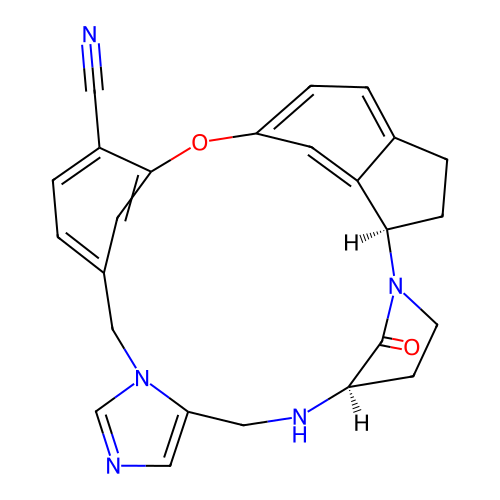

prediction: [0.01589763 0.9841024 ]
COC(=O)N(NC(=O)c1c(CN2CCN(S(=O)(=O)c3ccccc3)CC2)c(-c2ccccc2)nc2ccccc12)c1ccccc1


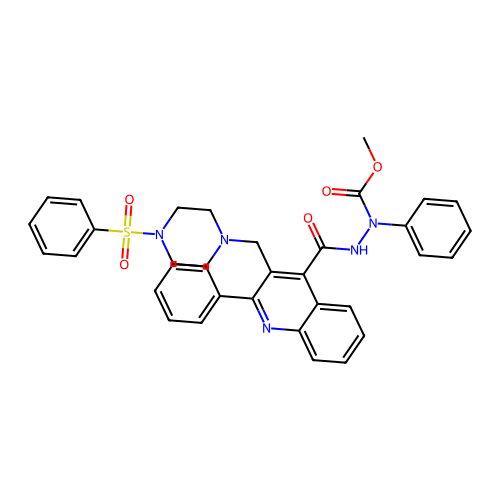

prediction: [0.01588454 0.9841155 ]
Cc1cccc(Nc2nc(N[C@@H]3CCC(F)(F)C[C@@H]3N)ncc2C(N)=O)c1


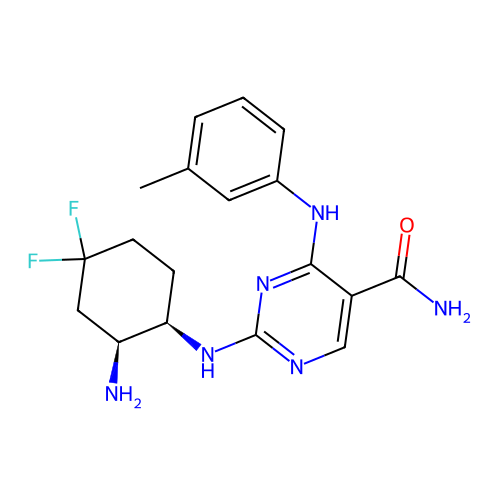

prediction: [0.01579829 0.9842017 ]
CC1(C)CN(c2cc3c(cn2)Oc2ccc(-c4cccnc4F)cc2[C@@]32COC(N)=N2)CCO1


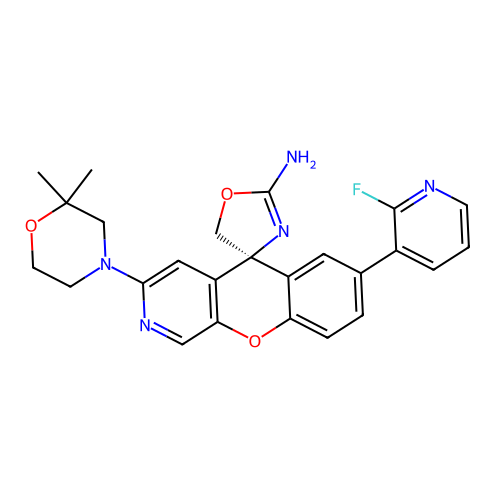

prediction: [0.01571579 0.98428416]
Fc1ccc(-n2cc(NCCN3CCCCC3)nn2)cc1F


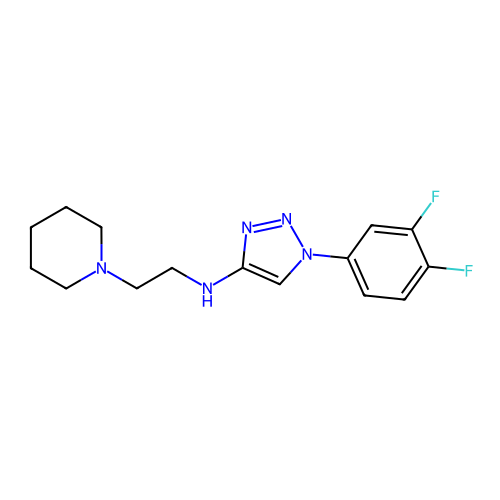

prediction: [0.01566502 0.984335  ]
CC(C)(C)NC(=O)c1c[nH]c2ncc(-c3nn(CCCS(C)(=O)=O)c4cc(F)ccc34)nc12


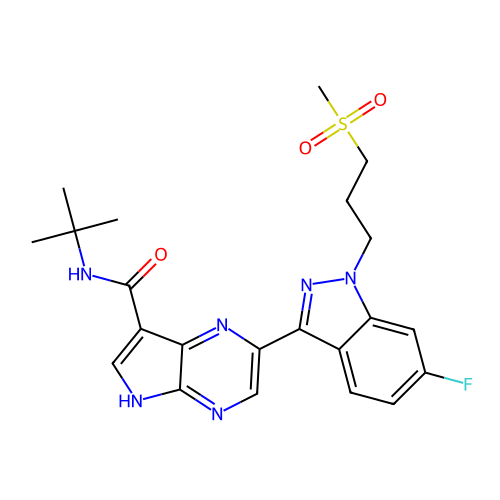

prediction: [0.01565763 0.9843424 ]
CCOc1ccccc1NC(=O)C(=O)CC(=O)c1ccc(OC)cc1


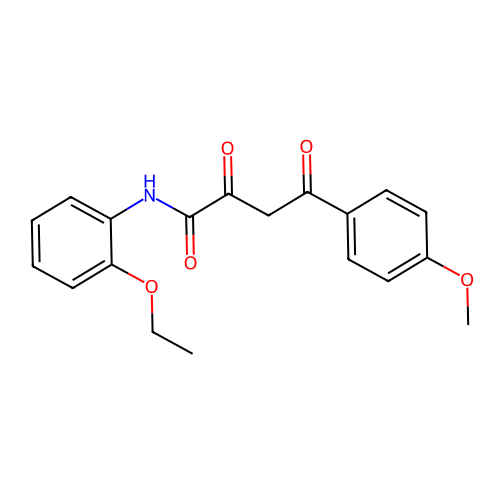

prediction: [0.01563218 0.9843678 ]
Cc1nc2ccc3c(c2s1)CCN(CCCSc1nnc(-c2ocnc2C)n1C)CC3


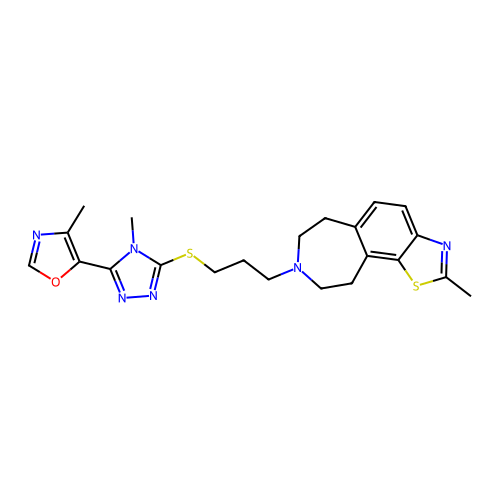

prediction: [0.01559263 0.9844074 ]
NC1=N[C@@]2(CO1)c1cc(-c3cccnc3F)ccc1Oc1ncc(C3=CCCOC3)cc12


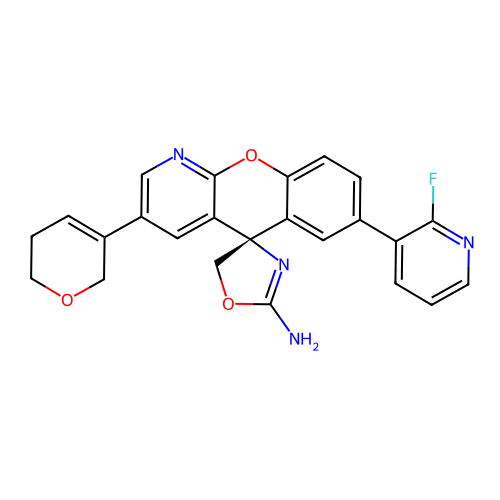

prediction: [0.01555628 0.98444366]
C[C@@H]1N=C(c2ccc(=O)n(C(F)F)c2)N[C@@]1(c1ccc(F)cc1)c1ccc(F)nc1


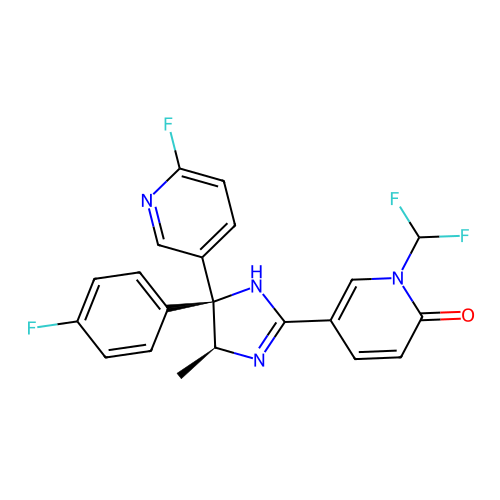

prediction: [0.01548256 0.9845174 ]
Cn1cc([C@@]2(c3cncc(C(=O)O)c3)N[C@@H](c3nc(-c4ccc(F)cc4)c[nH]3)Cc3c2[nH]c2ccccc32)cn1


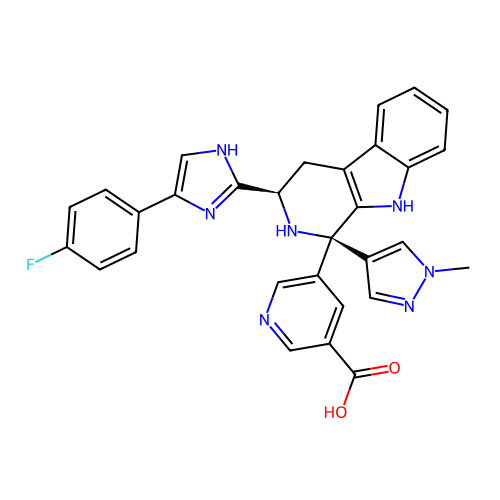

prediction: [0.01543254 0.9845674 ]
COc1ccc2ncc(F)c(CCC34CCC(NCc5ccc6c(n5)N(C)C(=O)CO6)(CC3)CO4)c2n1


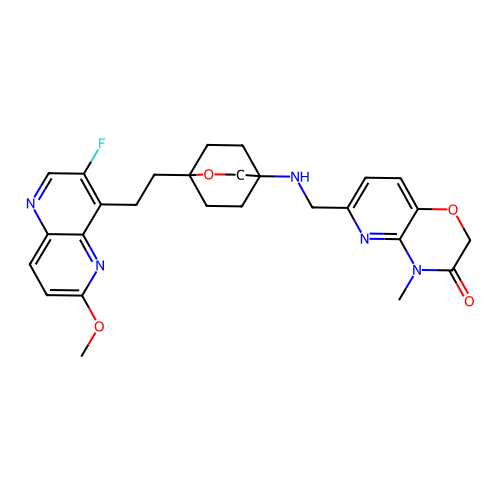

prediction: [0.01540187 0.98459816]
Cc1cn(-c2ccc3n(c2=O)CCN([C@@H](C)COc2ccc(F)cc2[C@@H](C)C(F)(F)F)C3=O)cn1


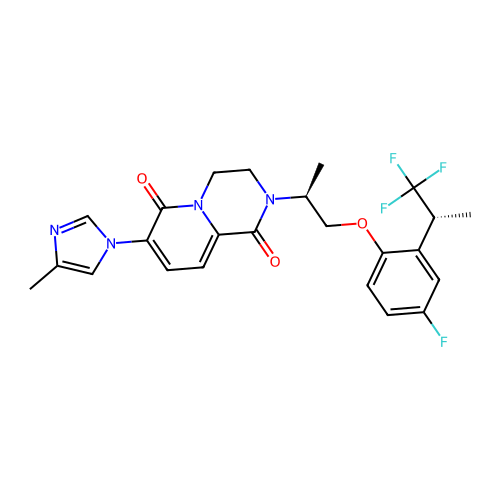

prediction: [0.01507665 0.98492336]
CCN1C[C@@H]2CCCC[C@]2(c2ccc(Cl)c(Cl)c2)C1


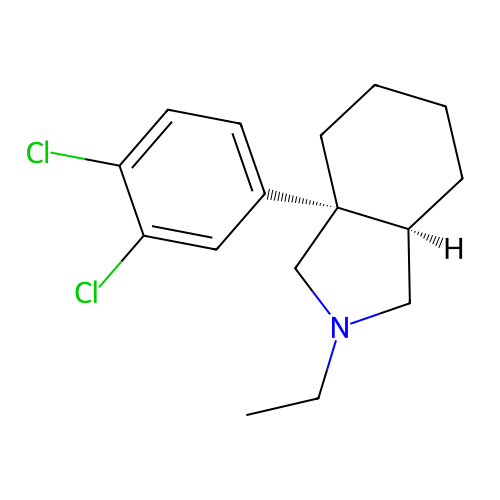

prediction: [0.01477118 0.98522884]
CNCc1ccccc1Oc1ccc(Cl)cc1OC


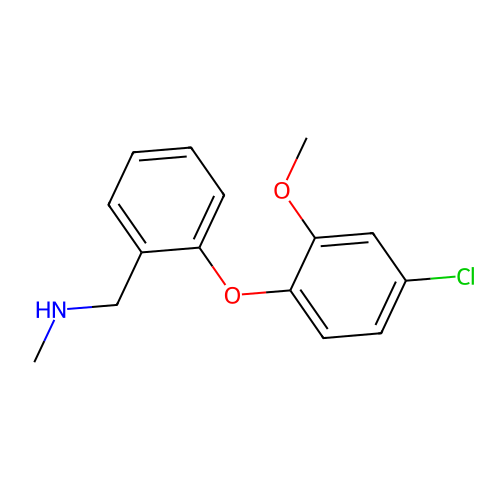

prediction: [0.01460838 0.98539156]
c1ccc2sc(Oc3ccc(CCN4CCCCC4)cc3)nc2c1


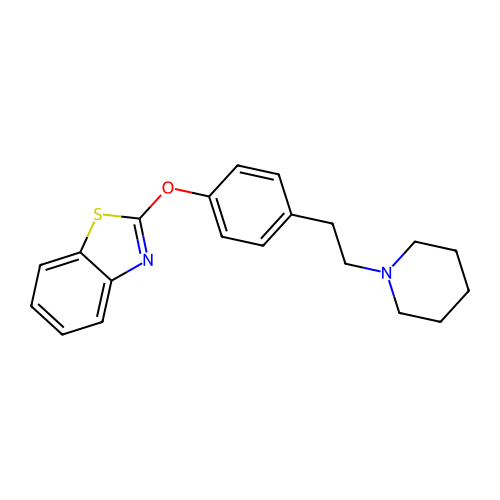

prediction: [0.01460004 0.9853999 ]
C[C@H]1Oc2ccc(-c3cccnc3F)cc2[C@@]2(COC(N)=N2)C12COC2


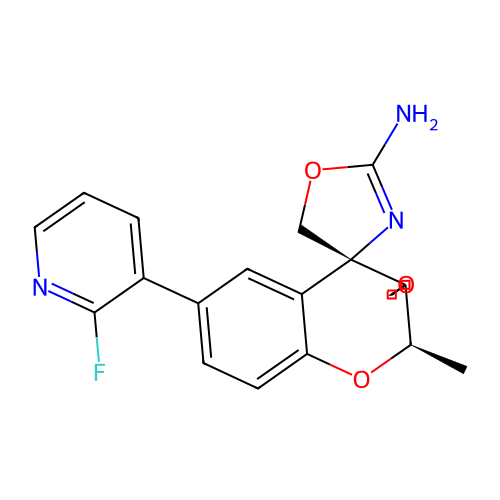

prediction: [0.01432361 0.9856764 ]
CC(C)(C)NC(=O)c1c[nH]c2ncc(-c3nn(CCCN4CCOCC4)c4ccc(OC(F)F)cc34)nc12


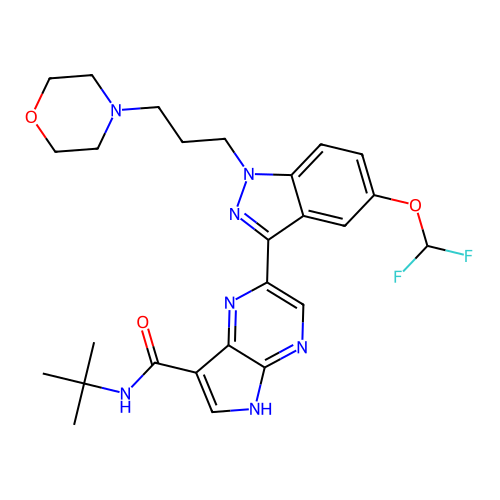

prediction: [0.01427999 0.98572   ]
CCCN(CCC)[C@@H]1CCc2ccc(O)cc2C1


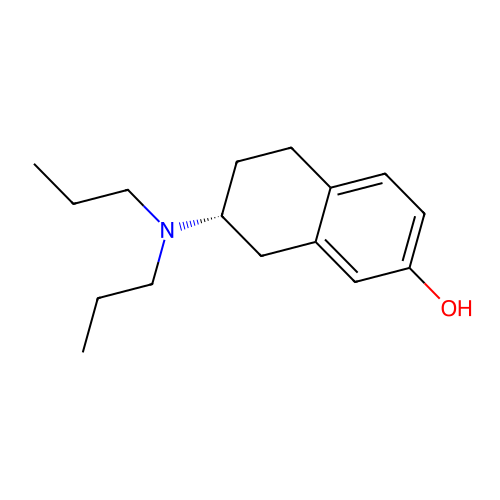

prediction: [0.01417754 0.9858225 ]
CCCCCCCN(CC)CCCCc1ccc([N+](=O)[O-])cc1


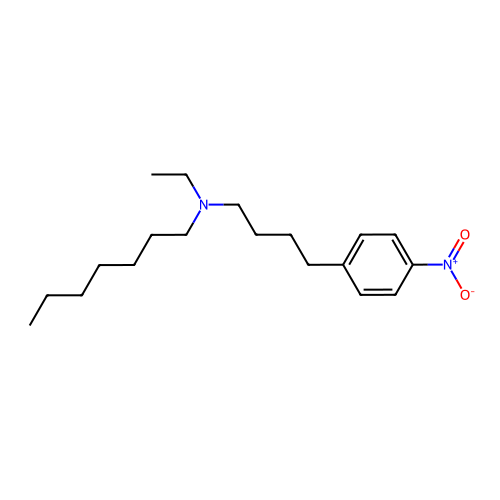

prediction: [0.01410943 0.9858906 ]
Cc1nc(C)c(-c2ccc3cc(CCN4CCC[C@H]4C)ccc3n2)cc1C#N


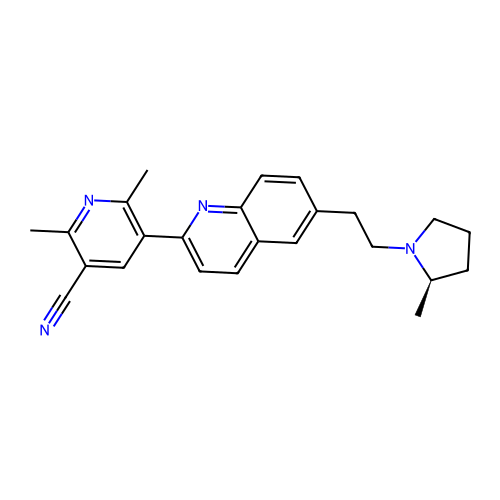

prediction: [0.01409565 0.9859044 ]
Fc1ccc2c(C3C[NH2+]CCC3F)c(C3=CNC=CC3)[nH]c2c1


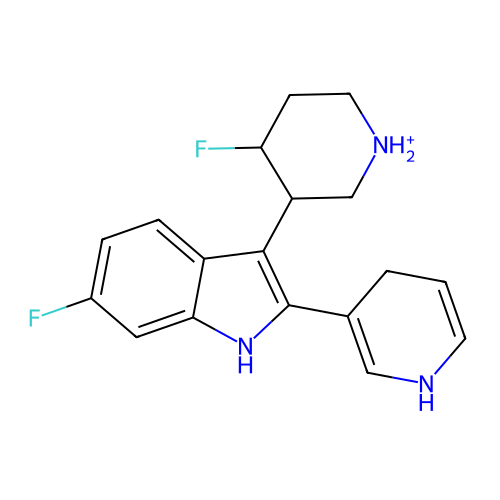

prediction: [0.01399623 0.9860037 ]
Cn1c(SCCCN2C[C@@H]3C[C@]3(c3ccc(C(F)(F)F)cc3)C2)nnc1-c1ccnnc1


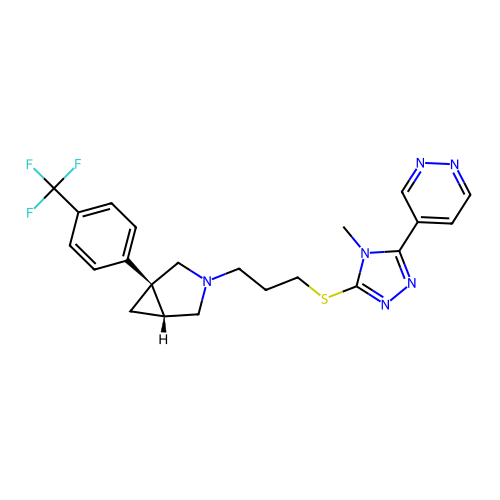

prediction: [0.01394096 0.986059  ]
Clc1ccc(-n2c(-c3ccccc3Cl)nc3c(N4CCCCC4)ncnc32)cc1


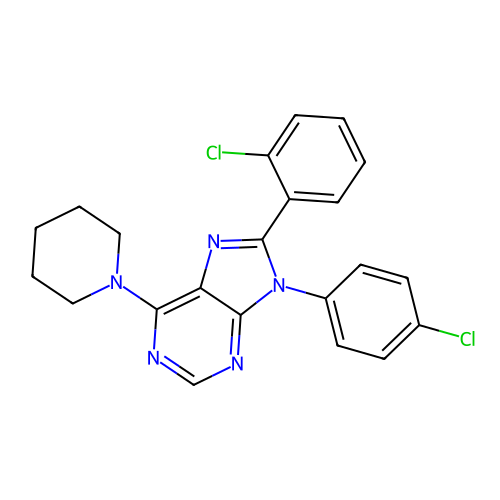

prediction: [0.01388124 0.9861188 ]
CCN(CC)C(=O)c1ccc(C2=CC3(CCNCC3)Oc3ccccc32)cc1C


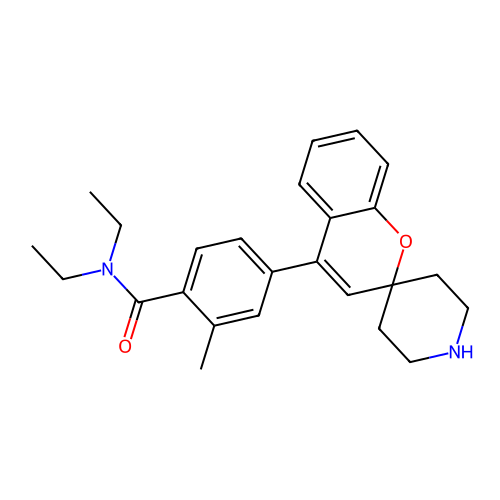

prediction: [0.01384594 0.9861541 ]
COc1ncc(-c2cccc(C)c2CCNC(=O)c2ccc(OCCC(F)(F)F)nc2)cn1


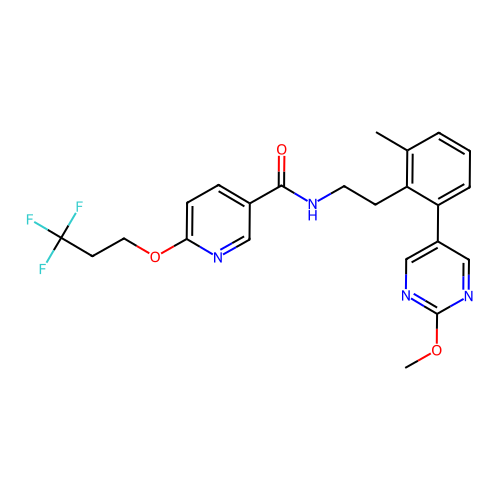

prediction: [0.01384421 0.9861558 ]
C[C@@H]1CCCN1CCc1ccc2nc(-c3ccc(C#N)s3)ccc2c1


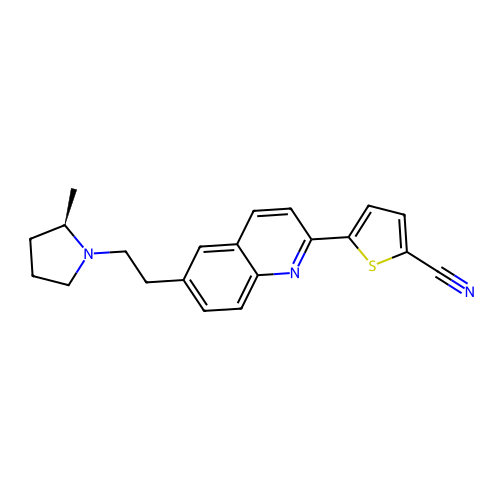

prediction: [0.01383594 0.98616403]
O=C(NCc1ccc(OCC(F)(F)F)nc1)C1c2ccccc2C(=O)N1CCc1ccccn1


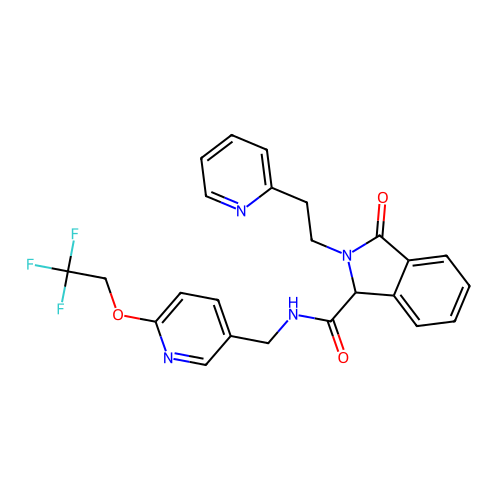

prediction: [0.0138146 0.9861854]
Fc1ccc(C(c2ccc(F)cc2)N2CCN(C/C=C/c3ccccc3)CC2)cc1


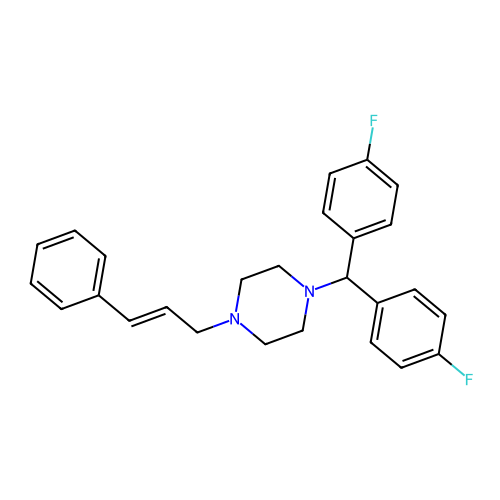

prediction: [0.01381236 0.9861877 ]
Cc1ccc2c(N3CCN(CCc4cccc5c4OCc4c(C(=O)NC6CCC6)ncn4-5)CC3)cccc2n1


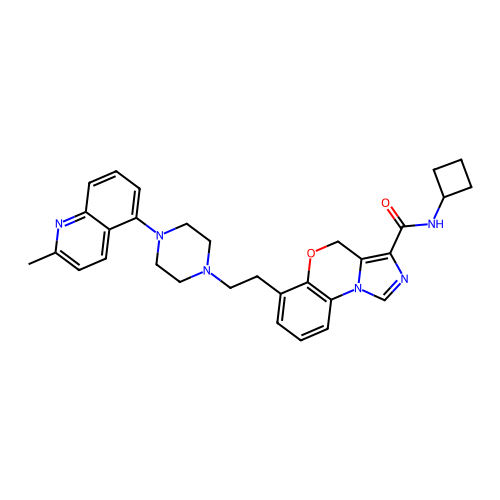

prediction: [0.0137853 0.9862147]
Cc1ccc(CN2CCC(Oc3ncnc4c3ccn4Cc3ccccc3)CC2)nc1


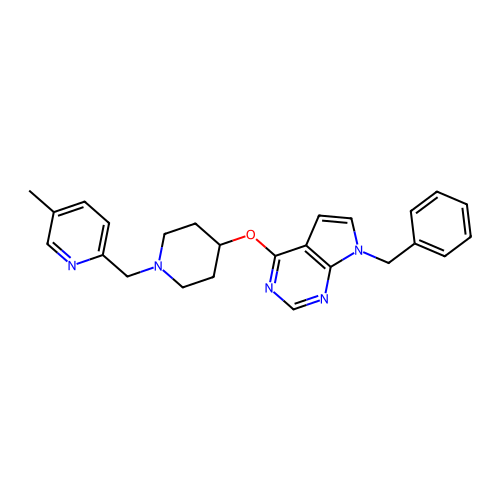

prediction: [0.01368152 0.98631847]
CCCN1CCc2cccc3c2[C@H]1Cc1ccc(O)c(O)c1-3


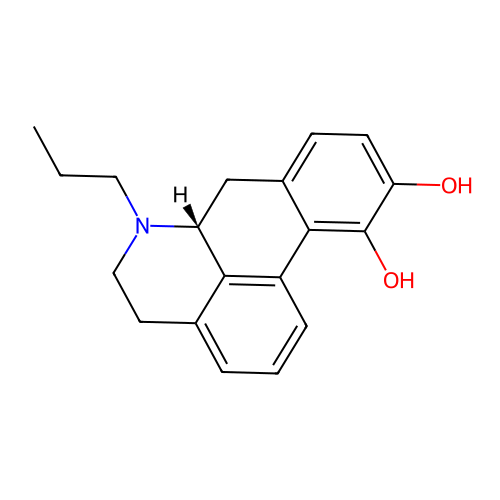

prediction: [0.01364656 0.9863535 ]
CCOc1cc(CN2CCC(Nc3nc4cc(S(N)(=O)=O)ccc4o3)CC2)ccc1OC


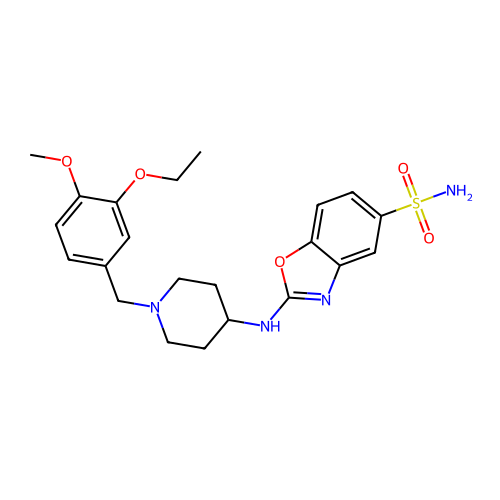

prediction: [0.01341467 0.9865854 ]
Cc1ccc2c(-c3nnc(SCCCN4C[C@@H]5C[C@]5(c5ccc(Br)cc5)C4)n3C)cccc2n1


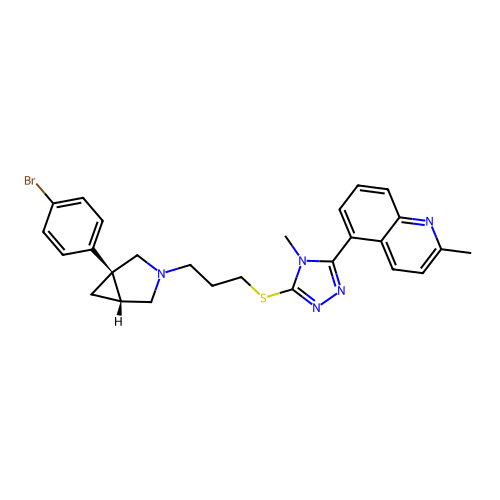

prediction: [0.0133993 0.9866007]
Fc1ccc2c([C@@H]3CNCC[C@H]3F)c(C3CCCCC3)[nH]c2c1


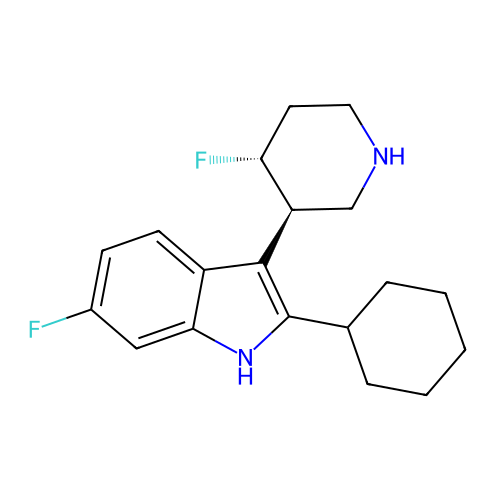

prediction: [0.01334661 0.9866534 ]
COc1cccc2nc(C)n(-c3ccc(OC4CCN(C5CCC5)CC4)cc3)c(=O)c12


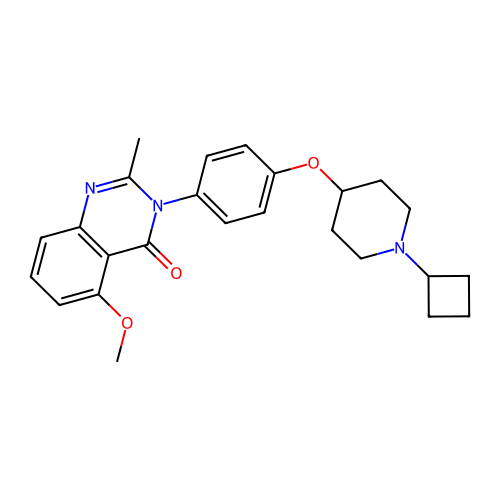

prediction: [0.01333737 0.9866627 ]
Clc1ccc([C@@]23CCC[C@@H]2CNC3)cc1Cl


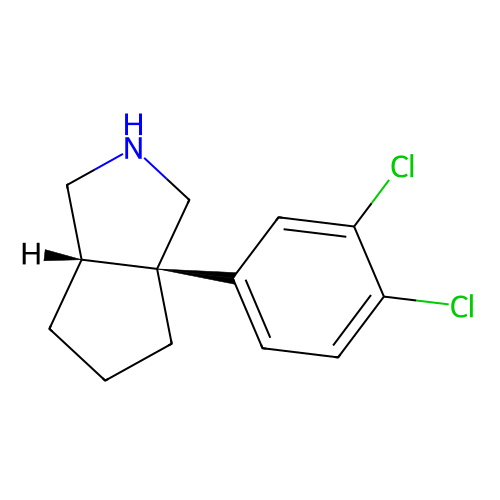

prediction: [0.01330124 0.98669875]
Nc1ccc(-c2cccc(F)c2)cc1NC(=O)c1ccc(CN2CCC3(CCCN3)CC2)cc1


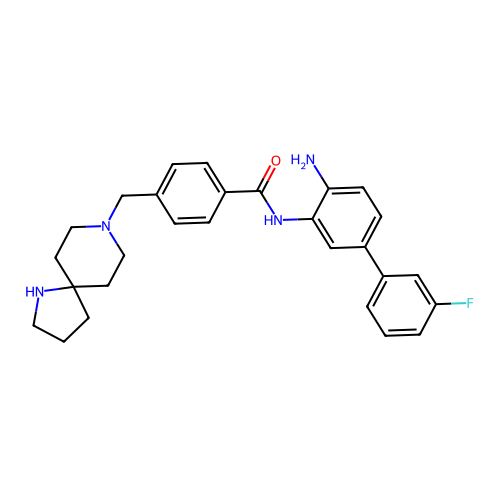

prediction: [0.01329889 0.9867011 ]
CCOC(=O)C1=C[C@]2(CC)CCC[NH+]3CCc4c(n1c1ccccc41)[C@@H]32


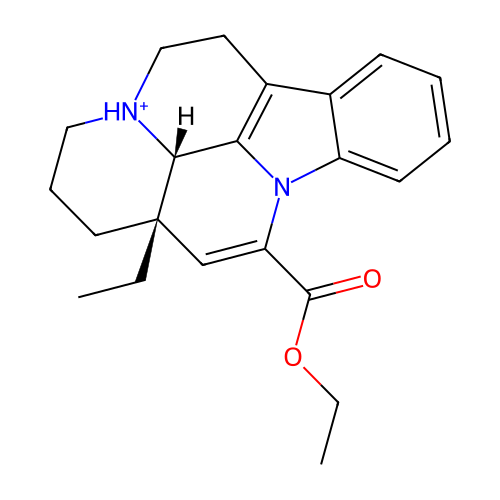

prediction: [0.01319058 0.9868094 ]
Cn1c(=O)nc(NC2CC3CCC(C2)N3Cc2ccc3c(c2)OCO3)c2cc(Cl)ccc21


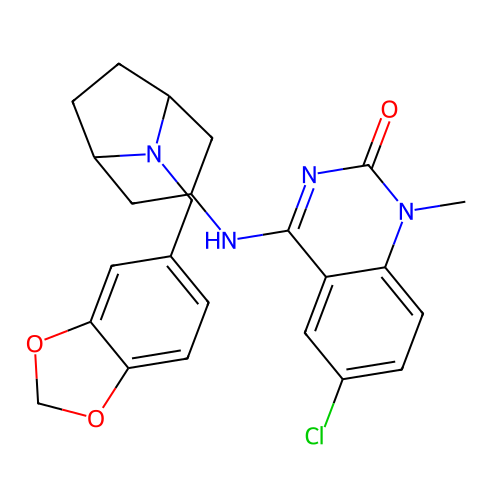

prediction: [0.01318387 0.9868161 ]
Cn1c(=O)cc(NC2CCN(C/C=C/c3ccccc3)CC2)c2cc(Cl)ccc21


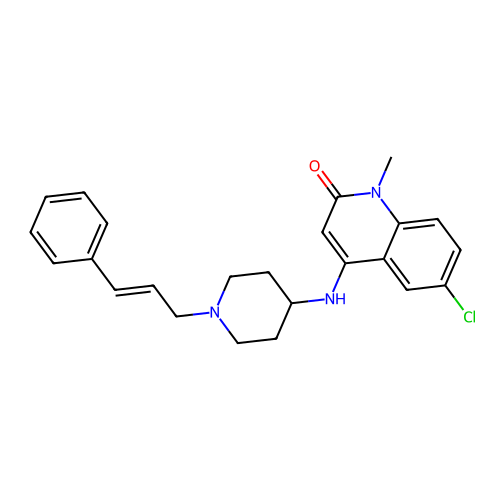

prediction: [0.01315882 0.9868412 ]
CN1C[C@@H]2CCC[C@]2(c2ccc(Cl)c(Cl)c2)C1


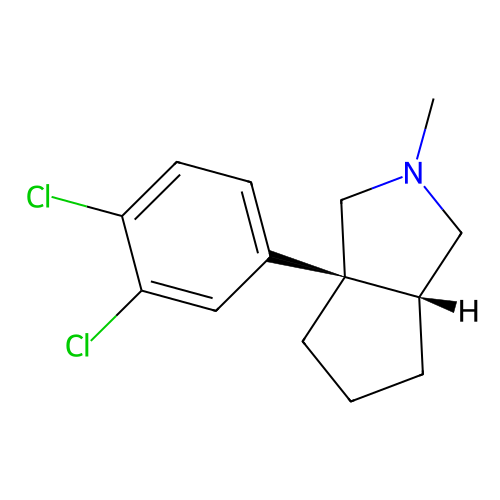

prediction: [0.01304094 0.98695904]
O=C(NCC1CCCCN1)c1cc(OCC(F)(F)F)ccc1OCC(F)(F)F


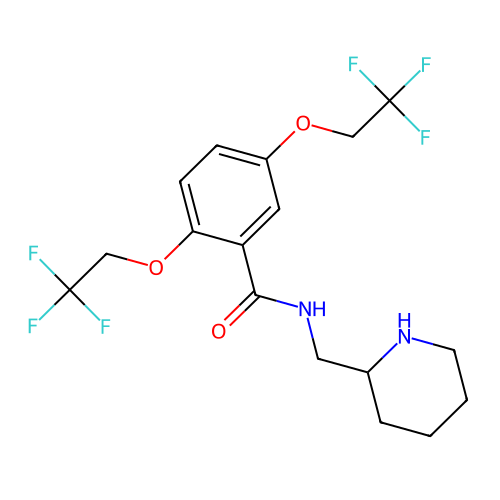

prediction: [0.0130116 0.9869884]
C[C@@H]1CN(CCC#N)CCN1c1cc2[nH]c(SC(C)(C)C)nc2cc1Cl


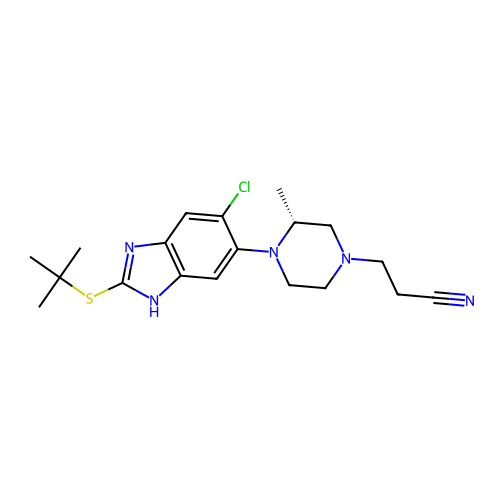

prediction: [0.01297174 0.98702824]
COc1ccc(C23CC2CN(CCCSc2nnc(-c4ocnc4C)n2C)C3)cc1Cl


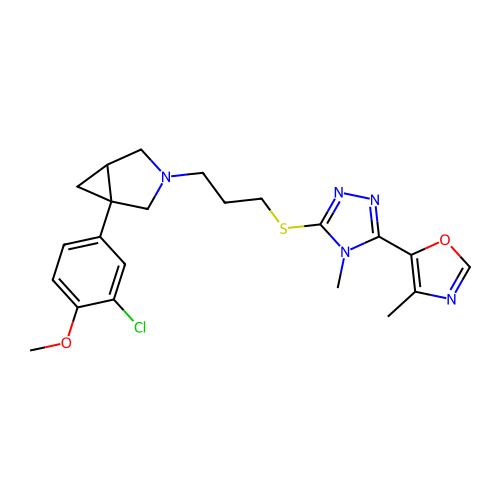

prediction: [0.01287699 0.987123  ]
Cc1[nH]nc(C(=O)N[C@@H]2CC(C)(C)Oc3nc(-c4ccc(Cl)cc4Cl)c(-c4ccc(Cl)cc4)cc32)c1C


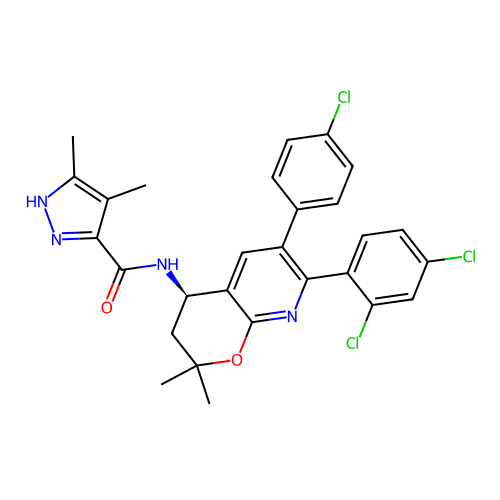

prediction: [0.01284323 0.9871568 ]
O=C(c1ccc(Cl)cc1)N1CCC2(CCN(Cc3cccc(Oc4ccccc4)c3)CC2)CC1


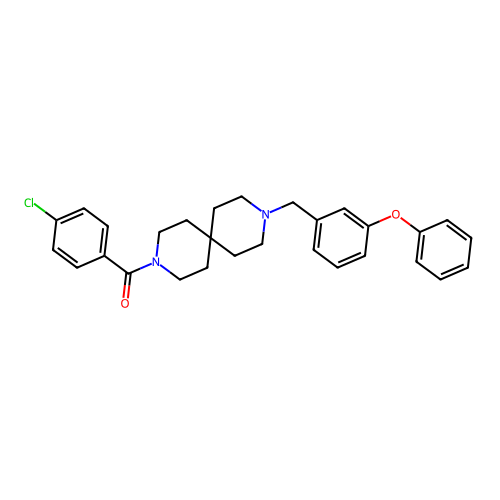

prediction: [0.01278225 0.9872177 ]
CC(C)(C)CN1CCC(c2ccccc2Oc2ncccc2NC(=O)Nc2ccc(OC(F)(F)F)cc2)CC1


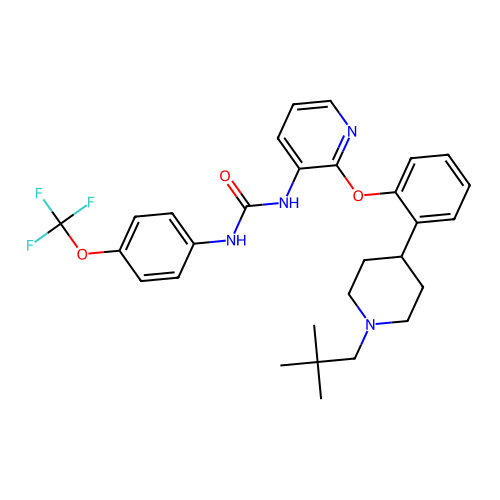

prediction: [0.01264491 0.98735505]
CCCCCCC[N+](CC)(CC)CCCCc1ccc(Cl)cc1


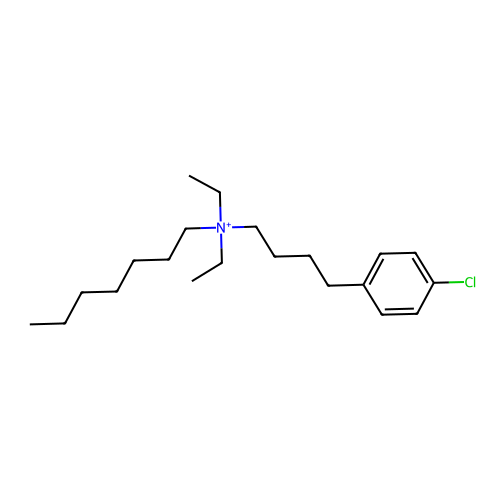

prediction: [0.01261996 0.98738   ]
Cc1ccc2c(c1)nc(CN1CCC[C@@H]1C)n2Cc1ccc(Cl)cc1


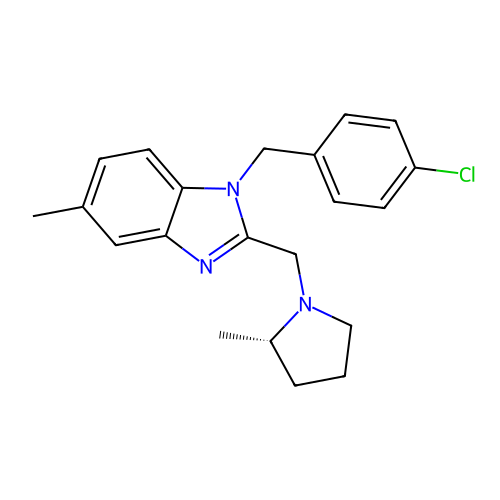

prediction: [0.0126108 0.9873892]
Cn1cc2c(OCC3CCN(CCN4CCOCC4)CC3)nc3ccccc3c2c1


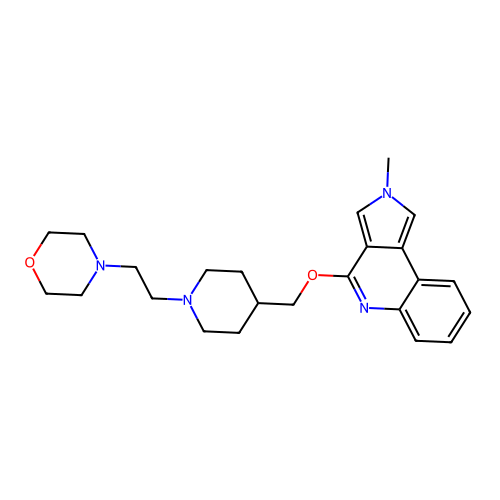

prediction: [0.01246907 0.9875309 ]
CC1(C)c2nc(-c3ccc(F)cc3)c(Nc3ccc(F)c(F)c3)n2CCN1C(=O)CN


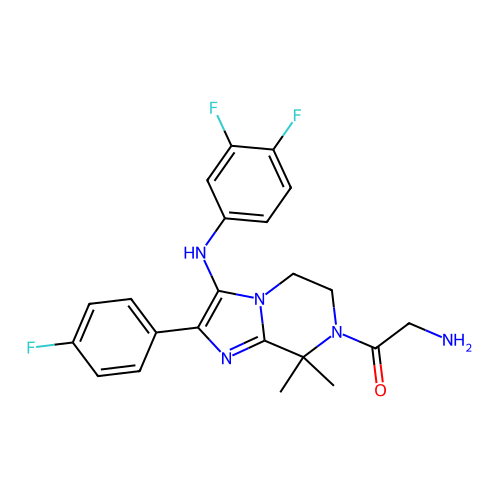

prediction: [0.01246547 0.9875345 ]
COC(=O)C(CCCN1CCC(c2ccccc2OC)CC1)(c1ccc(Br)cc1)C(C)C


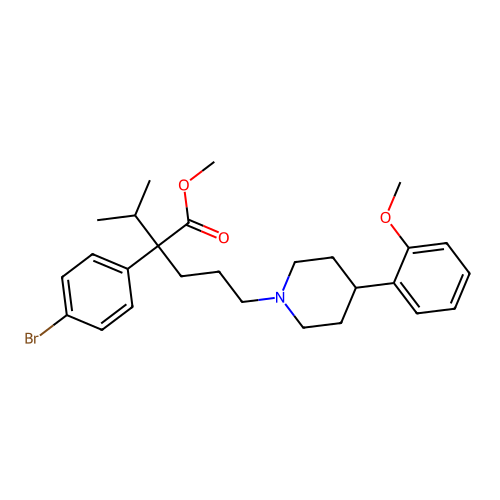

prediction: [0.01238173 0.9876182 ]
CC(C)(CCCN1CCCC(C(F)(F)F)C1)S(=O)(=O)c1ccccc1


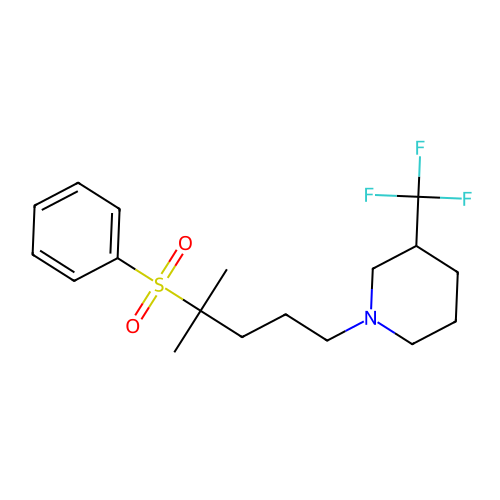

prediction: [0.01237206 0.987628  ]
Cc1ccc2c(N3CCN(CCc4cccc5c4OCc4c(C(=O)NCC6CC6)ncn4-5)CC3)cccc2n1


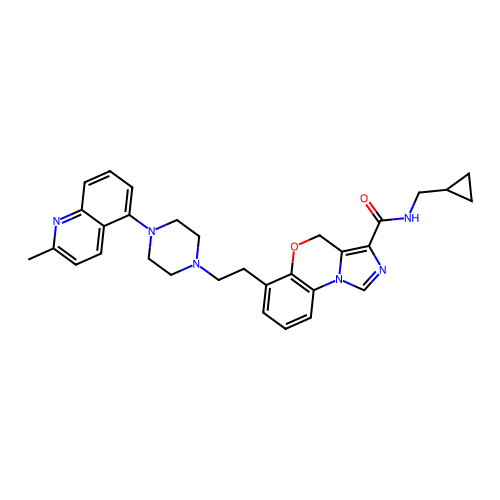

prediction: [0.01236225 0.98763776]
c1ccc(-c2[nH]c3ccccc3c2C2CCC[NH2+]C2)cc1


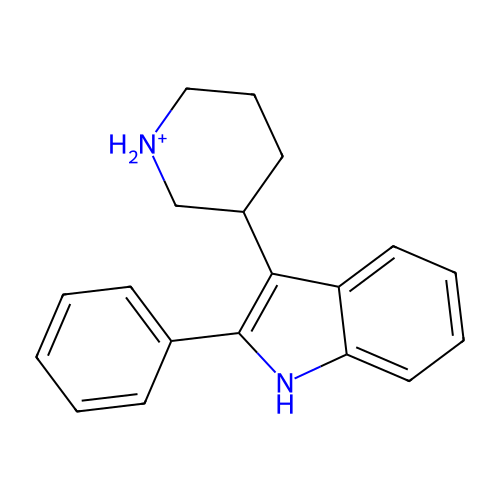

prediction: [0.01234035 0.98765963]
COc1ccc2nc(-c3ccc(OC4CCN(C5CCC5)CC4)cc3)n(C)c(=O)c2c1


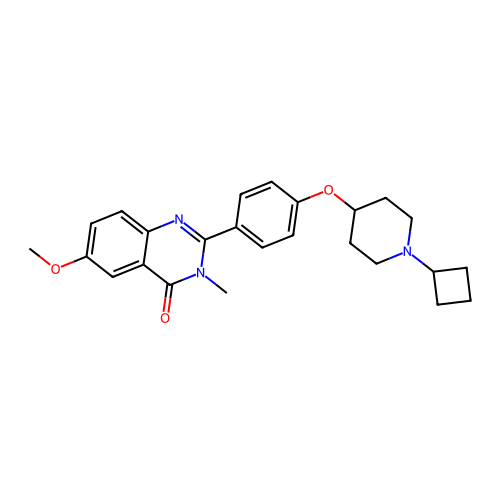

prediction: [0.01230908 0.9876909 ]
COc1ccc(CCN(C)CCCC(C#N)(c2ccc(OC)c(OC)c2)C(C)C)cc1OC


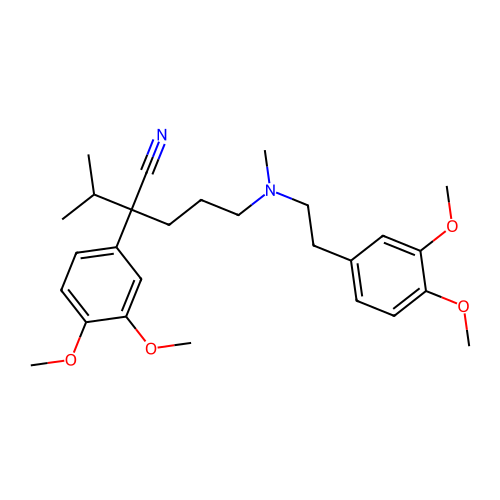

prediction: [0.01226713 0.9877329 ]
CCCOC(c1ccc2ccccc2c1)C1CNC1


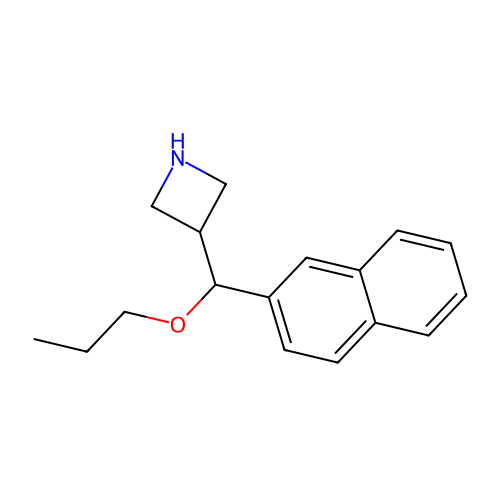

prediction: [0.01219862 0.9878014 ]
CC(C)(CNC(=O)N1CCC(c2nc(-c3ccc4ccccc4n3)no2)CC1)N1CCOCC1


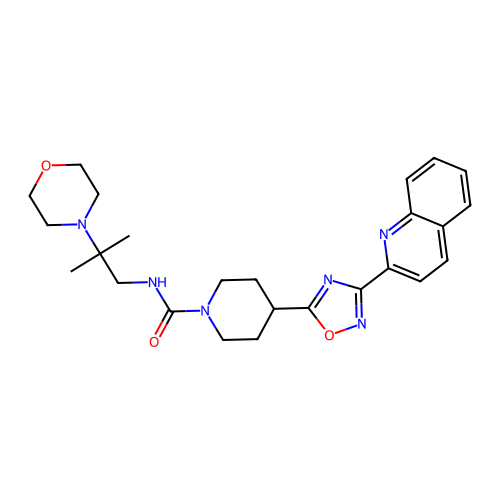

prediction: [0.01209063 0.9879094 ]
Cc1n[nH]c(C)c1C(=O)N[C@@H]1CC(C)(C)Oc2nc(-c3ccc(Cl)cc3Cl)c(-c3ccc(Cl)cc3)cc21


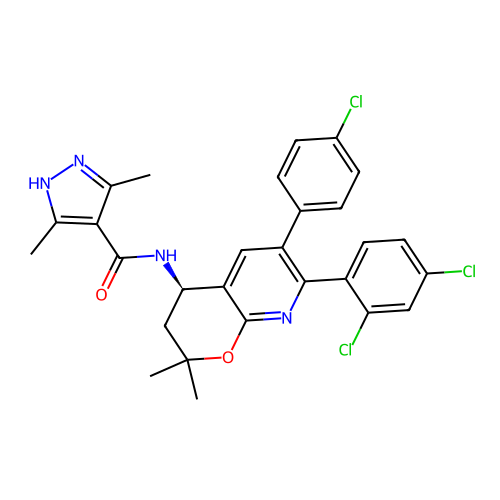

prediction: [0.01200546 0.98799455]
N#Cc1ccc(C2=CC3(CCNCC3)Oc3ccccc32)cc1


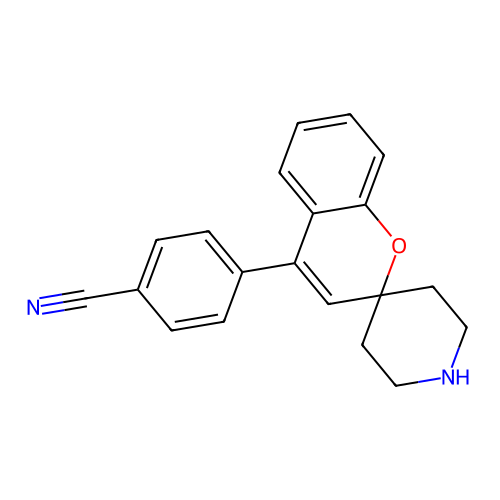

prediction: [0.0119749 0.9880251]
c1ccc(CCCNCCN(c2ccccc2)c2ccccc2)cc1


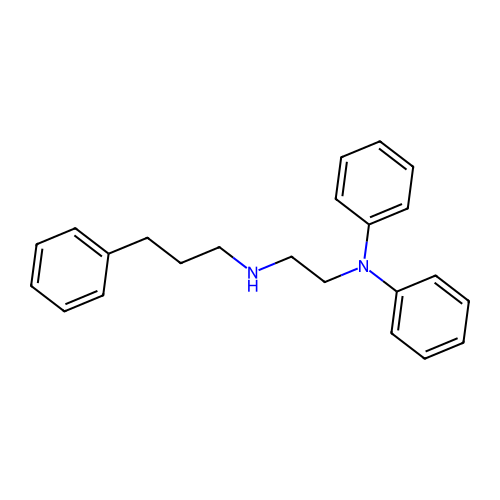

prediction: [0.01196659 0.9880334 ]
CCN1CCN(c2cc3[nH]c(SC(C)(C)C)nc3cc2Cl)[C@H](C)C1


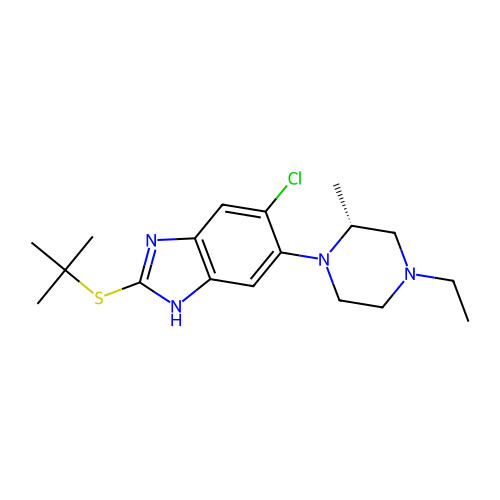

prediction: [0.01195166 0.9880483 ]
Cc1ccccc1[C@H]1C[C@@H](NCc2ccc(Cl)cc2)CC[C@@H]1C(=O)N1CC(c2ccccc2)(c2ccccc2)C1


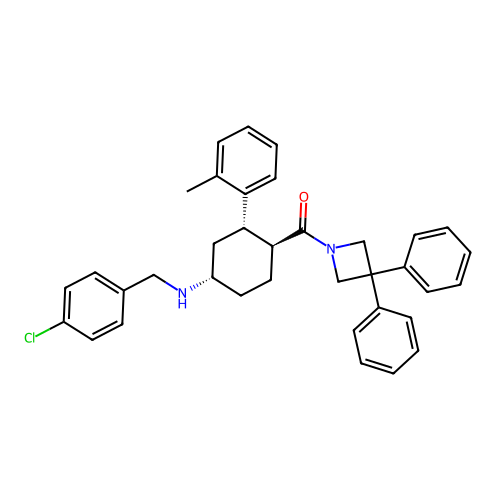

prediction: [0.0116925  0.98830754]
CC1=NC2=[N+](CCCC2)C(=O)C1CC[NH+]1CCC(c2noc3cc(F)ccc23)CC1


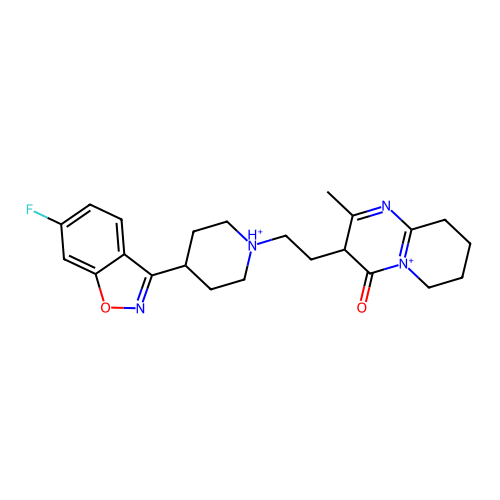

prediction: [0.01169191 0.98830813]
Cc1nc([C@]2(c3cnn(C)c3)N[C@@H](c3nc(-c4ccc(F)cc4)c[nH]3)Cc3c2[nH]c2ccccc32)no1


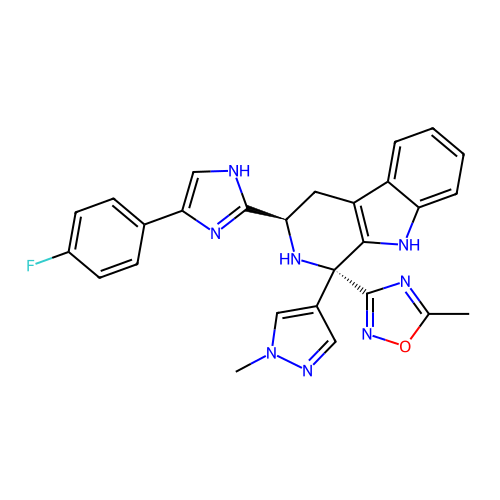

prediction: [0.01164042 0.9883596 ]
COc1cc(-c2cn(Cc3cccc(-c4noc(C)n4)c3)nn2)ccc1-n1cnc(C)c1


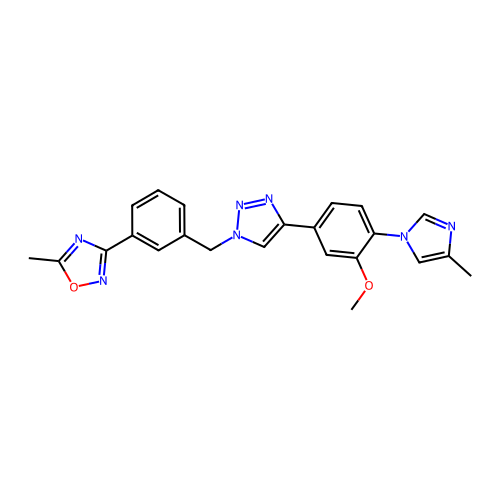

prediction: [0.01162397 0.988376  ]
Fc1ccc2cc(CCN3CCNCC3)ccc2c1


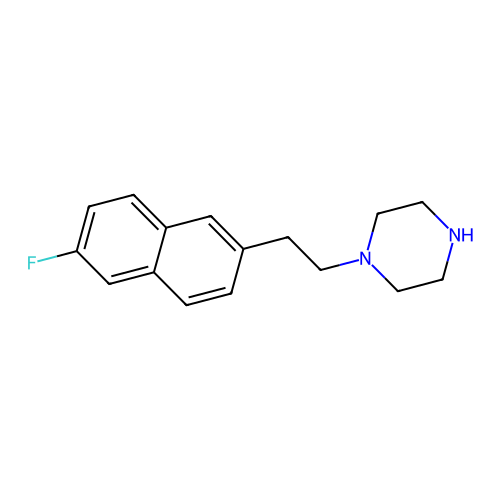

prediction: [0.01158482 0.9884151 ]
Cc1ccc(N2CCN(CC(O)COc3ccccc3C(=O)CCc3ccccc3)CC2)cc1


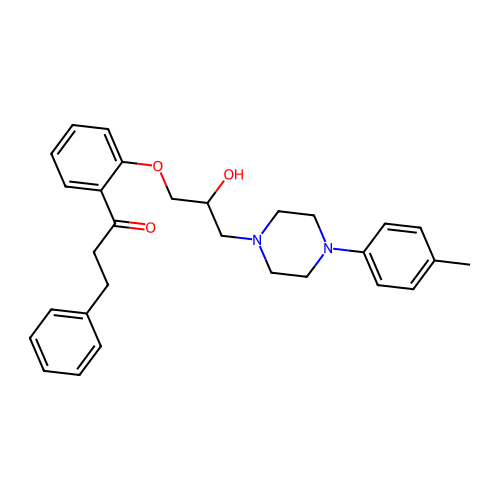

prediction: [0.01157218 0.9884278 ]
Cc1cnc(-c2ccc3c(c2)CCN(CCCSc2nnc(-c4ccc5[nH]ccc5c4)n2C)CC3)o1


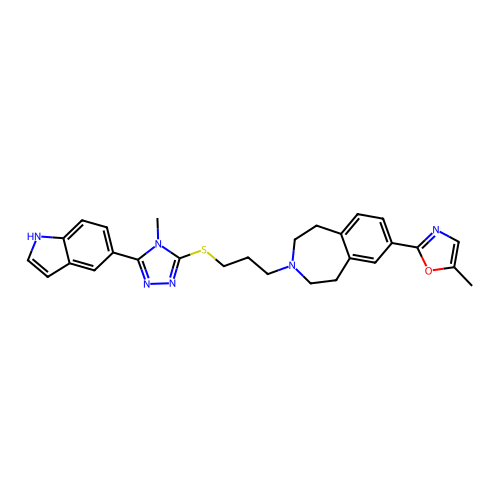

prediction: [0.01151202 0.9884879 ]
Cc1cc(Cl)nc(C)c1C(=O)NCC[C@@H](C)N1CCC(N(Cc2ccsc2)C(=O)CC#N)CC1


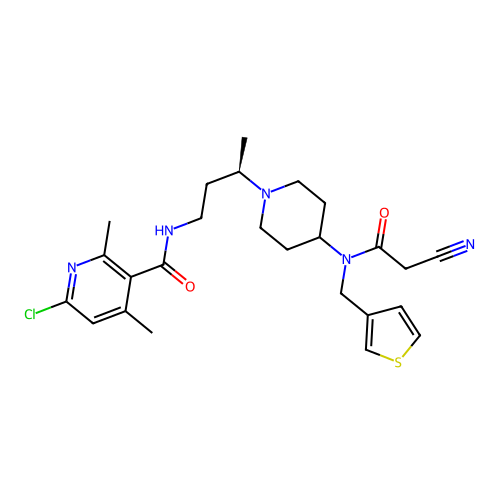

prediction: [0.01150791 0.98849213]
CC(C)N(Cc1ccc(Cl)c(Cl)c1)CC1CNC1


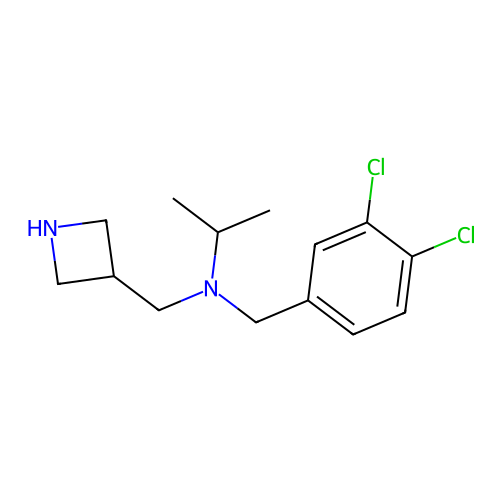

prediction: [0.01145886 0.9885411 ]
C[C@H](O)C(=O)NC1CC(C)(C)Oc2nc(-c3ccc(Cl)cc3Cl)c(-c3ccc(Cl)cc3)cc21


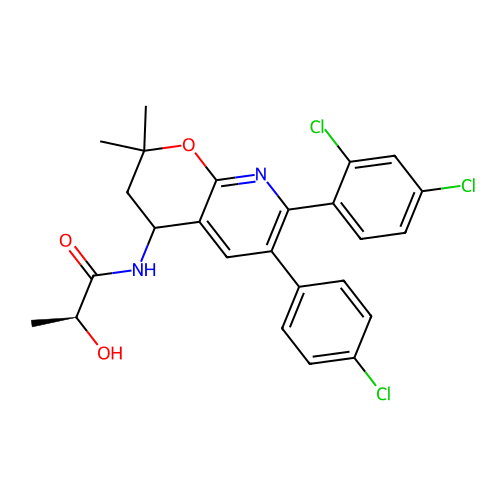

prediction: [0.01130312 0.98869693]
O=C1N(CCN2Cc3ccccc3C2)CCN1c1cccc(C(F)(F)F)c1


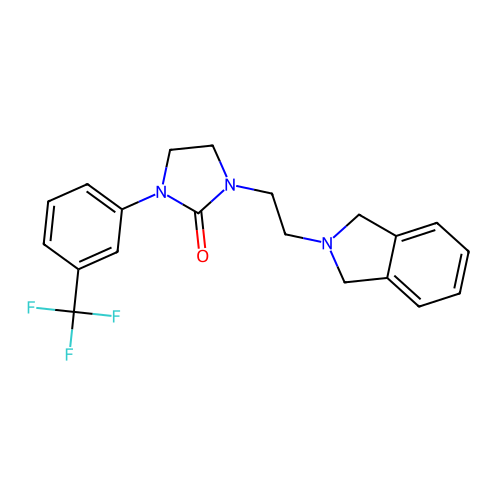

prediction: [0.01125462 0.9887454 ]
Cc1nnc(C(C)C)n1C1CCN(C(C)C[C@H](NC(=O)C2CC(F)(F)C2)c2ccccc2)CC1


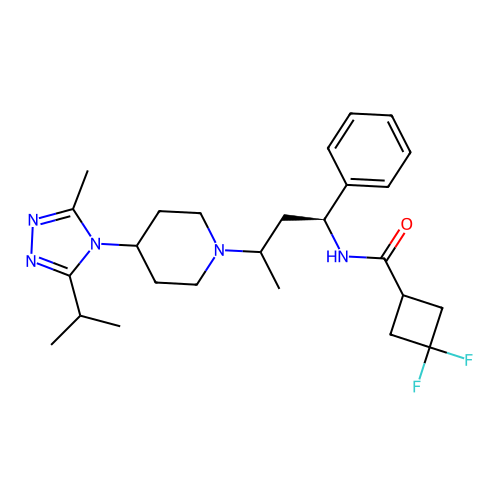

prediction: [0.01122078 0.9887792 ]
CC1(C)C=C(c2cc3c(cn2)Oc2ccc(-c4cccnc4F)cc2[C@@]32COC(N)=N2)CCO1


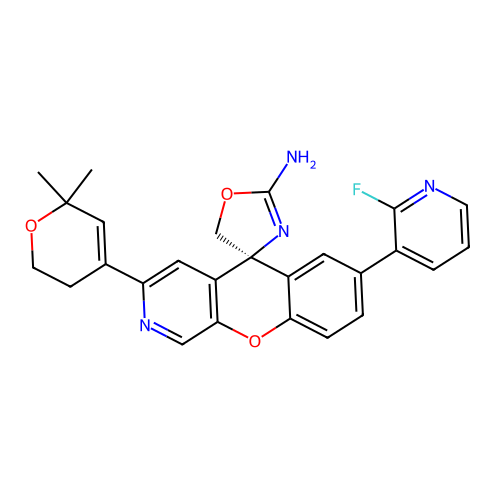

prediction: [0.01118454 0.9888154 ]
CCc1nc2cc3c(cc2s1)CCN(CCCSc1nnc(-c2ocnc2C)n1C)CC3


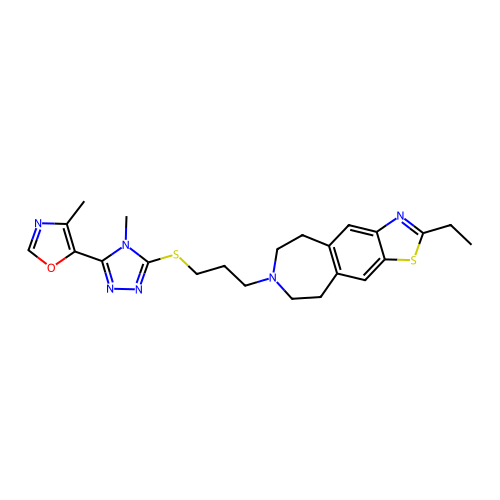

prediction: [0.01118347 0.9888165 ]
CN1C[C@@H]2C[C@H]1CN2c1ccc(-c2ccc3[nH]ccc3c2)nn1


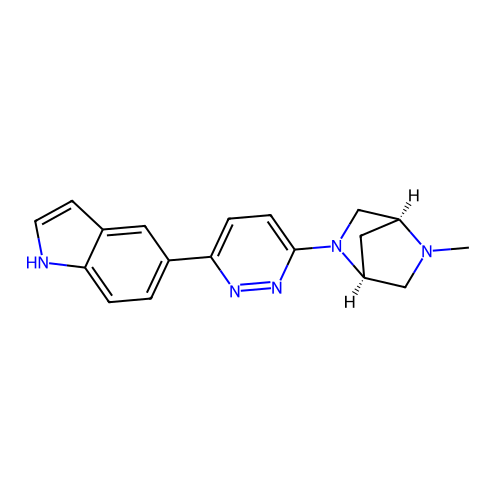

prediction: [0.01115367 0.98884636]
Cc1ccc2c(-c3nnc(SCCCN4CCc5c(Cl)cc6oc(C)nc6c5CC4)n3C)cccc2n1


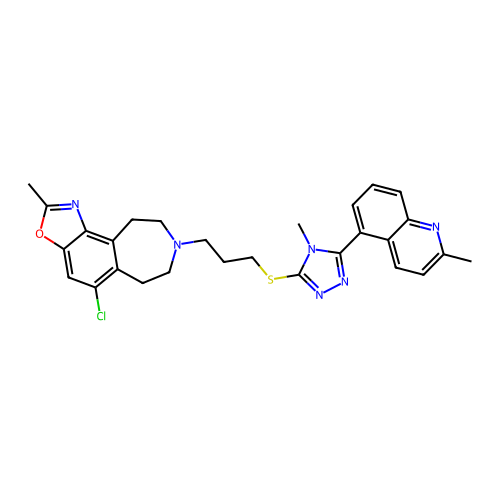

prediction: [0.01110736 0.9888926 ]
O=C([C@H]1CNCC[C@]1(O)c1ccc(F)c(F)c1)N(Cc1c[nH]c2cccc(Br)c12)C1CC1


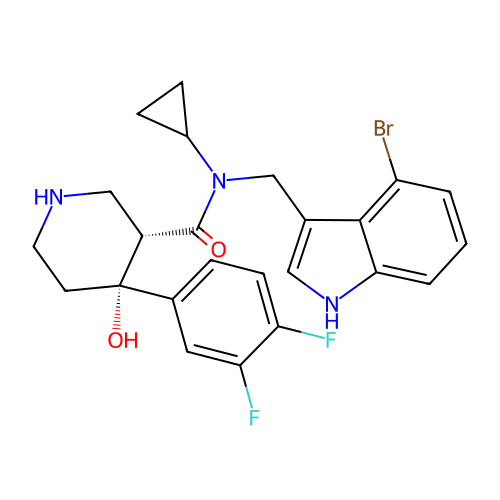

prediction: [0.01106847 0.98893154]
CC(C)N(CCC(=O)c1ccc2ccccc2c1)Cc1ccccc1


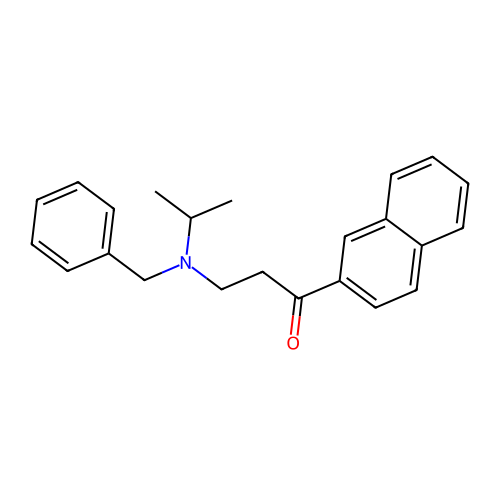

prediction: [0.01106582 0.9889341 ]
COCCCc1ccc(F)c2c(CN(C(=O)[C@H]3CNCC[C@]3(O)c3ccc(F)c(F)c3)C3CC3)cn(CCCOC)c12


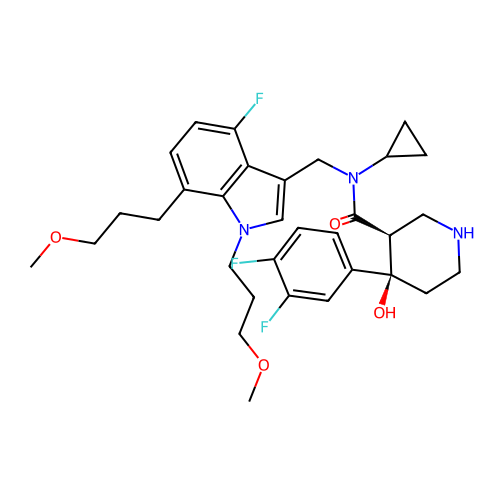

prediction: [0.0110593  0.98894066]
Cc1nc2ccc(Oc3ccc(F)cc3)cc2c(=O)n1C[C@H]1CCCN(C(C)C)C1


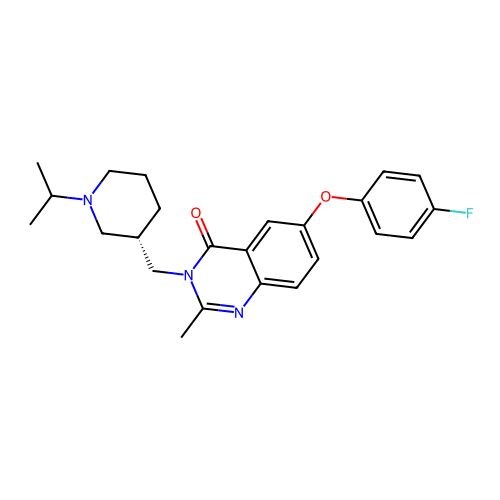

prediction: [0.01104312 0.98895687]
Fc1ccc(Cn2c([C@H]3CNCCS3)nc3ccccc32)cc1


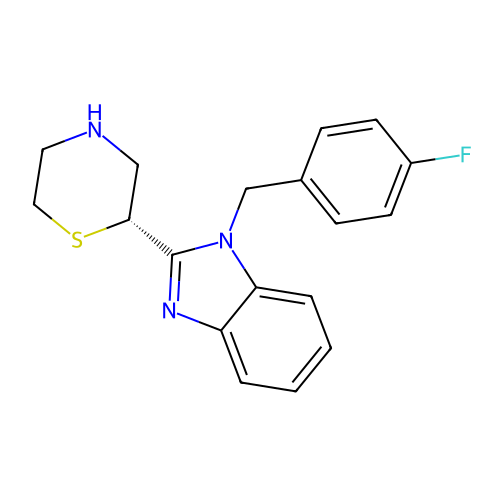

prediction: [0.01104115 0.98895884]
Cc1ncoc1-c1nnc(SCCCN2CC3CC3(c3ccc(Br)cc3)C2)n1C


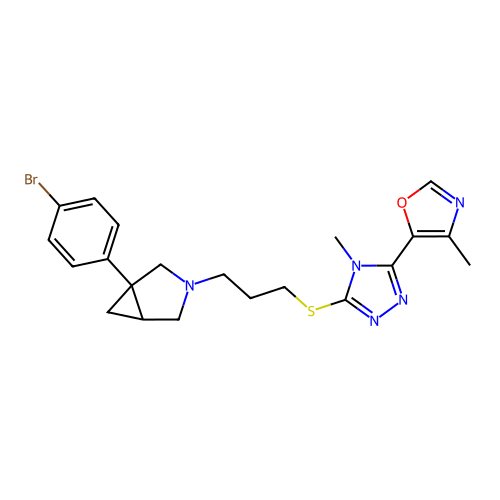

prediction: [0.01097422 0.9890258 ]
N#Cc1ccc(Cn2cncc2CN(CCN2CCNCC2)[C@H]2CCN(Cc3ccccc3)C2=O)cc1


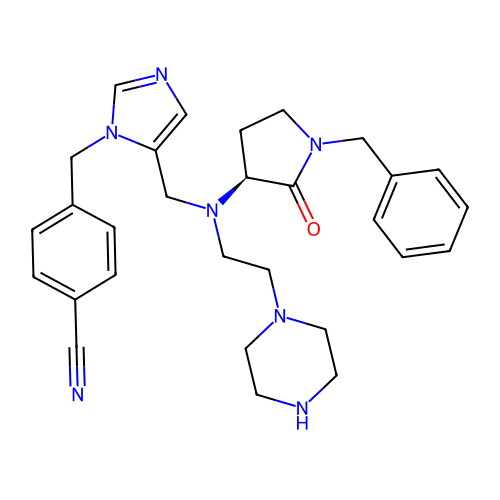

prediction: [0.01092993 0.98907006]
Fc1ccc2c(C3C[NH2+]CCC3F)c(-c3ccc4ccccc4c3)[nH]c2c1


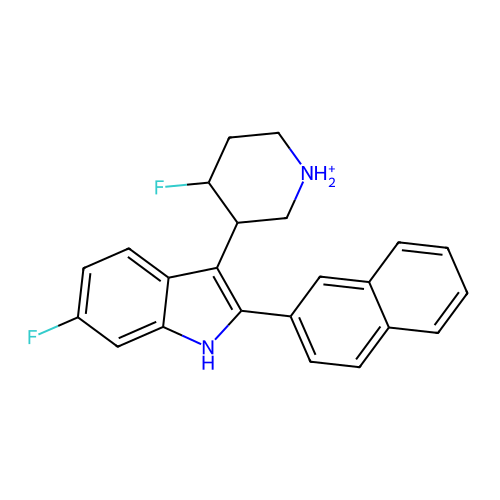

prediction: [0.01090654 0.9890934 ]
Cc1ccc(CCN(C)CCOc2ccc(C)cc2)cc1


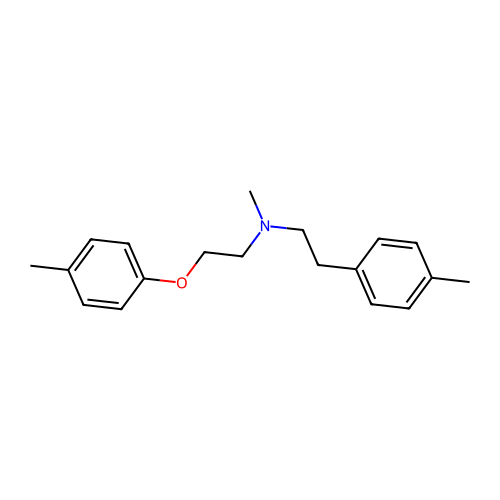

prediction: [0.0109028  0.98909724]
Nc1nc2c(s1)CC[C@H]2C(=O)Nc1ccc(C[C@@H]2CC[C@H]([C@H](O)c3cccc(Cl)c3)N2)cc1


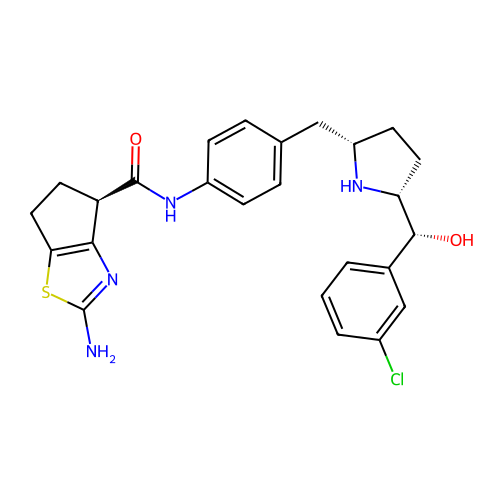

prediction: [0.01084818 0.98915184]
CC(=O)N1CC2CC1CN2CCc1ccc(Oc2nc3ncccc3s2)cc1


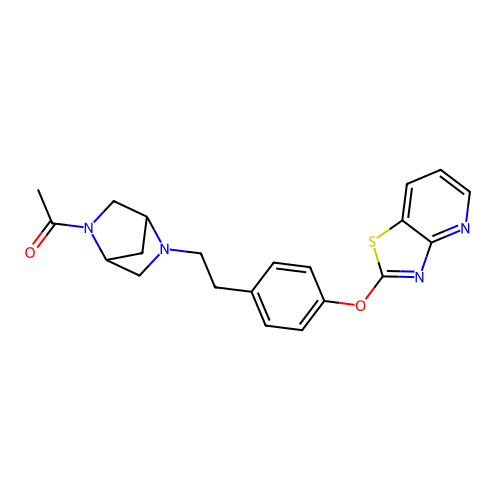

prediction: [0.01084444 0.9891556 ]
Cc1cnc(-c2nnc(SCCCN3CCc4ccc5oc(C(F)(F)F)nc5c4CC3)n2C)cn1


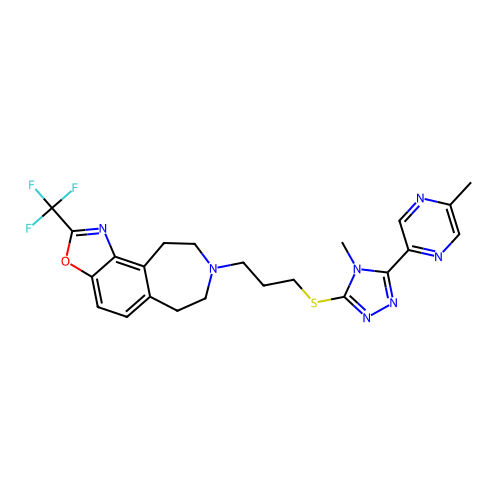

prediction: [0.01083928 0.9891607 ]
NC1=N[C@@]2(CO1)c1cc(-c3cccnc3F)ccc1Oc1cnc(-c3ccncc3)cc12


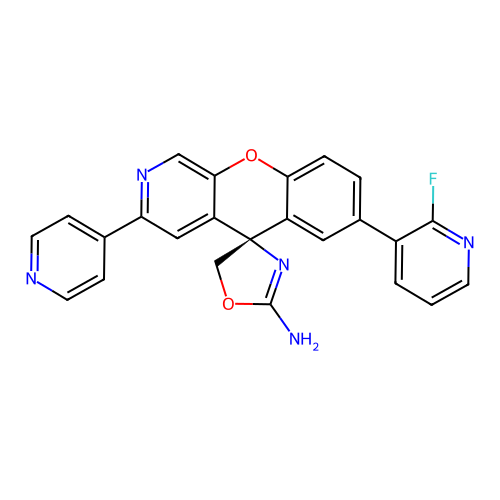

prediction: [0.01080101 0.989199  ]
COc1cc(CCN2CCN(CC(C)c3ccc4c(c3C)COC4=O)CC2)ccc1C#N


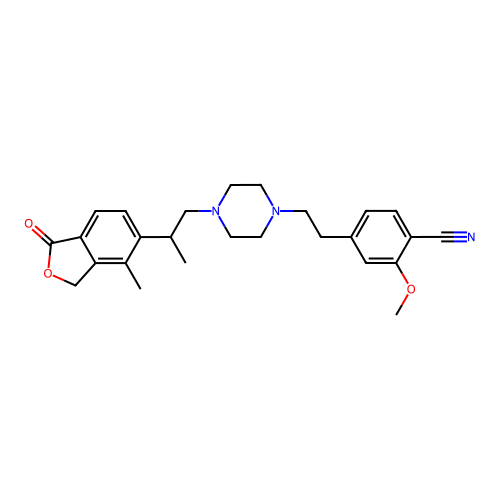

prediction: [0.0107797 0.9892203]
COC(=O)N(NC(=O)c1c(CN2CCN(C3CCCCC3)CC2)c(-c2ccccc2)nc2ccccc12)c1ccccc1


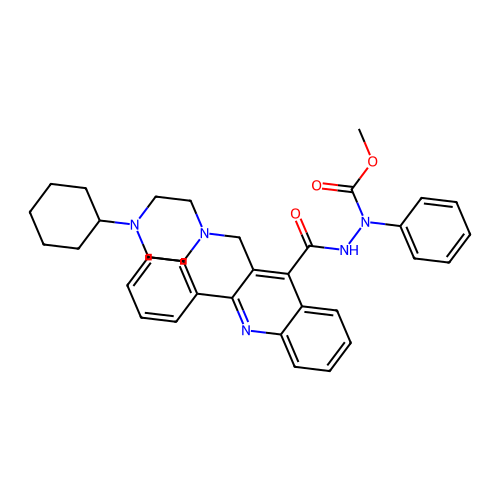

prediction: [0.01075739 0.9892426 ]
O=C([C@@H]1C[C@H]1c1ccc(C(F)(F)F)cc1)N1CCN(S(=O)(=O)c2cc(-c3cn[nH]n3)cc(C(F)(F)F)c2)CC1


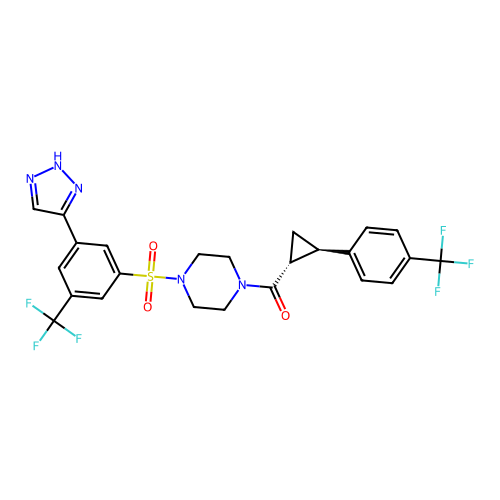

prediction: [0.01073751 0.9892625 ]
Cc1cc(O[C@H]2C[C@H]3CC[C@@H](C2)N3Cc2ccccc2)cc(C(N)=O)c1


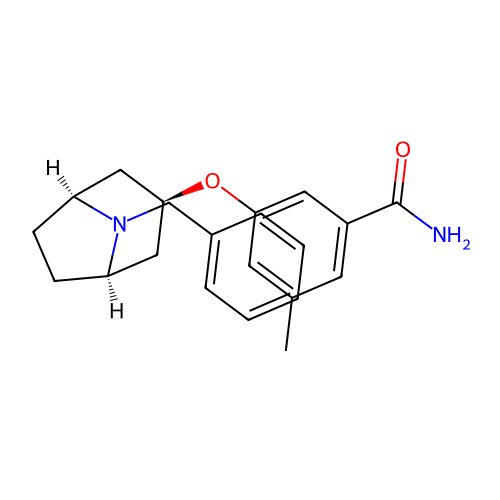

prediction: [0.01062304 0.989377  ]
COc1cc(F)ccc1-c1cncc(NC2CCCOC2)c1


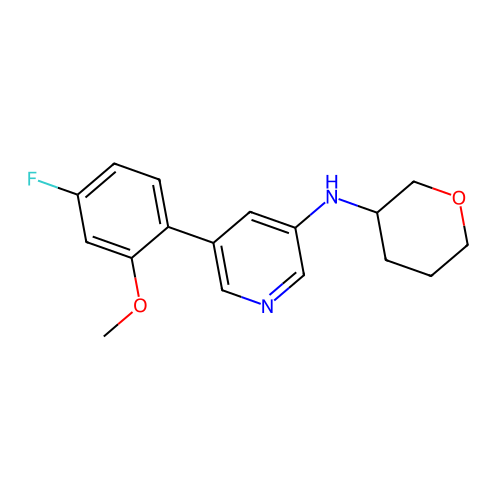

prediction: [0.01059362 0.9894064 ]
CNCc1cc(C(=O)NC)ccc1Oc1ccc(Cl)cc1C


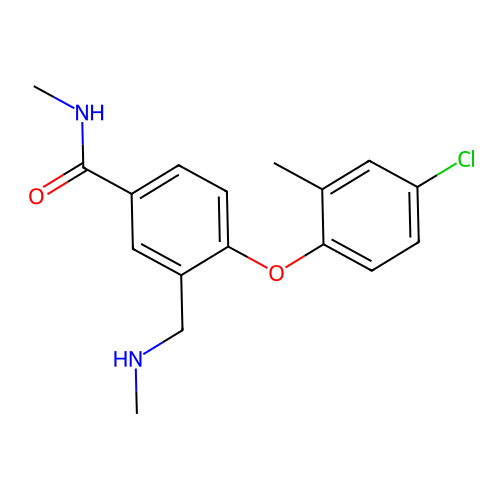

prediction: [0.01054141 0.98945856]
COCCCc1cc(CN(C(=O)[C@H]2CNCC[C@@H]2c2ccc(OCCOc3c(Cl)cc(C)cc3Cl)cc2)C2CC2)cc(OCC2(Cc3nn[nH]n3)CC2)c1


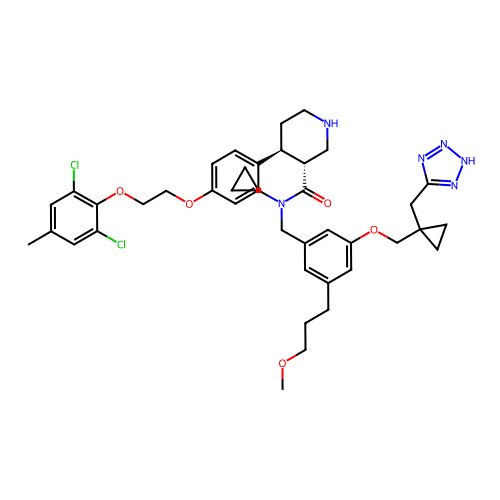

prediction: [0.01052582 0.98947424]
C[C@@H](c1ccc(F)cn1)c1c(CCN(C)C)sc2ccccc12


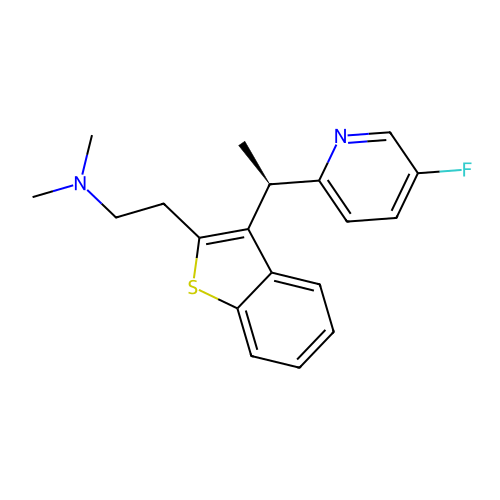

prediction: [0.01050546 0.9894945 ]
Cc1ncoc1-c1nnc(SCCCN2CC3CC3(c3ccccc3)C2)n1C


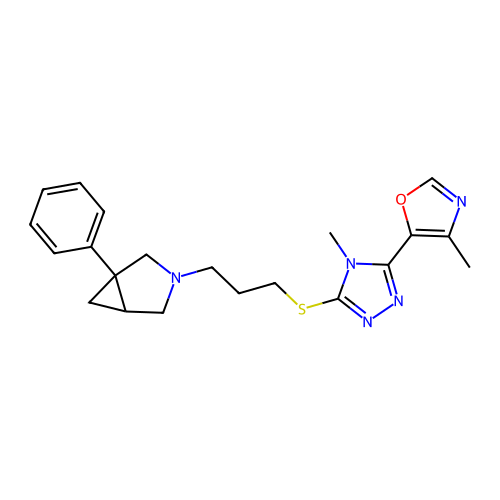

prediction: [0.0104612 0.9895387]
Cn1c(=O)c2c(nc(N3CCC[C@@H](N)C3)n2Cc2ccccc2Cl)c2ccc(C#N)cc21


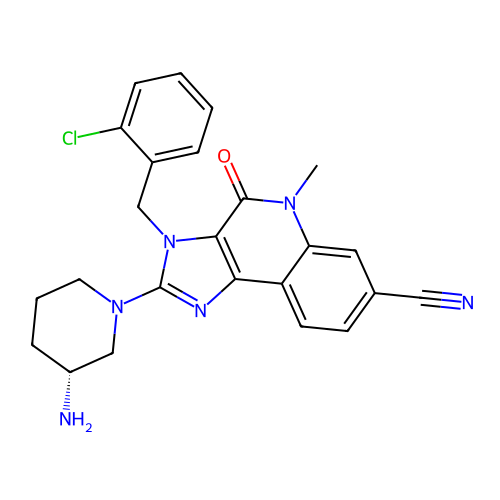

prediction: [0.01045852 0.9895415 ]
COCCc1ccc(Cl)c(CN(C(=O)[C@H]2CNCC[C@]2(O)c2ccc(F)c(F)c2)C2CC2)c1


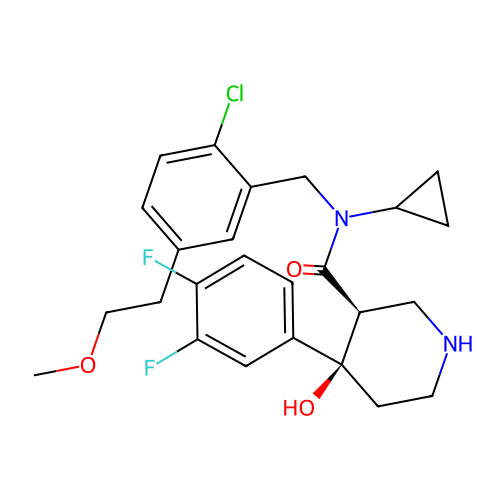

prediction: [0.01043239 0.9895676 ]
CC(=O)N1C[C@@H](Oc2cccc(F)c2)C[C@@H]1C(=O)N1CCCN(C2CCC2)CC1


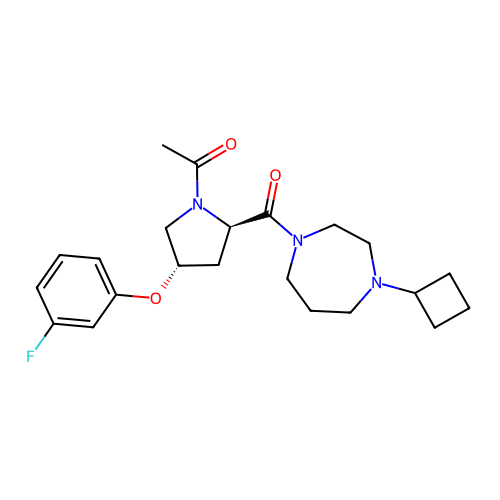

prediction: [0.01042134 0.98957866]
CCOc1cc(CN2CCC(Nc3nc4cc(S(=O)(=O)CC)ccc4o3)CC2)ccc1OC


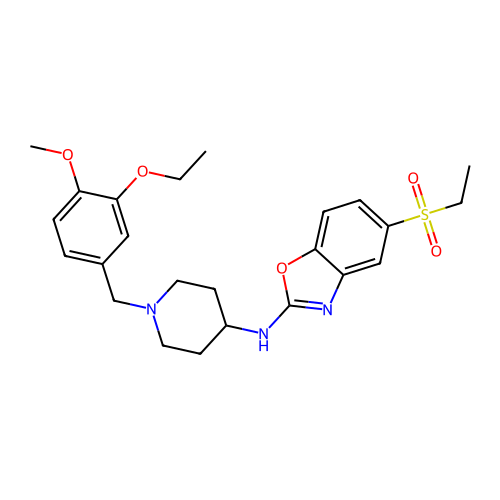

prediction: [0.01041991 0.9895801 ]
COc1cccc(N2CCN(CCCCCCN3CCN(c4cccc(OC)c4)CC3)CC2)c1


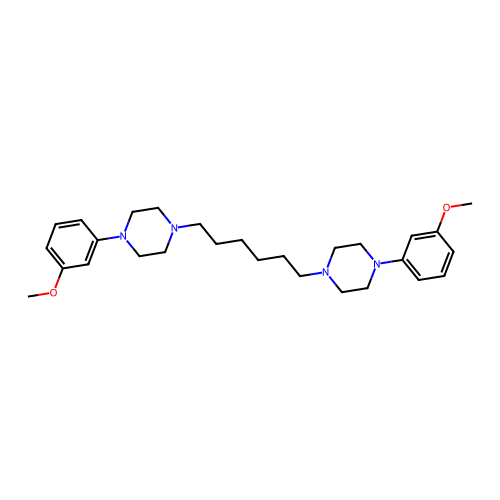

prediction: [0.01034698 0.98965305]
NC1=NC2(CO1)c1cc(NC(=O)c3ncc(Br)cn3)ccc1OCC21CC1


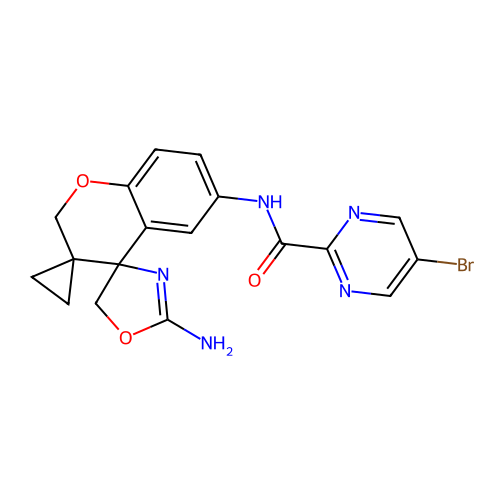

prediction: [0.01034557 0.9896544 ]
CC(=O)Nc1cccc(C2CCN(Cc3ccc(C(=O)c4nc5ccccc5n4-c4ccc(F)cc4)cc3)CC2)c1


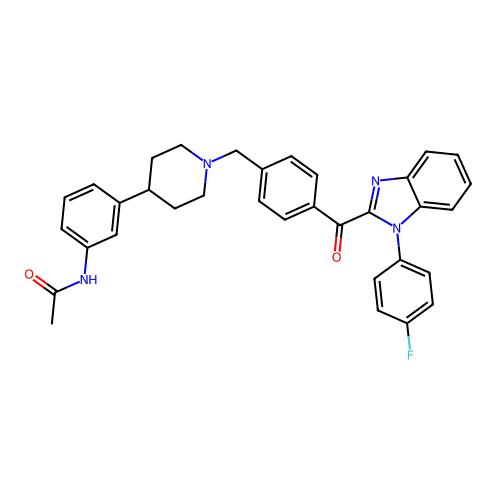

prediction: [0.01030615 0.98969394]
Cc1cc2[nH]c(C3CCN(CCn4c(=O)ccc5ncc(F)cc54)CC3)nc2cc1Cl


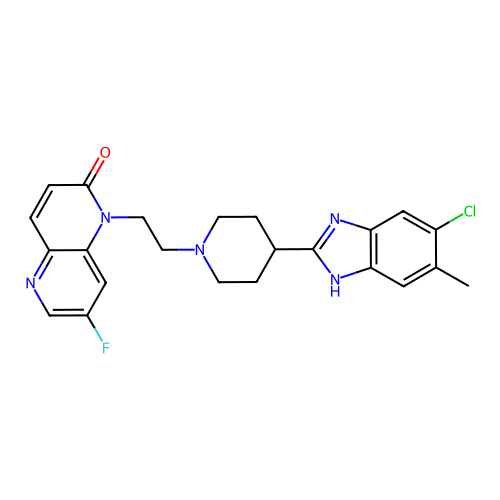

prediction: [0.0102859 0.9897141]
O=C1NCC(c2ccccc2)C12CCN(C1(c3ccccc3)CCCOC1)CC2


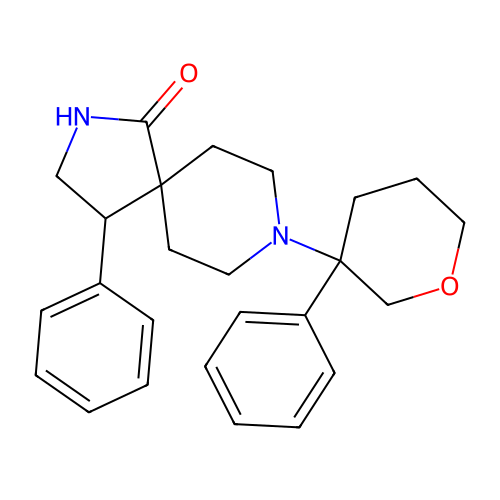

prediction: [0.01017528 0.9898247 ]
Cc1cc(Cn2cc(CN(C(=O)[C@H]3CNCC[C@]3(O)c3ccc(F)c(F)c3)C3CC3)c3c(F)cccc32)no1


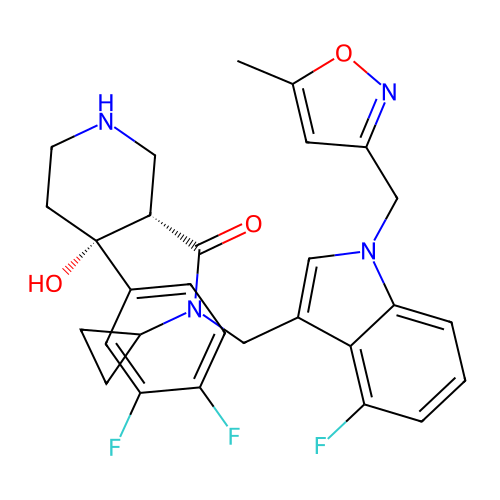

prediction: [0.01016576 0.9898343 ]
Cc1ncoc1-c1nnc(SCCCN2CC3CC3(c3cc(F)cc(C(F)(F)F)c3)C2)n1C


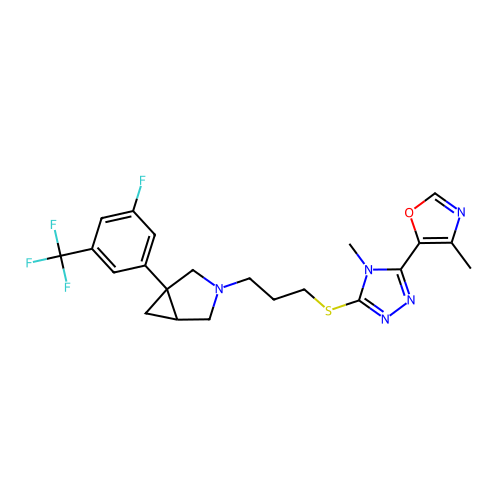

prediction: [0.01014122 0.9898588 ]
CCN1C[C@@H](N(Cc2cc(F)ccc2Cl)c2ccc(C#N)c(Cl)c2)CC1=O


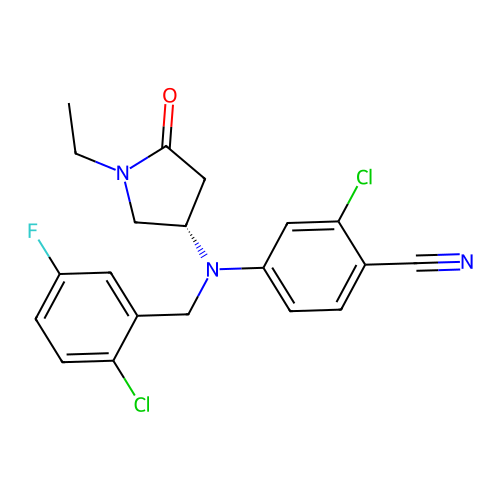

prediction: [0.01013413 0.98986584]
OC(c1cc(C(F)(F)F)nc2c(C(F)(F)F)cccc12)C1CCCCN1


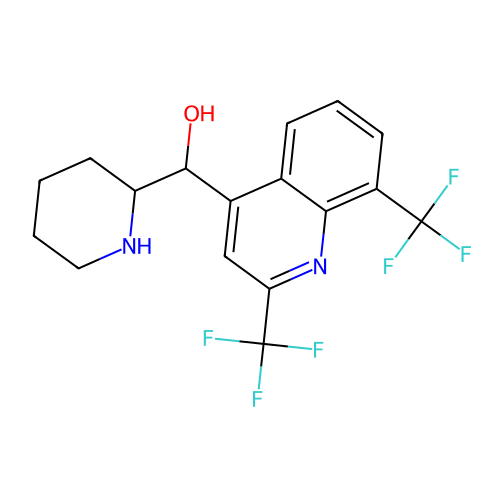

prediction: [0.01012405 0.989876  ]
CCN1CCN(c2cc3[nH]c(S[C@]4(C)CC[C@@H](c5nnc(C)o5)CC4)nc3cc2Cl)CC1


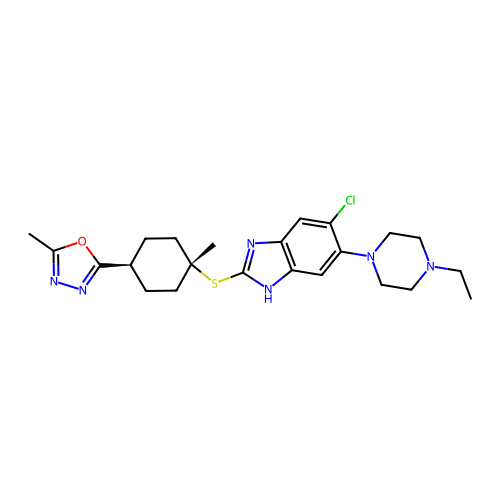

prediction: [0.01005933 0.9899407 ]
c1ccc(-c2c[nH]c([C@H]3Cc4c([nH]c5ccccc45)[C@@H](C4CCOCC4)N3)n2)cc1


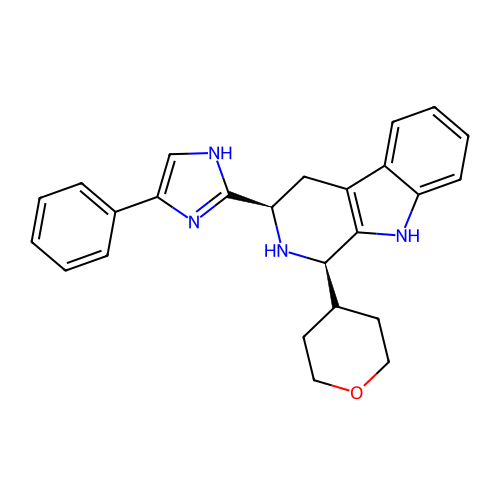

prediction: [0.00999458 0.99000543]
N#Cc1ccc(Cn2cncc2C[NH+](CC[NH+]2CCOCC2)C2CCN(Cc3cccc(Cl)c3)C2=O)cc1


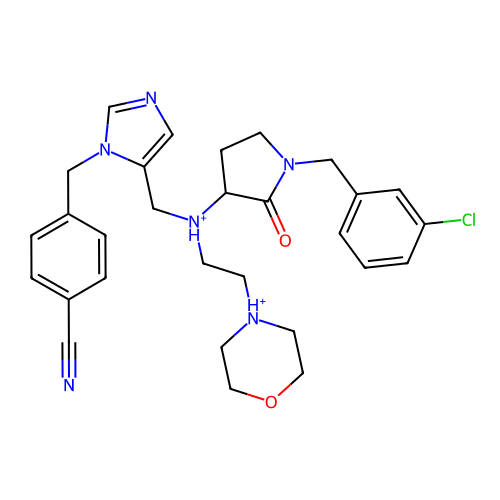

prediction: [0.00995128 0.99004877]
Cc1cc(C(NC(=O)[C@@H]2CC[C@@H](N3CCOCC3)C[C@H]2c2ccc(Br)cc2)c2ccc(Cl)cc2)ccn1


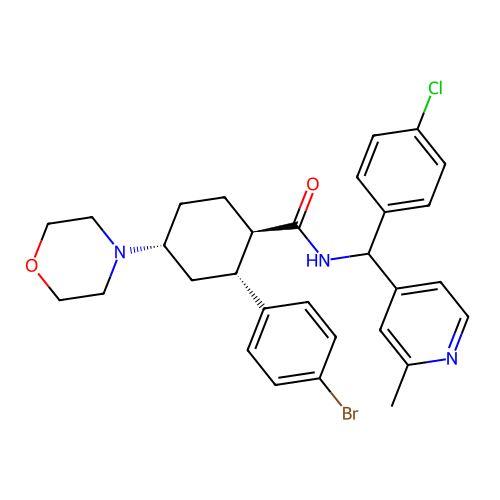

prediction: [0.00988337 0.99011666]
CC(C)(C)C(F)CN1CCC(CNC(=O)c2cc(Cl)cc(Cl)c2)CC1


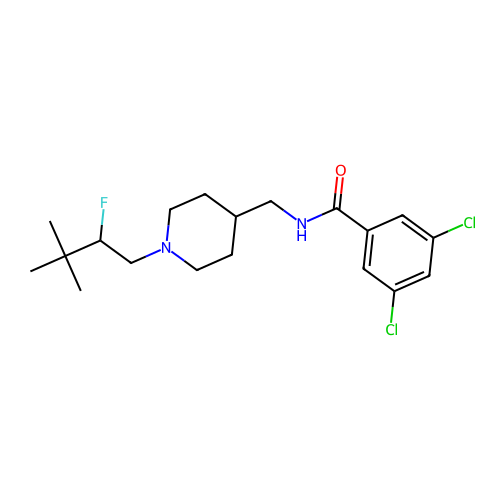

prediction: [0.00987543 0.9901246 ]
Cn1c(=O)n(Cc2nccc3ccccc23)c(=O)c2c1c(C#N)c(N1CCC[C@H](N)C1)n2Cc1ccccc1


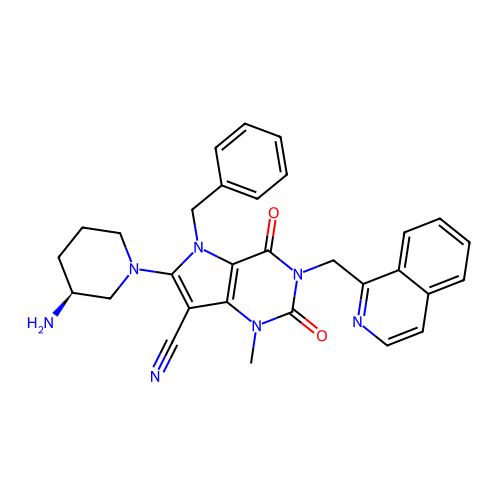

prediction: [0.0098553 0.9901447]
CCO[C@H]1COCC[C@H]1N[C@@H]1CC[C@@](C(=O)N2CCN(c3cc(C(F)(F)F)ccn3)CC2)(C(C)C)C1


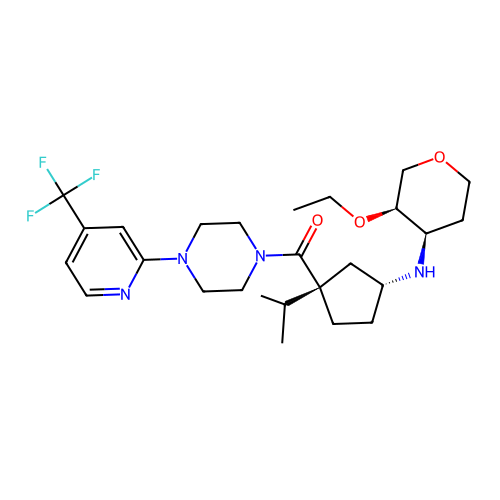

prediction: [0.00977092 0.9902291 ]
COCCCn1cc(CN(C(=O)[C@H]2CNCC[C@]2(O)c2ccc(F)c(F)c2)C2CC2)c2c(F)ccc(Cn3ccnc3)c21


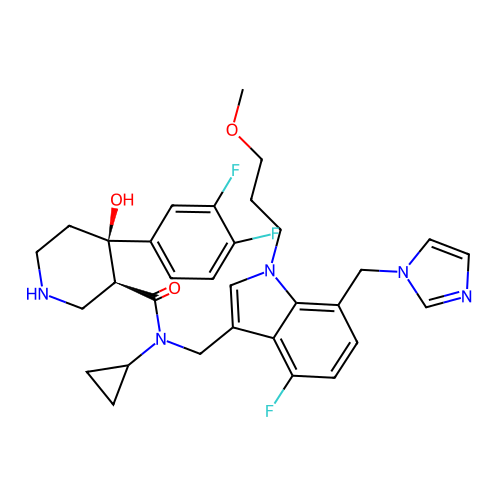

prediction: [0.00974412 0.9902559 ]
Nc1ccnc(Nc2ccc(Oc3ccc(Cl)cc3)cc2)c1


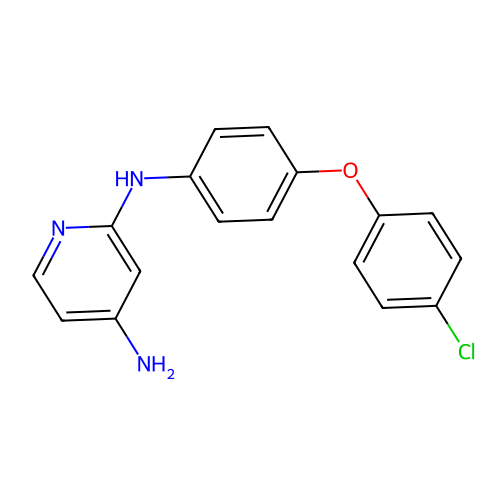

prediction: [0.00974278 0.99025726]
COc1cc(-c2cn(Cc3ccc(C(C)(C)C)cc3)nn2)ccc1-n1cnc(C)c1


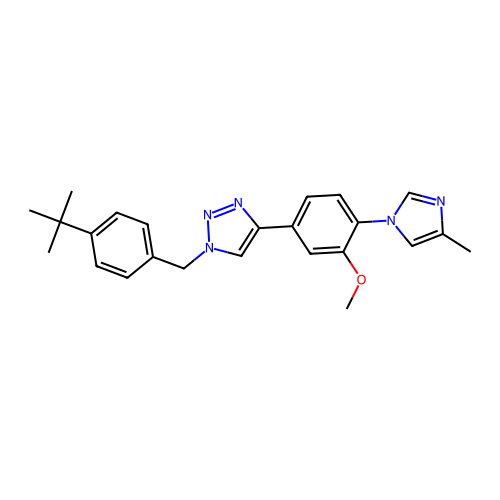

prediction: [0.00974231 0.99025774]
O=C(C1CC(Oc2ccc(F)cc2)CN1)N1CCCN(C2CCC2)CC1


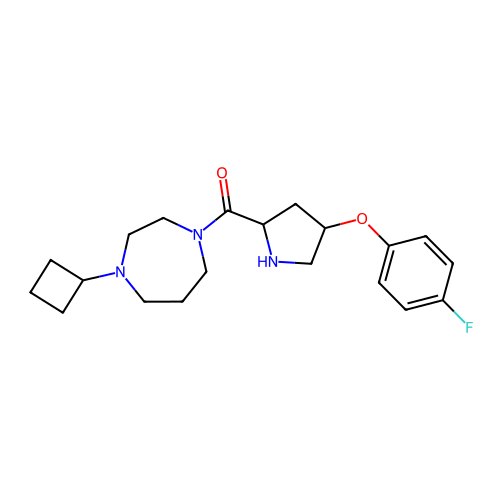

prediction: [0.0097085  0.99029154]
CCc1nc2cc3c(c(C)c2o1)CCN(CCCCSc1nnc(-c2cccc4nc(C)ccc24)n1C)CC3


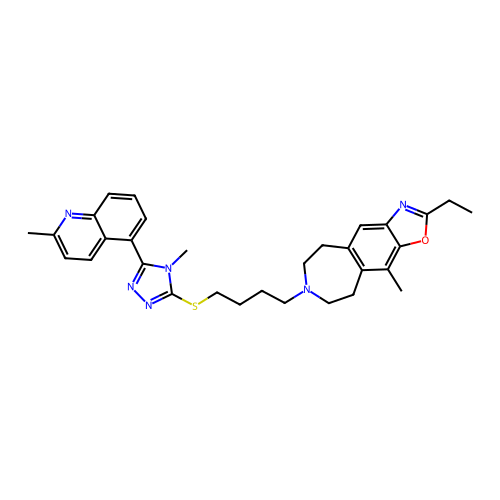

prediction: [0.00968336 0.9903167 ]
NC1=NC(c2ccncc2)(c2cccc(-c3cncc(F)c3)c2)c2cccc(F)c21


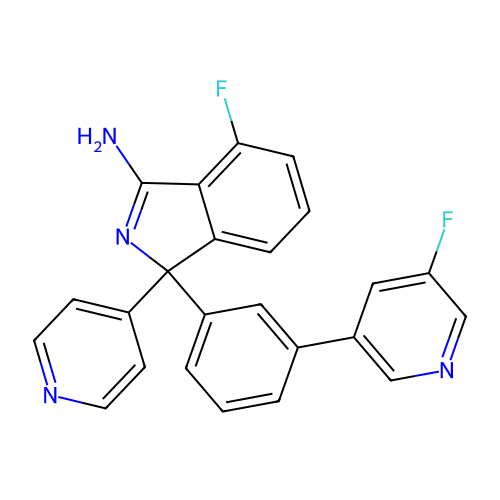

prediction: [0.00968166 0.9903183 ]
CCc1nn(CCOCC(F)(F)F)c2c(Nc3ccncn3)nc(N3CCN[C@H](C)C3)nc12


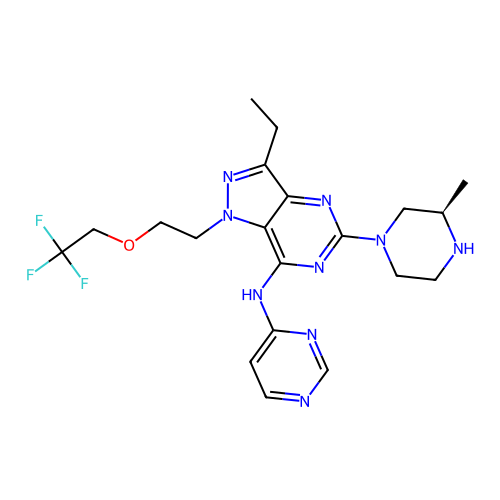

prediction: [0.00967491 0.9903251 ]
COc1ccc(COc2ccn(-c3ccc(OCCN4CCCC4)cc3)c(=O)c2)cc1


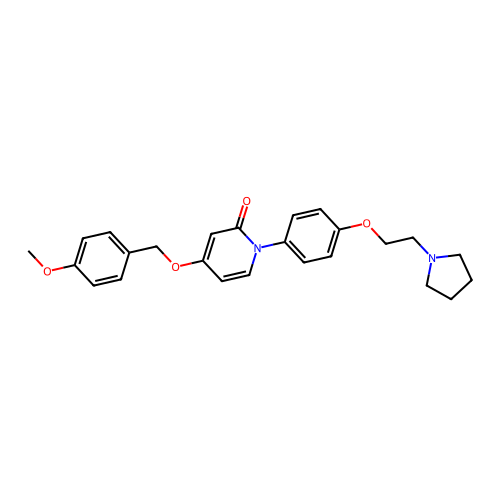

prediction: [0.00967009 0.99032986]
CC1(C)C[C@@H](CN2CCC(F)(CNC(=O)c3cc(Cl)cc(Cl)c3)CC2)CCO1


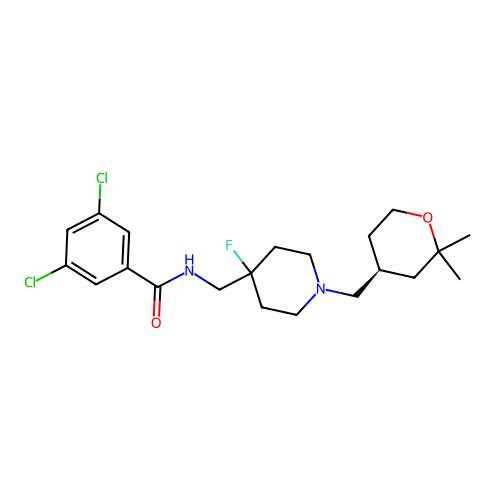

prediction: [0.00965819 0.9903418 ]
COc1ccc(C23CC2CN(CCCSc2nnc(-c4ocnc4C)n2C)C3)cc1C(F)(F)F


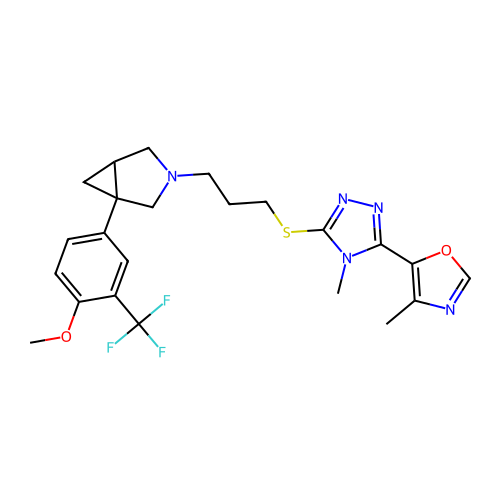

prediction: [0.00964539 0.99035466]
Cc1cc(-c2c(Cl)cc(Cl)cc2OCCCC(F)(F)F)nc(N)n1


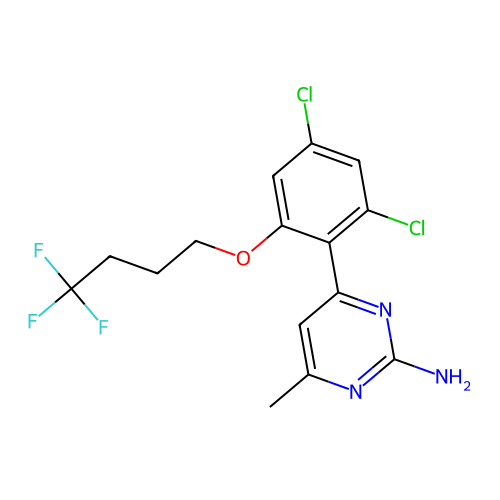

prediction: [0.00960727 0.9903928 ]
CCN(CC)C(C)CCCNc1nccc(NCc2ccc(Cl)cc2Cl)n1


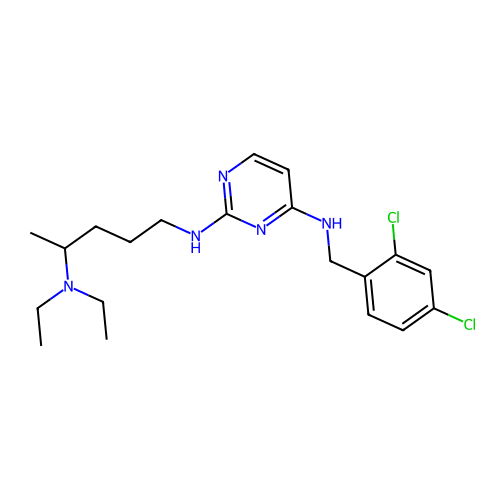

prediction: [0.00955408 0.99044585]
C[C@@H](OC1CCC2NC1(c1ccccc1)CC2c1nnn(C)n1)c1cc(C(F)(F)F)cc(C(F)(F)F)c1


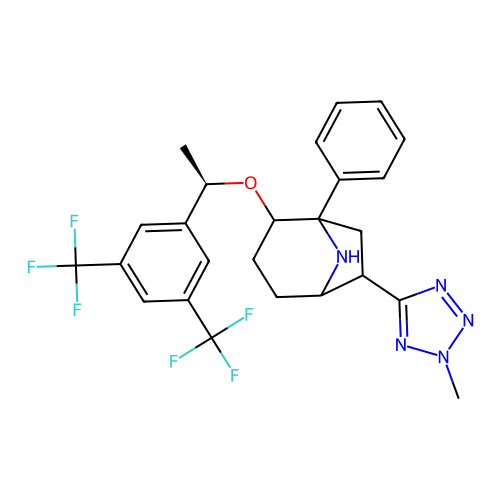

prediction: [0.00954056 0.99045944]
CN1C[C@H]2C[C@@H](N(Cc3cccc(OC(F)(F)F)c3)C(=O)c3cn(C)cn3)C[C@H]2C1


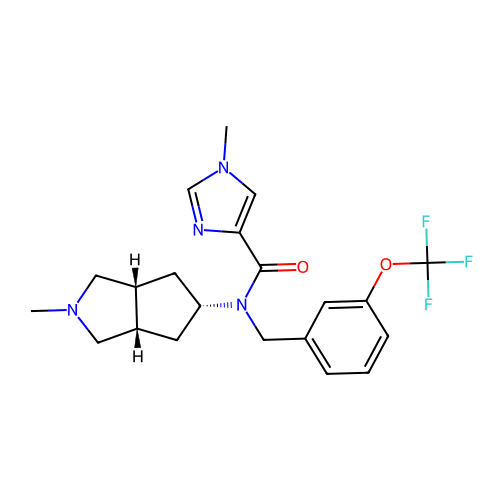

prediction: [0.00950243 0.9904975 ]
Cc1cccc(N=C(NC#N)c2ccc(-c3ccc(Cl)cc3)o2)c1


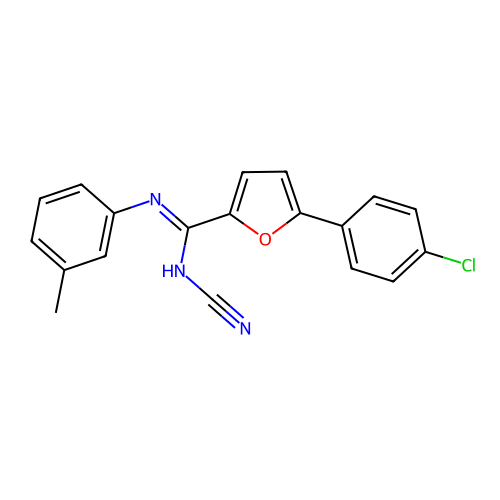

prediction: [0.00946087 0.9905391 ]
Cc1ncoc1-c1nnc(SCCCN2[C@@H]3CC[C@H]2C[C@@H](c2ccc(C(F)(F)F)cc2)C3)n1C


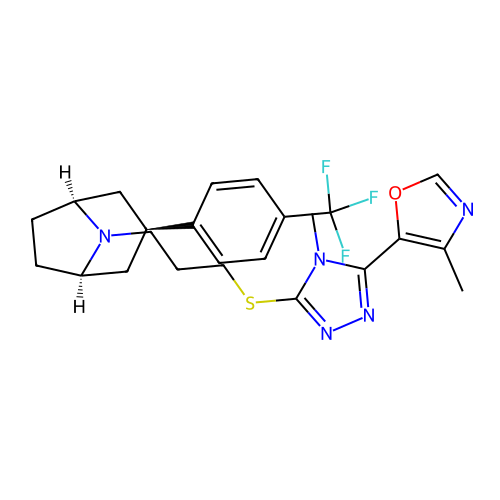

prediction: [0.0094308  0.99056923]
CCN1C[C@H]2C[C@@H](N(Cc3cccc(OC(F)(F)F)c3)C(=O)c3cn(C)cn3)C[C@H]2C1


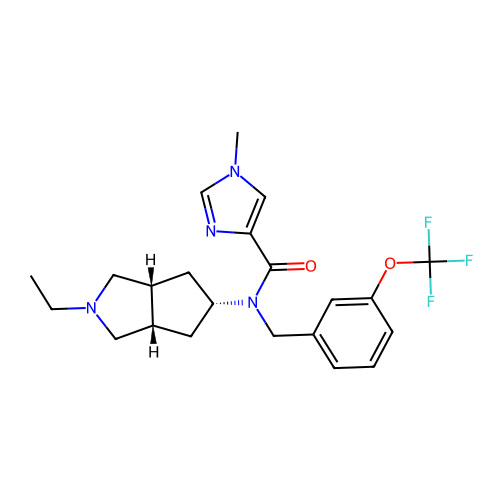

prediction: [0.00939826 0.9906018 ]
CCN(CC)C(=O)CN1CCCC(c2nc3ccccc3n2Cc2ccc(F)cc2)C1


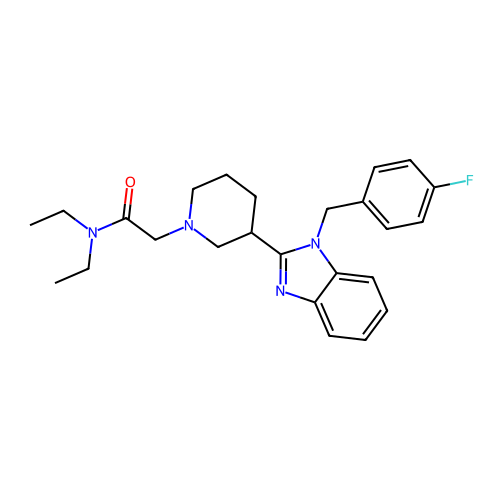

prediction: [0.00936666 0.99063337]
OCC1(N2CCN(C3CCc4ccc(OCc5noc(-c6ccc(Cl)cc6)n5)cc43)CC2)CCCC1


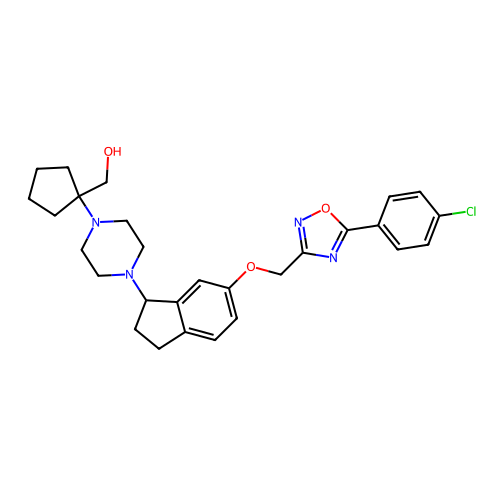

prediction: [0.00929432 0.99070567]
CCCOCCn1c(=O)c(N2CCN(CC)CC2)nc2cnc(-c3ccc(OC)nc3)cc21


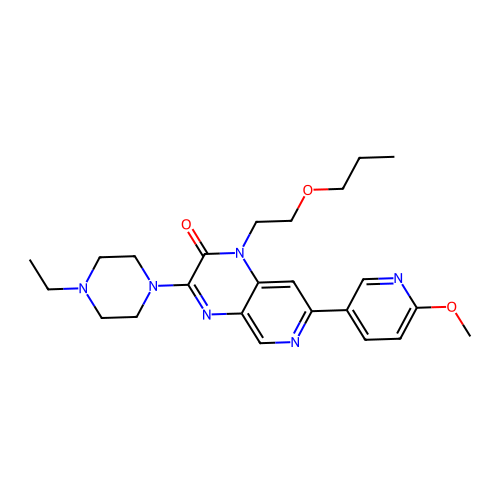

prediction: [0.00929197 0.990708  ]
COc1ccc([C@H]2CN(CCCN(C)S(C)(=O)=O)C[C@@H]2CC(=O)Nc2cccc(Cl)c2)cc1


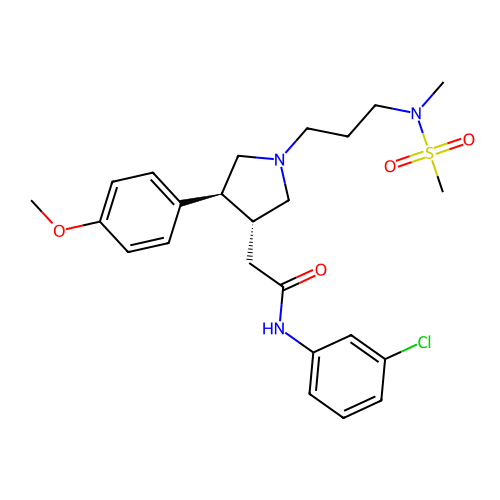

prediction: [0.00928271 0.99071723]
Cc1cc(OCCN2CCOCC2)nn1-c1ccc2ccccc2c1


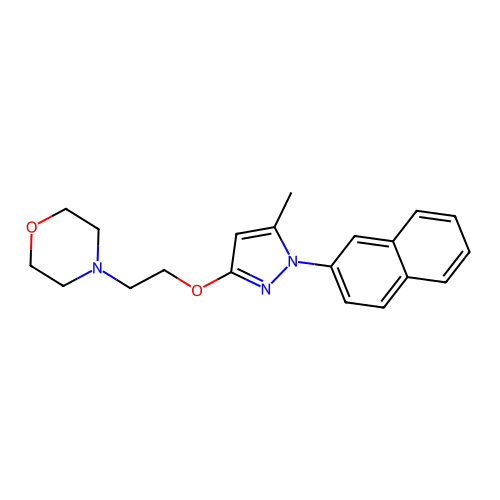

prediction: [0.00927734 0.99072266]
Cc1cccc(N/C(=N/C#N)c2ccc(-c3ccc(Cl)cc3)o2)c1


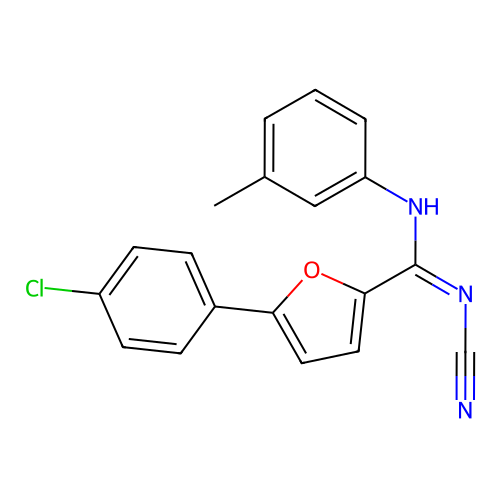

prediction: [0.00925544 0.99074453]
NC(=O)c1cccc(O[C@@H]2C[C@H]3CC[C@@H](C2)N3CC2CC2)c1


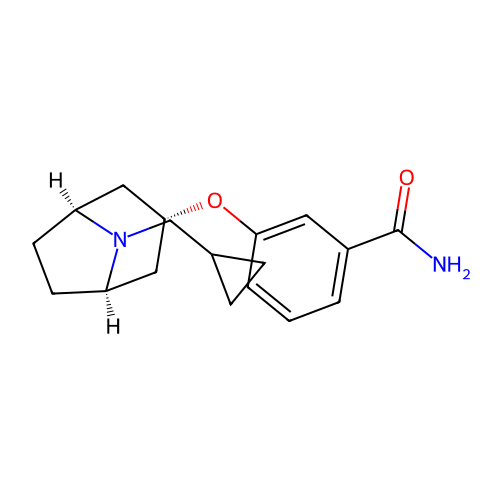

prediction: [0.00925176 0.9907482 ]
Cc1cnn(C2CCN(c3nc4ccccc4n3Cc3ccc(F)cc3)CC2)c1


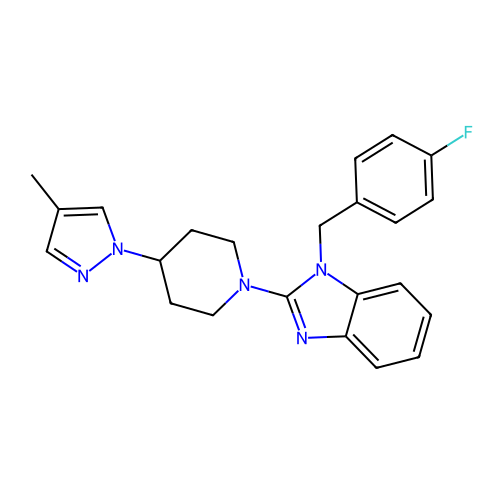

prediction: [0.00922242 0.9907776 ]
CCCCCCCN(CC)CC#Cc1ccc(Cl)cc1


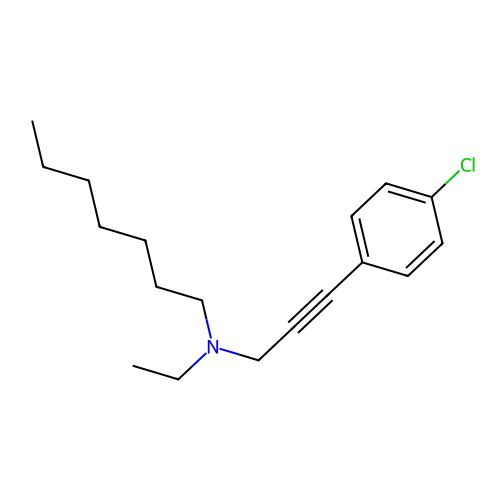

prediction: [0.00922097 0.99077904]
Cc1cc(C(F)(F)F)ccc1C12CC1CN(CCCSc1nnc(-c3ocnc3C)n1C)C2


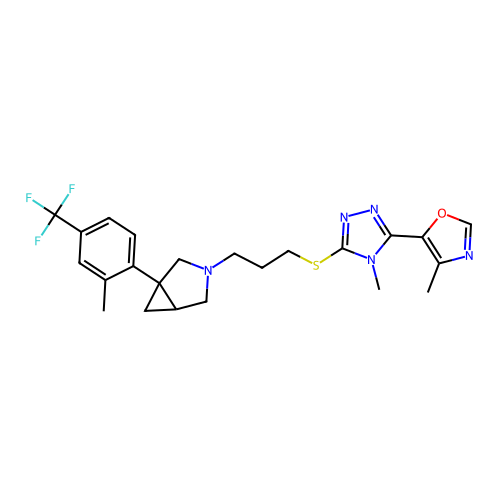

prediction: [0.00920814 0.9907919 ]
CC(C)CN(CCc1ccc(Cl)c(Cl)c1)C[C@H](O)COc1ccc(NS(C)(=O)=O)cc1


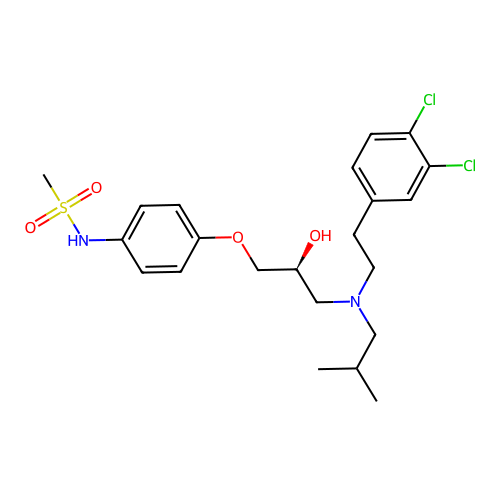

prediction: [0.00919342 0.9908065 ]
CC1(C)C2=C3C=C4C5=[N+](CCC4OC3CCN2c2ccc(CCC(=O)NCCCCCCN(CCOc3ccc(NS(C)(=O)=O)cc3)CCc3ccc(NS(C)(=O)=O)cc3)cc21)c1ccc(S(=O)(=O)[O-])cc1C5(C)C


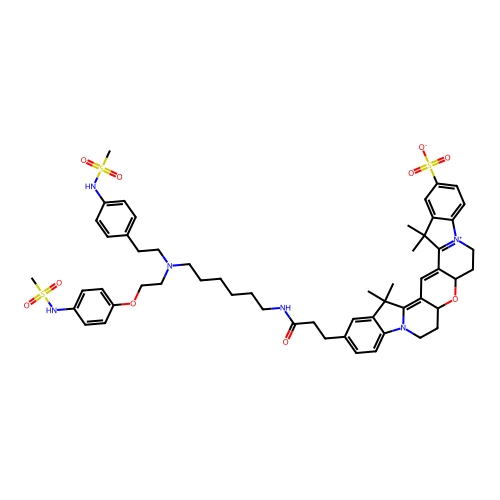

prediction: [0.00916929 0.9908308 ]
CN(C)CCC1=C(Cc2cnccn2)c2ccc(F)cc2C1


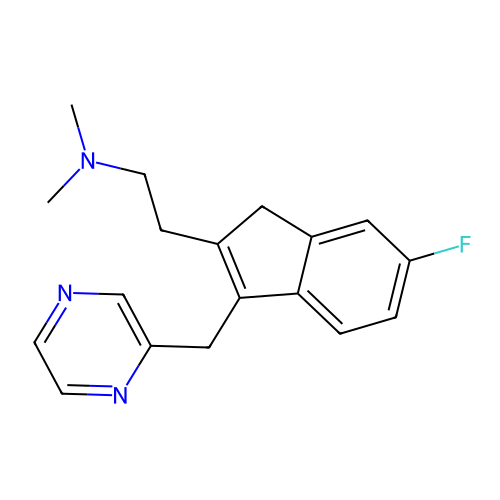

prediction: [0.00914493 0.9908551 ]
O[C@@H](COc1ccc(F)cc1)CN1CCN(Cc2ccc(Cl)c(Cl)c2)CC1


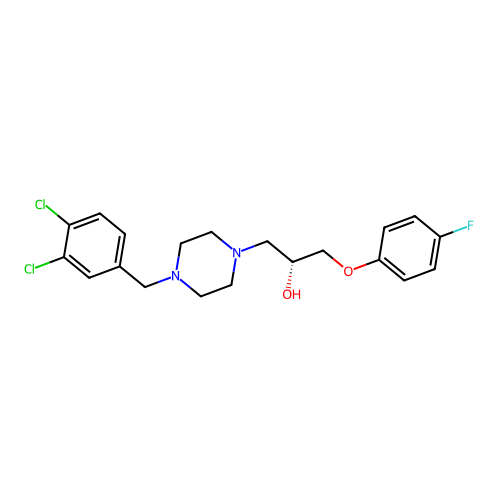

prediction: [0.00913326 0.99086666]
O[C@]1(c2ccc(F)c(F)c2)CCNC[C@@H]1c1onc(-c2cccc3ccccc23)c1Br


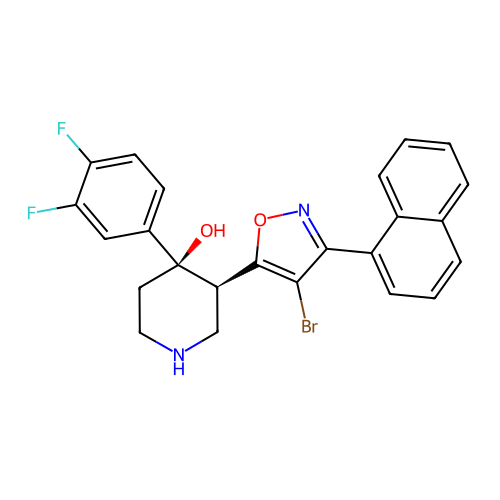

prediction: [0.00910338 0.99089664]
CC(=O)N1CC2CN(CCc3ccc(Oc4nc5ncccc5s4)cc3)CC2C1


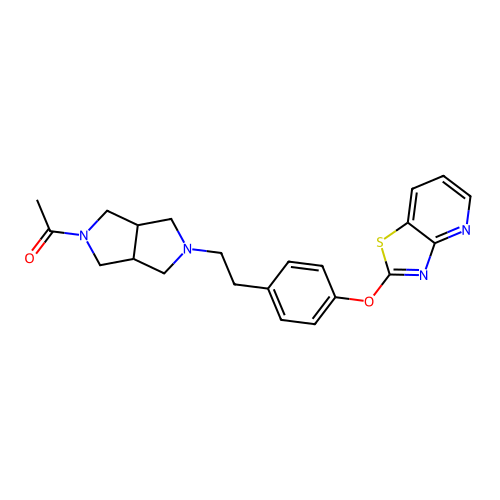

prediction: [0.00910315 0.9908969 ]
COc1cc(/C=C/c2nc3sc4c(c3c(=O)[nH]2)CCC4)ccc1-n1cnc(C)c1


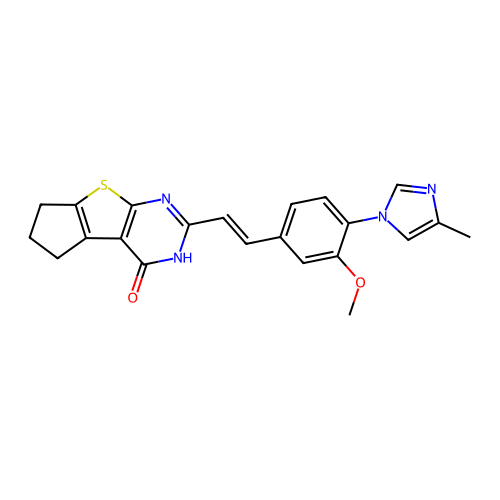

prediction: [0.00907921 0.9909208 ]
CCCCC1=NC2(CCCC2)C(=O)N1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1


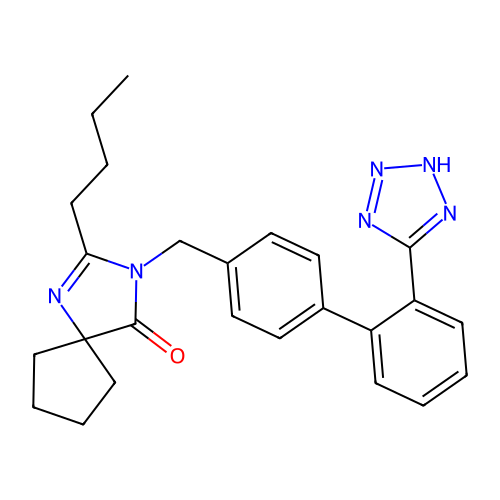

prediction: [0.00903866 0.9909614 ]
COc1cccc([C@@H](C)N[C@@H]2CC[C@@H](C(=O)N3CCC(C(=O)N4CCCC4)(c4ccccc4)CC3)C(C)(C)C2)c1


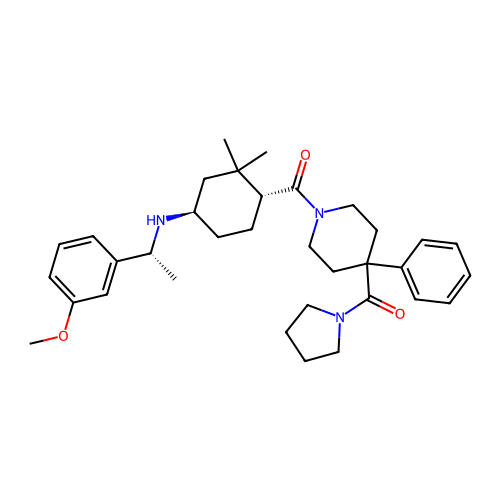

prediction: [0.00898591 0.99101406]
Cc1cccc(C)c1C(=O)N1CCC(N2CCC(N(Cc3ccccc3)C(=O)C3CCC3)CC2)CC1


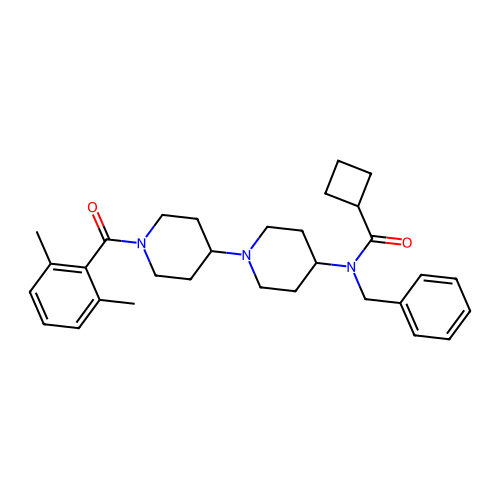

prediction: [0.00898206 0.99101794]
CN1C[C@@H]2C[C@H]1CN2c1ncc(-c2cccc3[nH]ccc23)cn1


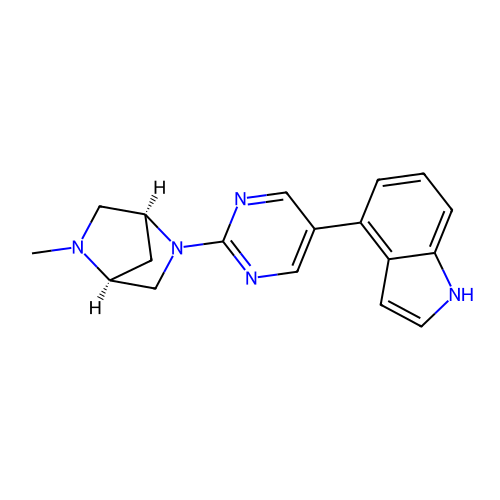

prediction: [0.00897451 0.9910255 ]
COC(=O)c1ccc(Sc2ccc(NC(=O)c3ccc(C(=N)N(C)C)cc3)c(C(=O)Nc3ccc(Cl)cn3)c2)cc1


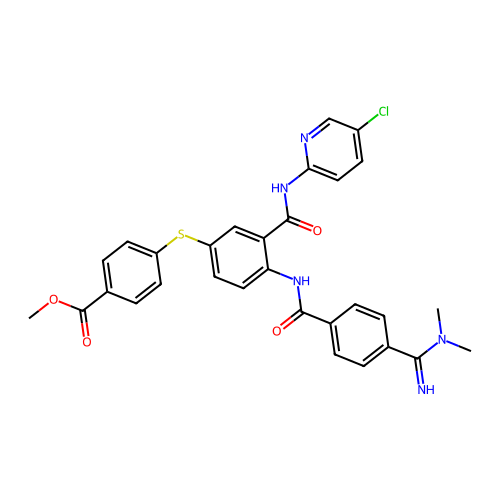

prediction: [0.00895841 0.9910416 ]
Cc1nc(-c2ccc(C(F)(F)F)cc2)nc(OCCCN2CCCCC2)c1Cl


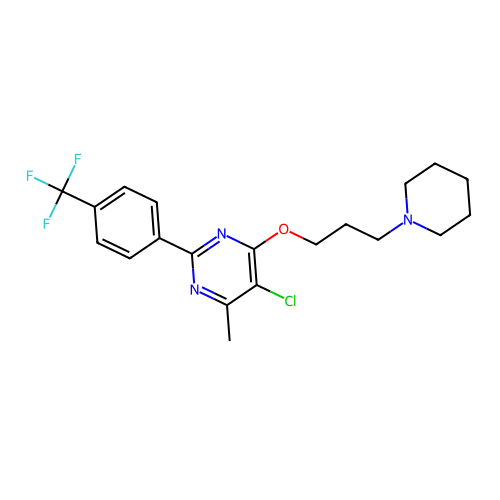

prediction: [0.00895609 0.9910439 ]
CN1[C@@H]2CC[C@H]1C[C@@H](OC(c1ccccc1)c1ccccc1N)C2


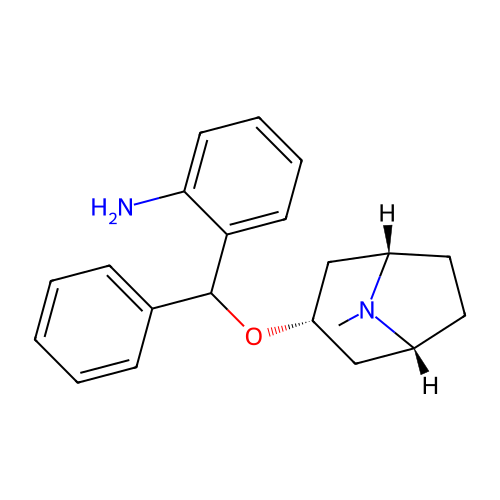

prediction: [0.00892849 0.9910715 ]
Clc1cccc(OC(c2cccnc2)[C@@H]2CCCNC2)c1Cl


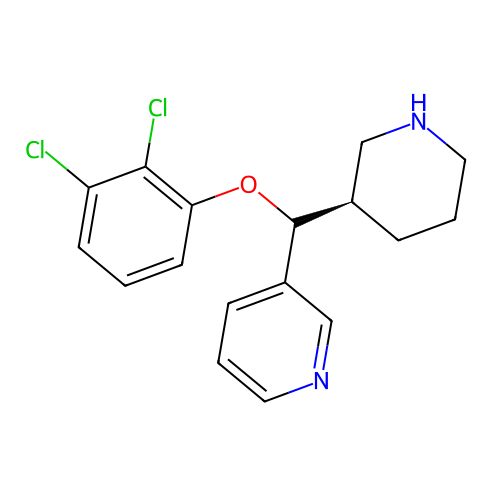

prediction: [0.00890586 0.9910942 ]
CN(C)Cc1cc(OCCCN2CCCCC2)ccc1Nc1ncnc2ccccc12


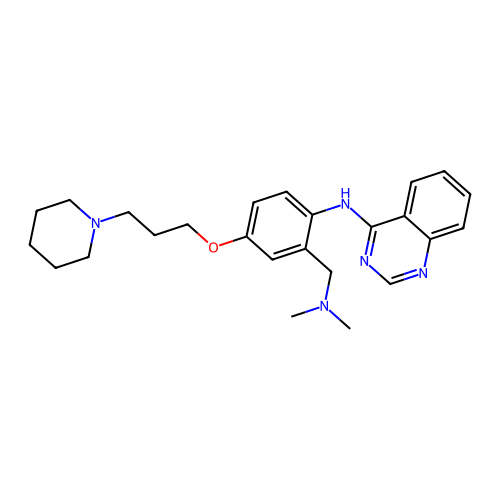

prediction: [0.00885246 0.9911476 ]
O=C(NC1CCc2ccc(CCN3CCN(c4nsc5ccccc45)CC3)cc21)c1ccco1


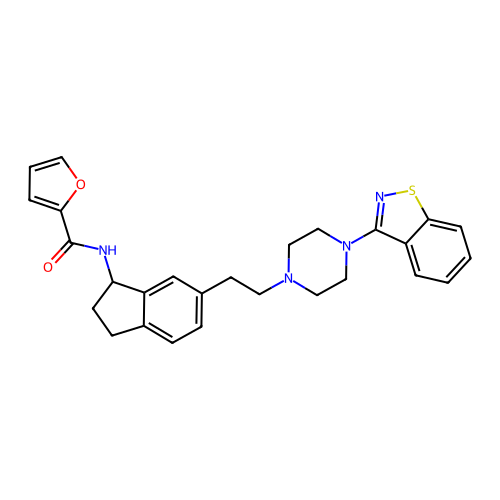

prediction: [0.00880986 0.9911902 ]
Fc1ccccc1Cn1ccc2c(OC3CCN(Cc4cscn4)CC3)ncnc21


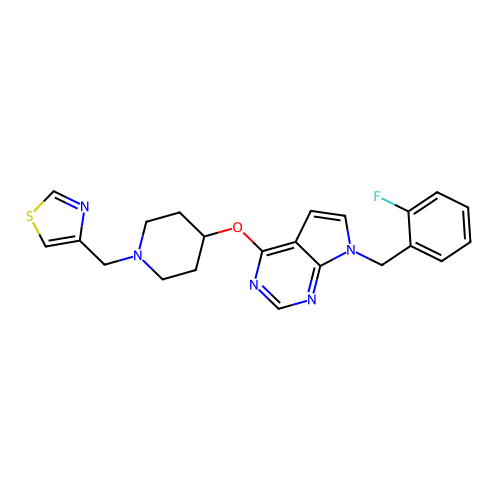

prediction: [0.00879871 0.9912013 ]
c1ccc(C2=Nc3ccccc3C2C2CCN(c3ccccc3)CC2)cc1


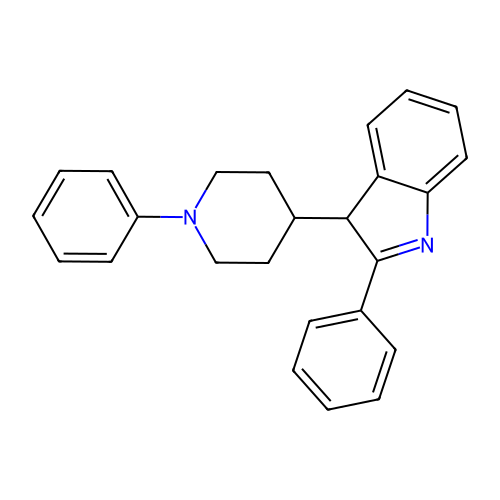

prediction: [0.00874892 0.9912511 ]
COc1ccccc1N1CCN(CCCCNC(=O)c2ccc3ccccc3c2)CC1


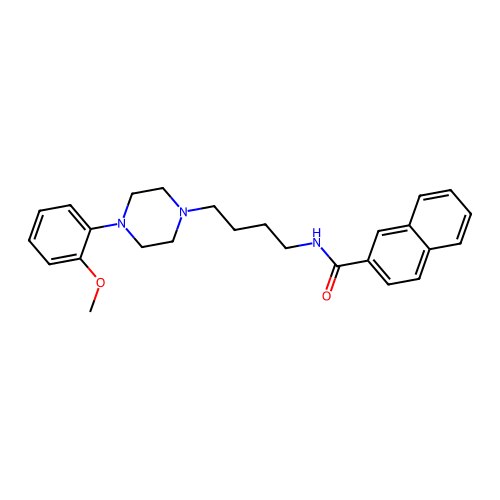

prediction: [0.00874326 0.9912567 ]
NC1=NC2(CO1)c1cc(-c3cncc(OCC(F)F)c3)ccc1OCC21CC1


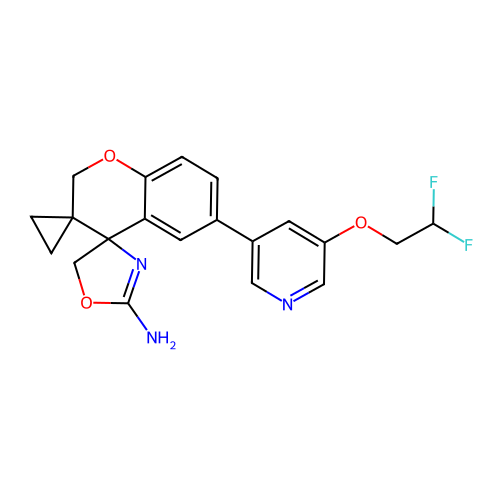

prediction: [0.00872514 0.99127483]
O=c1cc(OCc2ccccc2)ccn1-c1ccc2c(cnn2CCN2CCNCC2)c1


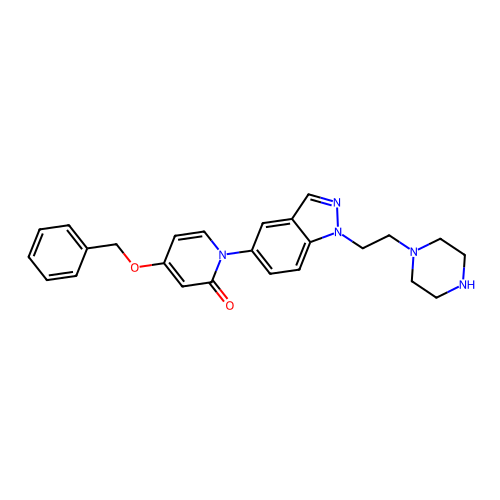

prediction: [0.00871244 0.9912875 ]
COc1ccc([C@H]2CC[C@@H](N3CC(NC(=O)CNc4noc5ccc(C(F)(F)F)cc45)C3)CC2)cn1


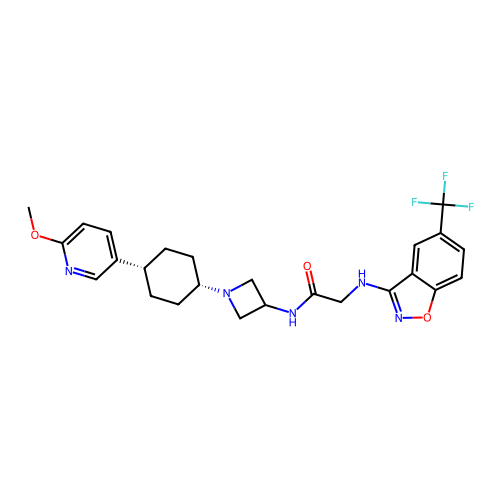

prediction: [0.00868926 0.9913107 ]
COc1ccc2ncc(OC)c(CCC34CCC(NCc5ccc6c(n5)NC(=O)CO6)(CC3)CO4)c2n1


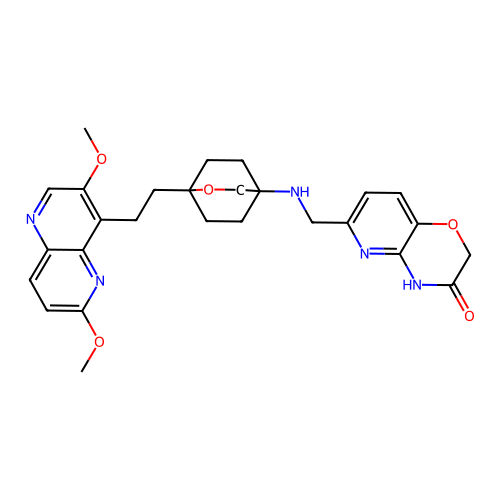

prediction: [0.00867101 0.99132895]
Cc1ccc(Cc2cccc(COc3ccc(C)cc3)[n+]2C)cc1


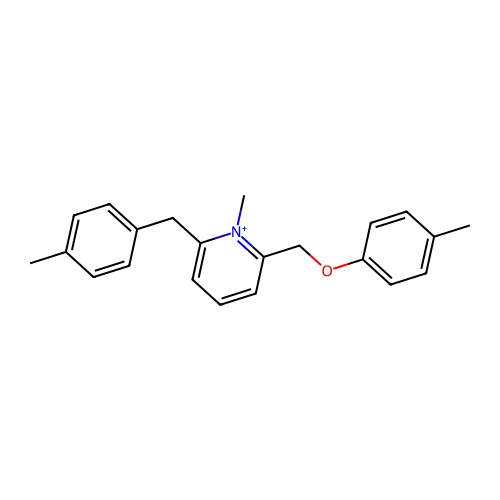

prediction: [0.0086504 0.9913496]
FC(F)(F)c1cccc(Cn2ccc3c(OC4CCN(Cc5cscn5)CC4)ncnc32)c1


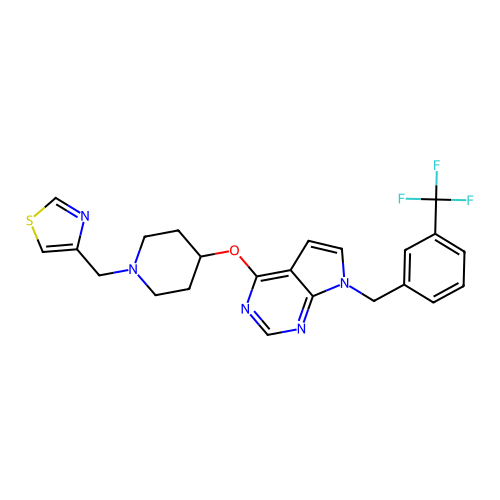

prediction: [0.00863819 0.9913618 ]
CN1C[C@@H]2C[C@H]1CN2c1ccc(-c2ccc3cc[nH]c3c2)cn1


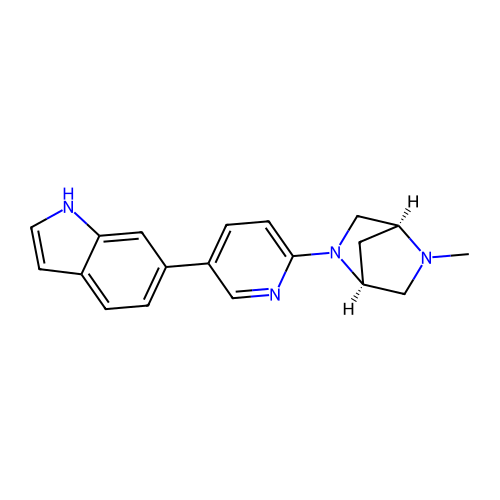

prediction: [0.00863815 0.9913619 ]
CCc1nn(C)c2cc3c(cc12)CCN(CCCSc1nnc(-c2cccc4nc(C)ccc24)n1C)CC3


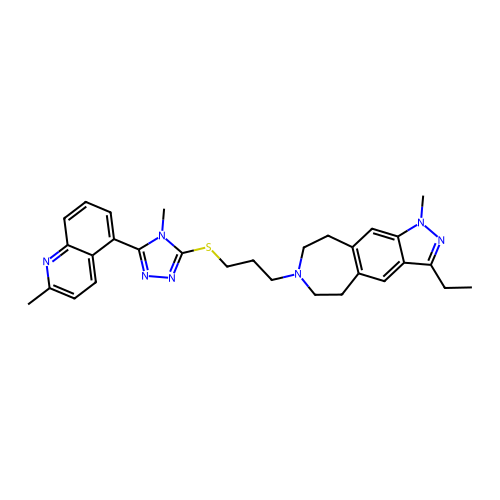

prediction: [0.00862519 0.9913748 ]
O=C(NC(c1ccncc1)c1ccc(F)cc1)[C@@H]1CC[C@@H](N2CCOCC2)C[C@H]1c1ccc(Br)cc1


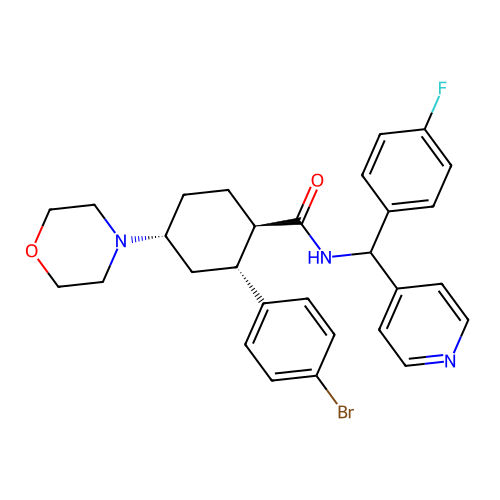

prediction: [0.00858825 0.9914117 ]
Cc1ccc2c(N3CCN(CCCc4cccc5c4OCC(=O)N5C)CC3)cc(F)cc2n1


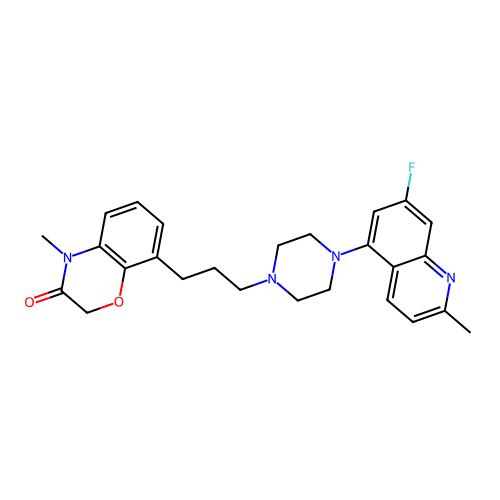

prediction: [0.00857051 0.9914295 ]
O=S(=O)(NCC1CC2(c3ccc(F)cc3)NC1CCC2NCc1cc(OC(F)(F)F)ccc1OC1CC1)c1ccccc1


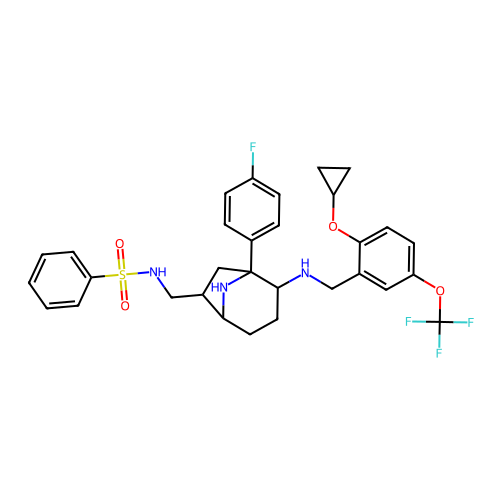

prediction: [0.00855764 0.9914424 ]
CN1CCN(CCCCN2C(=O)CN(/N=C/c3ccc(-c4ccc(Cl)cc4)o3)C2=O)CC1


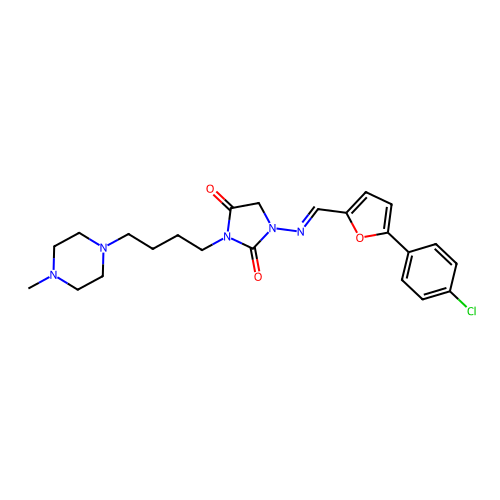

prediction: [0.00853739 0.99146265]
C[C@@H]1CCCN1CCc1ccc(-c2ccc(S(=O)(=O)N3CCCCC3)cc2)cc1


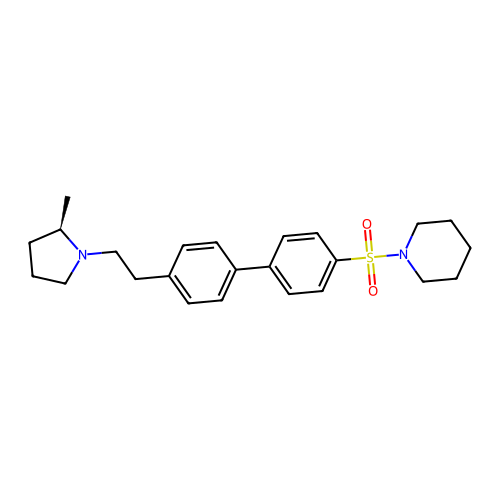

prediction: [0.00853433 0.9914657 ]
O=C(N[C@H]1CC[C@H]2CN(Cc3cccc(C(F)(F)F)c3)C[C@H]21)C(C1CCCCC1)C1CCCCC1


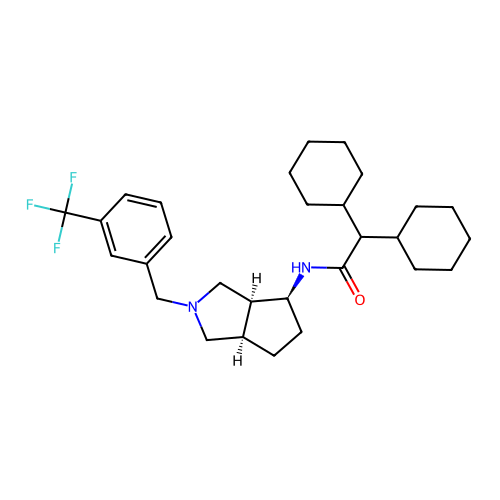

prediction: [0.0085305  0.99146944]
O=C(c1ccc(Oc2ccc(F)cc2)nc1)N1CCCN(C2CCC2)CC1


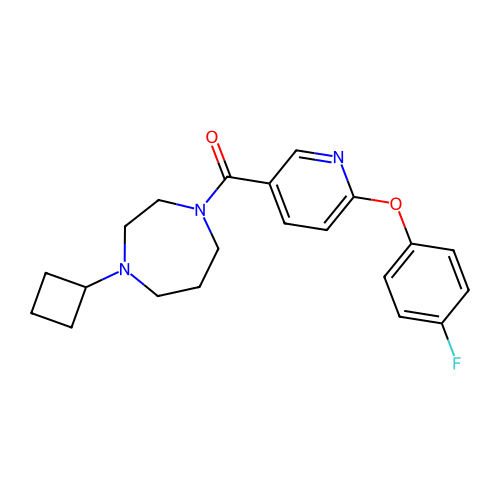

prediction: [0.00848477 0.9915153 ]
O=C(NC1CC1)c1ccc(F)cc1OC[C@@H](O)CN1CCC2(CC1)Cc1cc(Cl)ccc1O2


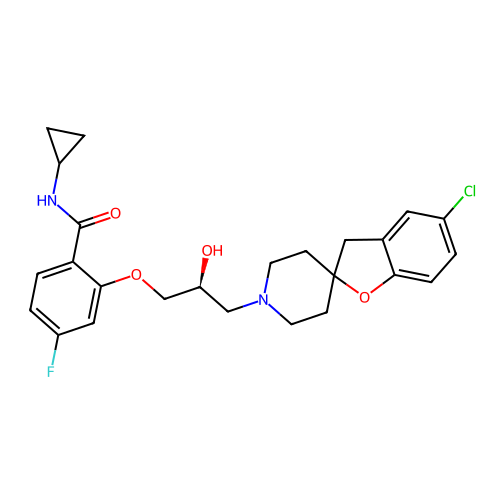

prediction: [0.00845969 0.9915404 ]
O[C@H](COc1ccc(Cl)cc1)CN1CCN(Cc2ccc(Cl)cc2)CC1


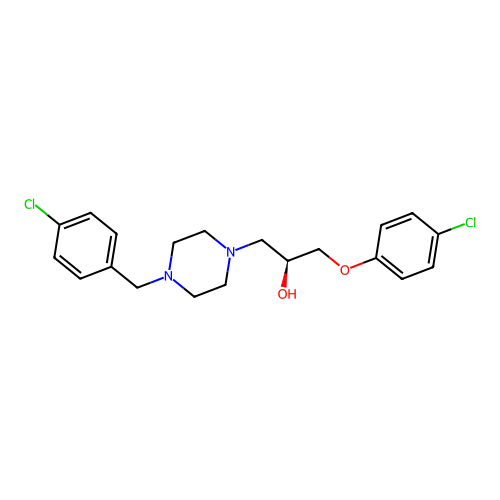

prediction: [0.00845108 0.9915489 ]
Cc1ncc(OC[C@@]2(c3cc(F)cc(F)c3)C[C@H]2C(=O)Nc2ccc(F)cn2)c(C)n1


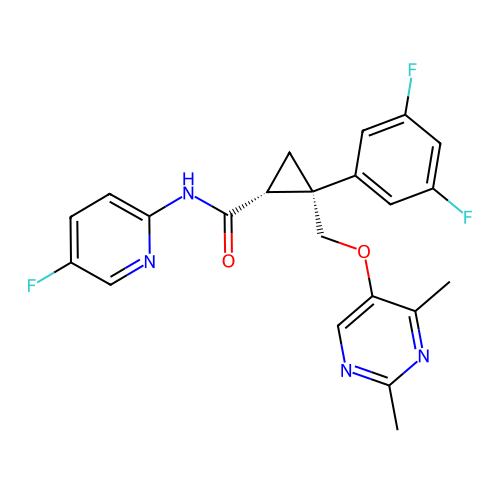

prediction: [0.00844066 0.9915593 ]
c1cncc(-c2c[nH]c([C@H]3Cc4c([nH]c5ccccc45)C(C4CCCCC4)N3)n2)c1


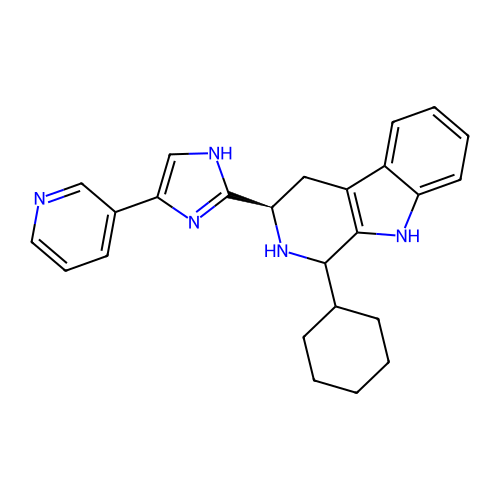

prediction: [0.00842272 0.99157727]
Cc1cccc(C)c1C(=O)N1CCC(C)(N2CCC(N(Cc3ccccc3)c3ccccc3)CC2)CC1


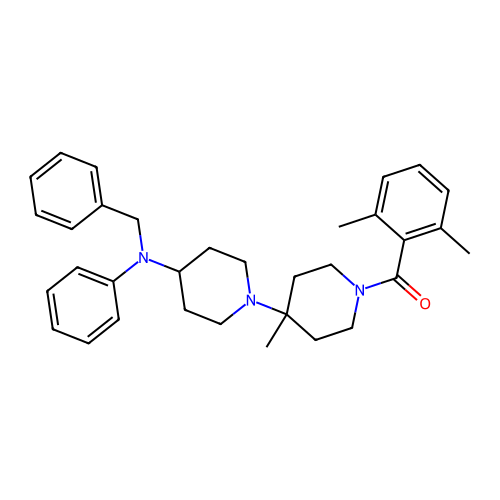

prediction: [0.00837827 0.99162173]
CC(=O)NC1CC2CCC(C1)N2Cc1ccc(Oc2nc3ncccc3s2)cc1


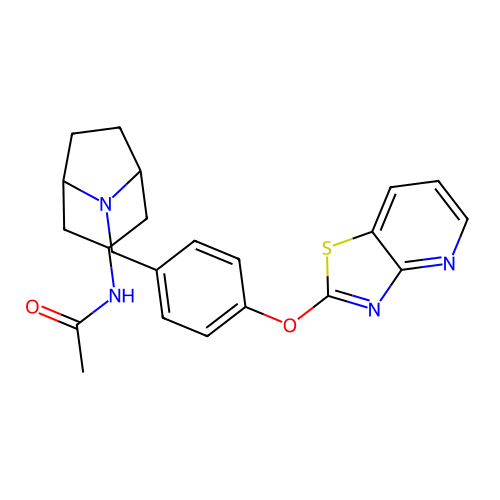

prediction: [0.0083114  0.99168867]
Fc1ccccc1-c1nc2ccn(Cc3ccc(-c4ccc(C(F)(F)F)cc4C(F)(F)F)nn3)cc-2n1


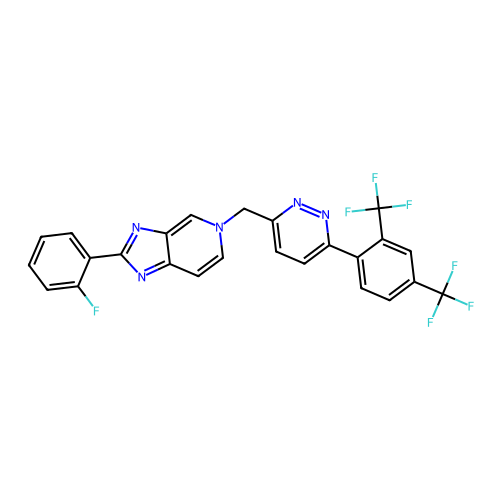

prediction: [0.0083113  0.99168867]
CCCCCCC[N+](CC)(CC)CC#Cc1ccc(Cl)cc1


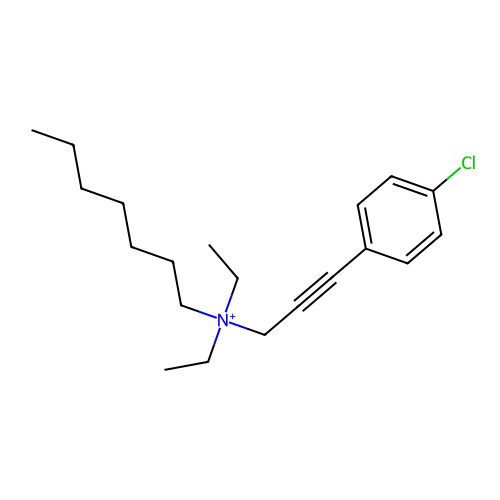

prediction: [0.00829106 0.99170893]
Cc1ncoc1-c1nnc(SCCCN2CCc3nc4cc(C(F)(F)F)ccn4c3CC2)n1C


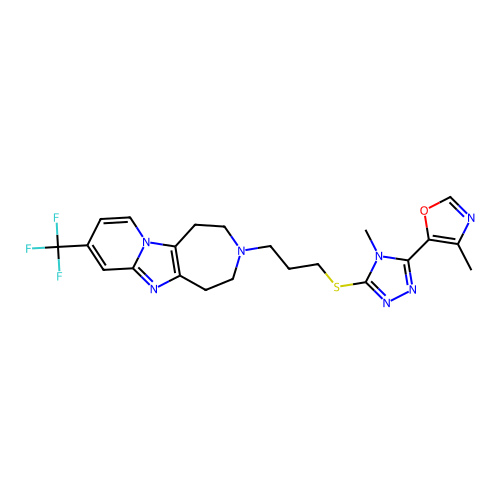

prediction: [0.00825335 0.99174666]
Clc1ccc(Cn2c(/C=C/C3CCN(CC4CCCCC4)C3)nc3cc(Br)ccc32)cc1


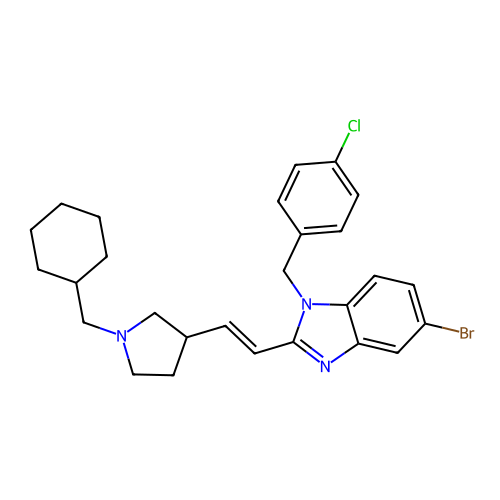

prediction: [0.00825214 0.99174786]
Cc1ncoc1-c1nnc(SCCCN2CCc3ccc4oc(C(F)(F)C(F)(F)F)nc4c3CC2)n1C


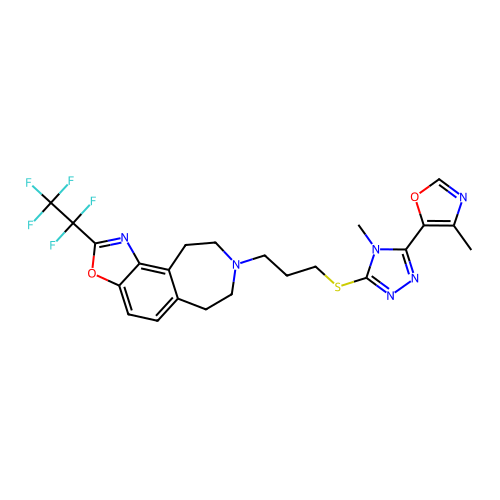

prediction: [0.00824019 0.99175984]
CN(CCN1CCN(c2ccccc2)C1=O)C[C@]12CC[C@H](CC1)C2(C)C


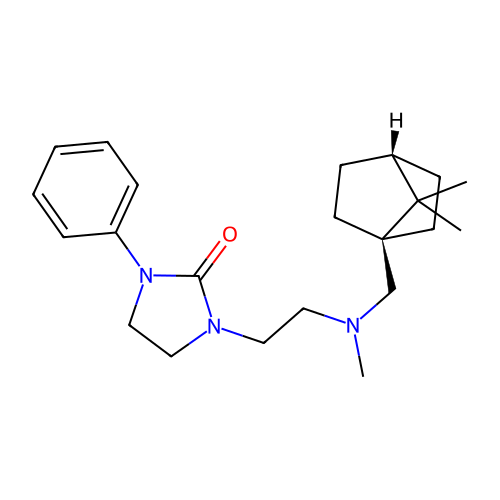

prediction: [0.00823722 0.99176276]
Nc1ncnc2c1c(-c1ccc(Oc3ccccc3)cc1)cn2C1CCCC1


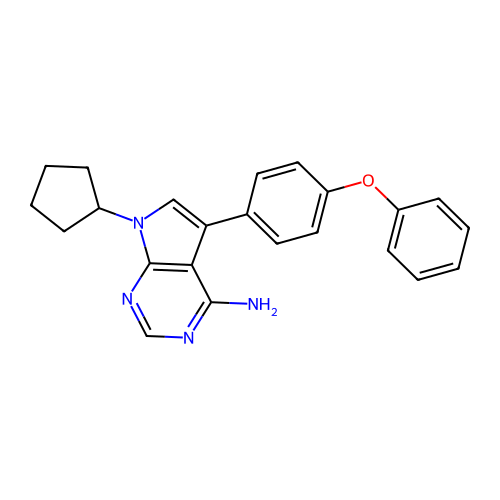

prediction: [0.00821578 0.9917842 ]
CN1C[C@@H]2C[C@H]1CN2c1ccc(-c2ccc3sccc3c2)nn1


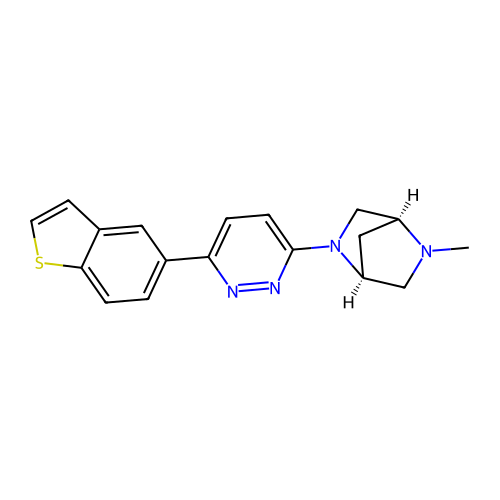

prediction: [0.00821429 0.9917857 ]
COCCN(C)C1CCN(c2nc3ccccc3n2Cc2ccc(F)cc2)CC1


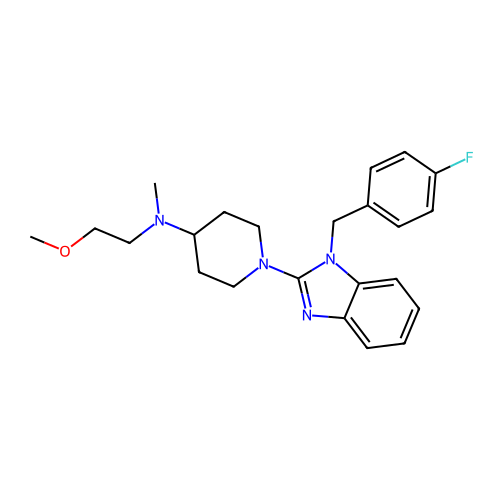

prediction: [0.00819755 0.9918025 ]
OCCN1CCN(CCCN2c3ccccc3C=Cc3ccccc32)CC1


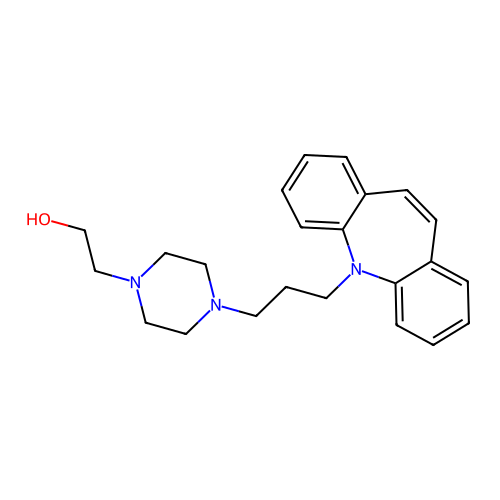

prediction: [0.00819169 0.99180835]
O=C(NC1CCN(Cc2ccc3c(c2)OCO3)CC1)c1cc(=O)c2ccc(Br)cc2o1


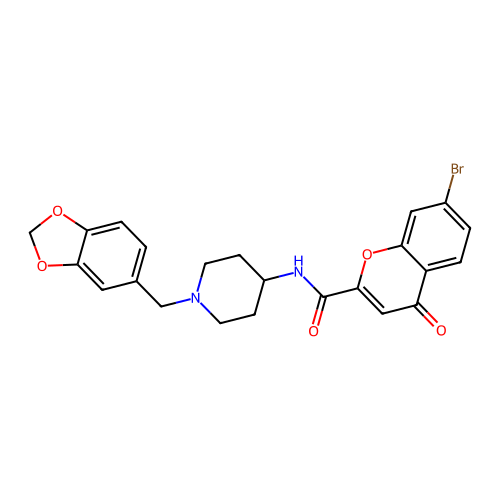

prediction: [0.00818113 0.9918189 ]
Cc1cc(C(O)(c2ccc3c(cnn3-c3ccc(F)cc3)c2)C(F)(F)F)ccc1F


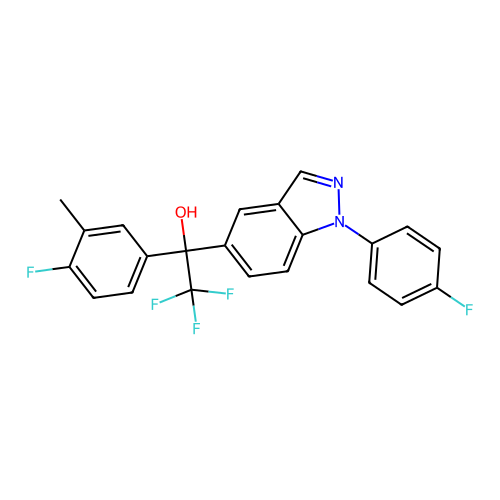

prediction: [0.008174   0.99182594]
C[C@H]1[C@@H](c2ccc(OCCCN3CCCC3)cc2)Oc2ccccc2S1(=O)=O


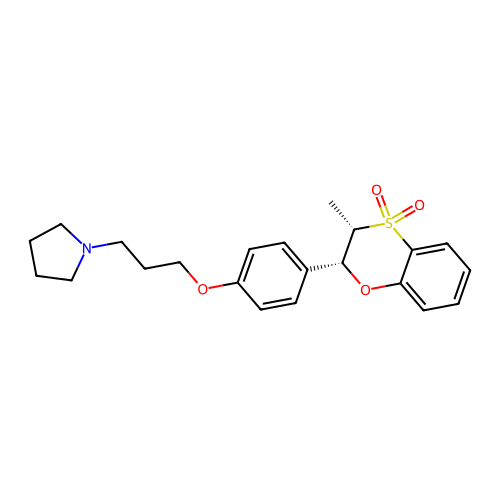

prediction: [0.00815026 0.9918498 ]
O=S(=O)(c1ccc(Cl)cc1)C1CCN(CCc2ccc(F)cc2F)CC1


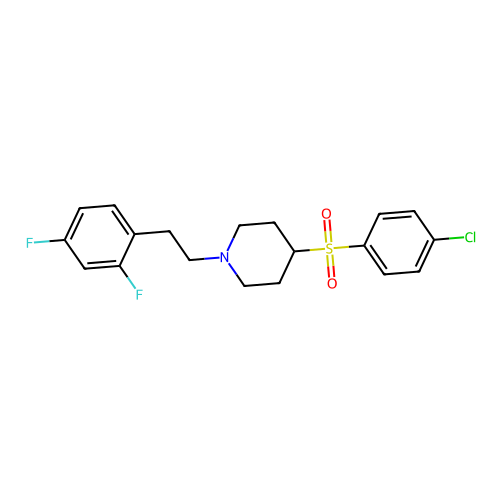

prediction: [0.00814628 0.9918538 ]
Cc1cc(-c2ccc3c(c2)CCN(CCCSc2nnc(-c4cccc(F)c4)n2C)CC3)no1


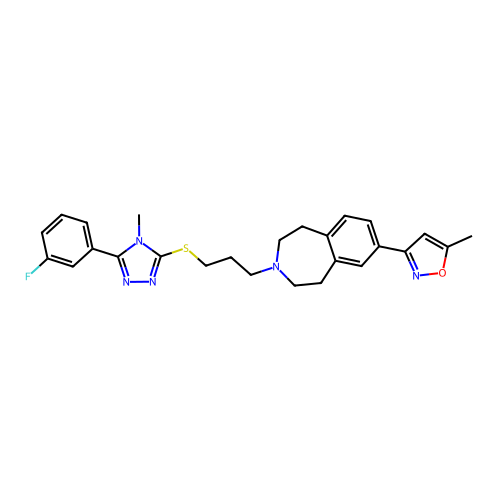

prediction: [0.00812881 0.99187124]
O=C(NC1CCc2ccc(CCN3CCN(c4nsc5ccccc45)CC3)cc21)C1CC1


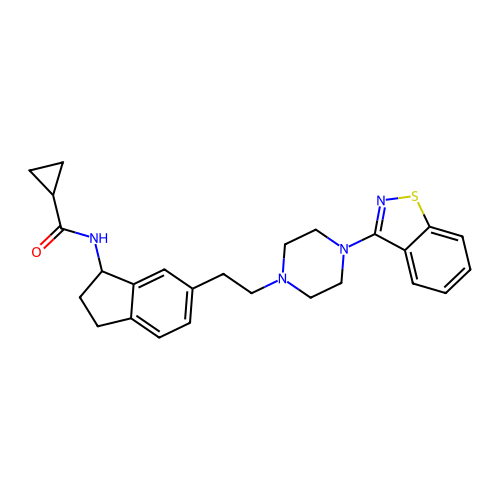

prediction: [0.00810471 0.99189526]
CO[C@H]1CN(Cc2ccc(C(F)(F)F)cc2)CC[C@H]1N(C)C(=O)Cc1ccc(-n2cnnn2)cc1


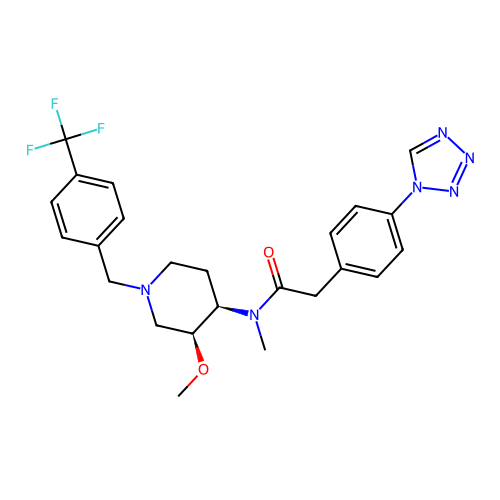

prediction: [0.00806633 0.99193364]
O=c1cc(OCc2ccccc2)ccn1-c1ccc2c(cnn2CCN2CCCC2)c1


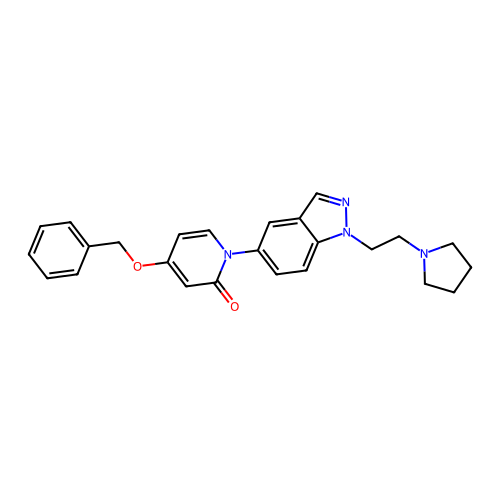

prediction: [0.00804369 0.99195623]
Cc1ccc([C@@H](C)N[C@@H]2CC[C@@H](C(=O)N3CCC(C(=O)N4CCCC4)(c4ccccc4)CC3)C(C)(C)C2)cc1


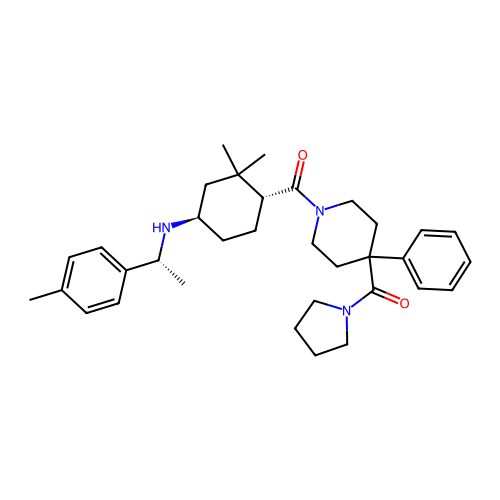

prediction: [0.00803031 0.99196976]
COc1ccc([C@@H](C)N[C@@H]2CC[C@@H](C(=O)N3CCC(C(=O)N4CCCC4)(c4ccccc4)CC3)C(C)(C)C2)cc1


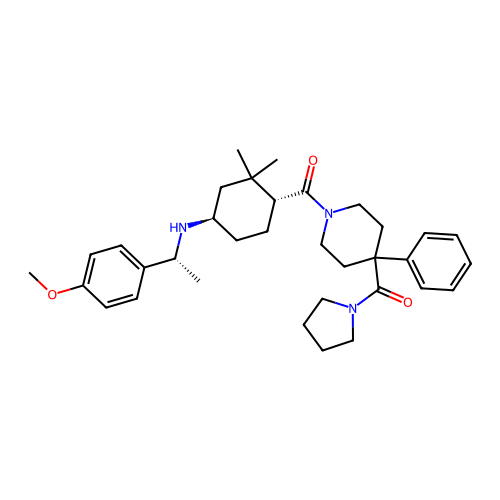

prediction: [0.0080057  0.99199426]
CCCCCn1c(=O)nc(NC2CCN(Cc3ccc4c(c3)OCO4)CC2)c2cc(Cl)ccc21


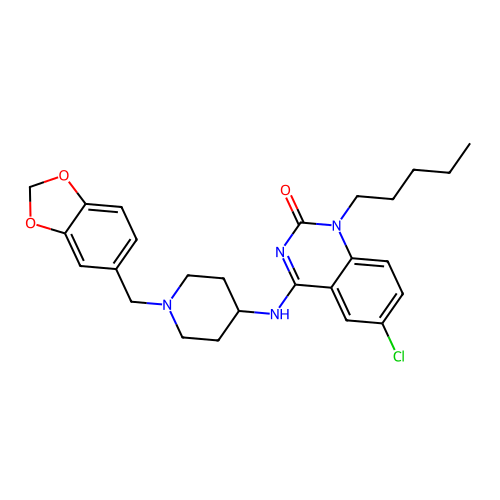

prediction: [0.00800515 0.99199486]
COc1cccc(CCN(C)CCN2CCN(c3cccc(Cl)c3)C2=O)c1


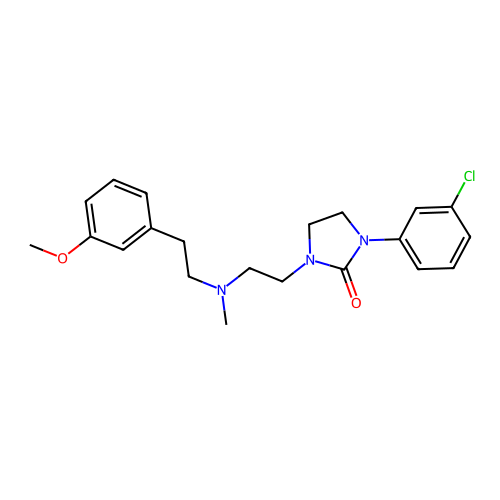

prediction: [0.00800231 0.99199766]
COc1ccc([C@H]2CN(CCc3ccc(OC)c(OC)c3)C[C@@H]2CCNC(=O)c2cccc(Cl)c2)cc1


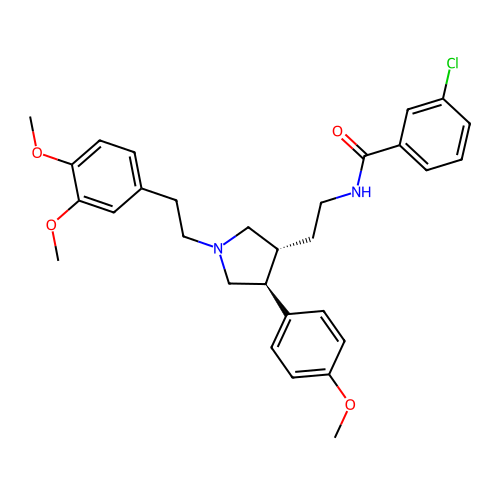

prediction: [0.00799976 0.9920002 ]
CN(CC1CCOCC1)C1CCN(c2nc3ccccc3n2Cc2ccc(F)cc2)CC1


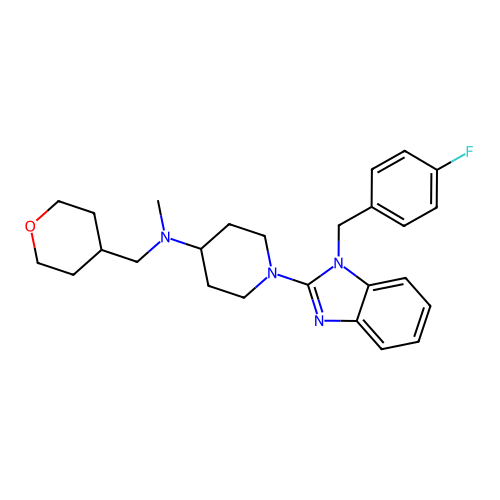

prediction: [0.00799469 0.9920053 ]
CCCNc1cc(N2CCOCC2)cc(CCc2nc(C)c(CC)o2)n1


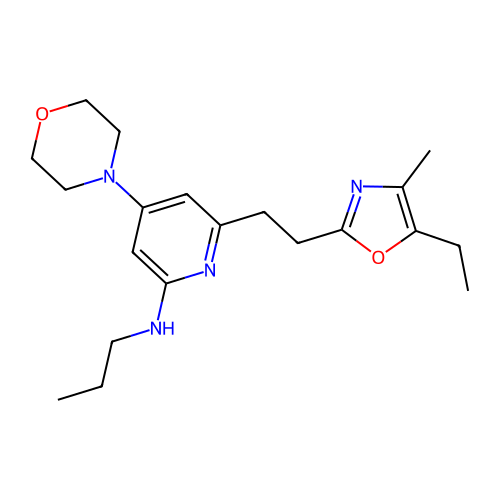

prediction: [0.00789835 0.9921016 ]
COc1ccc(CC(C)(C)NCC(O)COc2cccc(Cl)c2C#N)cc1


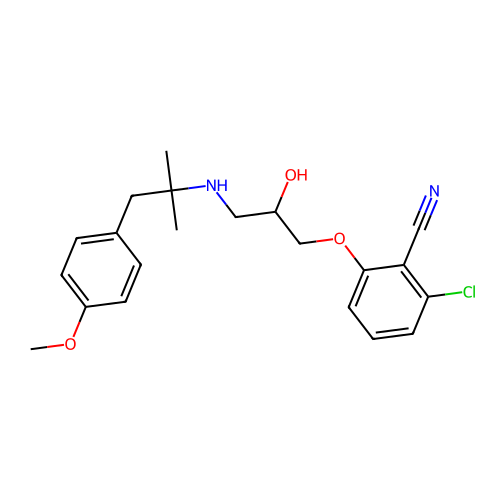

prediction: [0.00787588 0.99212414]
O=C1CN([C@H]2CC[C@](c3ccccc3)(N3CCC(c4cc(C(F)(F)F)cc(C(F)(F)F)c4)C3=O)CC2)CCN1c1ccccc1


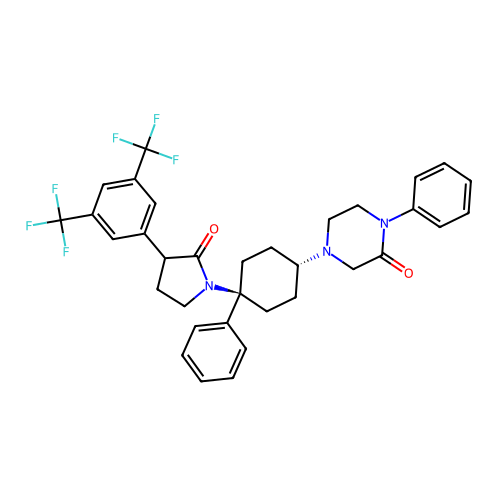

prediction: [0.00786865 0.9921313 ]
O=C1CCCCN1C1CCN(c2nc3ccccc3n2Cc2ccc(F)cc2)CC1


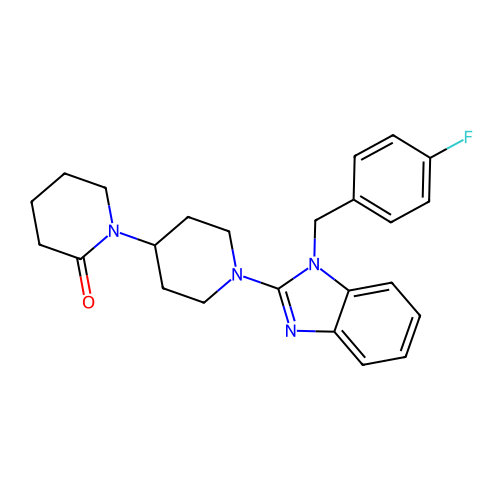

prediction: [0.00786639 0.9921336 ]
CC#Cc1cncc(-c2cc3c(cc2F)OCC2(CC2)C32COC(N)=N2)c1


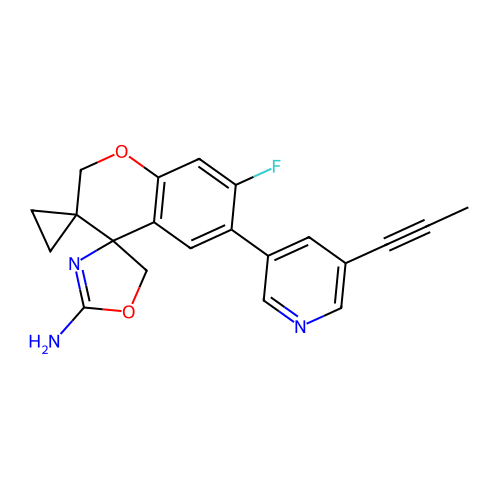

prediction: [0.0078475 0.9921525]
CN(C)CCC1=C(Cc2cnccn2)c2ccccc2C1


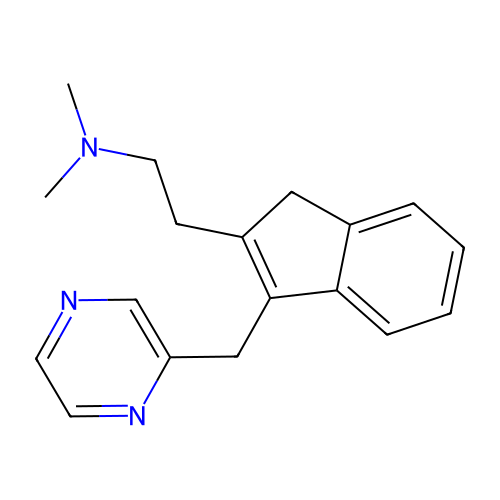

prediction: [0.00784651 0.99215347]
COc1ccc(S(=O)(=O)n2cc(C)c3cc(F)ccc32)cc1NC1CCN(C)CC1


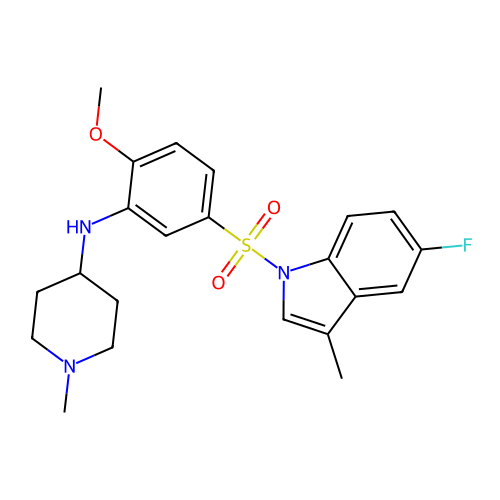

prediction: [0.00784609 0.99215394]
O=C(Nc1ccccc1)c1[nH]c2cc(F)ccc2c1C1C[NH2+]CC[C@@H]1F


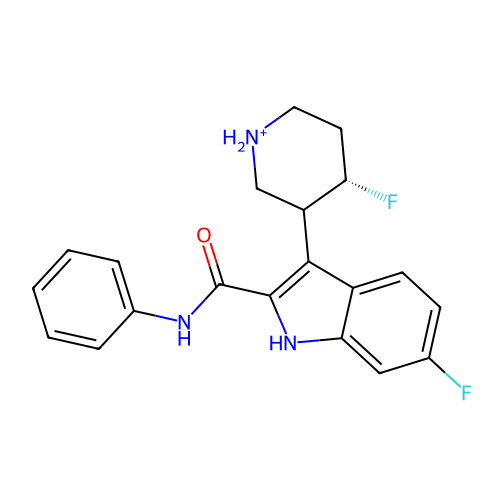

prediction: [0.00784013 0.9921599 ]
N#Cc1cc2cc(C3(Cc4ccccc4)CCNC3)ccc2[nH]1


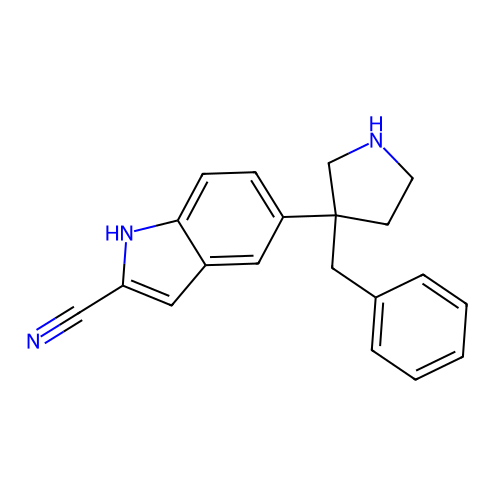

prediction: [0.00782404 0.992176  ]
Cc1cc(-c2ccc3c(c2)CCN(CCCSc2nnc(-c4cccs4)n2C)CC3)no1


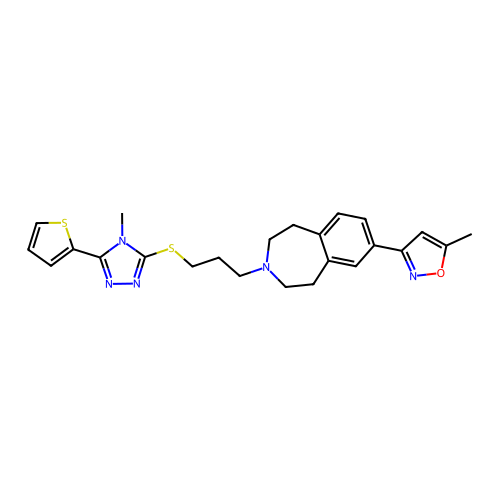

prediction: [0.00781578 0.9921842 ]
COc1ccc(C2CCN(CC[C@H]3CCOc4ccccc43)CC2)cc1OC


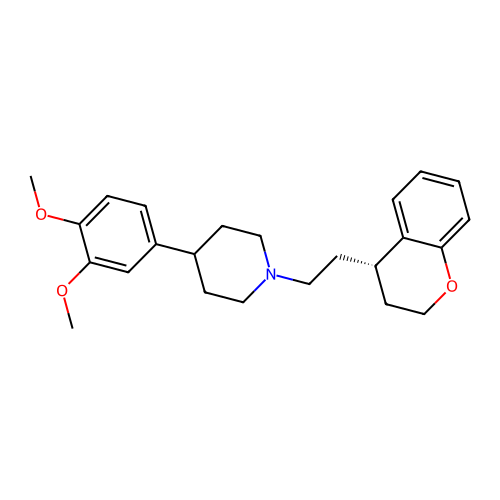

prediction: [0.00778597 0.992214  ]
CN(C(=O)Cc1ccc(-n2cnnn2)cc1)C1CCN(Cc2nc3cc(F)ccc3s2)CC1


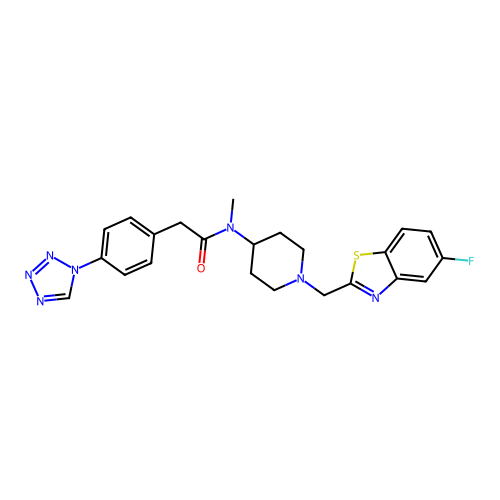

prediction: [0.0077607  0.99223924]
COc1ccccc1[C@@H](C)N[C@@H]1CC[C@@H](C(=O)N2CCC(C(=O)N3CCCC3)(c3ccccc3)CC2)C(C)(C)C1


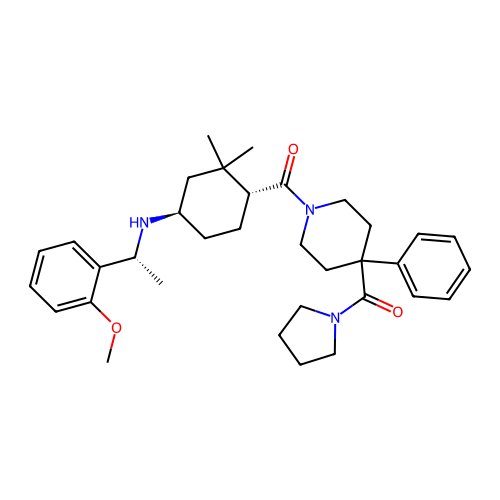

prediction: [0.00773998 0.99226004]
Cc1nc(C(=O)NCCCN2CCN(c3cccc(Cl)c3Cl)CC2)c(C)n1-c1ccccc1


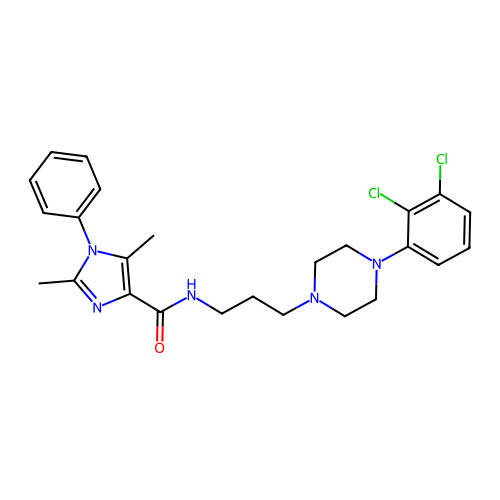

prediction: [0.00769081 0.9923092 ]
FC(F)(F)Oc1ccc(OC2CC2)c(CNC2CCC3CCC2(c2ccccc2)N3)c1


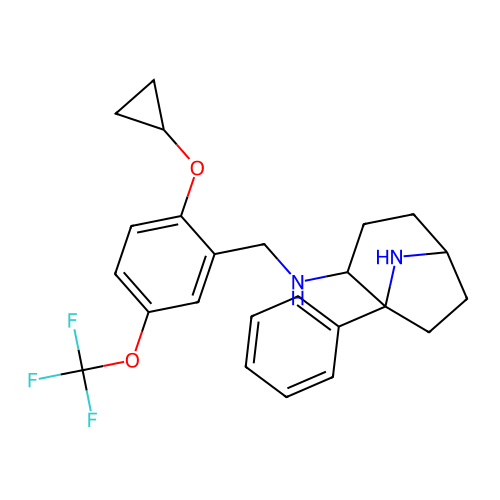

prediction: [0.0076819  0.99231815]
c1ccc(CCc2cccc(CCc3ccccc3)n2)cc1


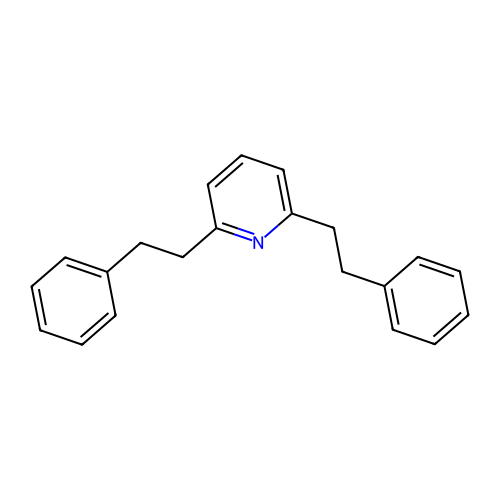

prediction: [0.00759988 0.99240005]
Cc1cccc(Nc2nc(N[C@H]3CCNC3)ncc2C(N)=O)c1


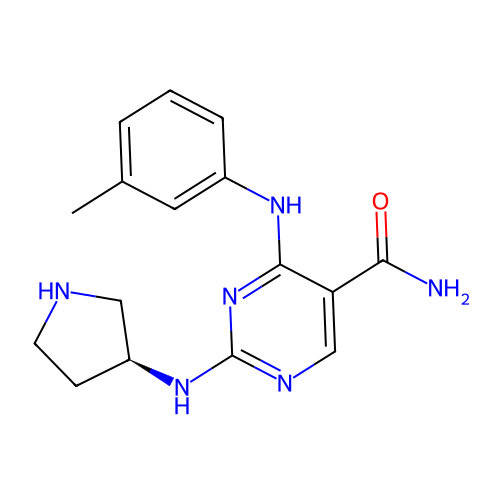

prediction: [0.00756113 0.9924388 ]
O=C(CNC(=O)c1cccc(C(F)(F)F)c1)N[C@@H]1CCN(CCC2CCN(C(=O)c3ccccc3F)CC2)C1


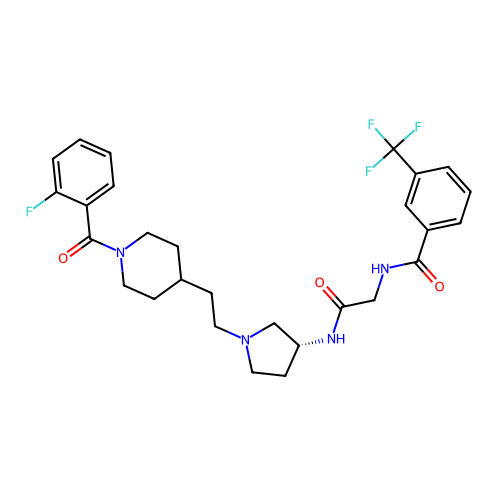

prediction: [0.00755114 0.9924489 ]
NC1=NC2(CO1)c1cc(-c3cccnc3F)ccc1OCC21CC1


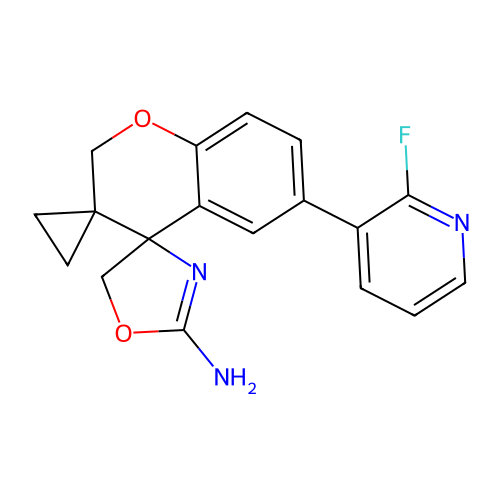

prediction: [0.00754616 0.9924539 ]
Cc1ccc2c(-c3nnc(SCCCN4CCc5ccc6nc(C)sc6c5CC4)n3C)cccc2n1


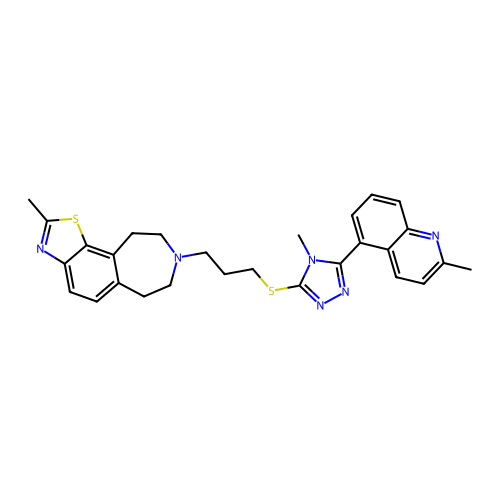

prediction: [0.00752821 0.9924718 ]
CCN(CC)CCN(C)c1ccc(-n2ccc(OCc3ccccc3)cc2=O)cc1


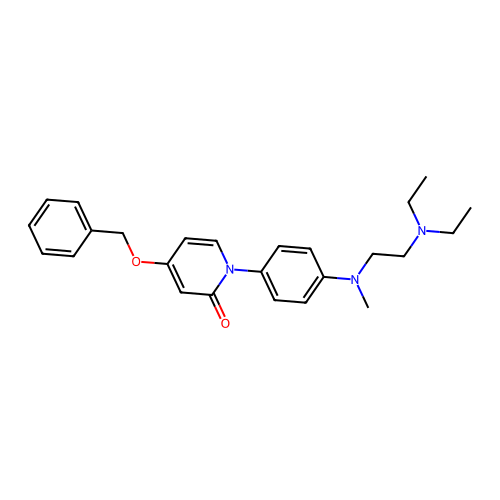

prediction: [0.00750756 0.9924925 ]
Nc1ccc(CCN2CCN(c3cccc(C(F)(F)F)c3)CC2)cc1


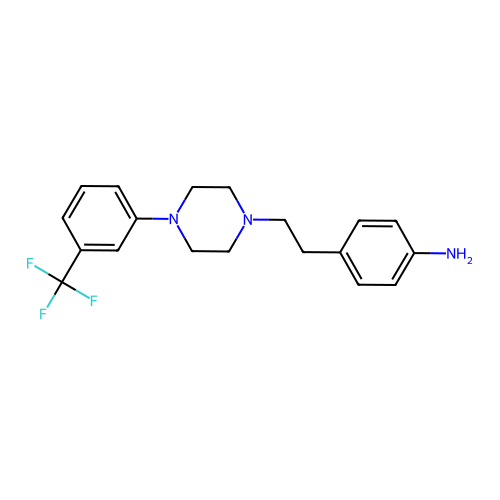

prediction: [0.0075044  0.99249566]
COC(=O)C1(CNC(=O)c2cc(Cl)cc(Cl)c2)CCN(Cc2ccc(C(F)(F)F)cc2)CC1


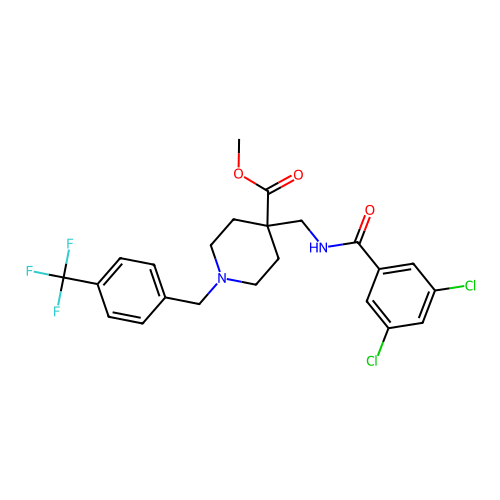

prediction: [0.00748636 0.9925136 ]
O=c1ccc(-c2nc3cc(Cl)c(Cl)cc3n2Cc2ccc(Cl)c(Cl)c2)c[nH]1


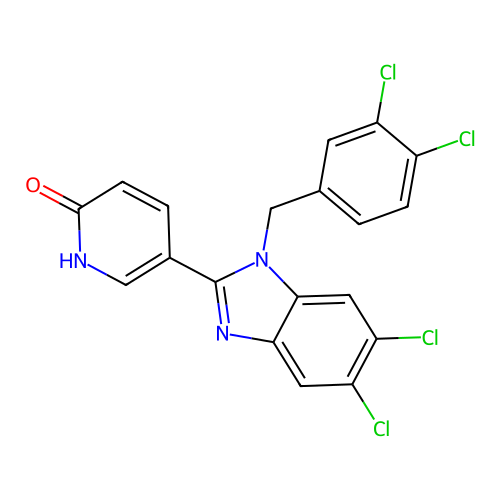

prediction: [0.007448   0.99255204]
C[C@@H](N[C@@H]1CC[C@@H](C(=O)N2CCC(C(=O)N3CCCC3)(c3ccccc3)CC2)C(C)(C)C1)c1ccc(F)cc1


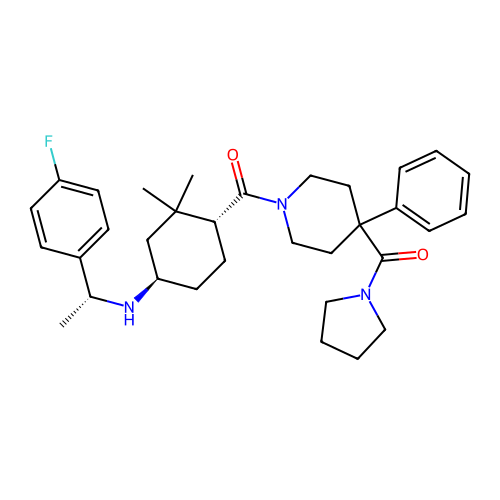

prediction: [0.00743172 0.99256825]
CN1C[C@@H]2C[C@H]1CN2c1cnc(-c2ccc3[nH]ccc3c2)cn1


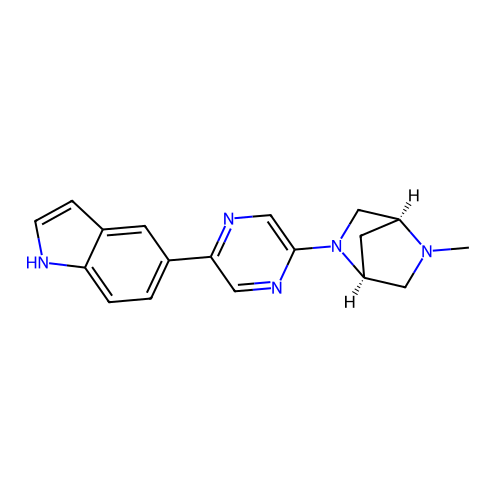

prediction: [0.00737743 0.9926226 ]
NC1=NC2(CO1)c1cc(-c3cnc4[nH]cc(Cl)c4c3)ccc1OCC21CC1


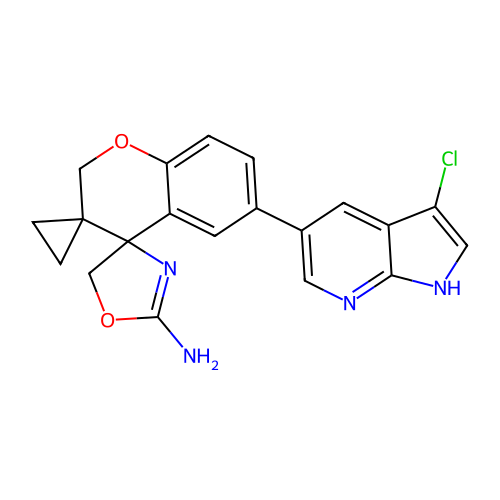

prediction: [0.00736737 0.99263257]
N#Cc1cc(F)ccc1/C=C/c1ccc(S(=O)(=O)c2ccccc2F)cn1


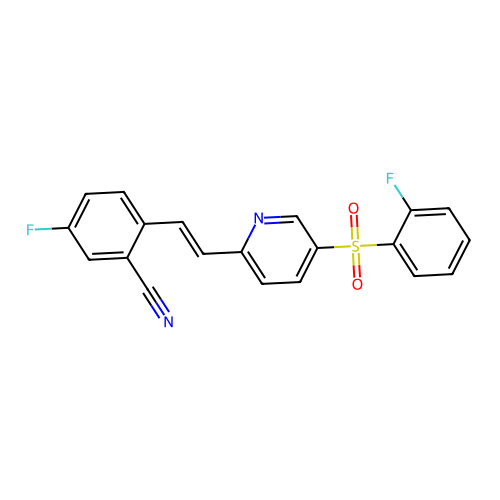

prediction: [0.00736345 0.99263656]
COCc1ccc(CCN2CCC(COc3nc4ccccc4c4cn(C)cc34)CC2)cc1


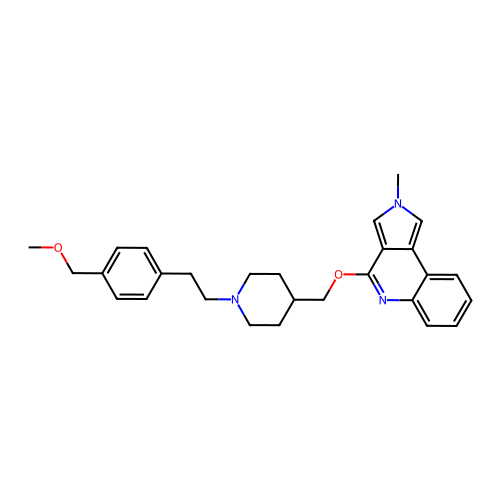

prediction: [0.00734491 0.99265516]
O=c1cc(OCc2ccc(C(F)(F)F)cc2)ccn1-c1ccc(OCCN2CCCC2)cc1


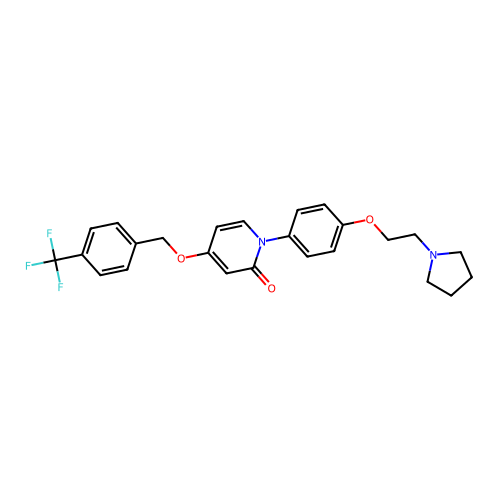

prediction: [0.00733966 0.9926603 ]
NC1=N[C@@]2(CO1)c1cc(-c3cccnc3F)ccc1Oc1cnc(N3CCC(F)(F)CC3)cc12


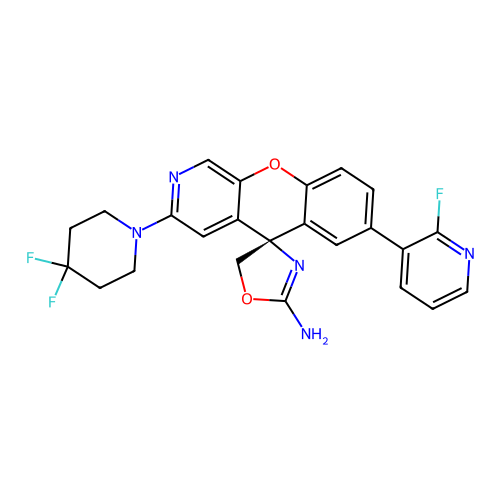

prediction: [0.0073361 0.992664 ]
CN1CCC(=C2c3ccccc3C=Cc3ccccc32)CC1


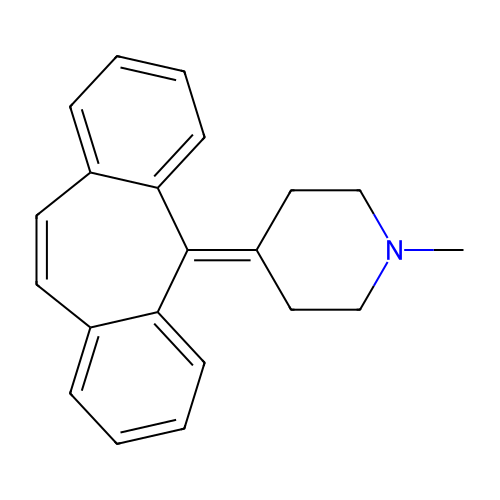

prediction: [0.0073265  0.99267346]
CN(C(=O)Cc1ccccc1)C1CCN(Cc2ccc(C(F)(F)F)cc2)CC1


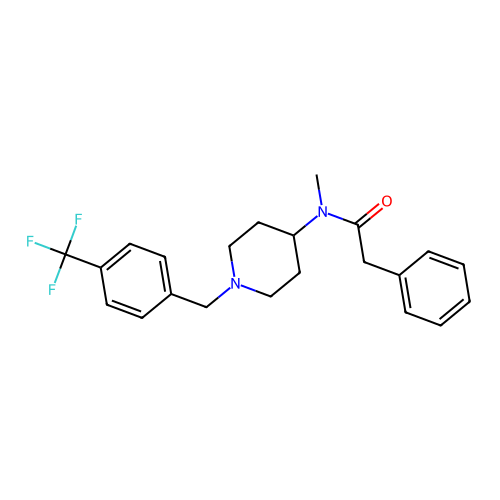

prediction: [0.00730821 0.9926918 ]
Nc1ccnc(Nc2ccc(Oc3ccc(C(F)(F)F)cc3)cc2)n1


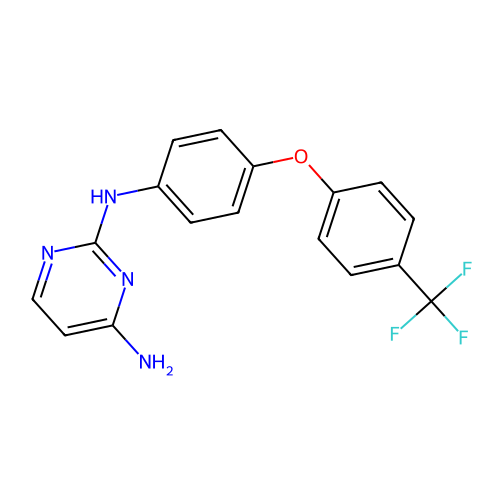

prediction: [0.0072869  0.99271303]
COc1ccc(Br)cc1CCc1c(Cl)cccc1C1=NCCN1


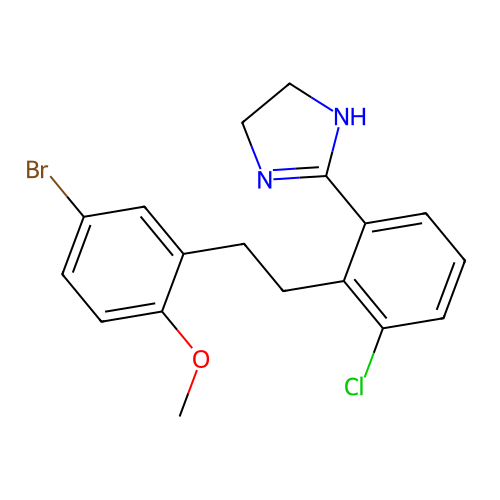

prediction: [0.0072724  0.99272764]
O=C1N(CCN2Cc3ccccc3C2)CCN1c1ccc2sccc2c1


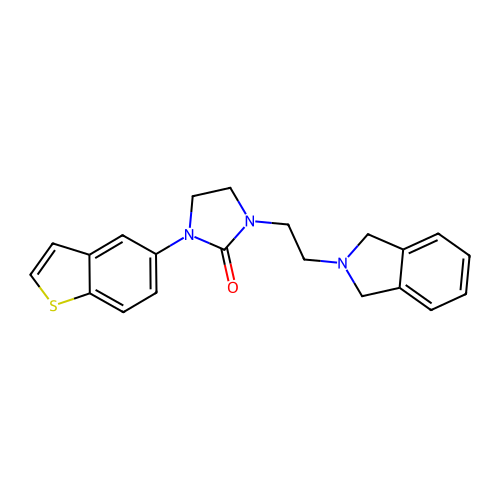

prediction: [0.00724124 0.99275875]
O=C1COc2ccc(CNC34CCC(CCc5ccnc6cc(Cl)cnc56)(CC3)OC4)nc2N1


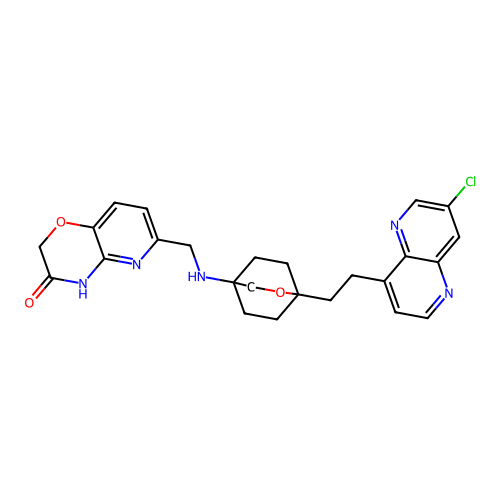

prediction: [0.00720418 0.99279577]
CCCn1c(-c2ccccc2)cc(C(=O)NCCCN2CCN(c3cccc(Cl)c3Cl)CC2)c1C


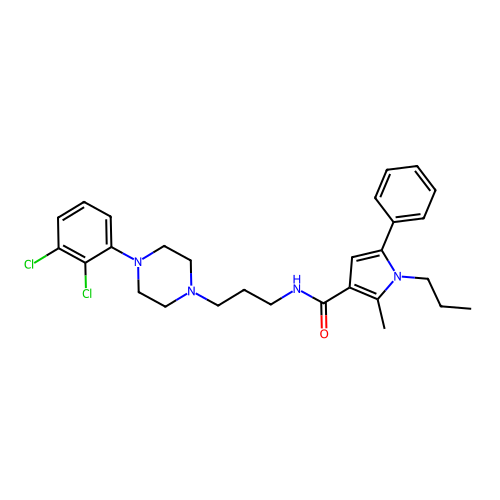

prediction: [0.00715678 0.9928433 ]
NC1=NC2(CO1)c1cc(Br)ccc1OC(Cc1ccccc1)C21COC1


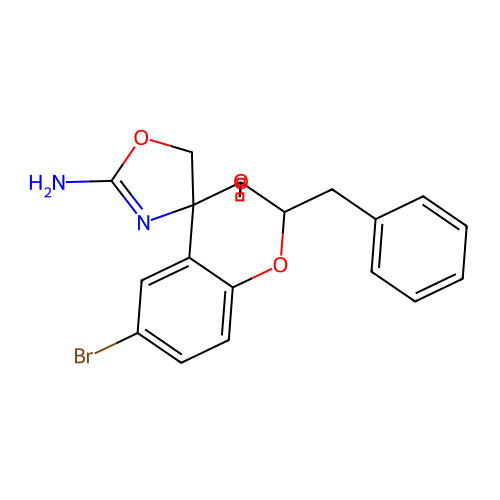

prediction: [0.00715395 0.9928461 ]
COc1cncc(-c2ccc3c(c2)C2(COC(N)=N2)C2(COC2)C2(CCC2)O3)c1


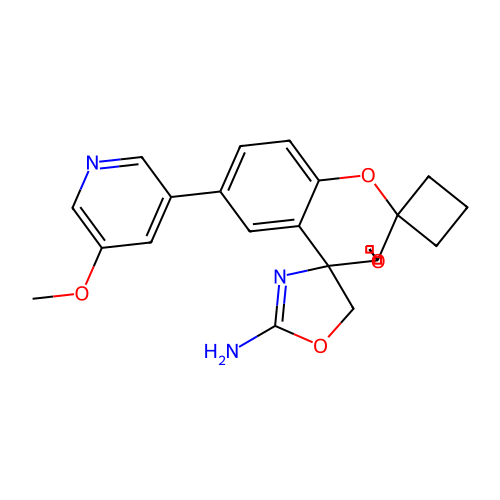

prediction: [0.007153 0.992847]
CN(C)C1CCN(c2nc3ccccc3n2Cc2ccc(F)cc2)CC1


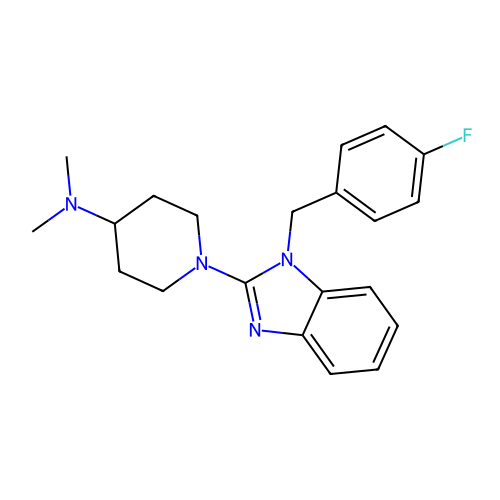

prediction: [0.00715228 0.9928477 ]
NC(=O)c1cccc(C[C@H]2C[C@H]3CC[C@@H](C2)N3Cc2ccccc2)c1


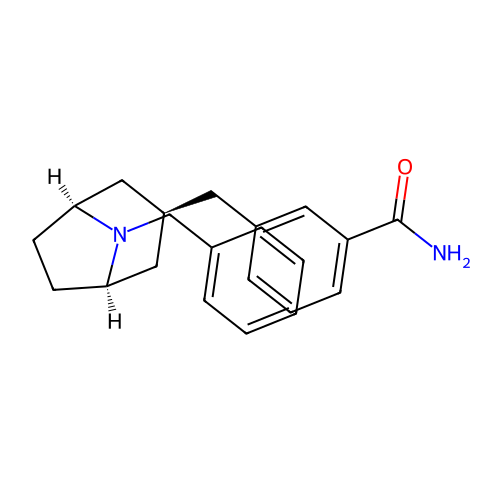

prediction: [0.00714384 0.99285614]
CC(C)CN1CCC(c2ccccc2Oc2ncccc2NC(=O)Nc2ccc(OC(F)(F)F)cc2)CC1


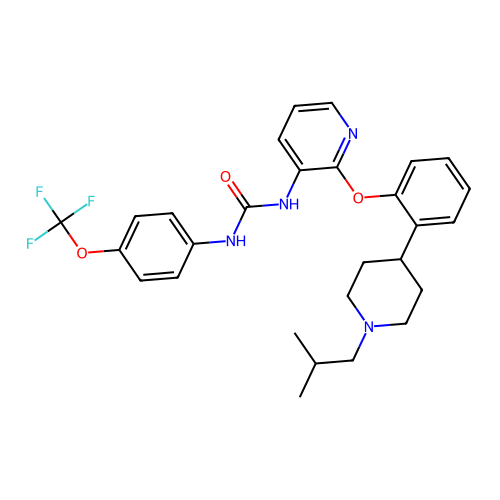

prediction: [0.00713432 0.9928657 ]
Cc1cc(C2(c3cccc(-c4cncnc4)c3)N=C(N)c3c(F)cccc32)cc(C)n1


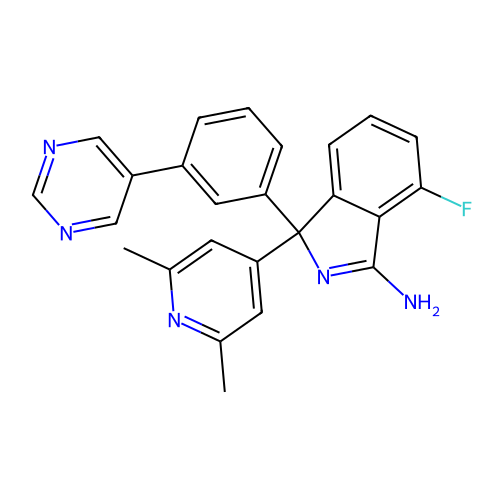

prediction: [0.00710597 0.992894  ]
CCN(CC)C(=O)c1ccc(C(=C2CCN(Cc3ccc(F)cc3)CC2)c2ccc(NC(C)=O)cc2)cc1


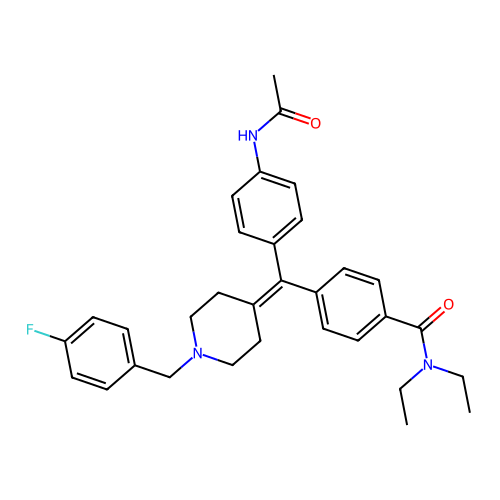

prediction: [0.00708242 0.99291766]
CN(C)C(=N)c1ccc(C(=O)Nc2ccc(Sc3ccccc3)cc2C(=O)Nc2ccc(Cl)cn2)cc1


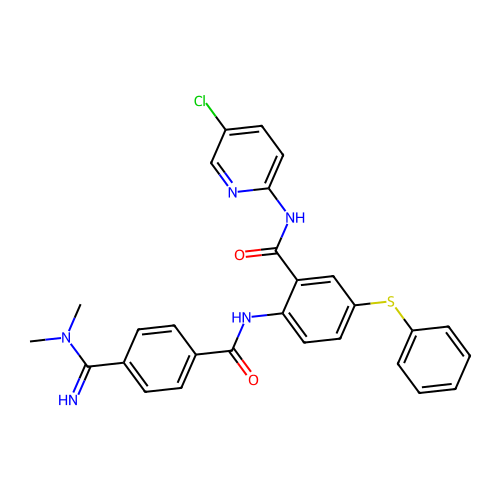

prediction: [0.00703003 0.99296993]
Cc1nc2ccccc2c(=O)n1-c1ccc(OCCCN2CCCC2)cc1


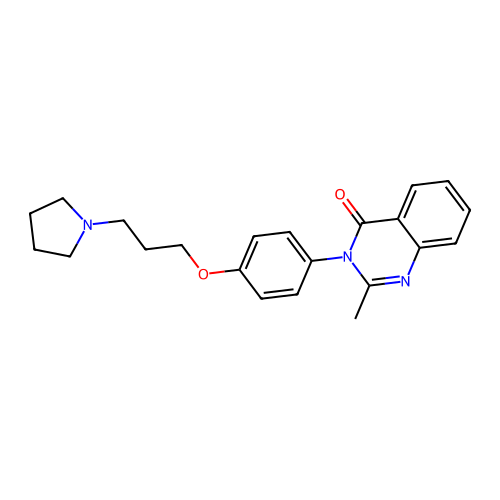

prediction: [0.00698929 0.9930107 ]
N#Cc1cccc(S(=O)(=O)C2CCN(CCc3ccc(F)cc3F)CC2)c1


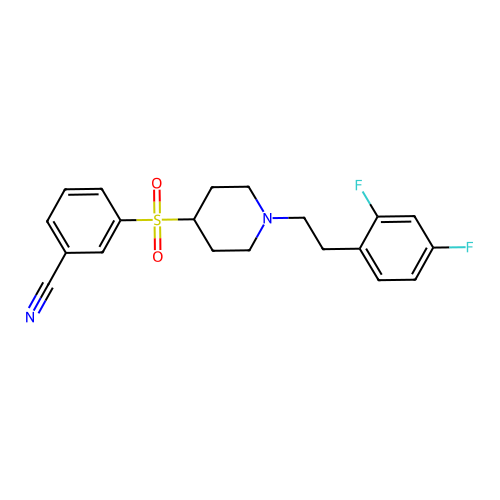

prediction: [0.00698729 0.9930127 ]
O=C1N(CCN2Cc3ccccc3C2)CCN1c1cccc(Cl)c1


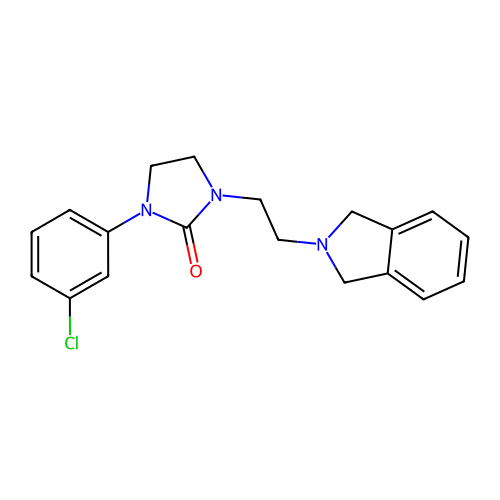

prediction: [0.00696298 0.99303705]
O=C1c2cc3ccccc3n2CCN1CCCCN1CCN(c2cccc(Cl)c2Cl)CC1


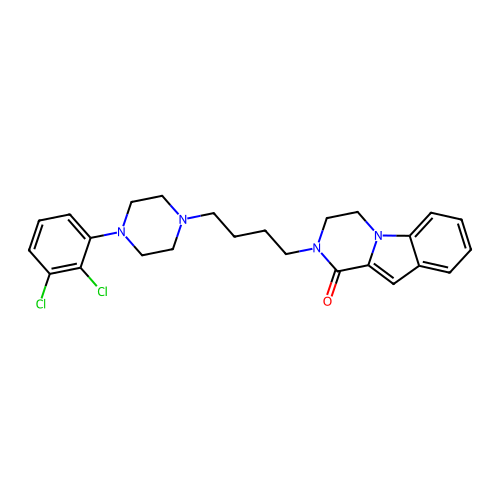

prediction: [0.0069468  0.99305314]
N#CCN(CCOc1ccc([N+](=O)[O-])cc1)CCc1ccc([N+](=O)[O-])cc1


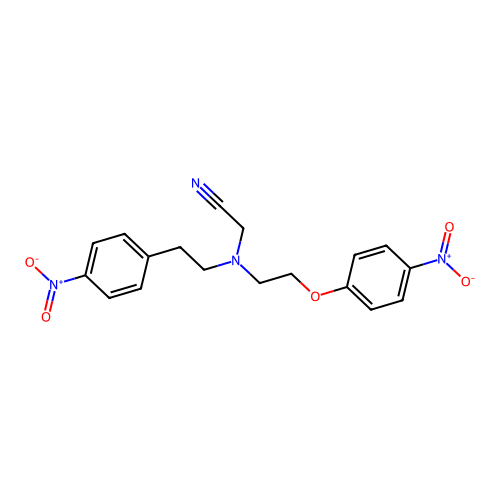

prediction: [0.0069402 0.9930599]
Cc1ncc(OC[C@@]2(c3ccccc3)C[C@H]2C(=O)Nc2cc(C)c(F)cn2)c(C)n1


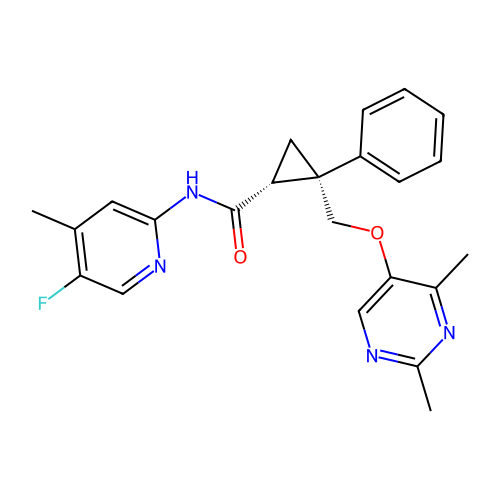

prediction: [0.00692278 0.9930773 ]
CN(CCOc1ccc(NS(C)(=O)=O)cc1)CCc1ccc(NS(C)(=O)=O)cc1


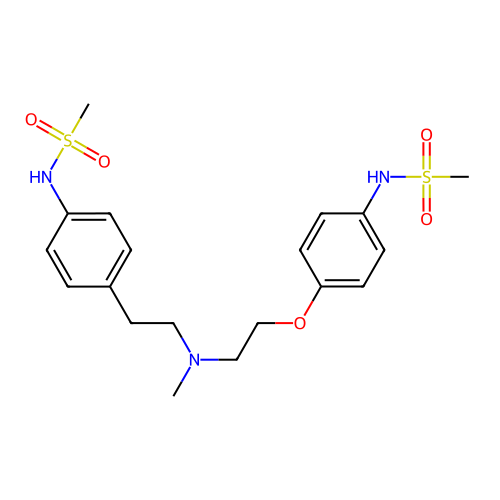

prediction: [0.00688826 0.9931117 ]
COc1cccc2c(=O)n(-c3ccc(OCCCN4CCCC4)cc3)c(C)nc12


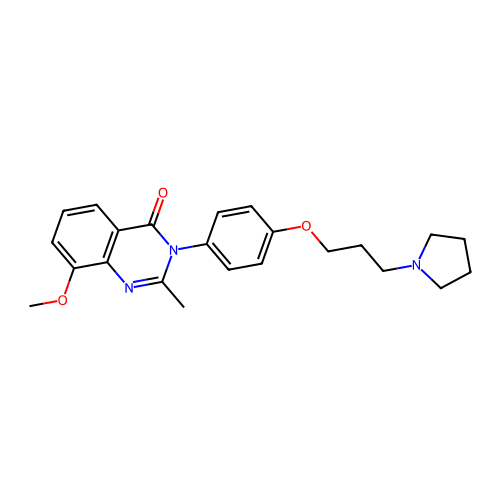

prediction: [0.00687638 0.9931236 ]
CNC(=O)c1c(NCC2CCC3(CCCC3)CC2)nc(C#N)nc1OCC1CCN(C)CC1


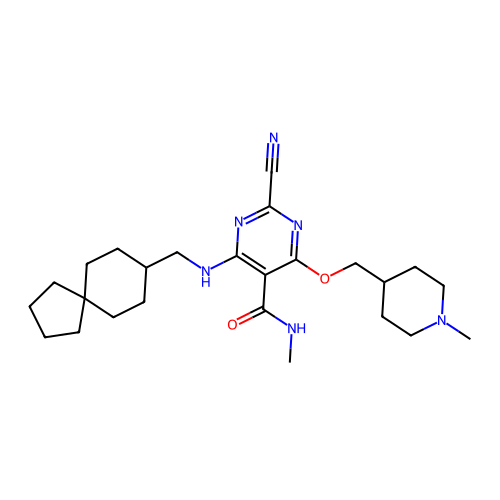

prediction: [0.00686708 0.9931329 ]
O=C(CCCN1C=CC(n2c(=O)[nH]c3ccccc32)CC1)c1ccc(F)cc1


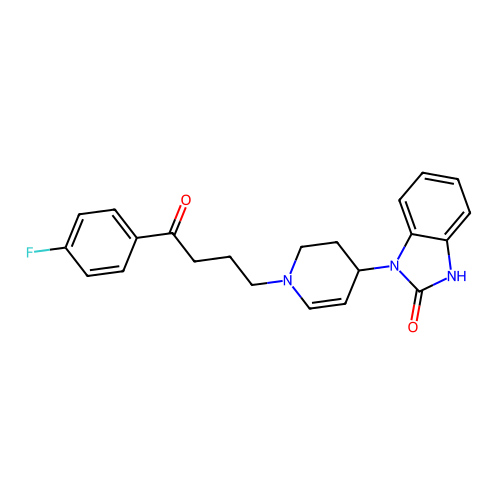

prediction: [0.00683303 0.993167  ]
O[C@@H](c1cc(C(F)(F)F)nc2c(C(F)(F)F)cccc12)[C@H]1CCCC[NH2+]1


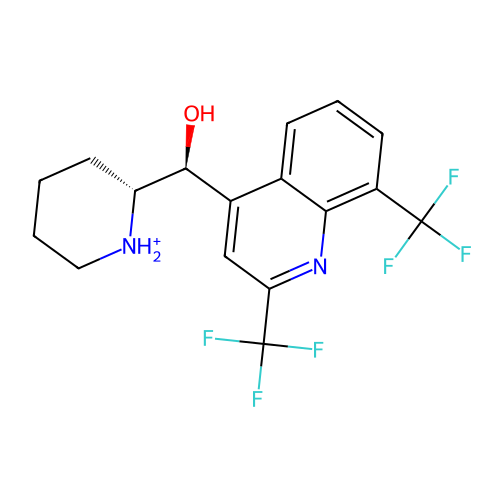

prediction: [0.00679439 0.99320567]
N#Cc1ccc(CCN2CCN(CCc3ccc([N+](=O)[O-])cc3)CC2)cc1


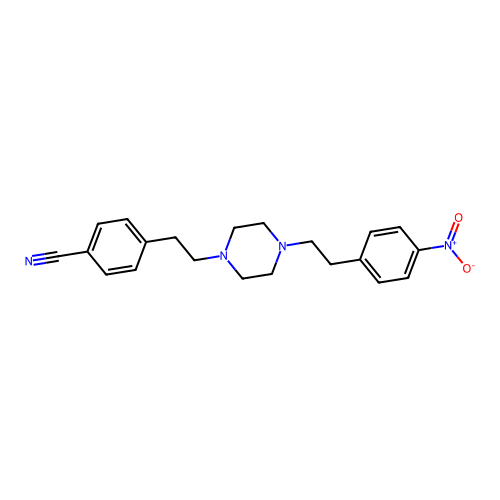

prediction: [0.00677485 0.99322516]
Oc1cc(NC2CCN(Cc3ccc4c(c3)OCO4)CC2)c2cc(Cl)ccc2n1


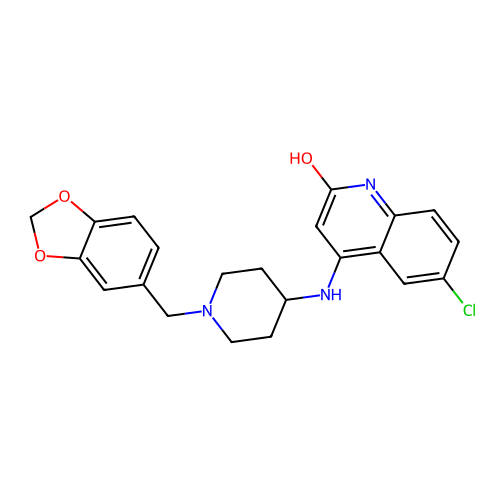

prediction: [0.006737   0.99326307]
COc1cccc2c(=O)n(-c3ccc(OC4CCN(C5CCC5)CC4)cc3)c(C)nc12


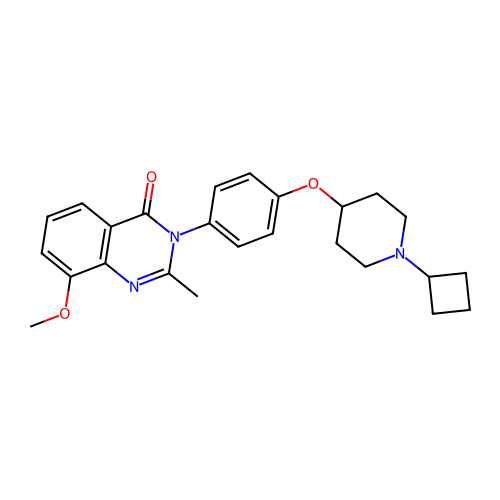

prediction: [0.00672594 0.9932741 ]
O=C1N(CCN2C[C@@H]3CC[C@H]2Cc2ccccc2C3)CCN1c1cccc(Cl)c1


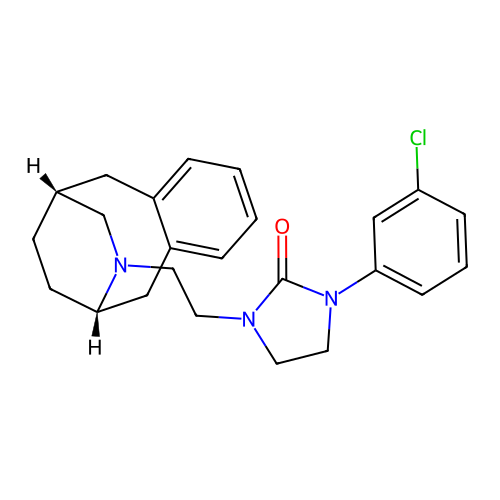

prediction: [0.00671286 0.99328715]
C[C@H](CO)CONC(=O)c1ncc2cncn2c1Nc1ccc(I)cc1F


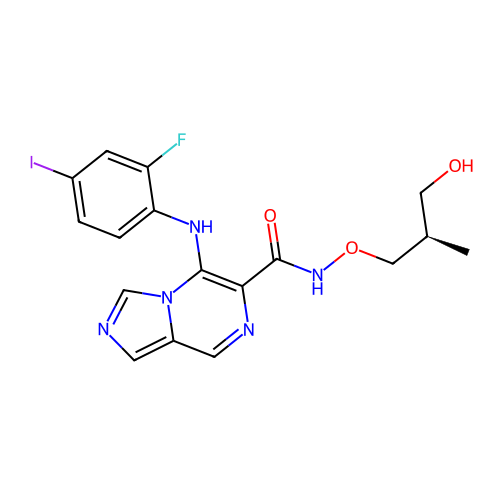

prediction: [0.00671072 0.9932893 ]
O=c1cc(OCc2cccc(F)c2)ccn1-c1ccc(OCCN2CCCC2)cc1


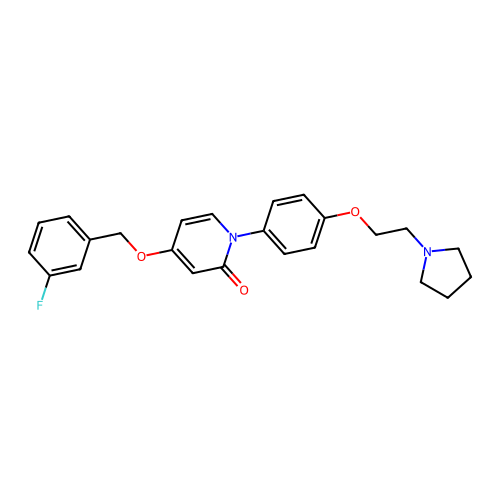

prediction: [0.00671056 0.9932894 ]
Cc1nc2ccccc2c(=O)n1-c1ccc(OC2CCCN(C3CCCC3)CC2)cc1


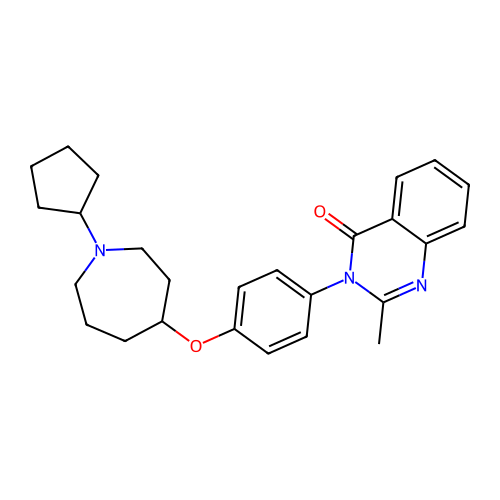

prediction: [0.00671013 0.9932899 ]
CNc1cc(Nc2cnc(C#N)c(O[C@H](C)CN(C)C)n2)ncc1C1CC1


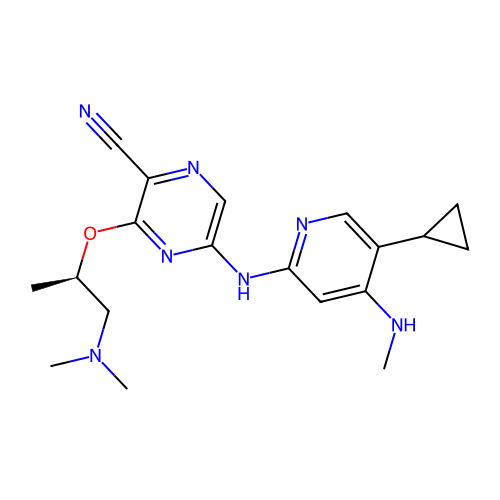

prediction: [0.00670942 0.99329054]
CCc1cc(-c2nnc(NCCCN3CCCCC3)o2)ccc1NC(=O)c1ccccc1F


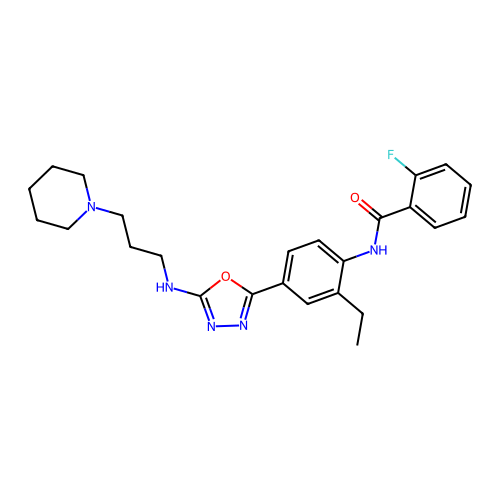

prediction: [0.00670362 0.9932963 ]
Cc1ccc2c(=O)n(-c3ccc(OCCCN4CCCC4)cc3)c(C)nc2c1


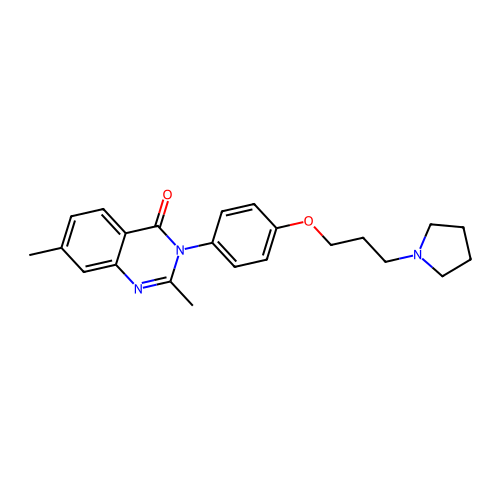

prediction: [0.00669017 0.99330986]
Nc1ccc2ncc(F)c(CCC34CCC(NCc5ccc6c(n5)NC(=O)CO6)(CC3)CO4)c2n1


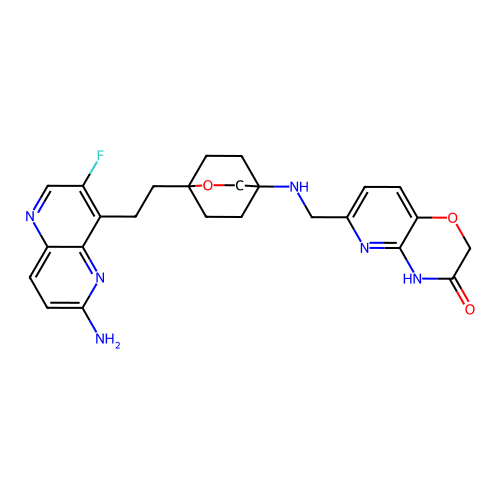

prediction: [0.00663017 0.9933698 ]
N#Cc1ccc(S(=O)(=O)C2(F)CCN(CCc3ccc(F)cc3F)CC2)cc1


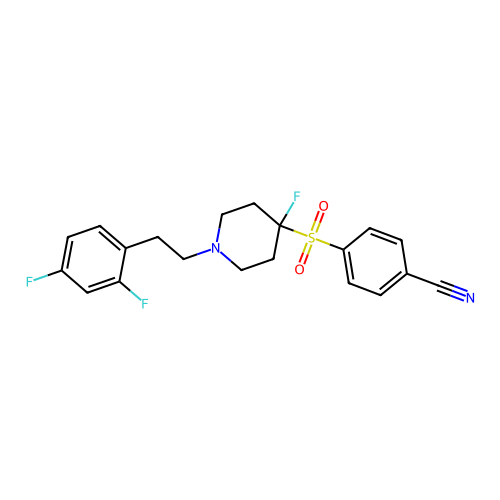

prediction: [0.00660141 0.99339855]
COc1ccc([C@]2(c3ccc(F)cc3)N=C(c3cc(C#N)ccn3)N[C@H]2C)cn1


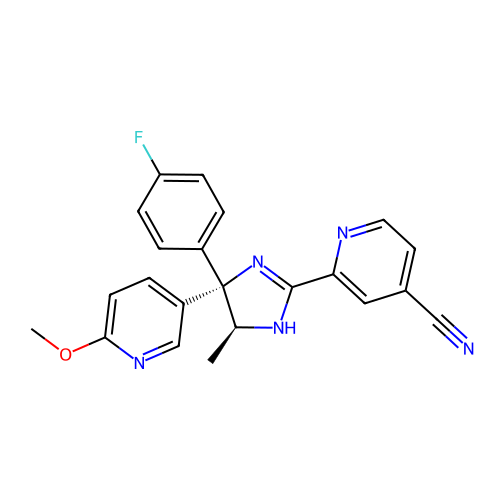

prediction: [0.00658844 0.9934116 ]
COc1cc(CNCC2CCN(CCCCCC(c3ccc(F)cc3)c3ccc(F)cc3)C2)cc(OC)c1OC


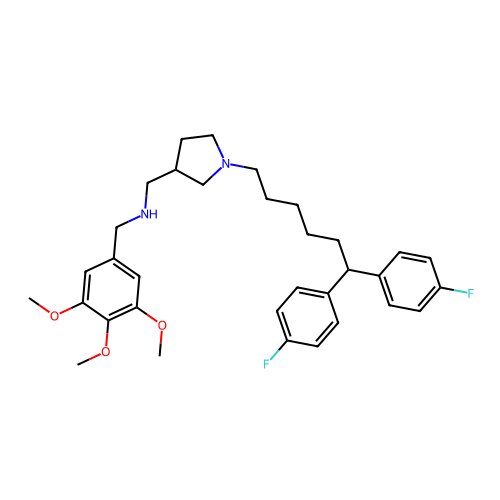

prediction: [0.0065547 0.9934453]
CNC(C)c1ccc(OC)cc1Oc1ccc(Cl)c(Cl)c1


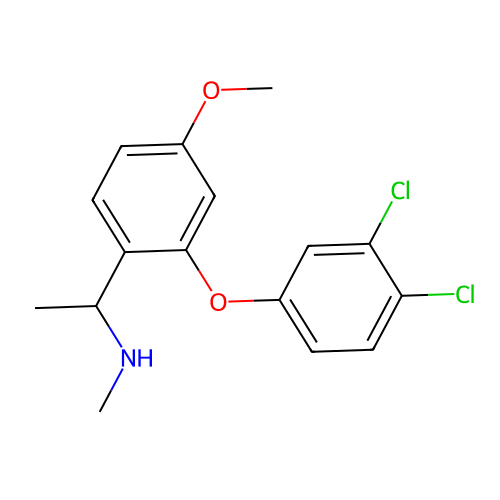

prediction: [0.00652602 0.99347395]
NC1=NC2(CO1)c1cc(-c3cncnc3)ccc1OC(CC1CC1)C21COC1


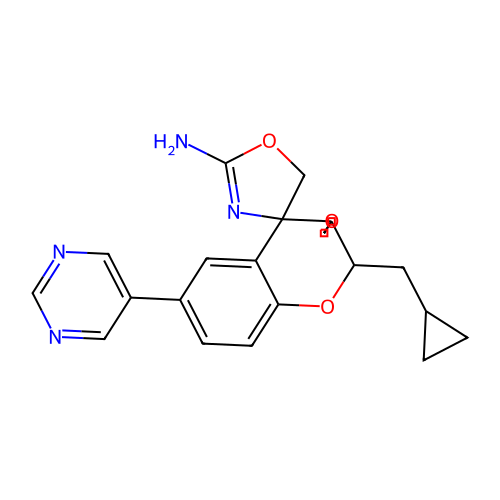

prediction: [0.00646203 0.99353796]
Clc1ccc(Cn2cc(NCCN3CCCCC3)nn2)cc1Cl


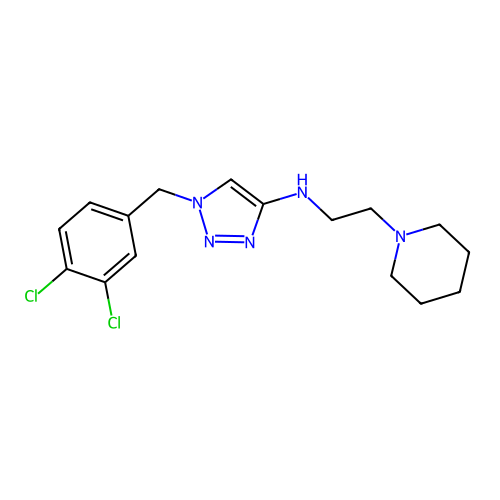

prediction: [0.00643713 0.99356294]
CC(C)C(=O)NC1CCc2ccc(CCN3CCN(c4nsc5ccccc45)CC3)cc21


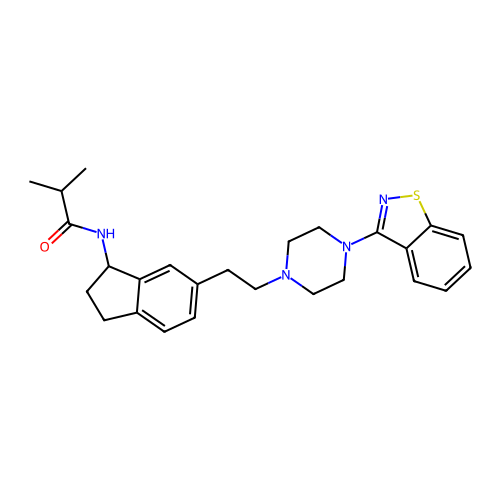

prediction: [0.00642375 0.9935762 ]
N#Cc1ccnc(C2=NC(c3ccc(F)cc3)(c3ccc(F)cc3)CN2)c1


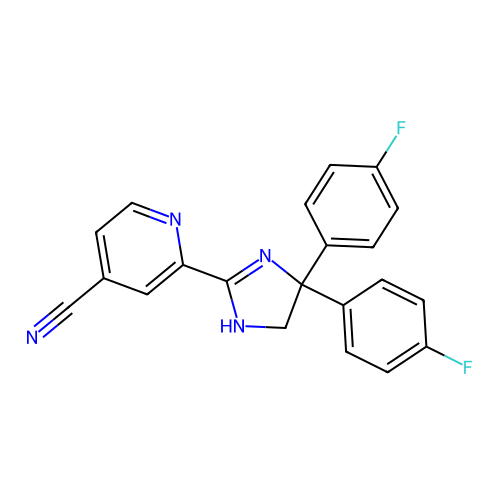

prediction: [0.0064 0.9936]
Cc1nc2cc(Cl)ccc2c(=O)n1-c1ccc(OC2CCN(C3CCC3)CC2)cc1


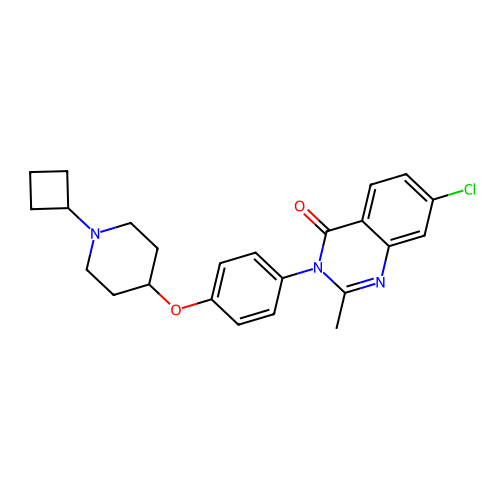

prediction: [0.00638226 0.9936178 ]
CN(CCOc1ccc([N+](=O)[O-])cc1)CCc1ccc([N+](=O)[O-])cc1


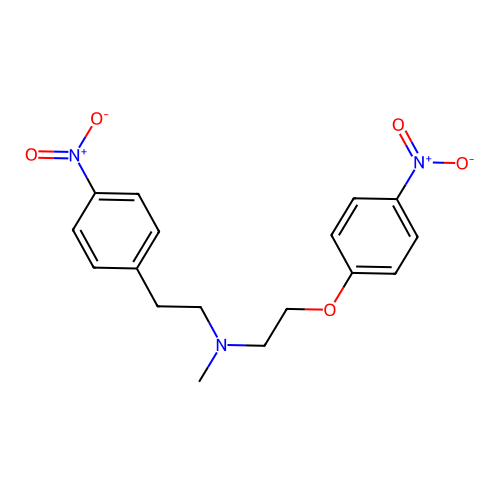

prediction: [0.00633469 0.99366534]
CS(=O)(=O)Nc1ccc(CCC(=O)NCCNc2ccc(Cl)c(Cl)c2)cc1


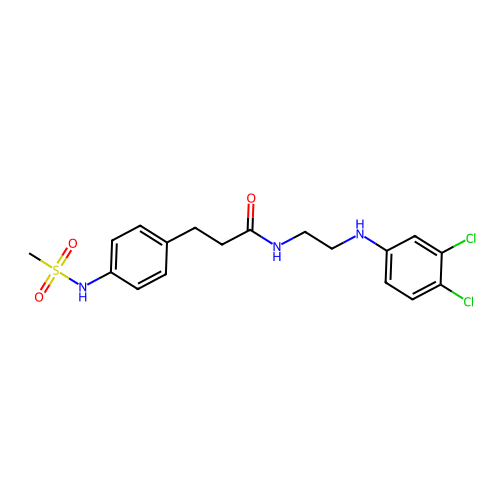

prediction: [0.00624363 0.9937564 ]
Cc1noc2cc3c(cc12)CCN(CCCSc1nnc(-c2ccc(C(F)(F)F)cc2)n1C)CC3


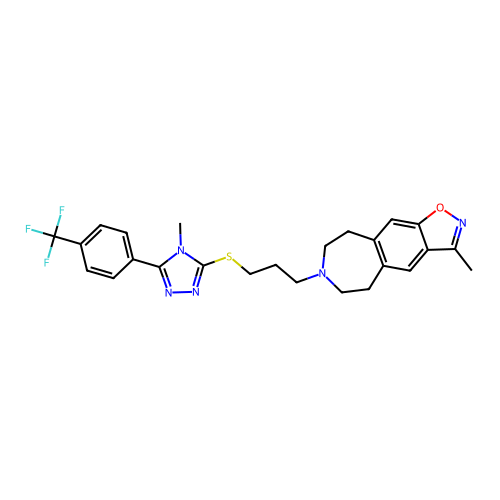

prediction: [0.00623445 0.9937656 ]
O=C(NC1CCc2ccc(CCN3CCN(c4nsc5ccccc45)CC3)cc21)c1ccccc1


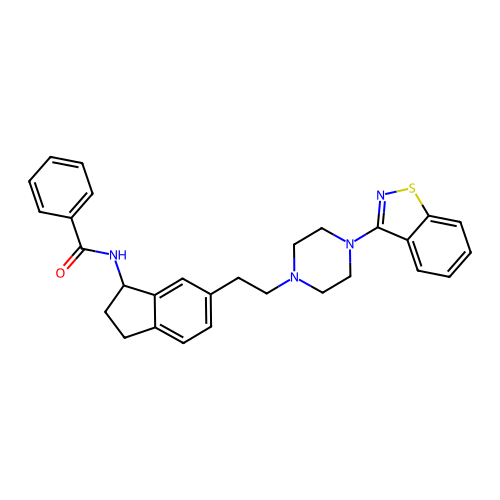

prediction: [0.00619974 0.9938002 ]
Clc1cccc(N2CCN(CCCCCOc3cc4ccccc4cn3)CC2)c1Cl


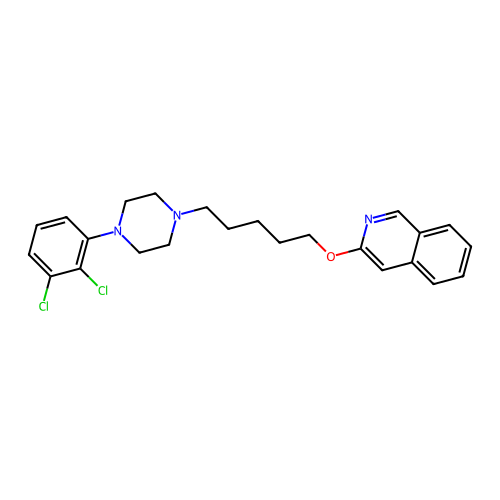

prediction: [0.00615401 0.993846  ]
Cc1cc(C)nc(N2C[C@H]3CN(C(=O)c4ccc(F)cc4-n4nccn4)C[C@H]3C2)n1


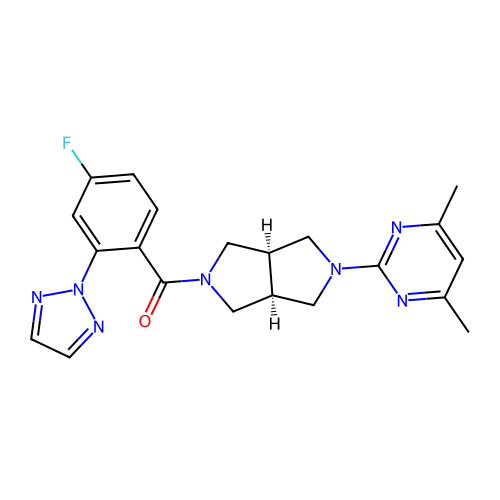

prediction: [0.0061196 0.9938804]
O=C(NC1CCN(Cc2ccc3c(c2)OCO3)CC1)c1cc(=O)c2ccc(F)cc2o1


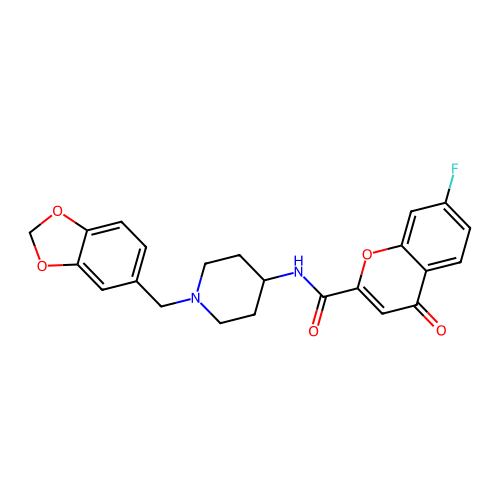

prediction: [0.00611393 0.99388605]
NC1=N[C@@]2(CO1)c1cc(-c3cccnc3F)ccc1Oc1cnc(-c3ccccc3)cc12


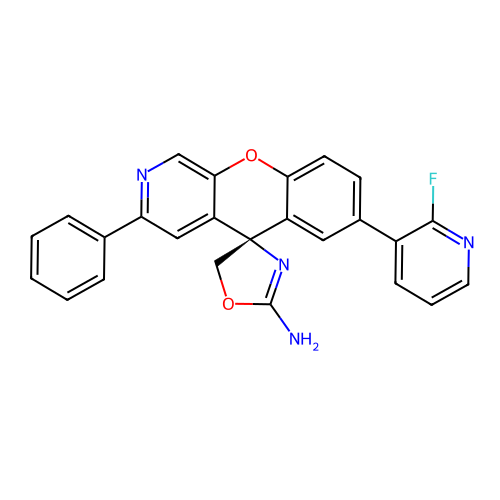

prediction: [0.00609836 0.9939016 ]
Cc1cccc(CN2[C@@H]3CC[C@H]2C[C@H](Oc2cccc(C(N)=O)c2)C3)c1


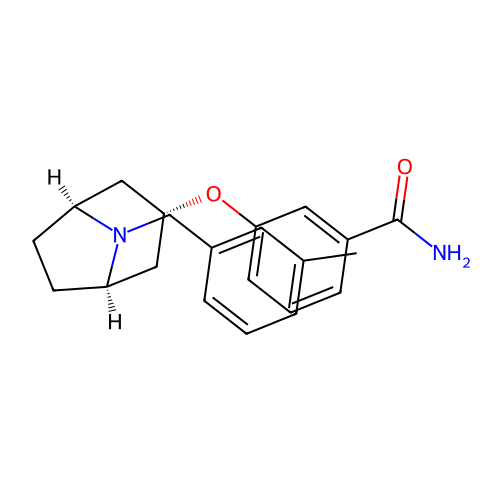

prediction: [0.00593541 0.9940646 ]
COc1ccc([C@H]2CN(CCCC3CCNCC3)C[C@@H]2CNC(=O)c2cccc(Cl)c2)cc1


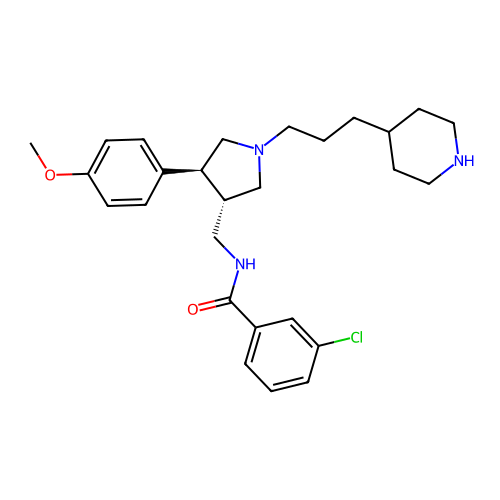

prediction: [0.0059226  0.99407744]
Cc1ncoc1-c1nnc(SCCCN2CCC3(CCc4ccc(Br)cc43)C2)n1C


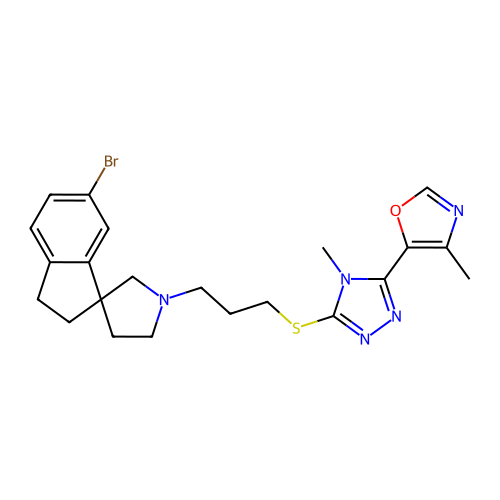

prediction: [0.0059167  0.99408334]
CCC1Oc2ccc(-c3cncnc3)cc2C2(COC(N)=N2)C12COC2


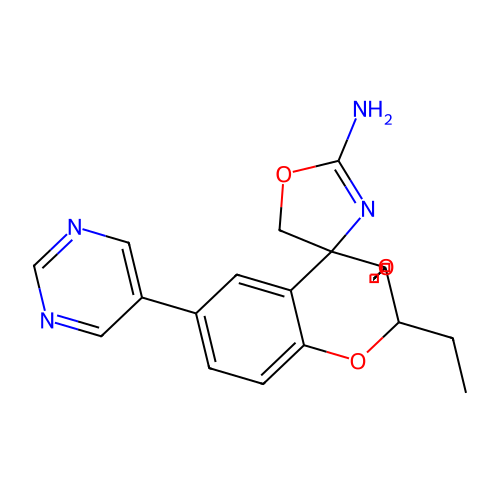

prediction: [0.00589863 0.99410135]
NC1=NC2(CO1)c1cc(-c3cccnc3)ccc1OC1(CCC1)C21COC1


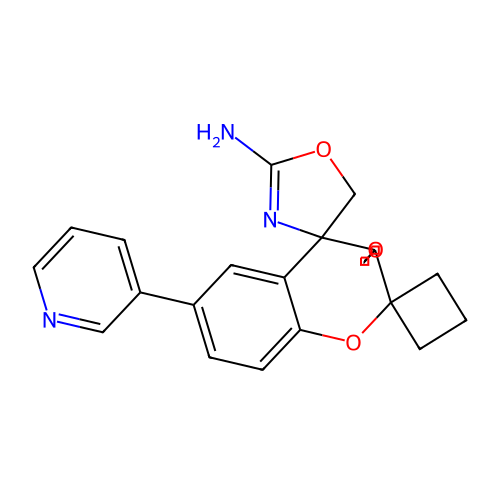

prediction: [0.00575438 0.9942456 ]
CN(CCN1CCN(c2cccc(Cl)c2)C1=O)Cc1cc2ccccc2s1


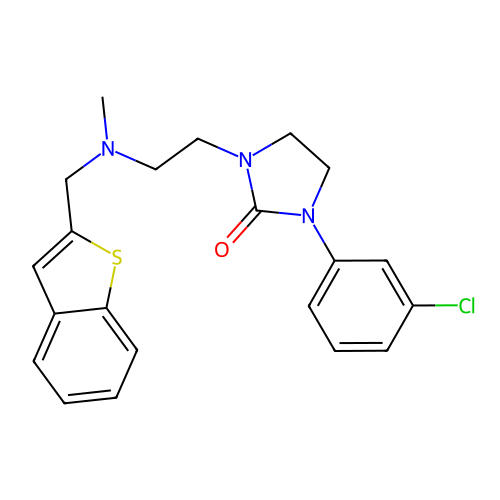

prediction: [0.0056626 0.9943374]
CN(CCc1ccc(Cl)c(Cl)c1)C[C@H](O)COc1ccc(NS(C)(=O)=O)cc1


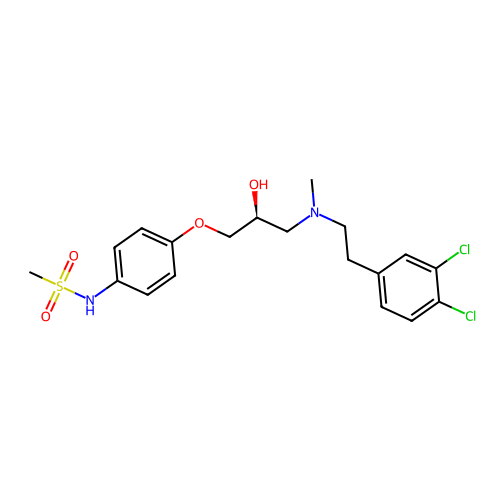

prediction: [0.00565412 0.99434584]
CNCc1cc(Cl)ccc1Oc1ccc(Cl)c(Cl)c1


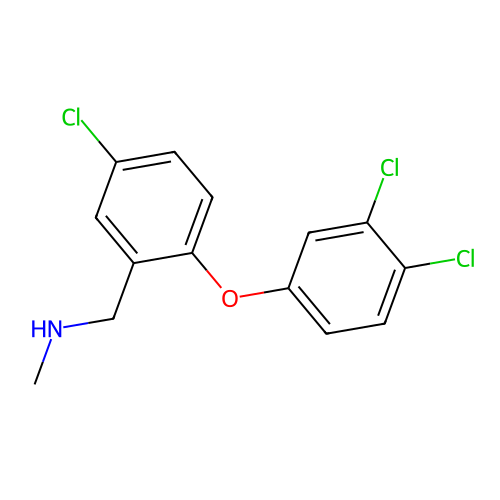

prediction: [0.00564635 0.99435365]
N#Cc1ccc(CCN2CCN(CCc3ccc4c(c3)COC4=O)CC2)cc1F


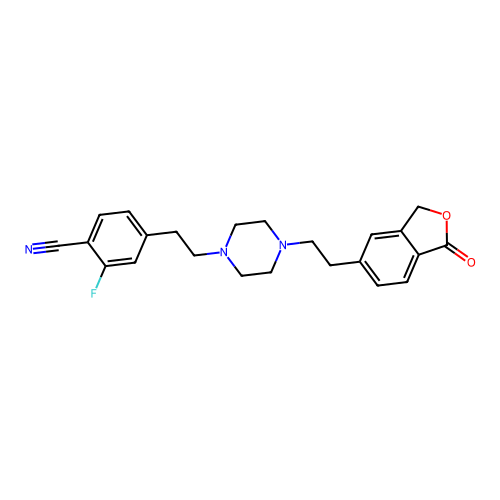

prediction: [0.00561437 0.9943856 ]
O=C(NC1CCN(Cc2ccn(-c3ccc(C(F)(F)F)cc3)c2)CC1)N1CCCC1c1ccc(F)cc1


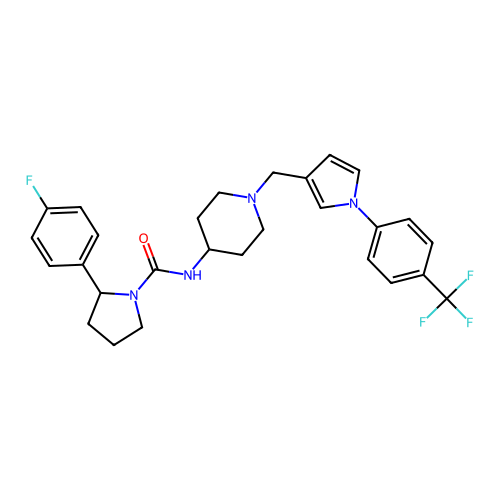

prediction: [0.0055546 0.9944454]
O=C(CCCN1CCC(O)(c2ccc(Cl)cc2)CC1)c1ccc(F)cc1


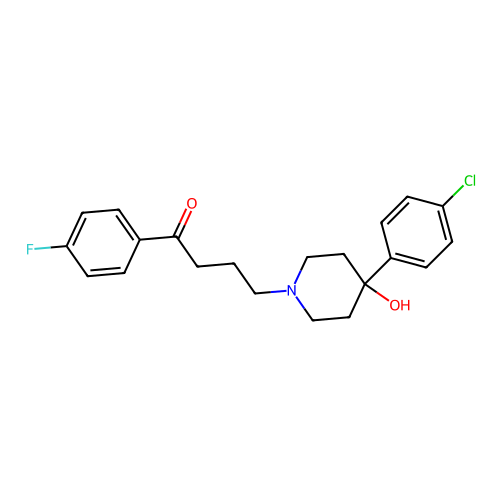

prediction: [0.00540822 0.9945918 ]
O=C1NCN(c2ccccc2)C12CC[NH+](CCCC(c1ccc(F)cc1)c1ccc(F)cc1)CC2


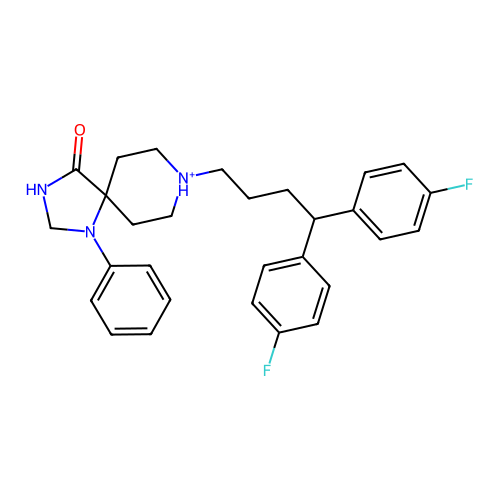

prediction: [0.00540491 0.9945951 ]
Cn1c(-c2ccc(OC3CCN(C4CCCC4)CC3)cc2)nc2ccccc2c1=O


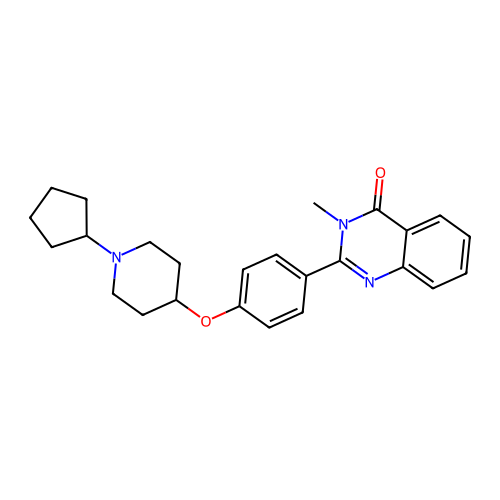

prediction: [0.00539954 0.9946004 ]
O=C1N(CCN2CCCC(OCc3ccccc3)C2)CCN1c1cccc(Cl)c1


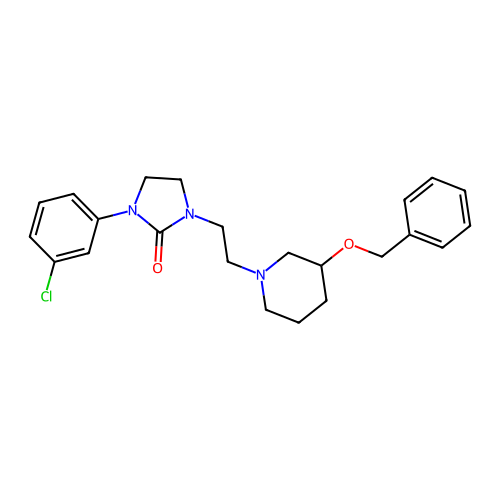

prediction: [0.00531621 0.9946838 ]
Cc1ccccc1CN1[C@@H]2CC[C@H]1C[C@H](Oc1cccc(C(N)=O)c1)C2


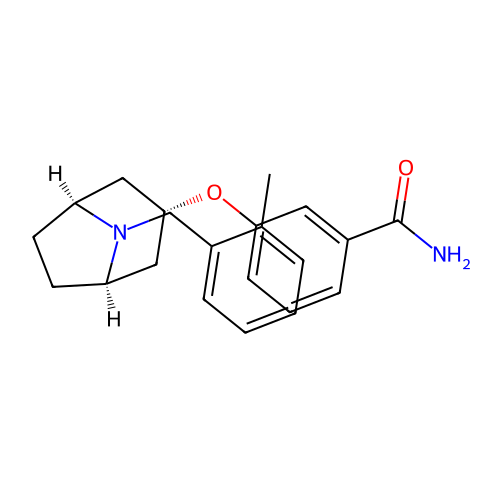

prediction: [0.0047424  0.99525756]
O=C(NC1CCc2ccc(CCN3CCN(c4nsc5ccccc45)CC3)cc21)c1cccnc1


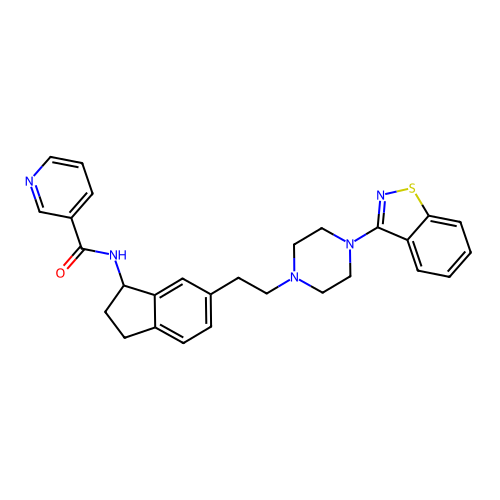

prediction: [0.00428679 0.99571323]
CC(C(=O)N[C@]1(c2ccccc2)CC[C@@H](N2CCC(c3ccc(F)cc3)CC2)CC1)c1cc(C(F)(F)F)cc(C(F)(F)F)c1


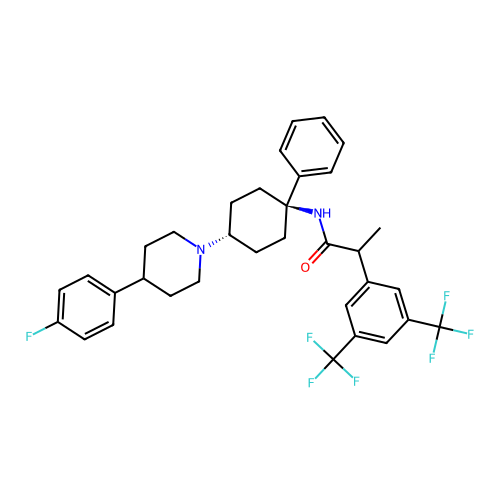

In [30]:
import os

output_folder = '../molecule figure'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

sorted_visualization_data = sorted(visualization_data, key=lambda x: x["mol_pred"][0], reverse=True)

for idx, data in enumerate(sorted_visualization_data, 1):
    print('prediction:', data["mol_pred"])
    print(data["smiles"])
    
    # 파일 저장
    output_path = os.path.join(output_folder, f'data{idx}.png')
    svg_str = str(data['svg'])  # SVG 객체를 문자열로 변환
    with open(output_path, 'w', encoding='utf-8') as f:
        f.write(svg_str)
    
    # Jupyter notebook에서 SVG 이미지 표시
    display(data["svg"])
